In [1]:
import csv

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import palettable.cartocolors.qualitative as palCartQ
import scipy.optimize
import scipy.stats

import json

import autocorr
import legacy_files.autocorr_data as autocorr_data
import calculator
import domains
import extrapolators
import fitters
import integrators
import legacy_files.omegabetaModule as omegabeta_roenko
import plotters
import scale_setters
import sychev_csv_reader

import data_holder_module

In [55]:
plt.rcParams['figure.figsize'] = [6.4, 4.8]
plt.rc('font', size=16)
# plt.rc('text', usetex=True)
matplotlib.rcParams['savefig.dpi'] = 200

In [56]:
fmtlist=['o','v','s','<','>','v','d','^']
colmap0=[plt.cm.Paired(i) for i in range(20)]
colmap1=palCartQ.Prism_10.mpl_colors
colmap2=[plt.cm.Set1(i) for i in range(10)]

In [2]:
from typing import Iterable, Tuple, List, Sequence, Optional

def np_array_(obj: Iterable) -> np.ndarray:
    return np.array([i for i in obj])

symanzik_scale_setter = scale_setters.SymanzikScaleSetter()
print(symanzik_scale_setter.beta_from_temperature_in_mev([280], 4))
print(symanzik_scale_setter.beta_from_temperature_in_mev([280], 5))
print(symanzik_scale_setter.beta_from_temperature_in_mev([280], 6))
print(symanzik_scale_setter.beta_from_temperature_in_mev([280], 7))
print(symanzik_scale_setter.beta_from_temperature_in_mev([280], 8))
print("")
print(symanzik_scale_setter.get_temperature_in_mev([5.0], 4) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([5.0], 5) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([5.0], 6) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([5.0], 7) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([5.0], 8) / 280)
print("----------------------------------")
print(symanzik_scale_setter.get_temperature_in_mev([4.600], 7) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([4.680], 7) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([4.760], 7) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([4.840], 7) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([4.920], 7) / 280)
print(symanzik_scale_setter.get_temperature_in_mev([5.000], 7) / 280)
print("----------------------------------")
ext_wilson_scale_setter = scale_setters.ExtendedWilsonScaleSetter()
print(ext_wilson_scale_setter.get_temperature_in_mev([6.160], 7) / 300)
print(ext_wilson_scale_setter.get_temperature_in_mev([6.240], 7) / 300)
print(ext_wilson_scale_setter.get_temperature_in_mev([6.320], 7) / 300)
print(ext_wilson_scale_setter.get_temperature_in_mev([6.400], 7) / 300)
print(ext_wilson_scale_setter.get_temperature_in_mev([6.480], 7) / 300)


[4.07306519]
[4.20319824]
[4.31873169]
[4.42380676]
[4.52024841]

[3.63474345]
[2.90779476]
[2.4231623]
[2.07699626]
[1.81737173]
----------------------------------
[1.27030973]
[1.40773333]
[1.55581075]
[1.71578467]
[1.88901912]
[2.07699626]
----------------------------------
[1.33367166]
[1.50046422]
[1.67805226]
[1.86788457]
[2.07433111]


In [5]:
ploop_vals_4000_386 = np.loadtxt("../data/roenko_386/PLAv4xy4.000.txt")
ploop_errs_4000_386 = np.loadtxt("../data/roenko_386/PLAv4errxy4.000.txt")
ploop_val_4000_386 = []
ploop_err_4000_386 = []
for i in range(33):
    ploop_val_4000_386.append(ploop_vals_4000_386[i][i])
    ploop_err_4000_386.append(ploop_errs_4000_386[i][i])
ploop_val_4000_386 = np.array(ploop_val_4000_386)
ploop_err_4000_386 = np.array(ploop_err_4000_386)

ploop_vals_4010_386 = np.loadtxt("../data/roenko_386/PLAv4xy4.010.txt")
ploop_errs_4010_386 = np.loadtxt("../data/roenko_386/PLAv4errxy4.010.txt")
ploop_val_4010_386 = []
ploop_err_4010_386 = []
for i in range(33):
    ploop_val_4010_386.append(ploop_vals_4010_386[i][i])
    ploop_err_4010_386.append(ploop_errs_4010_386[i][i])
ploop_val_4010_386 = np.array(ploop_val_4010_386)
ploop_err_4010_386 = np.array(ploop_err_4010_386)

ploop_vals_4020_386 = np.loadtxt("../data/roenko_386/PLAv4xy4.020.txt")
ploop_errs_4020_386 = np.loadtxt("../data/roenko_386/PLAv4errxy4.020.txt")
ploop_val_4020_386 = []
ploop_err_4020_386 = []
for i in range(33):
    ploop_val_4020_386.append(ploop_vals_4020_386[i][i])
    ploop_err_4020_386.append(ploop_errs_4020_386[i][i])
ploop_val_4020_386 = np.array(ploop_val_4020_386)
ploop_err_4020_386 = np.array(ploop_err_4020_386)

ploop_vals_4030_386 = np.loadtxt("../data/roenko_386/PLAv4xy4.030.txt")
ploop_errs_4030_386 = np.loadtxt("../data/roenko_386/PLAv4errxy4.030.txt")
ploop_val_4030_386 = []
ploop_err_4030_386 = []
for i in range(33):
    ploop_val_4030_386.append(ploop_vals_4030_386[i][i])
    ploop_err_4030_386.append(ploop_errs_4030_386[i][i])
ploop_val_4030_386 = np.array(ploop_val_4030_386)
ploop_err_4030_386 = np.array(ploop_err_4030_386)

ploop_vals_4040_386 = np.loadtxt("../data/roenko_386/PLAv4xy4.040.txt")
ploop_errs_4040_386 = np.loadtxt("../data/roenko_386/PLAv4errxy4.040.txt")
ploop_val_4040_386 = []
ploop_err_4040_386 = []
for i in range(33):
    ploop_val_4040_386.append(ploop_vals_4040_386[i][i])
    ploop_err_4040_386.append(ploop_errs_4040_386[i][i])
ploop_val_4040_386 = np.array(ploop_val_4040_386)
ploop_err_4040_386 = np.array(ploop_err_4040_386)

ploop_vals_4000_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4xy4.000.txt")
ploop_errs_4000_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4errxy4.000.txt")
ploop_val_4000_1104 = []
ploop_err_4000_1104 = []
for i in range(33):
    ploop_val_4000_1104.append(ploop_vals_4000_1104[i][i])
    ploop_err_4000_1104.append(ploop_errs_4000_1104[i][i])
ploop_val_4000_1104 = np.array(ploop_val_4000_1104)
ploop_err_4000_1104 = np.array(ploop_err_4000_1104)

ploop_vals_4010_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4xy4.010.txt")
ploop_errs_4010_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4errxy4.010.txt")
ploop_val_4010_1104 = []
ploop_err_4010_1104 = []
for i in range(33):
    ploop_val_4010_1104.append(ploop_vals_4010_1104[i][i])
    ploop_err_4010_1104.append(ploop_errs_4010_1104[i][i])
ploop_val_4010_1104 = np.array(ploop_val_4010_1104)
ploop_err_4010_1104 = np.array(ploop_err_4010_1104)

ploop_vals_4020_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4xy4.020.txt")
ploop_errs_4020_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4errxy4.020.txt")
ploop_val_4020_1104 = []
ploop_err_4020_1104 = []
for i in range(33):
    ploop_val_4020_1104.append(ploop_vals_4020_1104[i][i])
    ploop_err_4020_1104.append(ploop_errs_4020_1104[i][i])
ploop_val_4020_1104 = np.array(ploop_val_4020_1104)
ploop_err_4020_1104 = np.array(ploop_err_4020_1104)

ploop_vals_4030_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4xy4.030.txt")
ploop_errs_4030_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4errxy4.030.txt")
ploop_val_4030_1104 = []
ploop_err_4030_1104 = []
for i in range(33):
    ploop_val_4030_1104.append(ploop_vals_4030_1104[i][i])
    ploop_err_4030_1104.append(ploop_errs_4030_1104[i][i])
ploop_val_4030_1104 = np.array(ploop_val_4030_1104)
ploop_err_4030_1104 = np.array(ploop_err_4030_1104)

ploop_vals_4040_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4xy4.040.txt")
ploop_errs_4040_1104 = np.loadtxt("../data/roenko_large_z_v1/4x1104x33^2/PBC_cV/0.0216506a/PLAv4errxy4.040.txt")
ploop_val_4040_1104 = []
ploop_err_4040_1104 = []
for i in range(33):
    ploop_val_4040_1104.append(ploop_vals_4040_1104[i][i])
    ploop_err_4040_1104.append(ploop_errs_4040_1104[i][i])
ploop_val_4040_1104 = np.array(ploop_val_4040_1104)
ploop_err_4040_1104 = np.array(ploop_err_4040_1104)

# print(ploop_val)
# print(ploop_err)

In [6]:
ploop_vals_ns129_4046_24 = np.loadtxt("../data/roenko_large_z_v2/4x24x129^2/PBC_cV/0.0038273a/PLAv4xy4.046.txt")
ploop_errs_ns129_4046_24 = np.loadtxt("../data/roenko_large_z_v2/4x24x129^2/PBC_cV/0.0038273a/PLAv4errxy4.046.txt")
ploop_val_ns129_4046_24 = []
ploop_err_ns129_4046_24 = []
for i in range(129):
    ploop_val_ns129_4046_24.append(ploop_vals_ns129_4046_24[i][i])
    ploop_err_ns129_4046_24.append(ploop_errs_ns129_4046_24[i][i])
ploop_val_ns129_4046_24 = np.array(ploop_val_ns129_4046_24)
ploop_err_ns129_4046_24 = np.array(ploop_err_ns129_4046_24)


ploop_vals_ns129_4013_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.013.txt")
ploop_errs_ns129_4013_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.013.txt")
ploop_val_ns129_4013_92 = []
ploop_err_ns129_4013_92 = []
for i in range(129):
    ploop_val_ns129_4013_92.append(ploop_vals_ns129_4013_92[i][i])
    ploop_err_ns129_4013_92.append(ploop_errs_ns129_4013_92[i][i])
ploop_val_ns129_4013_92 = np.array(ploop_val_ns129_4013_92)
ploop_err_ns129_4013_92 = np.array(ploop_err_ns129_4013_92)

ploop_vals_ns129_4019_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.019.txt")
ploop_errs_ns129_4019_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.019.txt")
ploop_val_ns129_4019_92 = []
ploop_err_ns129_4019_92 = []
for i in range(129):
    ploop_val_ns129_4019_92.append(ploop_vals_ns129_4019_92[i][i])
    ploop_err_ns129_4019_92.append(ploop_errs_ns129_4019_92[i][i])
ploop_val_ns129_4019_92 = np.array(ploop_val_ns129_4019_92)
ploop_err_ns129_4019_92 = np.array(ploop_err_ns129_4019_92)

ploop_vals_ns129_4025_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.025.txt")
ploop_errs_ns129_4025_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.025.txt")
ploop_val_ns129_4025_92 = []
ploop_err_ns129_4025_92 = []
for i in range(129):
    ploop_val_ns129_4025_92.append(ploop_vals_ns129_4025_92[i][i])
    ploop_err_ns129_4025_92.append(ploop_errs_ns129_4025_92[i][i])
ploop_val_ns129_4025_92 = np.array(ploop_val_ns129_4025_92)
ploop_err_ns129_4025_92 = np.array(ploop_err_ns129_4025_92)

ploop_vals_ns129_4031_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.031.txt")
ploop_errs_ns129_4031_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.031.txt")
ploop_val_ns129_4031_92 = []
ploop_err_ns129_4031_92 = []
for i in range(129):
    ploop_val_ns129_4031_92.append(ploop_vals_ns129_4031_92[i][i])
    ploop_err_ns129_4031_92.append(ploop_errs_ns129_4031_92[i][i])
ploop_val_ns129_4031_92 = np.array(ploop_val_ns129_4031_92)
ploop_err_ns129_4031_92 = np.array(ploop_err_ns129_4031_92)

ploop_vals_ns129_4034_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.034.txt")
ploop_errs_ns129_4034_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.034.txt")
ploop_val_ns129_4034_92 = []
ploop_err_ns129_4034_92 = []
for i in range(129):
    ploop_val_ns129_4034_92.append(ploop_vals_ns129_4034_92[i][i])
    ploop_err_ns129_4034_92.append(ploop_errs_ns129_4034_92[i][i])
ploop_val_ns129_4034_92 = np.array(ploop_val_ns129_4034_92)
ploop_err_ns129_4034_92 = np.array(ploop_err_ns129_4034_92)

ploop_vals_ns129_4037_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.037.txt")
ploop_errs_ns129_4037_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.037.txt")
ploop_val_ns129_4037_92 = []
ploop_err_ns129_4037_92 = []
for i in range(129):
    ploop_val_ns129_4037_92.append(ploop_vals_ns129_4037_92[i][i])
    ploop_err_ns129_4037_92.append(ploop_errs_ns129_4037_92[i][i])
ploop_val_ns129_4037_92 = np.array(ploop_val_ns129_4037_92)
ploop_err_ns129_4037_92 = np.array(ploop_err_ns129_4037_92)

ploop_vals_ns129_4040_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.040.txt")
ploop_errs_ns129_4040_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.040.txt")
ploop_val_ns129_4040_92 = []
ploop_err_ns129_4040_92 = []
for i in range(129):
    ploop_val_ns129_4040_92.append(ploop_vals_ns129_4040_92[i][i])
    ploop_err_ns129_4040_92.append(ploop_errs_ns129_4040_92[i][i])
ploop_val_ns129_4040_92 = np.array(ploop_val_ns129_4040_92)
ploop_err_ns129_4040_92 = np.array(ploop_err_ns129_4040_92)

ploop_vals_ns129_4043_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.043.txt")
ploop_errs_ns129_4043_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.043.txt")
ploop_val_ns129_4043_92 = []
ploop_err_ns129_4043_92 = []
for i in range(129):
    ploop_val_ns129_4043_92.append(ploop_vals_ns129_4043_92[i][i])
    ploop_err_ns129_4043_92.append(ploop_errs_ns129_4043_92[i][i])
ploop_val_ns129_4043_92 = np.array(ploop_val_ns129_4043_92)
ploop_err_ns129_4043_92 = np.array(ploop_err_ns129_4043_92)

ploop_vals_ns129_4046_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.046.txt")
ploop_errs_ns129_4046_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.046.txt")
ploop_val_ns129_4046_92 = []
ploop_err_ns129_4046_92 = []
for i in range(129):
    ploop_val_ns129_4046_92.append(ploop_vals_ns129_4046_92[i][i])
    ploop_err_ns129_4046_92.append(ploop_errs_ns129_4046_92[i][i])
ploop_val_ns129_4046_92 = np.array(ploop_val_ns129_4046_92)
ploop_err_ns129_4046_92 = np.array(ploop_err_ns129_4046_92)

ploop_vals_ns129_4049_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.049.txt")
ploop_errs_ns129_4049_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.049.txt")
ploop_val_ns129_4049_92 = []
ploop_err_ns129_4049_92 = []
for i in range(129):
    ploop_val_ns129_4049_92.append(ploop_vals_ns129_4049_92[i][i])
    ploop_err_ns129_4049_92.append(ploop_errs_ns129_4049_92[i][i])
ploop_val_ns129_4049_92 = np.array(ploop_val_ns129_4049_92)
ploop_err_ns129_4049_92 = np.array(ploop_err_ns129_4049_92)

ploop_vals_ns129_4052_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.052.txt")
ploop_errs_ns129_4052_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.052.txt")
ploop_val_ns129_4052_92 = []
ploop_err_ns129_4052_92 = []
for i in range(129):
    ploop_val_ns129_4052_92.append(ploop_vals_ns129_4052_92[i][i])
    ploop_err_ns129_4052_92.append(ploop_errs_ns129_4052_92[i][i])
ploop_val_ns129_4052_92 = np.array(ploop_val_ns129_4052_92)
ploop_err_ns129_4052_92 = np.array(ploop_err_ns129_4052_92)

ploop_vals_ns129_4055_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.055.txt")
ploop_errs_ns129_4055_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.055.txt")
ploop_val_ns129_4055_92 = []
ploop_err_ns129_4055_92 = []
for i in range(129):
    ploop_val_ns129_4055_92.append(ploop_vals_ns129_4055_92[i][i])
    ploop_err_ns129_4055_92.append(ploop_errs_ns129_4055_92[i][i])
ploop_val_ns129_4055_92 = np.array(ploop_val_ns129_4055_92)
ploop_err_ns129_4055_92 = np.array(ploop_err_ns129_4055_92)

ploop_vals_ns129_4061_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4xy4.061.txt")
ploop_errs_ns129_4061_92 = np.loadtxt("../data/roenko_large_z_v2/4x92x129^2/PBC_cV/0.0038273a/PLAv4errxy4.061.txt")
ploop_val_ns129_4061_92 = []
ploop_err_ns129_4061_92 = []
for i in range(129):
    ploop_val_ns129_4061_92.append(ploop_vals_ns129_4061_92[i][i])
    ploop_err_ns129_4061_92.append(ploop_errs_ns129_4061_92[i][i])
ploop_val_ns129_4061_92 = np.array(ploop_val_ns129_4061_92)
ploop_err_ns129_4061_92 = np.array(ploop_err_ns129_4061_92)


ploop_vals_ns129_4046_368 = np.loadtxt("../data/roenko_large_z_v2/4x368x129^2/PBC_cV/0.0038273a/PLAv4xy4.046.txt")
ploop_errs_ns129_4046_368 = np.loadtxt("../data/roenko_large_z_v2/4x368x129^2/PBC_cV/0.0038273a/PLAv4errxy4.046.txt")
ploop_val_ns129_4046_368 = []
ploop_err_ns129_4046_368 = []
for i in range(129):
    ploop_val_ns129_4046_368.append(ploop_vals_ns129_4046_368[i][i])
    ploop_err_ns129_4046_368.append(ploop_errs_ns129_4046_368[i][i])
ploop_val_ns129_4046_368 = np.array(ploop_val_ns129_4046_368)
ploop_err_ns129_4046_368 = np.array(ploop_err_ns129_4046_368)


In [3]:
ploop_vals_ns129_pbc_4063_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4xy4.063.txt")
ploop_errs_ns129_pbc_4063_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4errxy4.063.txt")
ploop_val_ns129_pbc_4063_92 = []
ploop_err_ns129_pbc_4063_92 = []
for i in range(129):
    ploop_val_ns129_pbc_4063_92.append(ploop_vals_ns129_pbc_4063_92[i][i])
    ploop_err_ns129_pbc_4063_92.append(ploop_errs_ns129_pbc_4063_92[i][i])
ploop_val_ns129_pbc_4063_92 = np.array(ploop_val_ns129_pbc_4063_92)
ploop_err_ns129_pbc_4063_92 = np.array(ploop_err_ns129_pbc_4063_92)

ploop_vals_ns129_pbc_4064_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4xy4.064.txt")
ploop_errs_ns129_pbc_4064_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4errxy4.064.txt")
ploop_val_ns129_pbc_4064_92 = []
ploop_err_ns129_pbc_4064_92 = []
for i in range(129):
    ploop_val_ns129_pbc_4064_92.append(ploop_vals_ns129_pbc_4064_92[i][i])
    ploop_err_ns129_pbc_4064_92.append(ploop_errs_ns129_pbc_4064_92[i][i])
ploop_val_ns129_pbc_4064_92 = np.array(ploop_val_ns129_pbc_4064_92)
ploop_err_ns129_pbc_4064_92 = np.array(ploop_err_ns129_pbc_4064_92)

ploop_vals_ns129_pbc_4065_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4xy4.065.txt")
ploop_errs_ns129_pbc_4065_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4errxy4.065.txt")
ploop_val_ns129_pbc_4065_92 = []
ploop_err_ns129_pbc_4065_92 = []
for i in range(129):
    ploop_val_ns129_pbc_4065_92.append(ploop_vals_ns129_pbc_4065_92[i][i])
    ploop_err_ns129_pbc_4065_92.append(ploop_errs_ns129_pbc_4065_92[i][i])
ploop_val_ns129_pbc_4065_92 = np.array(ploop_val_ns129_pbc_4065_92)
ploop_err_ns129_pbc_4065_92 = np.array(ploop_err_ns129_pbc_4065_92)

ploop_vals_ns129_pbc_4066_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4xy4.066.txt")
ploop_errs_ns129_pbc_4066_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4errxy4.066.txt")
ploop_val_ns129_pbc_4066_92 = []
ploop_err_ns129_pbc_4066_92 = []
for i in range(129):
    ploop_val_ns129_pbc_4066_92.append(ploop_vals_ns129_pbc_4066_92[i][i])
    ploop_err_ns129_pbc_4066_92.append(ploop_errs_ns129_pbc_4066_92[i][i])
ploop_val_ns129_pbc_4066_92 = np.array(ploop_val_ns129_pbc_4066_92)
ploop_err_ns129_pbc_4066_92 = np.array(ploop_err_ns129_pbc_4066_92)

ploop_vals_ns129_pbc_4067_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4xy4.067.txt")
ploop_errs_ns129_pbc_4067_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4errxy4.067.txt")
ploop_val_ns129_pbc_4067_92 = []
ploop_err_ns129_pbc_4067_92 = []
for i in range(129):
    ploop_val_ns129_pbc_4067_92.append(ploop_vals_ns129_pbc_4067_92[i][i])
    ploop_err_ns129_pbc_4067_92.append(ploop_errs_ns129_pbc_4067_92[i][i])
ploop_val_ns129_pbc_4067_92 = np.array(ploop_val_ns129_pbc_4067_92)
ploop_err_ns129_pbc_4067_92 = np.array(ploop_err_ns129_pbc_4067_92)

ploop_vals_ns129_pbc_4068_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4xy4.068.txt")
ploop_errs_ns129_pbc_4068_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4errxy4.068.txt")
ploop_val_ns129_pbc_4068_92 = []
ploop_err_ns129_pbc_4068_92 = []
for i in range(129):
    ploop_val_ns129_pbc_4068_92.append(ploop_vals_ns129_pbc_4068_92[i][i])
    ploop_err_ns129_pbc_4068_92.append(ploop_errs_ns129_pbc_4068_92[i][i])
ploop_val_ns129_pbc_4068_92 = np.array(ploop_val_ns129_pbc_4068_92)
ploop_err_ns129_pbc_4068_92 = np.array(ploop_err_ns129_pbc_4068_92)

ploop_vals_ns129_pbc_4069_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4xy4.069.txt")
ploop_errs_ns129_pbc_4069_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x129^2/PBC_cV/0.0019137a/PLAv4errxy4.069.txt")
ploop_val_ns129_pbc_4069_92 = []
ploop_err_ns129_pbc_4069_92 = []
for i in range(129):
    ploop_val_ns129_pbc_4069_92.append(ploop_vals_ns129_pbc_4069_92[i][i])
    ploop_err_ns129_pbc_4069_92.append(ploop_errs_ns129_pbc_4069_92[i][i])
ploop_val_ns129_pbc_4069_92 = np.array(ploop_val_ns129_pbc_4069_92)
ploop_err_ns129_pbc_4069_92 = np.array(ploop_err_ns129_pbc_4069_92)


ploop_vals_ns257_obc_4000_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4xy4.000.txt")
ploop_errs_ns257_obc_4000_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4errxy4.000.txt")
ploop_val_ns257_obc_4000_92 = []
ploop_err_ns257_obc_4000_92 = []
for i in range(257):
    ploop_val_ns257_obc_4000_92.append(ploop_vals_ns257_obc_4000_92[i][i])
    ploop_err_ns257_obc_4000_92.append(ploop_errs_ns257_obc_4000_92[i][i])
ploop_val_ns257_obc_4000_92 = np.array(ploop_val_ns257_obc_4000_92)
ploop_err_ns257_obc_4000_92 = np.array(ploop_err_ns257_obc_4000_92)

ploop_vals_ns257_obc_4010_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4xy4.010.txt")
ploop_errs_ns257_obc_4010_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4errxy4.010.txt")
ploop_val_ns257_obc_4010_92 = []
ploop_err_ns257_obc_4010_92 = []
for i in range(257):
    ploop_val_ns257_obc_4010_92.append(ploop_vals_ns257_obc_4010_92[i][i])
    ploop_err_ns257_obc_4010_92.append(ploop_errs_ns257_obc_4010_92[i][i])
ploop_val_ns257_obc_4010_92 = np.array(ploop_val_ns257_obc_4010_92)
ploop_err_ns257_obc_4010_92 = np.array(ploop_err_ns257_obc_4010_92)

ploop_vals_ns257_obc_4020_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4xy4.020.txt")
ploop_errs_ns257_obc_4020_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4errxy4.020.txt")
ploop_val_ns257_obc_4020_92 = []
ploop_err_ns257_obc_4020_92 = []
for i in range(257):
    ploop_val_ns257_obc_4020_92.append(ploop_vals_ns257_obc_4020_92[i][i])
    ploop_err_ns257_obc_4020_92.append(ploop_errs_ns257_obc_4020_92[i][i])
ploop_val_ns257_obc_4020_92 = np.array(ploop_val_ns257_obc_4020_92)
ploop_err_ns257_obc_4020_92 = np.array(ploop_err_ns257_obc_4020_92)

ploop_vals_ns257_obc_4030_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4xy4.030.txt")
ploop_errs_ns257_obc_4030_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4errxy4.030.txt")
ploop_val_ns257_obc_4030_92 = []
ploop_err_ns257_obc_4030_92 = []
for i in range(257):
    ploop_val_ns257_obc_4030_92.append(ploop_vals_ns257_obc_4030_92[i][i])
    ploop_err_ns257_obc_4030_92.append(ploop_errs_ns257_obc_4030_92[i][i])
ploop_val_ns257_obc_4030_92 = np.array(ploop_val_ns257_obc_4030_92)
ploop_err_ns257_obc_4030_92 = np.array(ploop_err_ns257_obc_4030_92)

ploop_vals_ns257_obc_4040_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4xy4.040.txt")
ploop_errs_ns257_obc_4040_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4errxy4.040.txt")
ploop_val_ns257_obc_4040_92 = []
ploop_err_ns257_obc_4040_92 = []
for i in range(257):
    ploop_val_ns257_obc_4040_92.append(ploop_vals_ns257_obc_4040_92[i][i])
    ploop_err_ns257_obc_4040_92.append(ploop_errs_ns257_obc_4040_92[i][i])
ploop_val_ns257_obc_4040_92 = np.array(ploop_val_ns257_obc_4040_92)
ploop_err_ns257_obc_4040_92 = np.array(ploop_err_ns257_obc_4040_92)

ploop_vals_ns257_obc_4050_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4xy4.050.txt")
ploop_errs_ns257_obc_4050_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4errxy4.050.txt")
ploop_val_ns257_obc_4050_92 = []
ploop_err_ns257_obc_4050_92 = []
for i in range(257):
    ploop_val_ns257_obc_4050_92.append(ploop_vals_ns257_obc_4050_92[i][i])
    ploop_err_ns257_obc_4050_92.append(ploop_errs_ns257_obc_4050_92[i][i])
ploop_val_ns257_obc_4050_92 = np.array(ploop_val_ns257_obc_4050_92)
ploop_err_ns257_obc_4050_92 = np.array(ploop_err_ns257_obc_4050_92)

ploop_vals_ns257_obc_4060_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4xy4.060.txt")
ploop_errs_ns257_obc_4060_92 = np.loadtxt("../data/roenko_large_z_v3/4x92x257^2/OBCb_cV/0.0023438a/PLAv4errxy4.060.txt")
ploop_val_ns257_obc_4060_92 = []
ploop_err_ns257_obc_4060_92 = []
for i in range(257):
    ploop_val_ns257_obc_4060_92.append(ploop_vals_ns257_obc_4060_92[i][i])
    ploop_err_ns257_obc_4060_92.append(ploop_errs_ns257_obc_4060_92[i][i])
ploop_val_ns257_obc_4060_92 = np.array(ploop_val_ns257_obc_4060_92)
ploop_err_ns257_obc_4060_92 = np.array(ploop_err_ns257_obc_4060_92)


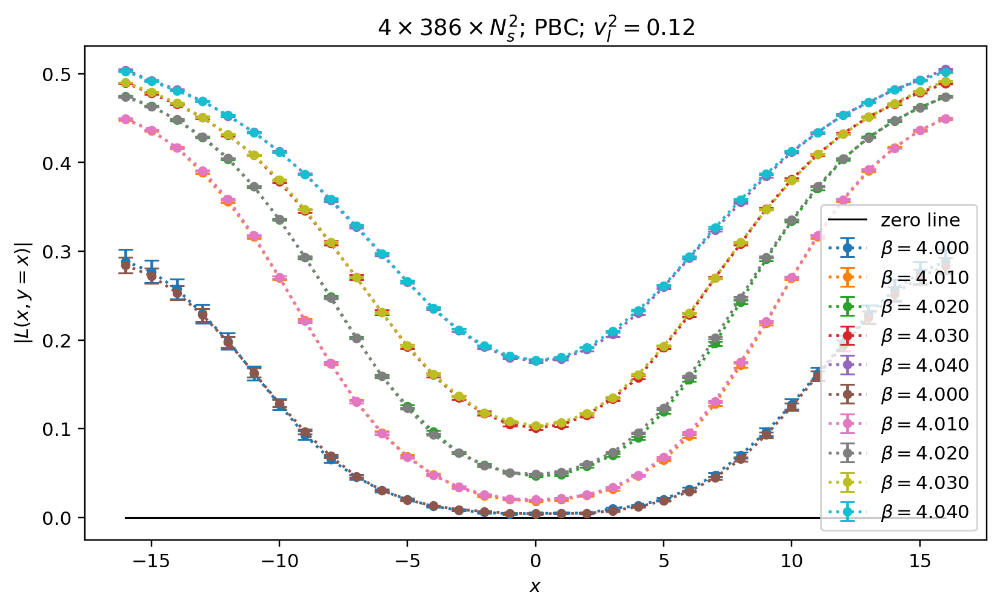

In [9]:
fig, ax = plotters.make_figure_and_111axis(plt)

x_val = np.arange(-16, 17, 1)
plt.plot(x_val, 0.0 * x_val, label="zero line", color="black", linewidth=1)
plt.errorbar(x_val, ploop_val_4000_386, yerr=ploop_err_4000_386,
             fmt="o:", label=r"$\beta = 4.000$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4010_386, yerr=ploop_err_4010_386,
             fmt="o:", label=r"$\beta = 4.010$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4020_386, yerr=ploop_err_4020_386,
             fmt="o:", label=r"$\beta = 4.020$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4030_386, yerr=ploop_err_4030_386,
             fmt="o:", label=r"$\beta = 4.030$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4040_386, yerr=ploop_err_4040_386,
             fmt="o:", label=r"$\beta = 4.040$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4000_1104, yerr=ploop_err_4000_1104,
             fmt="o:", label=r"$\beta = 4.000$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4010_1104, yerr=ploop_err_4010_1104,
             fmt="o:", label=r"$\beta = 4.010$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4020_1104, yerr=ploop_err_4020_1104,
             fmt="o:", label=r"$\beta = 4.020$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4030_1104, yerr=ploop_err_4030_1104,
             fmt="o:", label=r"$\beta = 4.030$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_4040_1104, yerr=ploop_err_4040_1104,
             fmt="o:", label=r"$\beta = 4.040$", capsize=4, markersize=4)
plt.legend(loc="lower right")
# plt.xlabel("$T/T'_c$")
plt.xlabel("$x$")
# plt.ylabel("Polyakov loop susceptibility")
# plt.ylabel("$|\langle P \\rangle |$")
plt.ylabel("$|L(x, y = x)|$")
plt.title(r"$4 \times 386 \times N_s^2$; PBC; $v_I^2 = 0.12$")
# plt.savefig(f"{output_dir_name}wilson_rotation/4x16x17x17/085lcp/ploop_val_v001.png")
# plt.savefig(f"{output_dir_name}wilson_rotation/4x16x17x17/085lcp/ploop_susc_v001.png")
plt.savefig(f"{output_dir_name}mixed_diag_pbc_rs8_v1.png")
plt.show()

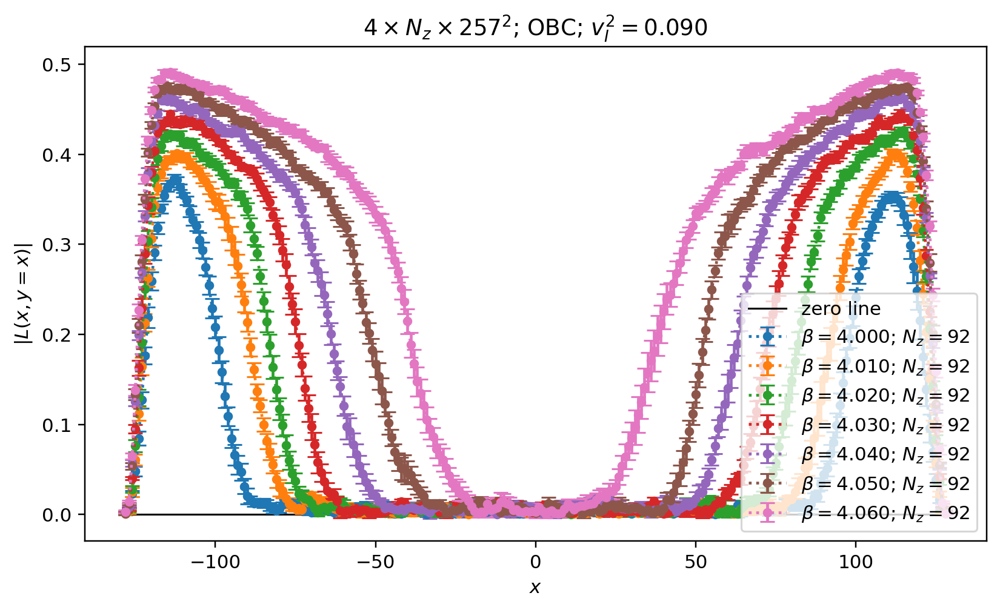

In [13]:
fig, ax = plotters.make_figure_and_111axis(plt)

# x_val = np.arange(-64, 65, 1)
x_val = np.arange(-128, 129, 1)
plt.plot(x_val, 0.0 * x_val, label="zero line", color="black", linewidth=1)

# plt.errorbar(x_val, ploop_val_ns129_pbc_4063_92, yerr=ploop_err_ns129_pbc_4063_92,
#              fmt="o:", label=r"$\beta = 4.063$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_pbc_4064_92, yerr=ploop_err_ns129_pbc_4064_92,
#              fmt="o:", label=r"$\beta = 4.064$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_pbc_4065_92, yerr=ploop_err_ns129_pbc_4065_92,
#              fmt="o:", label=r"$\beta = 4.065$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_pbc_4066_92, yerr=ploop_err_ns129_pbc_4066_92,
#              fmt="o:", label=r"$\beta = 4.066$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_pbc_4067_92, yerr=ploop_err_ns129_pbc_4067_92,
#              fmt="o:", label=r"$\beta = 4.067$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_pbc_4068_92, yerr=ploop_err_ns129_pbc_4068_92,
#              fmt="o:", label=r"$\beta = 4.068$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_pbc_4069_92, yerr=ploop_err_ns129_pbc_4069_92,
#              fmt="o:", label=r"$\beta = 4.069$; $N_z = 92$", capsize=4, markersize=4)

plt.errorbar(x_val, ploop_val_ns257_obc_4000_92, yerr=ploop_err_ns257_obc_4000_92,
             fmt="o:", label=r"$\beta = 4.000$; $N_z = 92$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_ns257_obc_4010_92, yerr=ploop_err_ns257_obc_4010_92,
             fmt="o:", label=r"$\beta = 4.010$; $N_z = 92$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_ns257_obc_4020_92, yerr=ploop_err_ns257_obc_4020_92,
             fmt="o:", label=r"$\beta = 4.020$; $N_z = 92$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_ns257_obc_4030_92, yerr=ploop_err_ns257_obc_4030_92,
             fmt="o:", label=r"$\beta = 4.030$; $N_z = 92$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_ns257_obc_4040_92, yerr=ploop_err_ns257_obc_4040_92,
             fmt="o:", label=r"$\beta = 4.040$; $N_z = 92$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_ns257_obc_4050_92, yerr=ploop_err_ns257_obc_4050_92,
             fmt="o:", label=r"$\beta = 4.050$; $N_z = 92$", capsize=4, markersize=4)
plt.errorbar(x_val, ploop_val_ns257_obc_4060_92, yerr=ploop_err_ns257_obc_4060_92,
             fmt="o:", label=r"$\beta = 4.060$; $N_z = 92$", capsize=4, markersize=4)

# plt.errorbar(x_val, ploop_val_ns129_4046_24, yerr=ploop_err_ns129_4046_24,
#              fmt="o:", label=r"$\beta = 4.046$; $N_z = 24$", capsize=4, markersize=4)

# plt.errorbar(x_val, ploop_val_ns129_4013_92, yerr=ploop_err_ns129_4013_92,
#              fmt="o:", label=r"$\beta = 4.013$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4019_92, yerr=ploop_err_ns129_4019_92,
#              fmt="o:", label=r"$\beta = 4.019$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4025_92, yerr=ploop_err_ns129_4025_92,
#              fmt="o:", label=r"$\beta = 4.025$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4031_92, yerr=ploop_err_ns129_4031_92,
#              fmt="o:", label=r"$\beta = 4.031$; $N_z = 92$", capsize=4, markersize=4)
# # plt.errorbar(x_val, ploop_val_ns129_4034_92, yerr=ploop_err_ns129_4034_92,
# #              fmt="o:", label=r"$\beta = 4.034$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4037_92, yerr=ploop_err_ns129_4037_92,
#              fmt="o:", label=r"$\beta = 4.037$; $N_z = 92$", capsize=4, markersize=4)
# # plt.errorbar(x_val, ploop_val_ns129_4040_92, yerr=ploop_err_ns129_4040_92,
# #              fmt="o:", label=r"$\beta = 4.040$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4043_92, yerr=ploop_err_ns129_4043_92,
#              fmt="o:", label=r"$\beta = 4.043$; $N_z = 92$", capsize=4, markersize=4)
# # plt.errorbar(x_val, ploop_val_ns129_4046_92, yerr=ploop_err_ns129_4046_92,
# #              fmt="o:", label=r"$\beta = 4.046$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4049_92, yerr=ploop_err_ns129_4049_92,
#              fmt="o:", label=r"$\beta = 4.049$; $N_z = 92$", capsize=4, markersize=4)
# # plt.errorbar(x_val, ploop_val_ns129_4052_92, yerr=ploop_err_ns129_4052_92,
# #              fmt="o:", label=r"$\beta = 4.052$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4055_92, yerr=ploop_err_ns129_4055_92,
#              fmt="o:", label=r"$\beta = 4.055$; $N_z = 92$", capsize=4, markersize=4)
# plt.errorbar(x_val, ploop_val_ns129_4061_92, yerr=ploop_err_ns129_4061_92,
#              fmt="o:", label=r"$\beta = 4.061$; $N_z = 92$", capsize=4, markersize=4)

# plt.errorbar(x_val, ploop_val_ns129_4046_368, yerr=ploop_err_ns129_4046_368,
#              fmt="o:", label=r"$\beta = 4.046$; $N_z = 368$; ($v_I^2 = 0.06$)", capsize=4, markersize=4)
plt.legend(loc="lower right")
# plt.xlabel("$T/T'_c$")
plt.xlabel("$x$")
# plt.ylabel("Polyakov loop susceptibility")
# plt.ylabel("$|\langle P \\rangle |$")
plt.ylabel("$|L(x, y = x)|$")
plt.title(r"$4 \times N_z \times 257^2$; OBC; $v_I^2 = 0.090$")
# plt.savefig(f"{output_dir_name}wilson_rotation/4x16x17x17/085lcp/ploop_val_v001.png")
# plt.savefig(f"{output_dir_name}wilson_rotation/4x16x17x17/085lcp/ploop_susc_v001.png")
plt.savefig(f"{output_dir_name}mixed_diag_obc_rs64_v3.png")
plt.show()

In [47]:
csv_filename = "../data/coefficients_common_Nt4_4x40x41x41_v2.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_40 = []
for row in _rows[1:]:
    rows_40.append([])
    for item in row:
        rows_40[-1].append(float(item))
rows_40 = np.array(rows_40)
print(rows_40)
kappa2_data_40 = rows_40[:, [0, 13, 14]]
a2_data_40 = rows_40[:, [0, 5, 6]]
print(kappa2_data_40, a2_data_40)

csv_filename = "../data/coefficients_common_Nt4_4x16x17x17.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_16 = []
for row in _rows[1:]:
    rows_16.append([])
    for item in row:
        rows_16[-1].append(float(item))
rows_16 = np.array(rows_16)
print(rows_16)
kappa2_data_16 = rows_16[:, [0, 13, 14]]
a2_data_16 = rows_16[:, [0, 5, 6]]
print(kappa2_data_16, a2_data_16)

csv_filename = "../data/kudrov_v000/data/4x16x21^2/columns_new/coefficients_common_Nt4.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_16_v2 = []
for row in _rows[1:]:
    rows_16_v2.append([])
    for item in row:
        rows_16_v2[-1].append(float(item))
rows_16_v2 = np.array(rows_16_v2)
print(rows_16_v2)
kappa2_data_16_v2 = rows_16_v2[:, [0, 13, 14]]
a2_data_16_v2 = rows_16_v2[:, [0, 5, 6]]
a1_data_16_v2 = rows_16_v2[:, [0, 3, 4]]
print(kappa2_data_16_v2, a2_data_16_v2)

csv_filename = "../data/kudrov_v002/5x20x25^2/columns_new/coefficients_common_Nt5.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_20 = []
for row in _rows[1:]:
    rows_20.append([])
    for item in row:
        rows_20[-1].append(float(item))
rows_20 = np.array(rows_20)
print(rows_20)
kappa2_data_20 = rows_20[:, [0, 13, 14]]
a2_data_20 = rows_20[:, [0, 5, 6]]
a1_data_20 = rows_20[:, [0, 3, 4]]
print(kappa2_data_20, a2_data_20)

csv_filename = "../data/kudrov_v002/6x24x31^2/columns_new/coefficients_common_Nt6.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_24 = []
for row in _rows[1:]:
    rows_24.append([])
    for item in row:
        rows_24[-1].append(float(item))
rows_24 = np.array(rows_24)
print(rows_24)
kappa2_data_24 = rows_24[:, [0, 13, 14]]
a2_data_24 = rows_24[:, [0, 5, 6]]
a1_data_24 = rows_24[:, [0, 3, 4]]
print(kappa2_data_24, a2_data_24)

csv_filename = "../data/kudrov_v002/6x24x31^2/columns_new/coefficients_chain0_common_Nt6.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_24_p0 = []
for row in _rows[1:]:
    rows_24_p0.append([])
    for item in row:
        rows_24_p0[-1].append(float(item))
rows_24_p0 = np.array(rows_24_p0)
kappa2_data_24_p0 = rows_24_p0[:, [0, 13, 14]]
a2_data_24_p0 = rows_24_p0[:, [0, 5, 6]]
a1_data_24_p0 = rows_24_p0[:, [0, 3, 4]]

csv_filename = "../data/kudrov_v002/6x24x31^2/columns_new/coefficients_chain1_common_Nt6.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_24_p1 = []
for row in _rows[1:]:
    rows_24_p1.append([])
    for item in row:
        rows_24_p1[-1].append(float(item))
rows_24_p1 = np.array(rows_24_p1)
kappa2_data_24_p1 = rows_24_p1[:, [0, 13, 14]]
a2_data_24_p1 = rows_24_p1[:, [0, 5, 6]]
a1_data_24_p1 = rows_24_p1[:, [0, 3, 4]]

csv_filename = "../data/kudrov_v002/6x24x31^2/columns_new/coefficients_chain2_common_Nt6.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_24_p2 = []
for row in _rows[1:]:
    rows_24_p2.append([])
    for item in row:
        rows_24_p2[-1].append(float(item))
rows_24_p2 = np.array(rows_24_p2)
kappa2_data_24_p2 = rows_24_p2[:, [0, 13, 14]]
a2_data_24_p2 = rows_24_p2[:, [0, 5, 6]]
a1_data_24_p2 = rows_24_p2[:, [0, 3, 4]]

csv_filename = "../data/kudrov_v002/6x24x31^2/columns_new/coefficients_chain3_common_Nt6.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_24_p3 = []
for row in _rows[1:]:
    rows_24_p3.append([])
    for item in row:
        rows_24_p3[-1].append(float(item))
rows_24_p3 = np.array(rows_24_p3)
kappa2_data_24_p3 = rows_24_p3[:, [0, 13, 14]]
a2_data_24_p3 = rows_24_p3[:, [0, 5, 6]]
a1_data_24_p3 = rows_24_p3[:, [0, 3, 4]]

csv_filename = "../data/kudrov_v002/6x24x31^2/columns_new/coefficients_chain4_common_Nt6.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_24_p4 = []
for row in _rows[1:]:
    rows_24_p4.append([])
    for item in row:
        rows_24_p4[-1].append(float(item))
rows_24_p4 = np.array(rows_24_p4)
kappa2_data_24_p4 = rows_24_p4[:, [0, 13, 14]]
a2_data_24_p4 = rows_24_p4[:, [0, 5, 6]]
a1_data_24_p4 = rows_24_p4[:, [0, 3, 4]]

csv_filename = "../data/kudrov_aspect_v001/5(15)x20x25^2/columns_new/coefficients_common_Nt5.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_nt5_rt3 = []
for row in _rows[1:]:
    rows_nt5_rt3.append([])
    for item in row:
        rows_nt5_rt3[-1].append(float(item))
rows_nt5_rt3 = np.array(rows_nt5_rt3)
kappa2_data_nt5_rt3 = rows_nt5_rt3[:, [0, 13, 14]]
a2_data_nt5_rt3 = rows_nt5_rt3[:, [0, 5, 6]]
a1_data_nt5_rt3 = rows_nt5_rt3[:, [0, 3, 4]]

csv_filename = "../data/kudrov_aspect_v001/5(25)x20x25^2/columns_new/coefficients_common_Nt5.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_nt5_rt5 = []
for row in _rows[1:]:
    rows_nt5_rt5.append([])
    for item in row:
        rows_nt5_rt5[-1].append(float(item))
rows_nt5_rt5 = np.array(rows_nt5_rt5)
kappa2_data_nt5_rt5 = rows_nt5_rt5[:, [0, 13, 14]]
a2_data_nt5_rt5 = rows_nt5_rt5[:, [0, 5, 6]]
a1_data_nt5_rt5 = rows_nt5_rt5[:, [0, 3, 4]]

csv_filename = "../data/kudrov_aspect_v001/5(20)x16x25^2/columns_new/coefficients_common_Nt5.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_nt5_rz3 = []
for row in _rows[1:]:
    rows_nt5_rz3.append([])
    for item in row:
        rows_nt5_rz3[-1].append(float(item))
rows_nt5_rz3 = np.array(rows_nt5_rz3)
kappa2_data_nt5_rz3 = rows_nt5_rz3[:, [0, 13, 14]]
a2_data_nt5_rz3 = rows_nt5_rz3[:, [0, 5, 6]]
a1_data_nt5_rz3 = rows_nt5_rz3[:, [0, 3, 4]]

csv_filename = "../data/kudrov_aspect_v001/5(20)x24x25^2/columns_new/coefficients_common_Nt5.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_nt5_rz5 = []
for row in _rows[1:]:
    rows_nt5_rz5.append([])
    for item in row:
        rows_nt5_rz5[-1].append(float(item))
rows_nt5_rz5 = np.array(rows_nt5_rz5)
kappa2_data_nt5_rz5 = rows_nt5_rz5[:, [0, 13, 14]]
a2_data_nt5_rz5 = rows_nt5_rz5[:, [0, 5, 6]]
a1_data_nt5_rz5 = rows_nt5_rz5[:, [0, 3, 4]]

csv_filename = "../data/kudrov_aspect_v001/5(20)x20x21^2/columns_new/coefficients_common_Nt5.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_nt5_rs4 = []
for row in _rows[1:]:
    rows_nt5_rs4.append([])
    for item in row:
        rows_nt5_rs4[-1].append(float(item))
rows_nt5_rs4 = np.array(rows_nt5_rs4)
kappa2_data_nt5_rs4 = rows_nt5_rs4[:, [0, 13, 14]]
a2_data_nt5_rs4 = rows_nt5_rs4[:, [0, 5, 6]]
a1_data_nt5_rs4 = rows_nt5_rs4[:, [0, 3, 4]]

csv_filename = "../data/kudrov_aspect_v001/5(20)x20x31^2/columns_new/coefficients_common_Nt5.csv"
_rows = []
with open(csv_filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=",", quotechar="|"):
        _rows.append(row)
rows_nt5_rs6 = []
for row in _rows[1:]:
    rows_nt5_rs6.append([])
    for item in row:
        rows_nt5_rs6[-1].append(float(item))
rows_nt5_rs6 = np.array(rows_nt5_rs6)
kappa2_data_nt5_rs6 = rows_nt5_rs6[:, [0, 13, 14]]
a2_data_nt5_rs6 = rows_nt5_rs6[:, [0, 5, 6]]
a1_data_nt5_rs6 = rows_nt5_rs6[:, [0, 3, 4]]


[[ 3.88000000e+00  1.88179583e-05  3.42894515e-05 -1.16434968e-02
   4.03837307e-01 -1.10205181e-02  3.89163287e-03  3.79710642e+01
   3.32028041e+01  1.31903959e+04  9.42298182e+03  3.68528762e+05
   1.12550239e+06 -6.22978667e-04  4.03706684e-01  3.81757129e+05
   1.12542880e+06  1.00000000e+02]
 [ 4.04000000e+00  7.67595420e-05  4.57600872e-05  1.28621974e-01
   5.97371473e-01 -1.39951539e-01  4.51651420e-03 -3.21155977e+02
   1.75277400e+02  1.67197356e+04  1.34290610e+04 -2.81876945e+06
   1.61578438e+06  2.68573513e-01  5.97112500e-01 -2.80237087e+06
   1.61515724e+06  1.00000000e+02]
 [ 4.12000000e+00  1.09555191e-05  4.11400434e-05 -1.30273582e+00
   6.12532266e-01 -5.25166444e+00  3.84004287e-03 -5.34789234e+01
   8.99595682e+01 -6.33514356e+03  1.40910819e+04  2.16975510e+06
   1.97739931e+06  3.94892862e+00  6.12492466e-01  2.16336648e+06
   1.97755156e+06  1.00000000e+02]
 [ 4.20000000e+00 -6.04746728e-05  4.24788926e-05 -1.26447534e+00
   6.00716649e-01 -3.62837890e+00  3.

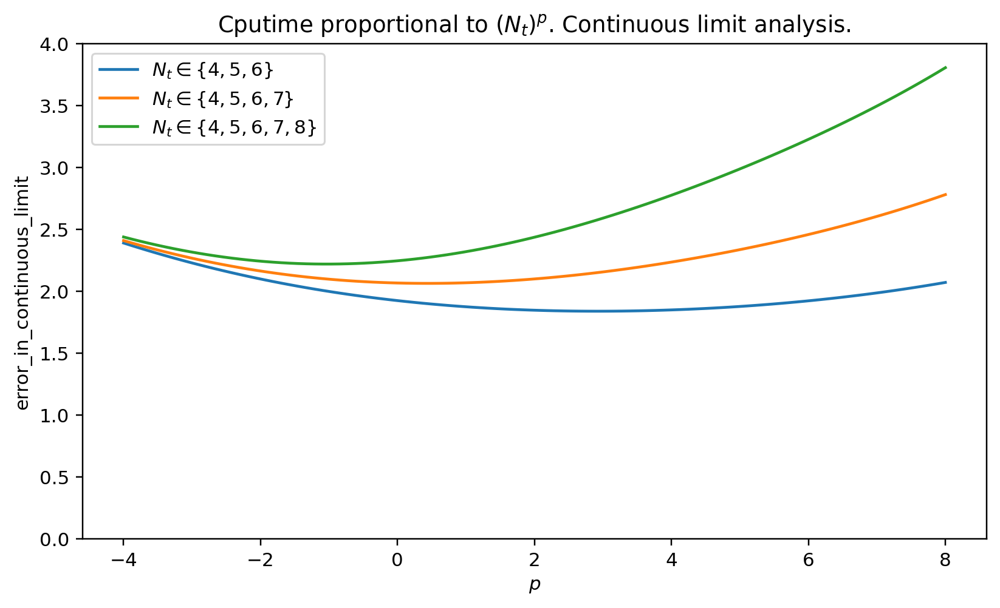

In [24]:
fig, ax = plotters.make_figure_and_111axis(plt)

nt_base = 6
nt6 = np.array([4, 5, 6]) / nt_base
nt7 = np.array([4, 5, 6, 7]) / nt_base
nt8 = np.array([4, 5, 6, 7, 8]) / nt_base

p_to_plot = np.linspace(-4.0, 8.0, 100)
sigma_sqr_nt6 = []
sigma_sqr_nt7 = []
sigma_sqr_nt8 = []
for p in p_to_plot:
    res = []
    for nt in [nt6, nt7, nt8]:
        c_inv = nt**(-8)
        x0 = nt**(0)
        x1 = nt**(-2)
        x2 = nt**(-4)
        z = nt**p / (nt**p).sum()
        delta = ((z * c_inv * x0).sum())*((z * c_inv * x2).sum()) - ((z * c_inv * x1).sum())**2
        sigma_sqr = ((z * c_inv * x2).sum()) / delta
        res.append(sigma_sqr**0.5)
    sigma_sqr_nt6.append(res[0])
    sigma_sqr_nt7.append(res[1])
    sigma_sqr_nt8.append(res[2])

plt.plot(p_to_plot, np_array_(sigma_sqr_nt6),
         linestyle="solid", label="$N_t \in \{4, 5, 6\}$", color="C0")
plt.plot(p_to_plot, np_array_(sigma_sqr_nt7),
         linestyle="solid", label="$N_t \in \{4, 5, 6, 7\}$", color="C1")
plt.plot(p_to_plot, np_array_(sigma_sqr_nt8),
         linestyle="solid", label="$N_t \in \{4, 5, 6, 7, 8\}$", color="C2")
plt.legend(loc="upper left")
plt.xlabel("$p$")
plt.ylabel("error_in_continuous_limit")
plt.title("Cputime proportional to $(N_t)^p$. Continuous limit analysis.")
plt.ylim([0.0, 4.0])
# ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}cont_limit_analysis_v0.png")
plt.show()


In [3]:
nt_base = 6
nt46 = np.array([4, 5, 6]) / nt_base
nt47 = np.array([4, 5, 6, 7]) / nt_base
nt57 = np.array([5, 6, 7]) / nt_base
nt48 = np.array([4, 5, 6, 7, 8]) / nt_base
nt58 = np.array([5, 6, 7, 8]) / nt_base
p = 4
nt = nt47
c_inv = nt**(-8)
x0 = nt**(0)
x1 = nt**(-2)
x2 = nt**(-4)
z = nt**p / (nt**p).sum()
delta = ((z * c_inv * x0).sum())*((z * c_inv * x2).sum()) - ((z * c_inv * x1).sum())**2
sigma_sqr = ((z * c_inv * x2).sum()) / delta
print(z)
print(z[1]**(-0.5))
print(sigma_sqr**0.5)

[0.05591962 0.1365225  0.28309305 0.52446483]
2.7064367718459637
2.235462461452339


In [3]:
# velocities_sqr = np.array(
#     [0.0000, 0.1225, 0.1732, 0.2121, 0.2449, 0.2732, 0.3000])**2
velocities_sqr = np.array([0.00, 0.15, 0.20, 0.25])**2
v_max = velocities_sqr[-1]
print(velocities_sqr)
print(v_max)

gamma_1 = (velocities_sqr**1).mean() / v_max**1
gamma_2 = (velocities_sqr**2).mean() / v_max**2
gamma_3 = (velocities_sqr**3).mean() / v_max**3
zeta = (gamma_1 * gamma_2 - gamma_3) / (gamma_1**2 - gamma_2)

print(f"gamma_1: {gamma_1:.6f}")
print(f"gamma_2: {gamma_2:.6f}")
print(f"gamma_3: {gamma_3:.6f}")
print(f"zeta: {zeta:.6f}")

[0.     0.0225 0.04   0.0625]
0.0625
gamma_1: 0.500000
gamma_2: 0.384800
gamma_3: 0.327200
zeta: 1.000000


In [ ]:
data1 = np.array([19.63, 19.57, 19.48, 19.50, 20.77])
data2 = np.array([19.87, 18.67, 18.95, 18.69, 18.70])
data3 = np.array([18.56, 19.50, 19.76, 18.57, 18.47])

data = data3
avg = data.mean()
std_avg = np.sqrt(((data - avg)**2).mean() / (len(data) - 1))
print(avg, std_avg)

# print(18.98 / 19.79)

In [3]:
foldername = "/Users/dimaros/PycharmProjects/scientificProject/data/wilson_qcd_rotation/4x16x17x17/085lcp/"
ploop_filenames = {
    0.0000: "t_abs_ploop_v0000.txt",
    0.1414: "t_abs_ploop_v1414.txt",
    0.2000: "t_abs_ploop_v2000.txt",
    0.2449: "t_abs_ploop_v2449.txt",
    0.2828: "t_abs_ploop_v2828.txt",
}
susc_filenames = {
    0.0000: "t_ploop_susc_v0000.txt",
    0.1414: "t_ploop_susc_v1414.txt",
    0.2000: "t_ploop_susc_v2000.txt",
    0.2449: "t_ploop_susc_v2449.txt",
    0.2828: "t_ploop_susc_v2828.txt",
}
velocities = np_array_([v for v in ploop_filenames])
ploops = dict()
for v in ploop_filenames:
    ploops[v] = np.array(sychev_csv_reader.load_float_csv(
        foldername + ploop_filenames[v]))
suscs = dict()
for v in ploop_filenames:
    suscs[v] = np.array(sychev_csv_reader.load_float_csv(
        foldername + susc_filenames[v]))

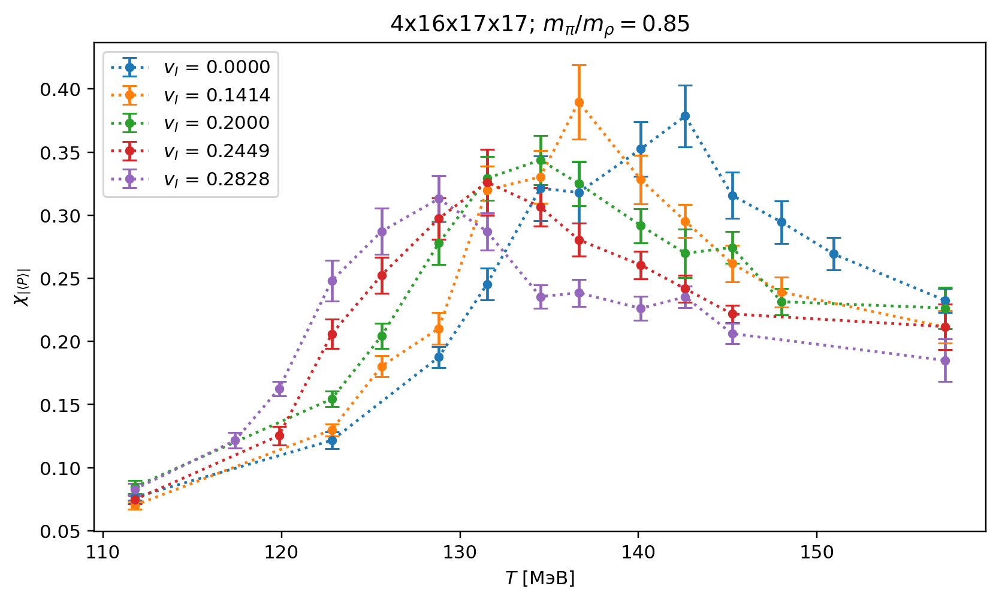

In [11]:
fig, ax = plotters.make_figure_and_111axis(plt)

# data = ploops
data = suscs
for v in velocities:
    x_val = data[v][:, 0]
    y_val = data[v][:, 1]
    y_err = data[v][:, 2]
    mva = data[v][:, 3]
    mv_in_mev = 775.0
    t_in_mev = mv_in_mev * 0.25 / mva
    plt.errorbar(t_in_mev, y_val, yerr=y_err,
                 fmt="o:", label=f"$v_I$ = {v:.4f}", capsize=4, markersize=4)
plt.legend(loc="upper left")
# plt.xlabel("$T/T'_c$")
plt.xlabel("$T$ [МэВ]")
# plt.ylabel("Polyakov loop susceptibility")
# plt.ylabel("$|\langle P \\rangle |$")
plt.ylabel("$\chi_{|\langle P \\rangle|}$")
plt.title(r"4x16x17x17; $m_{\pi}/m_{\rho} = 0.85$")
# plt.savefig(f"{output_dir_name}wilson_rotation/4x16x17x17/085lcp/ploop_val_v001.png")
# plt.savefig(f"{output_dir_name}wilson_rotation/4x16x17x17/085lcp/ploop_susc_v001.png")
plt.show()

In [8]:
filename = "/Users/dimaros/PycharmProjects/scientificProject/data/to_average.txt"
data_to_average = np_array_(
    row[0] for row in sychev_csv_reader.load_float_csv(filename))
print(data_to_average.mean())
print(data_to_average[:-1000].mean())
print(data_to_average[:-950].mean())
print(data_to_average[:-900].mean())
print(data_to_average[:-850].mean())
print(data_to_average[:-800].mean(), "<--------------------")
print(data_to_average[:-750].mean())
print(data_to_average[:-700].mean())
print(data_to_average[:-650].mean())
print(data_to_average[:-600].mean())
print(data_to_average[:-550].mean())
print(data_to_average[:-500].mean())
print(data_to_average[:-450].mean())
print(data_to_average[:-400].mean())

18.660471428571427
17.9532
18.19129
18.36813333333333
18.452424999999998
18.46754 <--------------------
18.50474333333333
18.49467142857143
18.5350725
18.584946666666664
18.600006
18.586220000000004
18.625096666666664
18.627132307692307


In [23]:
filename = "/Users/dimaros/PycharmProjects/scientificProject/data/tmp.txt"
rows = []
with open(filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter="\t", quotechar="|"):
        rows.append([float(item) for item in row])
tmp_data = np.array(rows)

pol_loops = tmp_data[-800:, 2]
spacial_volume = 16 * 17 * 17

def susceptibility(data: np.ndarray):
    return spacial_volume * (autocorr.mean(data**2) - autocorr.mean(data)**2)

target_binsize = 100
bracketing_factor = 1.01
bracketing_number = 11
binsizes = [
    int(target_binsize * bracketing_factor**p)
    for p in range(-bracketing_number//2, bracketing_number//2 + 1)]
print(binsizes)

susc_val, _ = autocorr.jackknife_meanstd_handler(
    pol_loops, 50, susceptibility)
susc_err_ = np_array_([
    autocorr.jackknife_meanstd_handler(pol_loops, binsize, susceptibility)[1]
    for binsize in binsizes
])
print(susc_err_)
susc_err = autocorr.mean(susc_err_)
print(susc_val, susc_err)

[94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105]
[0.00787033 0.00787033 0.00787033 0.00787033 0.00787033 0.00787033
 0.00787033 0.00906845 0.00906845 0.00906845 0.00906845 0.00906845]
0.16515052572351907 0.008369545460882994


In [24]:
# filename = "/Users/dimaros/PycharmProjects/scientificProject/data/tmp.txt"
# filename = "/Users/dimaros/PycharmProjects/scientificProject/data/LCP080_v000.txt"
filename = "/Users/dimaros/PycharmProjects/scientificProject/data/LCP065_v000.txt"
rows = []
with open(filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=" ", quotechar="|"):
        rows.append([float(item) for item in row])
tmp_data_v000 = np.array(rows)
print(tmp_data_v000)

t_per_tc_v000 = tmp_data_v000[:, 0]
print(t_per_tc_v000)
plaq_val_v000 = tmp_data_v000[:, 1]
plaq_err_v000 = tmp_data_v000[:, 2]
pol_loop_val_v000 = tmp_data_v000[:, 3]
pol_loop_err_v000 = tmp_data_v000[:, 4]
pol_susc_val_v000 = tmp_data_v000[:, 5]
pol_susc_err_v000 = tmp_data_v000[:, 6]

# filename = "/Users/dimaros/PycharmProjects/scientificProject/data/tmp.txt"
# filename = "/Users/dimaros/PycharmProjects/scientificProject/data/LCP080_v320.txt"
filename = "/Users/dimaros/PycharmProjects/scientificProject/data/LCP065_v320.txt"
rows = []
with open(filename, newline="") as csvfile:
    for row in csv.reader(csvfile, delimiter=" ", quotechar="|"):
        rows.append([float(item) for item in row])
tmp_data_v320 = np.array(rows)
print(tmp_data_v320)

t_per_tc_v320 = tmp_data_v320[:, 0]
print(t_per_tc_v320)
plaq_val_v320 = tmp_data_v320[:, 1]
plaq_err_v320 = tmp_data_v320[:, 2]
pol_loop_val_v320 = tmp_data_v320[:, 3]
pol_loop_err_v320 = tmp_data_v320[:, 4]
pol_susc_val_v320 = tmp_data_v320[:, 5]
pol_susc_err_v320 = tmp_data_v320[:, 6]

[[8.20000000e-01 3.81849049e-01 1.13908162e-04 3.10040571e-02
  4.50974997e-04 7.40166051e-02 4.53966983e-03]
 [8.60000000e-01 4.19135668e-01 1.30235318e-04 3.52230477e-02
  4.58054891e-04 8.19322915e-02 5.55071437e-03]
 [9.40000000e-01 4.60661482e-01 1.63204742e-04 4.66523833e-02
  5.37487468e-04 1.09260385e-01 4.07315336e-03]
 [1.00000000e+00 4.87422585e-01 2.07307923e-04 7.15225469e-02
  7.15773400e-04 1.59723537e-01 1.25340847e-02]
 [1.07000000e+00 5.17853917e-01 2.36209599e-04 1.25498265e-01
  9.49511164e-04 2.96858274e-01 3.08479760e-02]
 [1.18000000e+00 5.38699817e-01 1.37368895e-04 1.60917638e-01
  6.94870932e-04 1.65150526e-01 8.36954546e-03]]
[0.82 0.86 0.94 1.   1.07 1.18]
[[8.20000000e-01 3.99251810e-01 1.30224212e-04 3.11287763e-02
  4.75659778e-04 7.87527231e-02 7.65753411e-03]
 [8.60000000e-01 4.45022298e-01 2.64207648e-04 4.48962700e-02
  7.76671958e-04 1.31605302e-01 2.95924720e-02]
 [9.40000000e-01 5.06185787e-01 2.16423361e-04 1.09452224e-01
  6.79731533e-04 1.688996

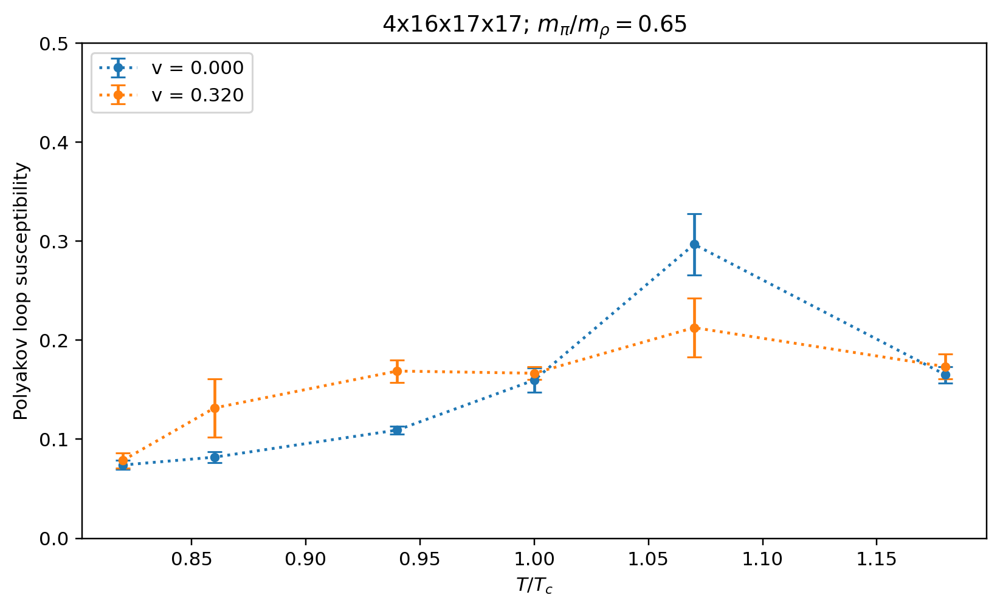

In [30]:
fig, ax = plotters.make_figure_and_111axis(plt)

plt.errorbar(t_per_tc_v000, pol_susc_val_v000, yerr=pol_susc_err_v000,
             fmt="o:", label="$v_I$ = 0.000", capsize=4, markersize=4)
plt.errorbar(t_per_tc_v320, pol_susc_val_v320, yerr=pol_susc_err_v320,
             fmt="o:", label="$v_I$ = 0.320", capsize=4, markersize=4)
plt.legend(loc="upper left")
plt.xlabel("$T/T_c$")
plt.ylabel("Polyakov loop susceptibility")
plt.title(r"4x16x17x17; $m_{\pi}/m_{\rho} = 0.65$")
plt.ylim([0, 0.5])
# plt.savefig(f"{output_dir_name}pol_susc_nt4_ns16_v002.png")
plt.show()

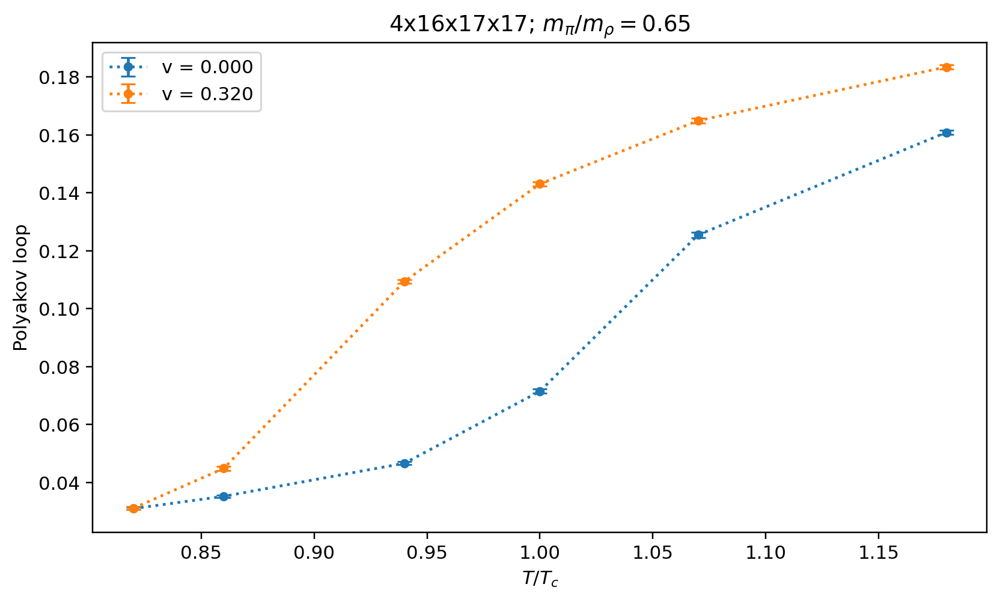

In [29]:
fig, ax = plotters.make_figure_and_111axis(plt)

plt.errorbar(t_per_tc_v000, pol_loop_val_v000, yerr=pol_loop_err_v000,
             fmt="o:", label="$v_I$ = 0.000", capsize=4, markersize=4)
plt.errorbar(t_per_tc_v320, pol_loop_val_v320, yerr=pol_loop_err_v320,
             fmt="o:", label="$v_I$ = 0.320", capsize=4, markersize=4)
plt.legend(loc="upper left")
plt.xlabel("$T/T_c$")
plt.ylabel("Polyakov loop")
plt.title(r"4x16x17x17; $m_{\pi}/m_{\rho} = 0.65$")
# plt.savefig(f"{output_dir_name}pol_loop_nt4_ns16_v001.png")
plt.show()

In [3]:
symanzik_scale_setter = scale_setters.SymanzikScaleSetter()
scale_setter_ext = scale_setters.ExtendedWilsonScaleSetter()
scale_setter = scale_setters.WilsonScaleSetter()
beta_critical_nt4_rs8_pbc = 4.072
beta_critical_nt4_rs16_pbc = 4.072
beta_critical_nt4_rs32_pbc = 4.071
beta_critical_nt4_rs8_obc = 4.095
beta_critical_nt4_rs16_obc = 4.079
beta_critical_nt4_rs32_obc = 4.072
beta_critical_nt4imp_obc = 4.088
beta_critical_nt5imp_obc = 4.225
beta_critical_nt6imp_obc = 4.350
beta_critical_nt7imp_obc = 4.470
beta_critical_nt8imp_obc = 4.580
beta_critical_nt4imp = 4.073
beta_critical_nt5imp = 4.202
beta_critical_nt6imp = 4.318
beta_critical_nt7imp = 4.417
beta_critical_nt8imp = 4.510
beta_critical_nt4 = 5.692
beta_critical_nt5 = 5.800
beta_critical_nt6 = 5.900
beta_critical_nt7 = 5.985
beta_critical_nt8 = 6.062
tc_in_mev_nt4_rs8_pbc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4_rs8_pbc], 4)[0]
tc_in_mev_nt4_rs16_pbc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4_rs16_pbc], 4)[0]
tc_in_mev_nt4_rs32_pbc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4_rs32_pbc], 4)[0]
tc_in_mev_nt4_rs8_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4_rs8_obc], 4)[0]
tc_in_mev_nt4_rs16_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4_rs16_obc], 4)[0]
tc_in_mev_nt4_rs32_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4_rs32_obc], 4)[0]
tc_in_mev_nt4imp_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4imp_obc], 4)[0]
tc_in_mev_nt5imp_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt5imp_obc], 5)[0]
tc_in_mev_nt6imp_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt6imp_obc], 6)[0]
tc_in_mev_nt7imp_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt7imp_obc], 7)[0]
tc_in_mev_nt8imp_obc = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt8imp_obc], 8)[0]
tc_in_mev_nt4imp = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt4imp], 4)[0]
tc_in_mev_nt5imp = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt5imp], 5)[0]
tc_in_mev_nt6imp = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt6imp], 6)[0]
tc_in_mev_nt7imp = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt7imp], 7)[0]
tc_in_mev_nt8imp = symanzik_scale_setter.get_temperature_in_mev(
    [beta_critical_nt8imp], 8)[0]
tc_in_mev_nt4 = scale_setter_ext.get_temperature_in_mev(
    [beta_critical_nt4], 4)[0]
tc_in_mev_nt5 = scale_setter.get_temperature_in_mev([beta_critical_nt5], 5)[0]
tc_in_mev_nt6 = scale_setter.get_temperature_in_mev([beta_critical_nt6], 6)[0]
tc_in_mev_nt7 = scale_setter.get_temperature_in_mev([beta_critical_nt7], 7)[0]
tc_in_mev_nt8 = scale_setter.get_temperature_in_mev([beta_critical_nt8], 8)[0]
print(f"Nt = 4 (imp; OBC); t_crit = {tc_in_mev_nt4imp_obc:.1f} MeV")
print(f"Nt = 5 (imp; OBC); t_crit = {tc_in_mev_nt5imp_obc:.1f} MeV")
print(f"Nt = 6 (imp; OBC); t_crit = {tc_in_mev_nt6imp_obc:.1f} MeV")
print(f"Nt = 7 (imp; OBC); t_crit = {tc_in_mev_nt7imp_obc:.1f} MeV")
print(f"Nt = 8 (imp; OBC); t_crit = {tc_in_mev_nt8imp_obc:.1f} MeV")
print(f"Nt = 4 (imp); t_crit = {tc_in_mev_nt4imp:.1f} MeV")
print(f"Nt = 5 (imp); t_crit = {tc_in_mev_nt5imp:.1f} MeV")
print(f"Nt = 6 (imp); t_crit = {tc_in_mev_nt6imp:.1f} MeV")
print(f"Nt = 7 (imp); t_crit = {tc_in_mev_nt7imp:.1f} MeV")
print(f"Nt = 8 (imp); t_crit = {tc_in_mev_nt8imp:.1f} MeV")
print(f"Nt = 4; t_crit = {tc_in_mev_nt4:.1f} MeV")
print(f"Nt = 5; t_crit = {tc_in_mev_nt5:.1f} MeV")
print(f"Nt = 6; t_crit = {tc_in_mev_nt6:.1f} MeV")
print(f"Nt = 7; t_crit = {tc_in_mev_nt7:.1f} MeV")
print(f"Nt = 8; t_crit = {tc_in_mev_nt8:.1f} MeV")

ntns40_v250_std_single_corrected = (
    autocorr_data.ntns40_v250_std_single_corrected)
ntns40_v000_std_single_corrected = (
    autocorr_data.ntns40_v000_std_single_corrected)
nt4_r10_v000_std_single_corrected = (
    autocorr_data.nt4_r10_v000_std_single_corrected)
nt4_r10_v250_std_single_corrected = (
    autocorr_data.nt4_r10_v250_std_single_corrected)
nt4_r10_v250_std_single_naive = autocorr_data.nt4_r10_v250_std_single_naive
nt4_r10_v000_std_single_naive = autocorr_data.nt4_r10_v000_std_single_naive
ntns40_v250_std_single_naive = autocorr_data.ntns40_v250_std_single_naive
ntns40_v000_std_single_naive = autocorr_data.ntns40_v000_std_single_naive

nt4_r10_v250_intcorrtime = {}
for beta in nt4_r10_v250_std_single_naive:
    if beta in nt4_r10_v250_std_single_corrected:
        nt4_r10_v250_intcorrtime[beta] = ((
            nt4_r10_v250_std_single_corrected[beta]
            / nt4_r10_v250_std_single_naive[beta]
        ) ** 2 - 1) / 2

nt4_r10_v000_intcorrtime = {}
for beta in nt4_r10_v000_std_single_naive:
    if beta in nt4_r10_v000_std_single_corrected:
        nt4_r10_v000_intcorrtime[beta] = ((
            nt4_r10_v000_std_single_corrected[beta]
            / nt4_r10_v000_std_single_naive[beta]
        ) ** 2 - 1) / 2

ntns40_v250_intcorrtime = {}
for beta in ntns40_v250_std_single_naive:
    if beta in ntns40_v250_std_single_corrected:
        ntns40_v250_intcorrtime[beta] = ((
            ntns40_v250_std_single_corrected[beta]
            / ntns40_v250_std_single_naive[beta]
        ) ** 2 - 1) / 2

ntns40_v000_intcorrtime = {}
for beta in ntns40_v000_std_single_naive:
    if beta in ntns40_v000_std_single_corrected:
        ntns40_v000_intcorrtime[beta] = ((
            ntns40_v000_std_single_corrected[beta]
            / ntns40_v000_std_single_naive[beta]
        ) ** 2 - 1) / 2

nt4_r10_vAll_slow_tau = autocorr_data.nt4_r10_vAll_slow_tau
nt4_r10_vAll_fraction_amplitude = autocorr_data.nt4_r10_vAll_fraction_amplitude
nt4_r6_vAll_slow_tau = autocorr_data.nt4_r6_vAll_slow_tau
nt4_r6_vAll_fraction_amplitude = autocorr_data.nt4_r6_vAll_fraction_amplitude

output_dir_name = "/Users/dimaros/PycharmProjects/scientificProject/results/"

MeV_in_tension_units = 1 / 440

colors = ["C0", "C1", "C2", "C3", "C4", "C5"]
r_colormap = {
    2: "C0",
    4: "C1",
    6: "C2",
    8: "C3",
    10: "C4",
    14: "C5",
    40/6: "C8",
    40/7: "C9",
}
velocity_colormap = {
    0.000: "C0",
    0.150: "C1",
    0.200: "C2",
    0.250: "C3",
    0.1225: "C1",
    0.1732: "C2",
    0.2121: "C3",
    0.2449: "C4",
    0.2739: "C5",
    0.3000: "C6",
}

calc_rs24_nt4_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs24_nt4_pbc.json")
# calc_rs24_nt4_pbc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt4_pbc.json",
#     integrator=integrators.QuadraticIntegrator())
calc_rs24_nt5_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs24_nt5_pbc.json")
# calc_rs24_nt5_pbc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt5_pbc.json",
#     integrator=integrators.QuadraticIntegrator())
calc_rs24_nt6_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs24_nt6_pbc.json")
# calc_rs24_nt6_pbc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt6_pbc.json",
#     integrator=integrators.QuadraticIntegrator())
# calc_rs24_nt7_pbc_t = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt7_pbc.json")
# calc_rs24_nt7_pbc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt7_pbc.json",
#     integrator=integrators.QuadraticIntegrator())
calc_rs24_nt4_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs24_nt4_obc.json")
# calc_rs24_nt4_obc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt4_obc.json",
#     integrator=integrators.QuadraticIntegrator())
# calc_rs24_nt5_obc_t = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt5_obc.json")
# calc_rs24_nt5_obc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt5_obc.json",
#     integrator=integrators.QuadraticIntegrator())
# calc_rs24_nt6_obc_t = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt6_obc.json")
# calc_rs24_nt6_obc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt6_obc.json",
#     integrator=integrators.QuadraticIntegrator())
# calc_rs24_nt7_obc_t = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt7_obc.json")
# calc_rs24_nt7_obc_q = calculator.Calculator.load_from_json(
#     "input_configs/to_input_rs24_nt7_obc.json",
#     integrator=integrators.QuadraticIntegrator())


calc_rs8_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_obc.json")
calc_rs8_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_obc.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs8_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_pbc.json")
calc_rs8_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_pbc.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs16_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_obc.json")
calc_rs16_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_obc.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs16_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_pbc.json")
calc_rs16_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_pbc.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs32_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_obc.json")
calc_rs32_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_obc.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs32_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_pbc.json")
calc_rs32_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_pbc.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs8c1_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_obc_cut1.json")
calc_rs8c1_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_obc_cut1.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs8c1_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_pbc_cut1.json")
calc_rs8c1_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_pbc_cut1.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs16c1_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_obc_cut1.json")
calc_rs16c1_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_obc_cut1.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs16c1_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_pbc_cut1.json")
calc_rs16c1_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_pbc_cut1.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs32c1_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_obc_cut1.json")
calc_rs32c1_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_obc_cut1.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs32c1_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_pbc_cut1.json")
calc_rs32c1_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_pbc_cut1.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs8c2_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_obc_cut2.json")
calc_rs8c2_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_obc_cut2.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs8c2_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_pbc_cut2.json")
calc_rs8c2_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs8_pbc_cut2.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs16c2_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_obc_cut2.json")
calc_rs16c2_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_obc_cut2.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs16c2_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_pbc_cut2.json")
calc_rs16c2_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs16_pbc_cut2.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs32c2_obc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_obc_cut2.json")
calc_rs32c2_obc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_obc_cut2.json",
    integrator=integrators.QuadraticIntegrator())
calc_rs32c2_pbc_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_pbc_cut2.json")
calc_rs32c2_pbc_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_rs32_pbc_cut2.json",
    integrator=integrators.QuadraticIntegrator())

calc_4so_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4s_obc_ns40.json")
calc_4so_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4s_obc_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_5so_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt5s_obc_ns40.json")
calc_5so_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt5s_obc_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_6so_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt6s_obc_ns40.json")
calc_6so_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt6s_obc_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_7so_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt7s_obc_ns40.json")
calc_7so_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt7s_obc_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_8so_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt8s_obc_ns40.json")
calc_8so_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt8s_obc_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_4s_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4s_ns40.json")
calc_4s_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4s_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_5s_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt5s_ns40.json")
calc_5s_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt5s_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_6s_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt6s_ns40.json")
calc_6s_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt6s_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_7s_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt7s_ns40.json")
calc_7s_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt7s_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_8s_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt8s_ns40.json")
calc_8s_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt8s_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_4s_ns32_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4s_ns32.json")
calc_4s_ns32_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4s_ns32.json",
    integrator=integrators.QuadraticIntegrator())
calc_4w_ns_all_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4w_ns8_16_24_32_40_56.json")
calc_4w_ns_all_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt4w_ns8_16_24_32_40_56.json",
    integrator=integrators.QuadraticIntegrator())
calc_5w_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt5w_ns40.json")
calc_5w_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt5w_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_6w_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt6w_ns40.json")
calc_6w_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt6w_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_7w_ns40_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt7w_ns40.json")
calc_7w_ns40_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt7w_ns40.json",
    integrator=integrators.QuadraticIntegrator())
calc_8w_ns32_t = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt8w_ns32.json")
calc_8w_ns32_q = calculator.Calculator.load_from_json(
    "input_configs/to_input_nt8w_ns32.json",
    integrator=integrators.QuadraticIntegrator())

Nt = 4 (imp; OBC); t_crit = 287.5 MeV
Nt = 5 (imp; OBC); t_crit = 290.1 MeV
Nt = 6 (imp; OBC); t_crit = 293.4 MeV
Nt = 7 (imp; OBC); t_crit = 298.7 MeV
Nt = 8 (imp; OBC); t_crit = 303.2 MeV
Nt = 4 (imp); t_crit = 280.0 MeV
Nt = 5 (imp); t_crit = 279.4 MeV
Nt = 6 (imp); t_crit = 279.7 MeV
Nt = 7 (imp); t_crit = 277.3 MeV
Nt = 8 (imp); t_crit = 276.1 MeV
Nt = 4; t_crit = 295.3 MeV
Nt = 5; t_crit = 295.2 MeV
Nt = 6; t_crit = 300.4 MeV
Nt = 7; t_crit = 300.8 MeV
Nt = 8; t_crit = 300.0 MeV


/Users/dimaros/PycharmProjects/scientificProject/notebooks/fitters.py:258: RuntimeWarning: invalid value encountered in sqrt
  self.c0_err = np.sqrt(np.diag(pcov))[0]
/Users/dimaros/PycharmProjects/scientificProject/notebooks/fitters.py:260: RuntimeWarning: invalid value encountered in sqrt
  self.c1_err = np.sqrt(np.diag(pcov))[1]
/Users/dimaros/PycharmProjects/scientificProject/notebooks/fitters.py:262: RuntimeWarning: invalid value encountered in sqrt
  self.c2_err = np.sqrt(np.diag(pcov))[2]
/Users/dimaros/opt/anaconda3/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/Users/dimaros/PycharmProjects/scientificProject/notebooks/fitters.py:263: RuntimeWarning: invalid value encountered in double_scalars
  self.c1c2_corr = pcov[1][2] / self.c1_err / self.c2_err


In [3]:
with open("input_configs/to_input_roenko_vsqr120.json") as f:
    data_to_load = json.load(f)
    data_holder_roenko_t = data_holder_module.EosDataHolder(
        data_to_load[0])
    data_holder_roenko_q = data_holder_module.EosDataHolder(
        data_to_load[0], integrator=integrators.QuadraticIntegrator())


In [8]:
data = tmp_data_v000[-300:, 1]
result_plaq = autocorr.bootstrap_meanstd_handler(data, 30, autocorr.mean)
print(result_plaq[0], result_plaq[1], result_plaq[0] / result_plaq[1])
data = tmp_data_v000[-300:, 2]
result_pl = autocorr.bootstrap_meanstd_handler(data, 30, autocorr.mean)
print(result_pl[0], result_pl[1], result_pl[0] / result_pl[1])
data = tmp_data_v000[-300:, 3]
result_ps = autocorr.bootstrap_meanstd_handler(data, 30, autocorr.mean)
print(result_ps[0], result_ps[1], result_ps[0] / result_ps[1])

print(result_pl[0]**2, result_ps[0],
      (result_ps[0] - result_pl[0]**2) / result_ps[1])

0.48689369625397844 0.0003478260938251442 1399.81934908755
0.07157597866237826 0.0008818294930375202 81.16759444711931
0.0051596302175717906 0.00012574409718353654 41.032782716160234
0.005123120721477228 0.0051596302175717906 0.2903475941401311


tau_naive = 7.135993428909304; error_factor = 3.907938952672957
tau_int = 45.98508756873698; error_factor = 9.642104289908607


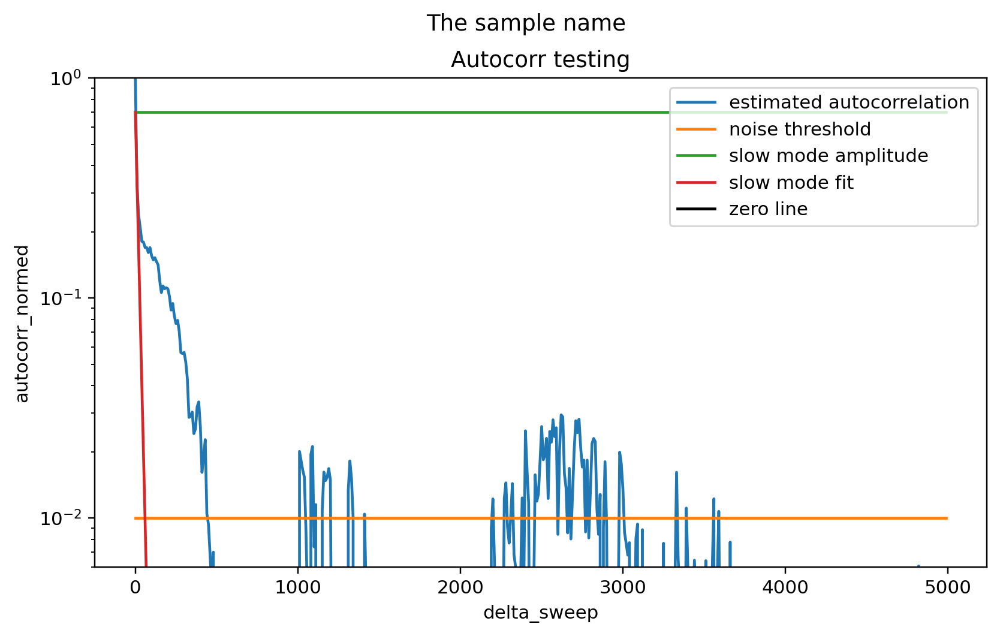

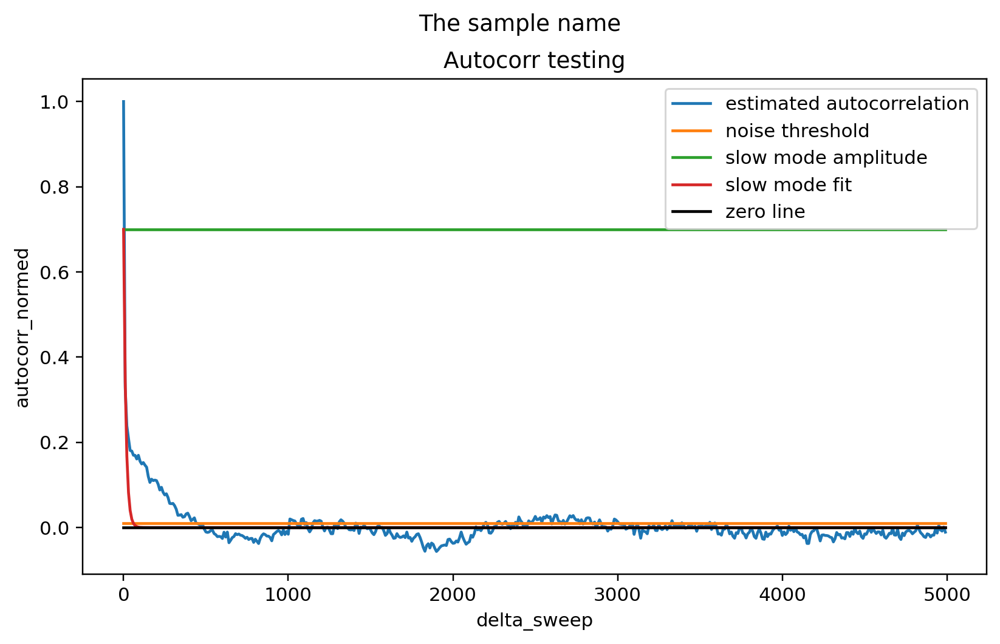

tau_est = 9.799999999999999; t_int = 45.98508756873698
beta = 5.66: std_binning_with_bracketing = 0.04784772172228648
naive error = 0.005306610259979547
err_factor [from binning]: 9.016626316640577
err_factor [from autocorr]: 9.642104289908607
(3.3025347358378196, 2.5762368874671654e-05)
2.5762368874671654e-05


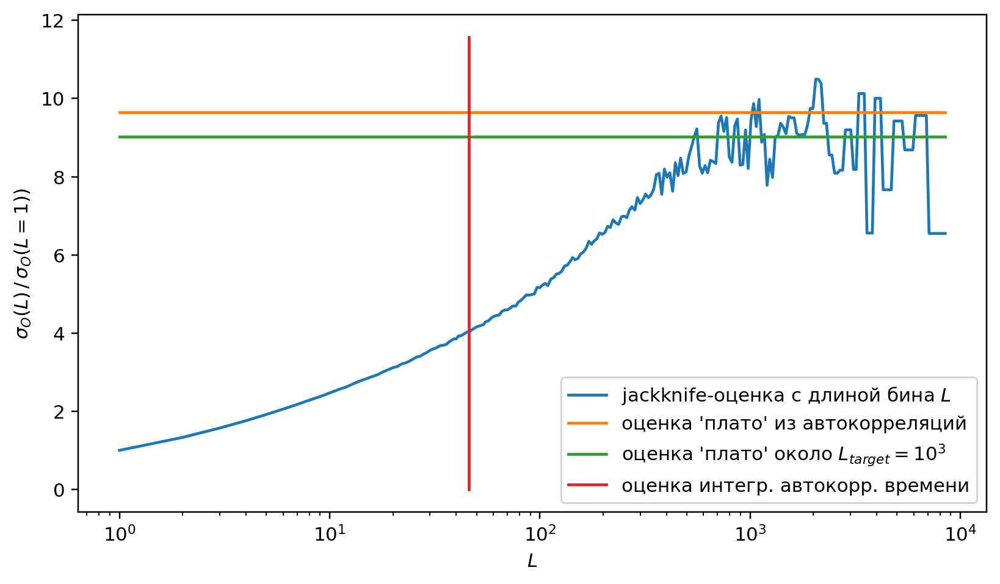

In [23]:
# lattice_str = "40x40x41^2"
# r_str = "r10"
# v_str = "v250"
lattice_str = "4x24x25^2"
r_str = "r6"
v_str = "v150"
# betas = [
#     "6.20", "6.30", "6.40", "6.50",
# ]
# betas = [
#     "6.20",
# ]
betas = [
    "5.66",
]
for beta_str in betas:
    sample_name = f"{lattice_str}/PBC_cV/{v_str}/{beta_str}"
    run_str = "run2011000"
    corr_filename = f"/Users/dimaros/PycharmProjects/scientificProject/data/raw_data/FixNt4Ns_run0_v000_{r_str}_p1/FixNt4Ns_run0_v000_{r_str}_p1/{lattice_str}/PBC_cV/{v_str}/{beta_str}/{run_str}/actionShort.txt"
    str_data = sychev_csv_reader.load_str_csv(corr_filename)
    data = np.array([float(str_data[i][2]) for i in range(1, len(str_data))])
    # data = pol_loops
    # sample_name = "Polyakov loop; 4x16x17x17"
    sample_name = "The sample name"

    # print(float(beta_str))
    # print(len(data))
    corr_class = autocorr.AutocorrCalculator()
    tau_naive = corr_class.get_naive_autocorr_time(data)
    print(f"tau_naive = {tau_naive}; error_factor = {np.sqrt(1 + 2 * tau_naive)}")
    # threshold = 3 / np.sqrt(len(data))
    threshold = 0.01
    tau_int = corr_class.get_integrated_autocorr_time(data, threshold)
    # print(threshold)
    print(f"tau_int = {tau_int}; error_factor = {np.sqrt(1 + 2 * tau_int)}")

    fig, ax = plotters.make_figure_and_111axis(plt)

    step = 10
    # diff = len(data) // 3
    diff = 5000
    y_val = corr_class.get_autocorr_normed(data, diff, step)
    x_val = step * np.array(range(len(y_val)))
    amplitude = 0.7
    slow_tau = 14
    plt.plot(x_val, y_val, label="estimated autocorrelation")
    plt.plot(x_val, [threshold for _ in x_val], label="noise threshold")
    plt.plot(x_val, [amplitude for _ in x_val], label="slow mode amplitude")
    plt.plot(x_val, amplitude * np.exp(-x_val / slow_tau), label="slow mode fit")
    plt.plot(x_val, 0.0 * x_val, color="black", label="zero line")
    plt.legend(loc="upper right")
    plt.xlabel("delta_sweep")
    plt.ylabel("autocorr_normed")
    plt.title("Autocorr testing")
    plt.suptitle(sample_name)
    limits = [0.006, 1.0]
    plt.ylim(limits)
    ax.set_yscale("log")
    # plt.savefig(f"{output_dir_name}autocorr_example004_v1.png")
    plt.show()
    #
    fig, ax = plotters.make_figure_and_111axis(plt)
    #
    # step = 50
    # diff = len(data) // 3
    # # diff = 5000
    y_val = corr_class.get_autocorr_normed(data, diff, step)
    x_val = step * np.array(range(len(y_val)))
    plt.plot(x_val, y_val, label="estimated autocorrelation")
    plt.plot(x_val, threshold * np.ones(len(x_val)), label="noise threshold")
    plt.plot(x_val, amplitude * np.ones(len(x_val)), label="slow mode amplitude")
    plt.plot(x_val, amplitude * np.exp(-x_val / slow_tau), label="slow mode fit")
    plt.plot(x_val, np.zeros(len(x_val)), color="black", label="zero line")
    plt.legend(loc="upper right")
    plt.xlabel("delta_sweep")
    plt.ylabel("autocorr_normed")
    plt.title("Autocorr testing")
    plt.suptitle(sample_name)
    # plt.ylim([0.01, 1.00])
    # plt.savefig(f"{output_dir_name}autocorr_example004_v2.png")
    plt.show()
    #
    print(f"tau_est = {amplitude * slow_tau}; t_int = {tau_int}")

    # target_binsize = 1
    # res = autocorr.bootstrap_meanstd_handler(data, target_binsize,
    #                                          autocorr.mean)
    # # print(res)
    # std_single_naive = res[1] * np.sqrt(len(data))
    # print(beta_str, std_single_naive)

    # target_binsize = 50
    target_binsize = 1000
    bracketing_factor = 1.01
    bracketing_number = 15
    binsizes = [
        int(target_binsize * bracketing_factor**p)
        for p in range(-bracketing_number//2, bracketing_number//2 + 1)]
    # binsizes = [len(data) // bin_count
    #             for bin_count in [8, 9, 10, 11, 12]]
    dev = np.array(
        [autocorr.bootstrap_meanstd_handler(data, bin_size, autocorr.mean)[1]
         for bin_size in binsizes])

    # std_binning_with_bracketing = dev.mean() * np.sqrt(len(data))
    std_binning_with_bracketing = dev.mean() * np.sqrt(len(data))
    print(f"beta = {beta_str}: "
          f"std_binning_with_bracketing = {std_binning_with_bracketing}")

    # fig, ax = plotters.make_figure_and_111axis(plt)
    #
    # min_bin_size = 1
    # # max_bin_size = len(data) // 5
    # max_bin_size = len(data) // 3
    # bin_size_step_factor = 1.01
    #
    # bin_sizes_to_plot = autocorr.int_log_range(min_bin_size, max_bin_size,
    #                                            bin_size_step_factor)
    # # sychev_results = np.array([
    # #     autocorr.bootstrap_meanstd_handler(data, bin_size, autocorr.mean)
    # #     for bin_size in bin_sizes_to_plot
    # # ]) * np.sqrt(len(data))
    # sychev_results = np.array([
    #     autocorr.bootstrap_meanstd_handler(data, bin_size, susceptibility)
    #     for bin_size in bin_sizes_to_plot
    # ]) * np.sqrt(2 * len(data))
    #
    # ax.errorbar(bin_sizes_to_plot, sychev_results[:, 1],
    #             label="from binning")
    # # ax.errorbar(bin_sizes_to_plot,
    # #             [std_binning_with_bracketing for _ in bin_sizes_to_plot],
    # #             label="std binning with bracketing")
    # # ax.errorbar([target_binsize, target_binsize],
    # #             [0.0, 1.2 * std_binning_with_bracketing],
    # #             label="target binsize")
    # plt.legend(loc="upper left")
    # plt.xlabel("bin_size")
    # # plt.ylabel("error")
    # plt.ylabel("error of susceptibility")
    # plt.suptitle(sample_name)
    # plt.title("Binning testing; (max_binsize = len(data) // 5)")
    # ax.set_xscale("log")
    # # plt.savefig(f"{output_dir_name}autocorr_example004_v3.png")
    # plt.show()

    std_naive = (autocorr.bootstrap_meanstd_handler(data, 1, autocorr.mean)[1]
                 * np.sqrt(len(data)))
    print("naive error =", std_naive)
    print("err_factor [from binning]:",
          std_binning_with_bracketing / std_naive)
    print("err_factor [from autocorr]:", np.sqrt(1 + 2 * tau_int))

    fig, ax = plotters.make_figure_and_111axis(plt)

    min_bin_size = 1
    max_bin_size = len(data) // 5
    bin_size_step_factor = 1.03

    bin_sizes_to_plot = autocorr.int_log_range(min_bin_size, max_bin_size,
                                               bin_size_step_factor)
    sychev_results = np.array(
        [autocorr.bootstrap_meanstd_handler(data, bin_size, autocorr.mean)
         for bin_size in bin_sizes_to_plot])
    res = autocorr.bootstrap_meanstd_handler(data, 1, autocorr.mean)
    error_naive = res[1]
    print(res)
    print(error_naive)
    # tau_int_est = amplitude * slow_tau
    tau_int_est = tau_int
    # tau_int_est = 0.5
    ax.errorbar(bin_sizes_to_plot, sychev_results[:, 1] / error_naive,
                # label="from binning",
                label="jackknife-оценка c длиной бина $L$",
                )
    ax.errorbar(bin_sizes_to_plot,
                [np.sqrt(1 + 2 * tau_int_est) for _ in bin_sizes_to_plot],
                # label="from autocorrelations",
                label="оценка 'плато' из автокорреляций",
                )
    ax.errorbar(bin_sizes_to_plot,
                [std_binning_with_bracketing / np.sqrt(len(data)) / error_naive
                 for _ in bin_sizes_to_plot],
                # label="from binning (mean)",
                label="оценка 'плато' около $L_{target} = 10^3$",
                )
    ax.errorbar([tau_int_est, tau_int_est],
                [0.0, 1.2 * np.sqrt(1 + 2 * tau_int_est)],
                # label="integrated autocorr time",
                label="оценка интегр. автокорр. времени",
                )
    plt.legend(loc="lower right")
    plt.xlabel("$L$")
    plt.ylabel(r"$\sigma_O(L)\, /\, \sigma_O(L = 1))$")
    # plt.suptitle(sample_name)
    # plt.title("Binning testing; (max_binsize = len(data) // 5)")
    # plt.title("")
    ax.set_xscale("log")
    # plt.savefig(f"{output_dir_name}autocorr_diploma_v0.png")
    plt.show()

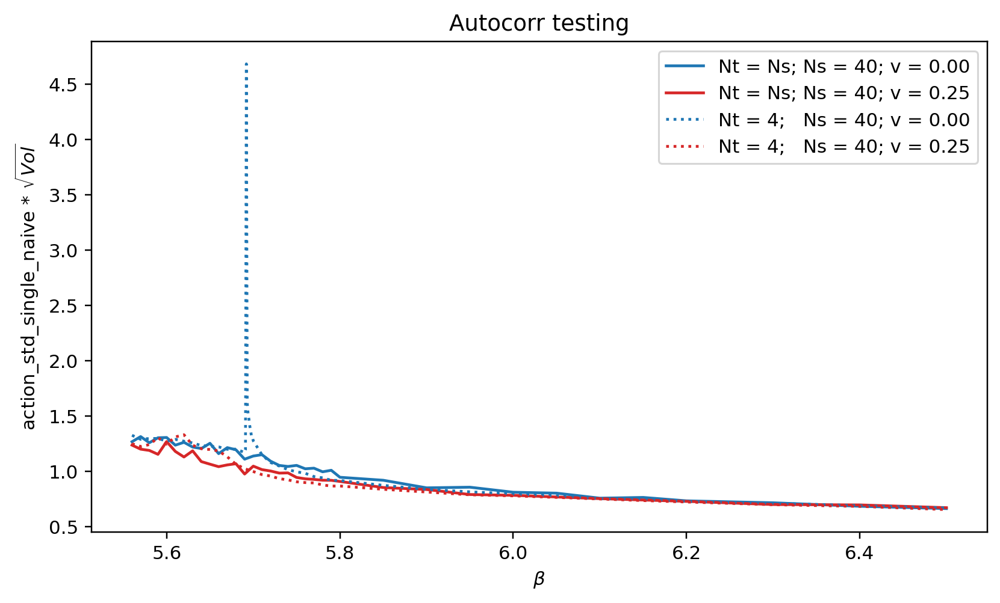

In [5]:
_, _ = plotters.make_figure_and_111axis(plt)

space_vol = 40 * 41 * 41
plt.plot(
    np_array_(ntns40_v000_std_single_naive.keys()),
    np_array_(ntns40_v000_std_single_naive.values()) * np.sqrt(40 * space_vol),
    linestyle="solid", label="$N_t$ = $N_s$; $N_s$ = 40; $v_I$ = 0.00", color="C0")
plt.plot(
    np_array_(ntns40_v250_std_single_naive.keys()),
    np_array_(ntns40_v250_std_single_naive.values()) * np.sqrt(40 * space_vol),
    linestyle="solid", label="$N_t$ = $N_s$; $N_s$ = 40; $v_I$ = 0.25", color="C3")
plt.plot(
    np_array_(nt4_r10_v000_std_single_naive.keys()),
    np_array_(nt4_r10_v000_std_single_naive.values()) * np.sqrt(4 * space_vol),
    linestyle="dotted", label="$N_t$ = 4;   $N_s$ = 40; $v_I$ = 0.00", color="C0")
plt.plot(
    np_array_(nt4_r10_v250_std_single_naive.keys()),
    np_array_(nt4_r10_v250_std_single_naive.values()) * np.sqrt(4 * space_vol),
    linestyle="dotted", label="$N_t$ = 4;   $N_s$ = 40; $v_I$ = 0.25", color="C3")
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel("action_std_single_naive * " + r"$\sqrt{Vol}$")
plt.title("Autocorr testing")
# plt.ylim([0.6, 1.4])
# plt.savefig(f"{output_dir_name}action_naive_std_v2.png")
plt.show()

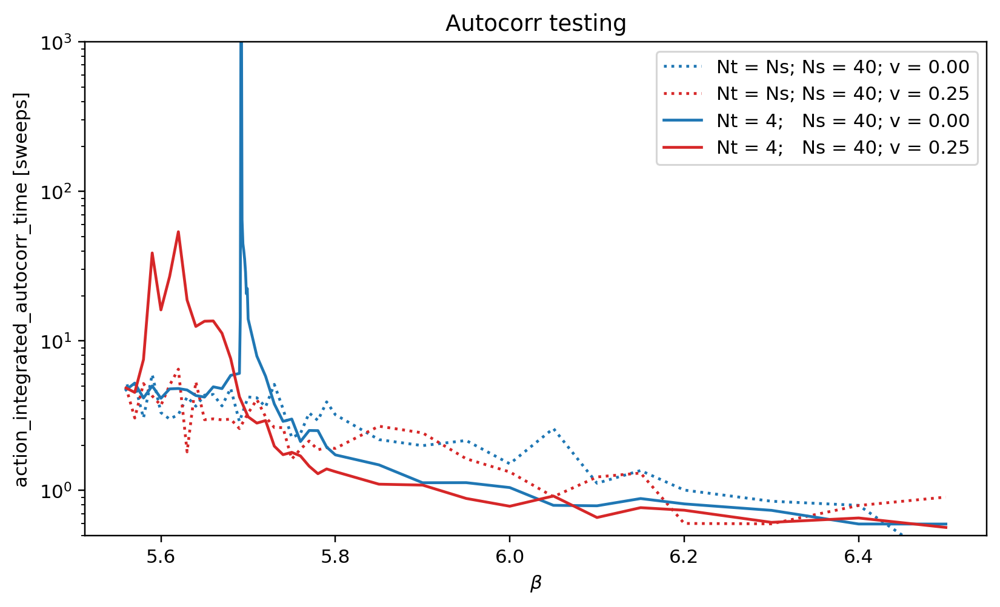

In [6]:
fig, ax = plotters.make_figure_and_111axis(plt)

plt.plot(np_array_(ntns40_v000_intcorrtime.keys()),
         np_array_(ntns40_v000_intcorrtime.values()),
         linestyle="dotted", label="$N_t$ = $N_s$; $N_s$ = 40; $v_I$ = 0.00", color="C0")
plt.plot(np_array_(ntns40_v250_intcorrtime.keys()),
         np_array_(ntns40_v250_intcorrtime.values()),
         linestyle="dotted", label="$N_t$ = $N_s$; $N_s$ = 40; $v_I$ = 0.25", color="C3")
plt.plot(np_array_(nt4_r10_v000_intcorrtime.keys()),
         np_array_(nt4_r10_v000_intcorrtime.values()),
         linestyle="solid", label="$N_t$ = 4;   $N_s$ = 40; $v_I$ = 0.00", color="C0")
plt.plot(np_array_(nt4_r10_v250_intcorrtime.keys()),
         np_array_(nt4_r10_v250_intcorrtime.values()),
         linestyle="solid", label="$N_t$ = 4;   $N_s$ = 40; $v_I$ = 0.25", color="C3")
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel("action_integrated_autocorr_time [sweeps]")
plt.title("Autocorr testing")
plt.ylim([0.5, 1000.0])
ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}action_integrated_autocorr_time_v1.png")
plt.show()

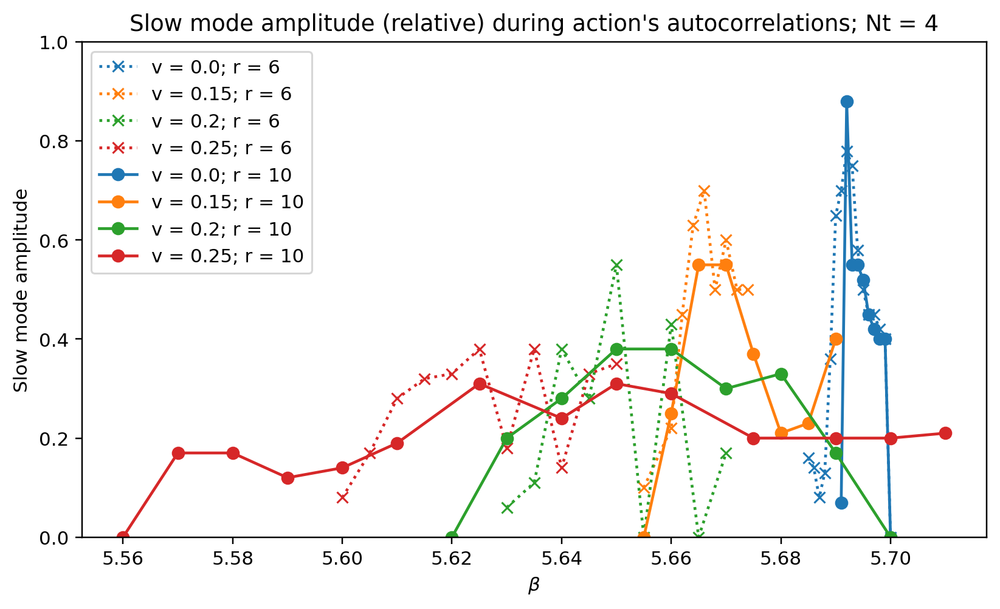

In [7]:
_, ax = plotters.make_figure_and_111axis(plt)

for v in nt4_r6_vAll_fraction_amplitude:
    x_val = np_array_(nt4_r6_vAll_fraction_amplitude[v].keys())
    y_val = np_array_(nt4_r6_vAll_fraction_amplitude[v].values())
    plt.errorbar(x_val, y_val, fmt="x:", label=f"$v_I$ = {v:.2f}; r = 6",
                 color=velocity_colormap[v])
for v in nt4_r10_vAll_fraction_amplitude:
    x_val = np_array_(nt4_r10_vAll_fraction_amplitude[v].keys())
    y_val = np_array_(nt4_r10_vAll_fraction_amplitude[v].values())
    plt.errorbar(x_val, y_val, fmt="o-", label=f"$v_I$ = {v:.2f}; r = 10",
                 color=velocity_colormap[v])
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
plt.ylabel("Slow mode amplitude")
plt.title("Slow mode amplitude (relative) during action's autocorrelations; $N_t$ = 4")
plt.ylim([0.0, 1.0])
# plt.savefig(f"{output_dir_name}autocorr_slow_mode_amplitude_nt4.png")
plt.show()

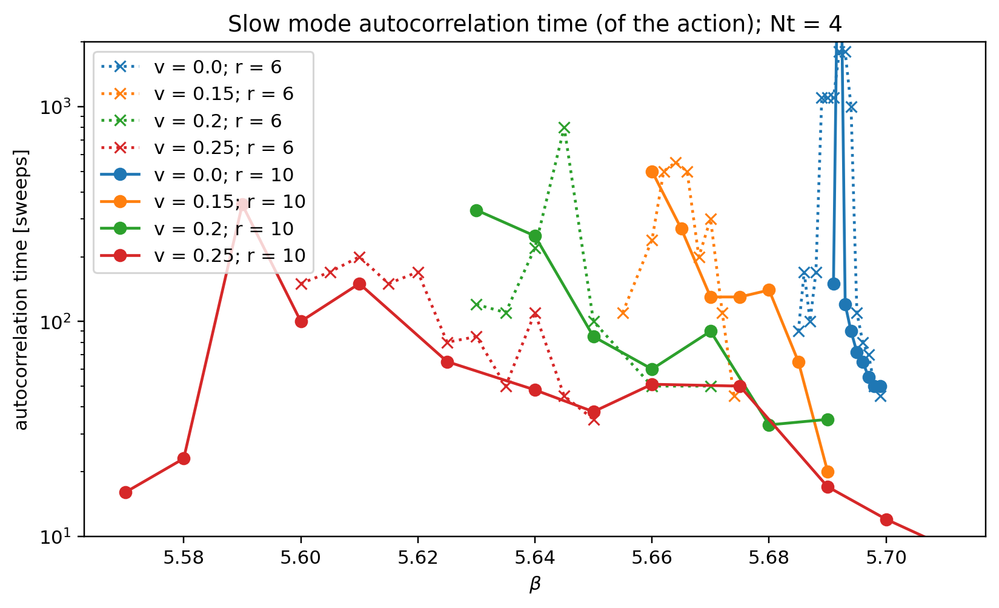

In [8]:
fig, ax = plotters.make_figure_and_111axis(plt)

for v in nt4_r6_vAll_slow_tau:
    x_val = np_array_(nt4_r6_vAll_slow_tau[v].keys())
    y_val = np_array_(nt4_r6_vAll_slow_tau[v].values())
    plt.errorbar(x_val, y_val, fmt="x:", label=f"$v_I$ = {v:.2f}; r = 6",
                 color=velocity_colormap[v])
for v in nt4_r10_vAll_slow_tau:
    x_val = np_array_(nt4_r10_vAll_slow_tau[v].keys())
    y_val = np_array_(nt4_r10_vAll_slow_tau[v].values())
    plt.errorbar(x_val, y_val, fmt="o-", label=f"$v_I$ = {v:.2f}; r = 10",
                 color=velocity_colormap[v])
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
plt.ylabel("autocorrelation time [sweeps]")
plt.title("Slow mode autocorrelation time (of the action); $N_t$ = 4")
plt.ylim([10, 2000])
ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}autocorr_slow_mode_tau_nt4.png")
plt.show()

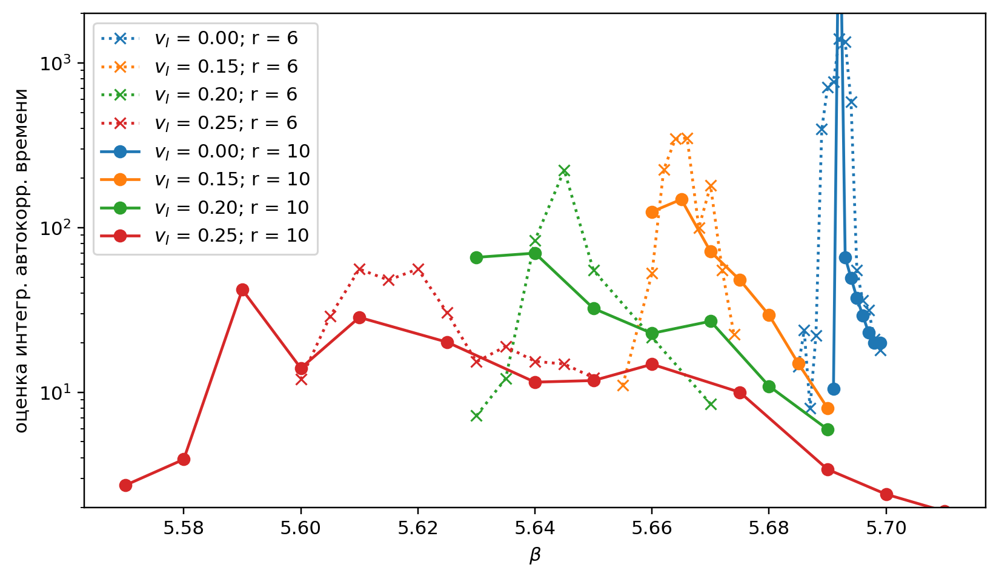

In [38]:
fig, ax = plotters.make_figure_and_111axis(plt)

for v in nt4_r6_vAll_slow_tau:
    x_val = np_array_(nt4_r6_vAll_slow_tau[v].keys())
    y_val = [
        nt4_r6_vAll_slow_tau[v][beta] * nt4_r6_vAll_fraction_amplitude[v][beta]
        for beta in x_val]
    plt.errorbar(x_val, y_val, fmt="x:", label=f"$v_I$ = {v:.2f}; r = 6",
                 color=velocity_colormap[v])
for v in nt4_r10_vAll_slow_tau:
    x_val = np_array_(nt4_r10_vAll_slow_tau[v].keys())
    y_val = [
        nt4_r10_vAll_slow_tau[v][beta]*nt4_r10_vAll_fraction_amplitude[v][beta]
        for beta in x_val]
    plt.errorbar(x_val, y_val, fmt="o-", label=f"$v_I$ = {v:.2f}; r = 10",
                 color=velocity_colormap[v])
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
# plt.ylabel("integrated action's autocorrelation time [sweeps]")
plt.ylabel("оценка интегр. автокорр. времени")
# plt.title("Slow mode's contribution to action's integrated autocorrelation time; $N_t$ = 4")
# plt.title("Slow mode's contribution to action's integrated autocorrelation time; $N_t$ = 4")
plt.ylim([2, 2000])
ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}autocorr_slow_mode_intcorrtime_nt4.png")
# plt.savefig(f"{output_dir_name}autocorr_slow_mode_intcorrtime_nt4_diploma_v0.png")
plt.show()

In [6]:
r = 40/7
# r = 8.0
# r = 4.0
r_group = calc_7s_ns40_t.r_groups[r].data_holders
for holder in sorted(r_group, key=(lambda x: x.velocity)):
    fraction = holder._deltaS_Nt4_err_fraction
    print(f"v = {holder.velocity:.4f}")
    for val in fraction:
        print(f"(t_err / o_err)**2 = {val**2:.2f}")
    print("--------------------------------")

v = 0.0000
(t_err / o_err)**2 = 0.63
(t_err / o_err)**2 = 1.37
(t_err / o_err)**2 = 1.55
(t_err / o_err)**2 = 0.60
(t_err / o_err)**2 = 0.45
(t_err / o_err)**2 = 0.56
(t_err / o_err)**2 = 0.31
(t_err / o_err)**2 = 0.53
(t_err / o_err)**2 = 0.27
(t_err / o_err)**2 = 0.37
(t_err / o_err)**2 = 0.44
--------------------------------
v = 0.1225
(t_err / o_err)**2 = 0.71
(t_err / o_err)**2 = 0.41
(t_err / o_err)**2 = 1.86
(t_err / o_err)**2 = 0.74
(t_err / o_err)**2 = 0.26
(t_err / o_err)**2 = 0.51
(t_err / o_err)**2 = 0.35
(t_err / o_err)**2 = 0.55
(t_err / o_err)**2 = 0.36
(t_err / o_err)**2 = 0.57
(t_err / o_err)**2 = 0.35
--------------------------------
v = 0.1732
(t_err / o_err)**2 = 0.24
(t_err / o_err)**2 = 0.78
(t_err / o_err)**2 = 9.58
(t_err / o_err)**2 = 0.64
(t_err / o_err)**2 = 0.48
(t_err / o_err)**2 = 0.37
(t_err / o_err)**2 = 0.28
(t_err / o_err)**2 = 0.20
(t_err / o_err)**2 = 0.28
(t_err / o_err)**2 = 0.32
(t_err / o_err)**2 = 0.32
--------------------------------
v = 0.2121

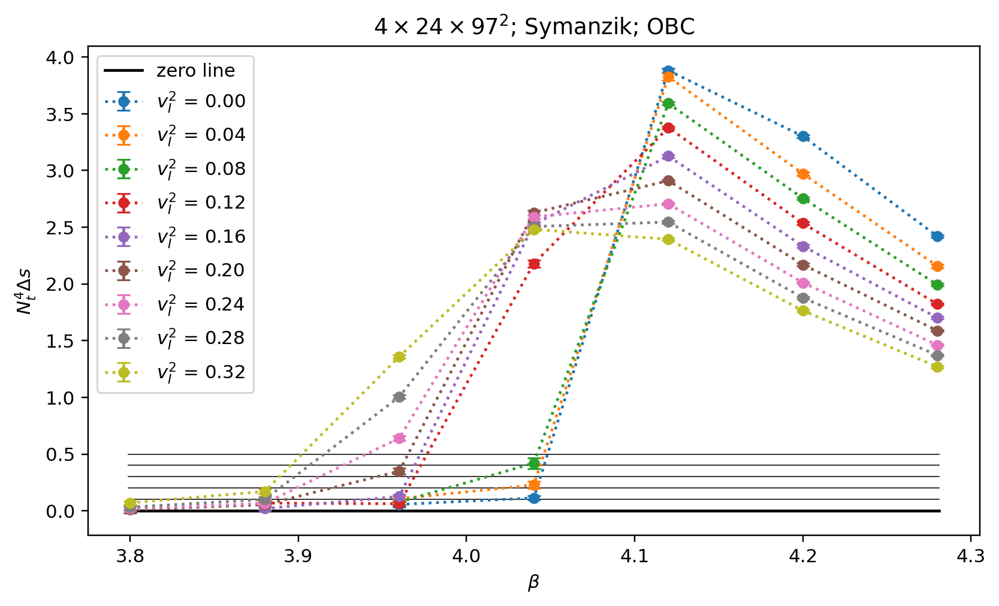

In [8]:
fig, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((5.50, 5.70))  # nt = 4
# target_domain = domains.GeometricRange((5.73, 5.97))  # nt = 6
# target_domain = domains.GeometricRange((5.80, 6.10))  # nt = 8

# target_domain = domains.GeometricRange((0.50, 2.50))  # t_per_tc
# velocities = np.array([
#     0.0000,
# #     0.1225,
#     0.1732,
# #     0.2121,
#     0.2449,
# #     0.2739,
#     0.3000,
# ])

# target_domain = domains.GeometricRange((3.759, 4.161))  # 
# target_domain = domains.GeometricRange((3.9199, 4.161))  # 

# target_domain = domains.GeometricRange((4.009, 4.081))  #

# target_domain = domains.GeometricRange((3.849, 4.071))  #

# target_domain = domains.GeometricRange((4.059, 4.161))  #
# target_domain = domains.GeometricRange((3.959, 4.201))  #

# target_domain = domains.GeometricRange((4.059, 4.101))  #

target_domain = domains.GeometricRange((3.799, 4.281))  #

r = 30/5
# r = 8.0

r_group = calc_rs24_nt4_obc_t.r_groups[r].data_holders
# r_group = calc_5s_ns40_t.r_groups[r].data_holders
# x_val = np.linspace(3.6, 5.0, 1000)
x_val = np.linspace(target_domain.left, target_domain.right, 100)
plt.plot(x_val, 0.0 * x_val, label="zero line", color="black", linewidth=1.5)
plt.plot(x_val, 0.0 * x_val + 0.1, color="black", linewidth=0.5)
plt.plot(x_val, 0.0 * x_val + 0.2, color="black", linewidth=0.5)
plt.plot(x_val, 0.0 * x_val + 0.3, color="black", linewidth=0.5)
plt.plot(x_val, 0.0 * x_val + 0.4, color="black", linewidth=0.5)
plt.plot(x_val, 0.0 * x_val + 0.5, color="black", linewidth=0.5)
counter = 0
for holder in sorted(r_group, key=(lambda x: x.velocity)):
    x_val, y_val, y_err = holder.get_delta_s_nt4_data()
    # t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
#     if holder.velocity in velocities:

    # [0.000000, 0.200000, 0.282843, 0.400000, 0.489898, 0.565685]
    # if holder.velocity != 0.529150:
    #     counter += 1
    #     continue
    plotters.draw_point_rep(
        plt, ax, plotters.PointRep(x_val, y_val, y_err),
#         velocity_colormap[holder.velocity],
        f"C{counter}",
        label=f"$v_I^2$ = {holder.velocity**2:.2f}",
        domain=target_domain
    )
    counter += 1
# r_group = calc_rs32_obc_t.r_groups[r].data_holders
# # r_group = calc_5s_ns40_t.r_groups[r].data_holders
# # plt.plot(x_val, 0.0 * x_val, label="zero line", color="black")
# # counter = 0
# for holder in sorted(r_group, key=(lambda x: x.velocity)):
#     x_val, y_val, y_err = holder.get_delta_s_nt4_data()
#     # t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
# #     if holder.velocity in velocities:
#     plotters.draw_point_rep(
#         plt, ax, plotters.PointRep(x_val, y_val, y_err),
# #         velocity_colormap[holder.velocity],
#         f"C{counter}",
#         label=f"$v_I^2$ = {holder.velocity**2:.2f}; $N_s = 129$",
#         domain=target_domain
#     )
#     counter += 1
#     counter %= 10
plt.legend(loc="upper left")
# plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
# plt.ylabel(r"$N_t^4 \langle \Delta s \rangle$")
plt.ylabel(r"$N_t^4 \Delta s$")
# plt.title(f"$N_t$ = 5; Symanzik; r = {r:.1f}")
# plt.title(f"$N_t$ = 5; Wilson; PBC; r = {r:.1f}")
plt.title(r"$4 \times 24 \times 97^2$; Symanzik; OBC")
# plt.ylim([-0.1, 0.6])
# ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}nt4_delta_s/wide_delta_s_nt8so_ns40_vAll_000.png")
# plt.savefig(f"{output_dir_name}nt4_delta_s/wide_delta_s_nt5w_ns40_diploma_v0.png")
# plt.savefig(f"{output_dir_name}wide_delta_s_nt5s_ns40_pres_v0.png")
# plt.savefig(f"{output_dir_name}scan0_pbc_rs24_nt5_v0.png")
# plt.savefig(f"{output_dir_name}mixed_scan_obc_rs16_vs_rs32_v0.png")
# plt.savefig(f"{output_dir_name}mixed_scan_obc_vs_pbc_rs32_v1.png")
# plt.savefig(f"{output_dir_name}narrow_scan0_pbc_rs24_nt5_v0.png")
plt.show()

3.850: 0.266 fm
3.900: 0.242 fm
3.950: 0.221 fm
4.000: 0.201 fm
4.050: 0.184 fm
4.100: 0.168 fm


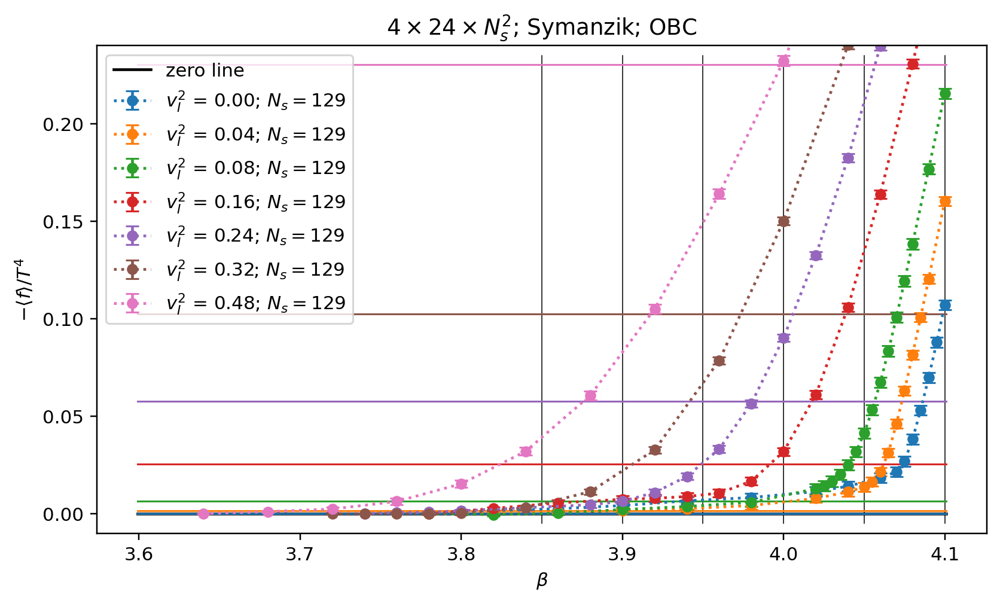

In [59]:
fig, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((4.059, 4.101))  #
target_domain = domains.GeometricRange((3.599, 4.101))  #

r = 24/4
r_group = calc_rs32_obc_t.r_groups[r].data_holders
# r_group = calc_5s_ns40_t.r_groups[r].data_holders
# x_val = np.linspace(3.6, 5.0, 1000)
x_val = np.linspace(target_domain.left, target_domain.right, 100)
plt.plot(x_val, 0.0 * x_val, label="zero line", color="black", linewidth=1.5)
# plt.plot(x_val, 0.0 * x_val + 0.1, color="black", linewidth=0.5)
# plt.plot(x_val, 0.0 * x_val + 0.2, color="black", linewidth=0.5)
# plt.plot(x_val, 0.0 * x_val + 0.3, color="black", linewidth=0.5)
# plt.plot(x_val, 0.0 * x_val + 0.4, color="black", linewidth=0.5)
# plt.plot(x_val, 0.0 * x_val + 0.5, color="black", linewidth=0.5)


betas = np.array([3.850, 3.900, 3.950, 4.000, 4.050, 4.100])
spacings = symanzik_scale_setter.get_spacing_in_fm(betas)
for i in range(len(betas)):
    print(f"{betas[i]:.3f}: {spacings[i]:.3f} fm")

for beta in betas:
    x_val = [beta, beta]
    y_val = [-0.005, 0.235]
    plt.plot(x_val, y_val, color="black", linewidth=0.5)
    
counter = 0
for holder in sorted(r_group, key=(lambda x: x.velocity)):
    x_val, y_val, y_err = holder.get_energy_data()
#     x_val = symanzik_scale_setter.get_spacing_in_fm(x_val)
    
#     if holder.velocity != 0.0000:
#         counter += 1
#         continue
    plotters.draw_point_rep(
        plt, ax, plotters.PointRep(x_val, y_val, y_err),
#         velocity_colormap[holder.velocity],
        f"C{counter}",
        label=f"$v_I^2$ = {holder.velocity**2:.2f}; $N_s = 129$",
        domain=target_domain
    )
    x_val = np.linspace(target_domain.left, target_domain.right, 100)
    plt.plot(x_val, 0.0 * x_val + holder.velocity**4, color=f"C{counter}", linewidth=1.0)
    counter += 1
plt.legend(loc="upper left")
# plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
# plt.ylabel(r"$N_t^4 \langle \Delta s \rangle$")
# plt.ylabel(r"$N_t^4 \Delta s$")
plt.ylabel("$-\langle f \\rangle/T^4$")
# plt.title(f"$N_t$ = 5; Symanzik; r = {r:.1f}")
# plt.title(f"$N_t$ = 5; Wilson; PBC; r = {r:.1f}")
plt.title(r"$4 \times 24 \times N_s^2$; Symanzik; OBC")
plt.ylim([-0.010, 0.240])
# ax.set_yscale("log")
plt.savefig(f"{output_dir_name}tail_scan_obc_rs32_v0.png")
plt.show()


NameError: name 'data_holder_roenko_t' is not defined

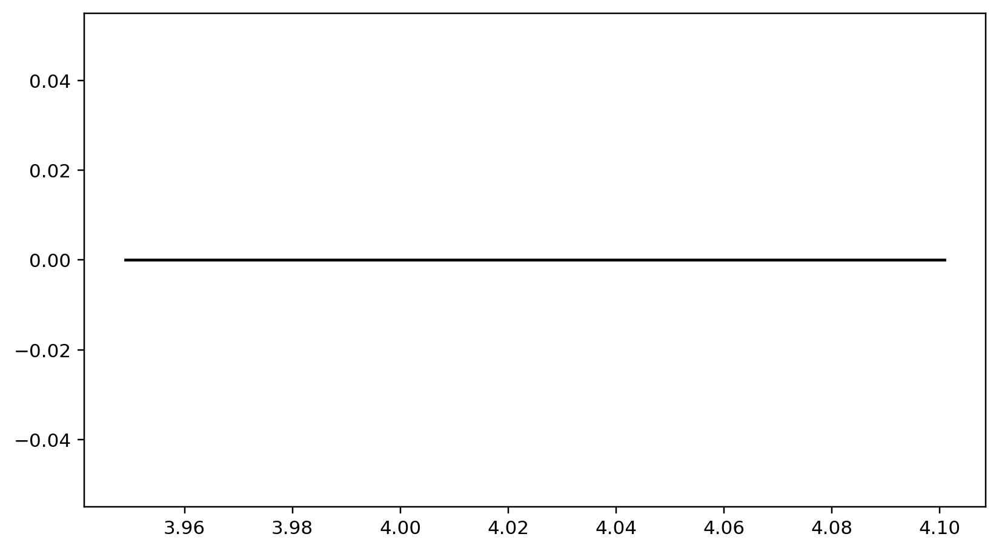

In [53]:
fig, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((0.50, 2.50))  # t_per_tc
# target_domain = domains.GeometricRange((3.999, 5.001))  #
# target_domain = domains.GeometricRange((3.599, 5.001))
target_domain = domains.GeometricRange((3.949, 4.101))

# target_domain = domains.GeometricRange((3.979, 4.101))  # nt = 4
# target_domain = domains.GeometricRange((4.099, 4.221))  # nt = 5
# target_domain = domains.GeometricRange((4.199, 4.341))  # nt = 6

# target_domain = domains.GeometricRange((4.039, 4.101))  # nt = 4
# target_domain = domains.GeometricRange((4.169, 4.231))  # nt = 5
# target_domain = domains.GeometricRange((4.279, 4.351))  # nt = 6

# target_domain = None

x_val = np.linspace(target_domain.left, target_domain.right)
plt.plot(x_val, 0.0 * x_val, label="zero line", color="black")
# plt.plot(x_val, 0.1 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)
# plt.plot(x_val, 0.2 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)
# plt.plot(x_val, 0.3 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)
# plt.plot(x_val, 0.4 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)

x_val, y_val, y_err = data_holder_roenko_t.get_delta_s_nt4_data()
# t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
plotters.draw_point_rep(
    plt, ax, plotters.PointRep(x_val, y_val, y_err),
    "C0", label=r"$4(40) \times 40 \times 41^2$",
    domain=target_domain
)


# x_val, y_val, y_err = data_holder_nt4_t.get_delta_s_nt4_data()
# # t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
# plotters.draw_point_rep(
#     plt, ax, plotters.PointRep(x_val, y_val, y_err),
#     "C0", label=r"$4(16) \times 16 \times 21 \times 21$",
#     domain=target_domain
# )
# x_val, y_val, y_err = data_holder_nt5_t.get_delta_s_nt4_data()
# # t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
# plotters.draw_point_rep(
#     plt, ax, plotters.PointRep(x_val, y_val, y_err),
#     "C1", label=r"$5(20) \times 20 \times 25 \times 25$",
#     domain=target_domain
# )
# x_val, y_val, y_err = data_holder_nt6_t.get_delta_s_nt4_data()
# # t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
# plotters.draw_point_rep(
#     plt, ax, plotters.PointRep(x_val, y_val, y_err),
#     "C2", label=r"$6(24) \times 24 \times 31 \times 31$",
#     domain=target_domain
# )

# plt.legend(loc="upper right")
plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$N_t^4 \langle \Delta s \rangle$")
# plt.title(f"$N_t$ = 5; Symanzik; r = {r:.1f}")
plt.title("Symanzik; PBC")
# plt.ylim([-0.1, 0.5])
# ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}wide_delta_s_nt456c_v0.png")
# plt.savefig(f"{output_dir_name}trans_delta_s_nt6c_v0.png")
# plt.savefig(f"{output_dir_name}tail_delta_s_nt6c_v0.png")
plt.show()

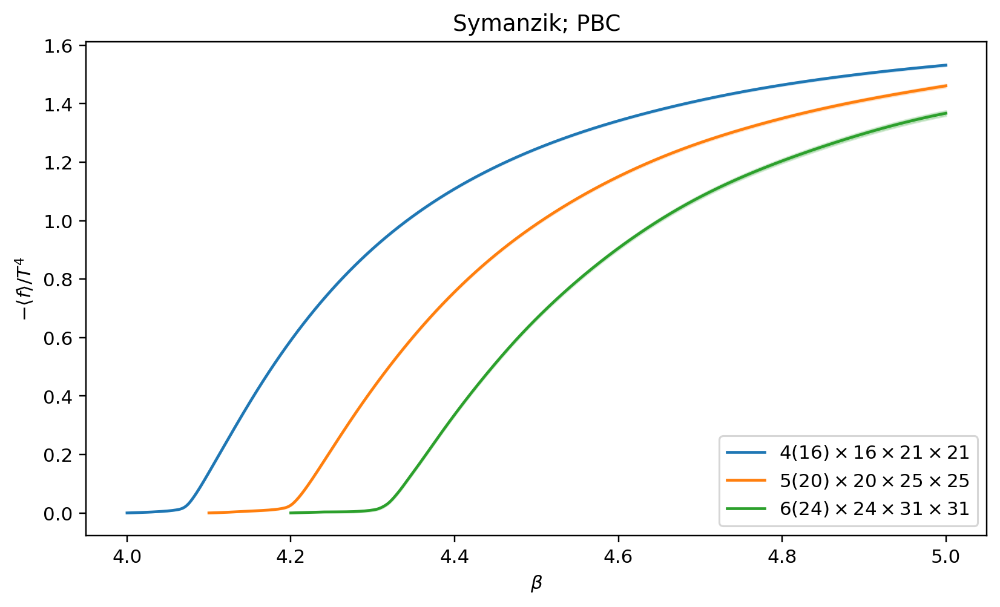

In [6]:
_, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((5.693, 6.5))
target_domain = None
plotters.draw_spl_rep(
    plt, ax, data_holder_nt4_t.get_energy_splrep(),
    "C0", label=r"$4(16) \times 16 \times 21 \times 21$", domain=target_domain)
plotters.draw_spl_rep(
    plt, ax, data_holder_nt5_t.get_energy_splrep(),
    "C1", label=r"$5(20) \times 20 \times 25 \times 25$", domain=target_domain)
plotters.draw_spl_rep(
    plt, ax, data_holder_nt6_t.get_energy_splrep(),
    "C2", label=r"$6(24) \times 24 \times 31 \times 31$", domain=target_domain)
plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
plt.ylabel("$-\langle f \\rangle/T^4$")
plt.title("Symanzik; PBC")
# plt.savefig(f"{output_dir_name}eos_nt4_ns40_pres_000.png")
plt.show()

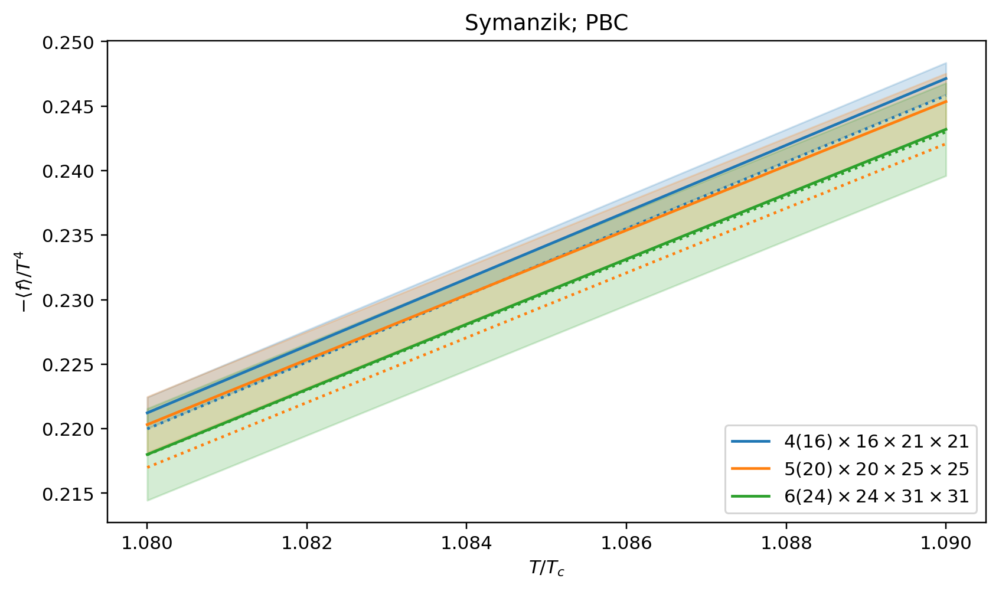

In [11]:
_, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((0.900, 1.000))
# target_domain = domains.GeometricRange((0.950, 1.100))
target_domain = domains.GeometricRange((1.080, 1.090))
# target_domain = domains.GeometricRange((1.0860, 1.0865))
# target_domain = None
# target_domain = domains.GeometricRange((1.400, 1.500))
# target_domain = domains.GeometricRange((0.750, 1.000))

betas, en_val, en_err = data_holder_nt4_q.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 4) / tc_in_mev_nt4imp
rep_nt4_q = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt4_q,
    "C0", label=r"$4(16) \times 16 \times 21 \times 21$", domain=target_domain)
betas, en_val, en_err = data_holder_nt4_t.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 4) / tc_in_mev_nt4imp
rep_nt4_t = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt4_t,
    "C0", linestyle=":", no_error=True, domain=target_domain)

betas, en_val, en_err = data_holder_nt5_q.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 5) / tc_in_mev_nt5imp
rep_nt5_q = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt5_q,
    "C1", label=r"$5(20) \times 20 \times 25 \times 25$", domain=target_domain)
betas, en_val, en_err = data_holder_nt5_t.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 5) / tc_in_mev_nt5imp
rep_nt5_t = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt5_t,
    "C1", linestyle=":", no_error=True, domain=target_domain)

betas, en_val, en_err = data_holder_nt6_q.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 6) / tc_in_mev_nt6imp
rep_nt6_q = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt6_q,
    "C2", label=r"$6(24) \times 24 \times 31 \times 31$", domain=target_domain)
betas, en_val, en_err = data_holder_nt6_t.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 6) / tc_in_mev_nt6imp
rep_nt6_t = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt6_t,
    "C2", linestyle=":", no_error=True, domain=target_domain)

plt.legend(loc="lower right")
plt.xlabel("$T/T_c$")
plt.ylabel("$-\langle f \\rangle/T^4$")
plt.title("Symanzik; PBC")
# plt.savefig(f"{output_dir_name}eos_nt4_ns40_pres_000.png")
plt.show()

[1.08627397 1.24357819 1.36982133 1.59571408 1.99956668 2.46391846]
[1.08580825 1.24334627 1.36952348 1.59615074 1.9999245  2.46291106]
[1.08704995 1.24276305 1.36893699 1.59489433 1.99925796 2.42602209]
1.0864387811233243
-0.6544995077192015


<Figure size 460.8x345.6 with 0 Axes>

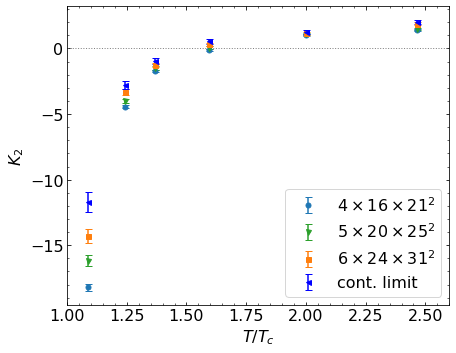

In [71]:
# _, ax = plotters.make_figure_and_111axis(plt)
plt.clf()
fig, ax = plt.subplots(constrained_layout=True)

domain_to_draw = None

x_val = np.linspace(1.00, 2.60)
plt.plot(x_val, 0.0 * x_val, color="grey", linestyle="dotted", linewidth=1.0)

beta_val_16_v2 = kappa2_data_16_v2[2:-2, 0]
# print(beta_val_16_v2)
x_val_16_v2 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 4)[0] for row in kappa2_data_16_v2[2:-2]]) / tc_in_mev_nt4imp
print(x_val_16_v2)
y_val_16_v2 = kappa2_data_16_v2[2:-2, 1]
y_err_16_v2 = kappa2_data_16_v2[2:-2, 2]
energy_val_16_v2, energy_err_16_v2 = data_holder_nt4_q.get_energy_interpolation_at_values(beta_val_16_v2)
# print((y_err_16_v2 / y_val_16_v2) / (energy_err_16_v2 / energy_val_16_v2))
k2_prep_nt4 = plotters.PointRep(x_val_16_v2, y_val_16_v2 / energy_val_16_v2,
                                y_err_16_v2 / energy_val_16_v2).multiply_by_constant(-2.0)
plotters.draw_point_rep(plt, ax, k2_prep_nt4,
                       "C0", label=r"$4 \times 16 \times 21^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[0])
np.savetxt(f"{output_dir_name}beta_f0val_f0err_nt4data.txt",
           np.transpose(np.array([beta_val_16_v2, energy_val_16_v2, energy_err_16_v2])))

beta_val_20 = kappa2_data_20[2:, 0]
# print(beta_val_20)
x_val_20 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 5)[0] for row in kappa2_data_20[2:]]) / tc_in_mev_nt5imp
print(x_val_20)
y_val_20 = kappa2_data_20[2:, 1]
y_err_20 = kappa2_data_20[2:, 2]
energy_val_20, energy_err_20 = data_holder_nt5_q.get_energy_interpolation_at_values(beta_val_20)
k2_val_20 = y_val_20 / energy_val_20
k2_err_20 = y_err_20 / energy_val_20
# print((y_err_20 / y_val_20) / (energy_err_20 / energy_val_20))
k2_prep_nt5 = plotters.PointRep(x_val_20, k2_val_20, k2_err_20).multiply_by_constant(-2.0)
plotters.draw_point_rep(plt, ax, k2_prep_nt5,
                       "C2", label=r"$5 \times 20 \times 25^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[1])
np.savetxt(f"{output_dir_name}beta_f0val_f0err_nt5data.txt",
           np.transpose(np.array([beta_val_20, energy_val_20, energy_err_20])))

beta_val_24 = kappa2_data_24[2:, 0]
# print(beta_val_24)
x_val_24 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 6)[0] for row in kappa2_data_24[2:]]) / tc_in_mev_nt6imp
print(x_val_24)
y_val_24 = kappa2_data_24[2:, 1]
y_err_24 = kappa2_data_24[2:, 2]
energy_val_24, energy_err_24 = data_holder_nt6_q.get_energy_interpolation_at_values(beta_val_24)
k2_val_24 = y_val_24 / energy_val_24
k2_err_24 = y_err_24 / energy_val_24
fraction = (x_val_20[-1] - x_val_24[-2]) / (x_val_24[-1] - x_val_24[-2])
k2_correction = (k2_val_24[-1] - k2_val_24[-2]) * fraction
print(fraction)
print(k2_correction * (fraction - 1.0) / k2_err_24[-1])
k2_val_24[-1] = k2_val_24[-2] + k2_correction
# print((y_err_24 / y_val_24) / (energy_err_24 / energy_val_24))
k2_prep_nt6 = plotters.PointRep(x_val_20, k2_val_24, k2_err_24).multiply_by_constant(-2.0)
plotters.draw_point_rep(plt, ax, k2_prep_nt6,
                       "C1", label=r"$6 \times 24 \times 31^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[2])
np.savetxt(f"{output_dir_name}beta_f0val_f0err_nt6data.txt",
           np.transpose(np.array([beta_val_24, energy_val_24, energy_err_24])))

l_extrapolator = extrapolators.LinearExtrapolator()
k2_prep_etx = l_extrapolator.from_pointreps(np.array([4., 5., 6.])**(-2), [k2_prep_nt4, k2_prep_nt5, k2_prep_nt6])
plotters.draw_point_rep(plt, ax, k2_prep_etx,
                       "blue", label=r"cont. limit", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[3])

ax.tick_params(axis="both", which="both", direction="in", bottom=1, top=1, left=1, right=1)
ax.minorticks_on()
ax.grid(False)

plt.legend(loc="lower right", fontsize=12)
ax.set_xlim(1.0, 2.6)
# plt.ylim([0.0, 2.0])

plt.legend(loc="lower right")
plt.xlabel("$T/T_c$")
plt.ylabel("$K_2$")
# plt.title("Symanzik; PBC")
# plt.savefig(f"{output_dir_name}eos_nt4_ns40_pres_000.png")
# plt.savefig(f"{output_dir_name}k2_kudrov_cont_lim_v1.png")
plt.show()

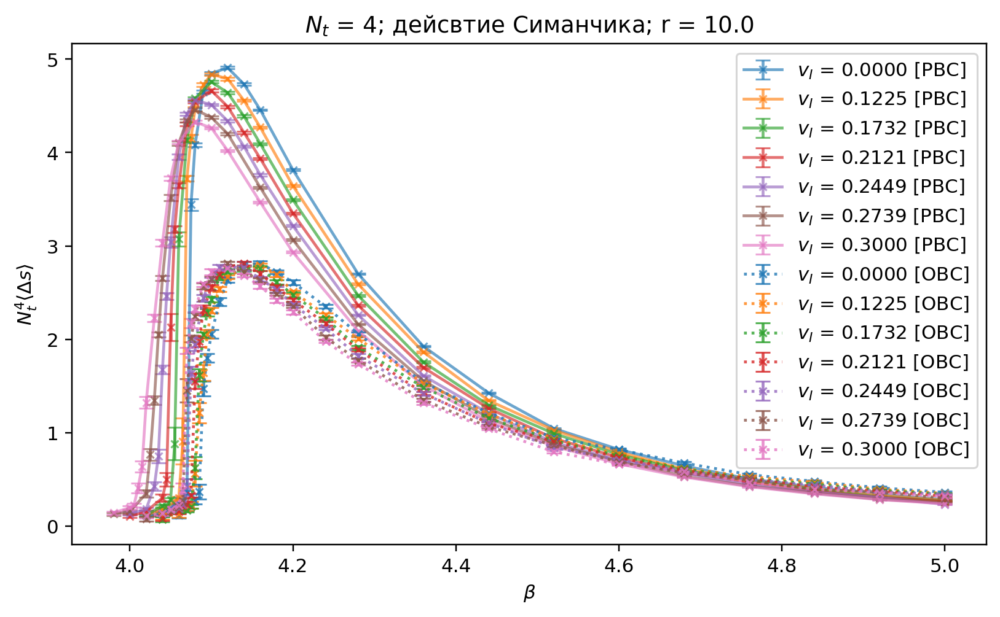

In [4]:
fig, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((5.50, 5.70))  # nt = 4
# target_domain = domains.GeometricRange((5.73, 5.97))  # nt = 6
# target_domain = domains.GeometricRange((5.80, 6.10))  # nt = 8

# target_domain = domains.GeometricRange((0.50, 2.50))  # t_per_tc

r = 40/4
# r = 8.0
r_group = calc_4s_ns40_t.r_groups[r].data_holders
r_group_2 = calc_4so_ns40_t.r_groups[r].data_holders
# plt.plot(x_val, 0.0 * x_val, label="zero line", color="black")
for holder in sorted(r_group, key=(lambda x: x.velocity)):
    # if holder.velocity != 0.3000:
    #     continue
    x_val, y_val, y_err = holder.get_delta_s_nt4_data()
    # t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
    plotters.draw_point_rep(
        plt, ax, plotters.PointRep(x_val, y_val, y_err),
        velocity_colormap[holder.velocity],
        label=f"$v_I$ = {holder.velocity:.4f} [PBC]",
        linestyle="solid", markertype="x",
        alpha=0.65, linewidth=0.7,
        # domain=target_domain
    )
for holder in sorted(r_group_2, key=(lambda x: x.velocity)):
    # if holder.velocity != 0.3000:
    #     continue
    x_val, y_val, y_err = holder.get_delta_s_nt4_data()
    # t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
    plotters.draw_point_rep(
        plt, ax, plotters.PointRep(x_val, y_val, y_err),
        velocity_colormap[holder.velocity],
        label=f"$v_I$ = {holder.velocity:.4f} [OBC]",
        linestyle="dotted", markertype="x",
        alpha=0.8, linewidth=0.7,
        # domain=target_domain
    )
plt.legend(loc="upper right")
# plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$N_t^4 \langle \Delta s \rangle$")
# plt.title(f"$N_t$ = 5; Symanzik; r = {r:.1f}")
plt.title(f"$N_t$ = 4; дейсвтие Симанчика; r = {r:.1f}")
# plt.ylim([-0.1, 0.5])
# ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}nt4_delta_s/wide_delta_s_nt5w_ns40_vAll_000.png")
# plt.savefig(f"{output_dir_name}wide_delta_s_nt4_ns40_bc_comp_v1.png")
plt.show()

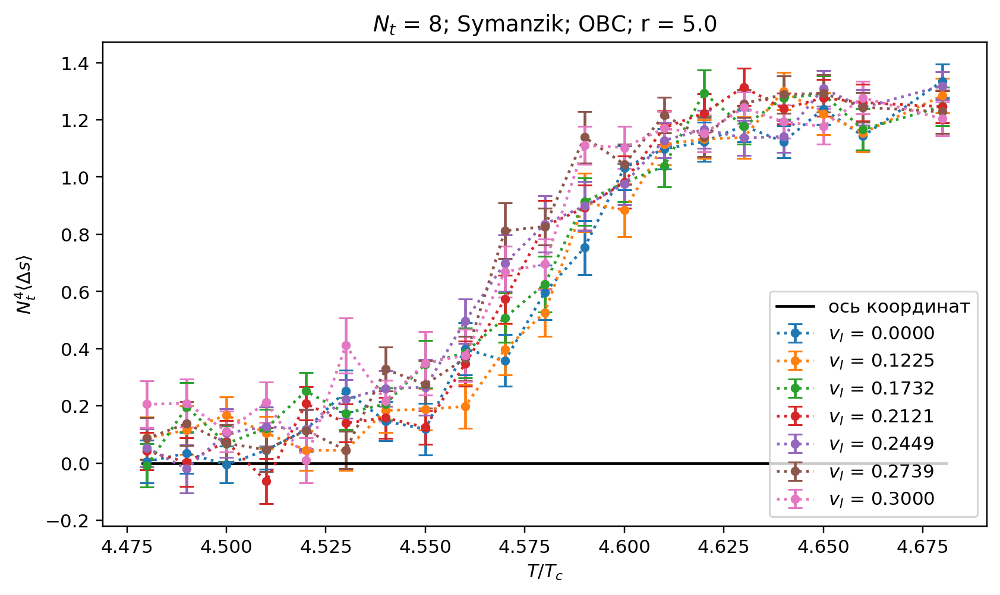

In [9]:
fig, ax = plotters.make_figure_and_111axis(plt)

# legacy tail analysis:
# target_domain = domains.GeometricRange((4.03, 4.25))  # nt = 5 (imp)
# target_domain = domains.GeometricRange((4.03, 4.37))  # nt = 6 (imp)
# tail alanysis:
# target_domain = domains.GeometricRange((3.959, 4.141))  # nt = 4 (imp_obc)
# target_domain = domains.GeometricRange((3.979, 4.09))  # nt = 4 (imp)
# target_domain = domains.GeometricRange((4.119, 4.22))  # nt = 5 (imp)
# target_domain = domains.GeometricRange((4.219, 4.33))  # nt = 6 (imp)
# target_domain = domains.GeometricRange((4.299, 4.441))  # nt = 7 (imp)
# target_domain = domains.GeometricRange((5.559, 5.70))  # nt = 4
# target_domain = domains.GeometricRange((5.599, 5.85))  # nt = 5
# target_domain = domains.GeometricRange((5.719, 5.94))  # nt = 6
# target_domain = domains.GeometricRange((5.799, 6.02))  # nt = 7
# target_domain = domains.GeometricRange((5.899, 6.08))  # nt = 8

# narrow ranges:
# target_domain = domains.GeometricRange((3.999, 4.141))  # nt = 4 (imp)
# target_domain = domains.GeometricRange((4.139, 4.261))  # nt = 5 (imp)
# target_domain = domains.GeometricRange((4.254, 4.381))  # nt = 6 (imp)

# transition ranges:
# target_domain = domains.GeometricRange((4.01, 4.11))  # nt = 4 (imp0)
# target_domain = domains.GeometricRange((3.999, 4.101))  # nt = 4 (imp)
# target_domain = domains.GeometricRange((4.139, 4.221))  # nt = 5 (imp)
# target_domain = domains.GeometricRange((4.254, 4.341))  # nt = 6 (imp)
# target_domain = domains.GeometricRange((4.339, 4.481))  # nt = 7 (imp)
# target_domain = domains.GeometricRange((4.439, 4.581))  # nt = 8 (imp)
# target_domain = domains.GeometricRange((4.039, 4.141))  # nt = 4 (imp_obc)
# target_domain = domains.GeometricRange((4.179, 4.261))  # nt = 5 (imp_obc)
# target_domain = domains.GeometricRange((4.299, 4.421))  # nt = 6 (imp_obc)
# target_domain = domains.GeometricRange((4.399, 4.561))  # nt = 7 (imp_obc)
target_domain = domains.GeometricRange((4.479, 4.681))  # nt = 8 (imp_obc)
# target_domain = domains.GeometricRange((5.56, 5.70))  # nt = 4
# target_domain = domains.GeometricRange((5.63, 5.89))  # nt = 5
# target_domain = domains.GeometricRange((5.73, 5.97))  # nt = 6
# target_domain = domains.GeometricRange((5.83, 6.05))  # nt = 7
# target_domain = domains.GeometricRange((5.95, 6.13))  # nt = 8

# target_domain = domains.GeometricRange((0.70, 1.20))  # t_per_tc

x_val = np.linspace(target_domain.left, target_domain.right)
# plt.plot(x_val, 0.0 * x_val, label="zero line", color="black")
plt.plot(x_val, 0.0 * x_val, label="ось координат", color="black")
# plt.plot(x_val, 0.1 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)
# plt.plot(x_val, 0.2 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)
# plt.plot(x_val, 0.3 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)
# plt.plot(x_val, 0.4 * np.ones(len(x_val)),
#          color="black", alpha=1.0, linewidth=0.5)

# r = 32/8
r = 40/8
# r = 8.0
# r = 4.0
r_group = calc_8so_ns40_t.r_groups[r].data_holders
for holder in sorted(r_group, key=(lambda x: x.velocity)):
    x_val, y_val, y_err = holder.get_delta_s_nt4_data()
#     t_per_tc = scale_setter_ext.get_temperature_in_mev(x_val, 5) / tc_in_mev_nt5
    plotters.draw_point_rep(
        plt, ax, plotters.PointRep(x_val, y_val, y_err),
        velocity_colormap[holder.velocity], label=f"$v_I$ = {holder.velocity:.4f}",
        domain=target_domain)
# plt.legend(loc="upper left")
plt.legend(loc="lower right")
# plt.xlabel(r"$\beta$")
plt.xlabel(r"$T/T_c$")
plt.ylabel(r"$N_t^4 \langle \Delta s \rangle$")
# plt.title(f"$N_t$ = 8; Symanzik; r = {r:.1f}")
# plt.title(f"$N_t$ = 5; Wilson; r = {r:.1f}")
plt.title(f"$N_t$ = 8; Symanzik; OBC; r = {r:.1f}")
# plt.ylim([0.0, 0.5])
# plt.ylim([-0.1, 0.7])
# plt.ylim([-0.2, 0.6])
# plt.savefig(f"{output_dir_name}nt4_delta_s/narrow_delta_s_nt8so_ns40_vAll_000.png")
# plt.savefig(f"{output_dir_name}tail_analysis/tail_delta_s_nt7s_ns40_vAll_000.png")
# plt.savefig(f"{output_dir_name}nt4_delta_s/narrow_delta_s_nt5w_ns40_diploma_v1.png")
plt.show()
# plt.savefig(f"{output_dir_name}narrow_t_per_tc_delta_s_nt5w_ns40_vAll_000.png")

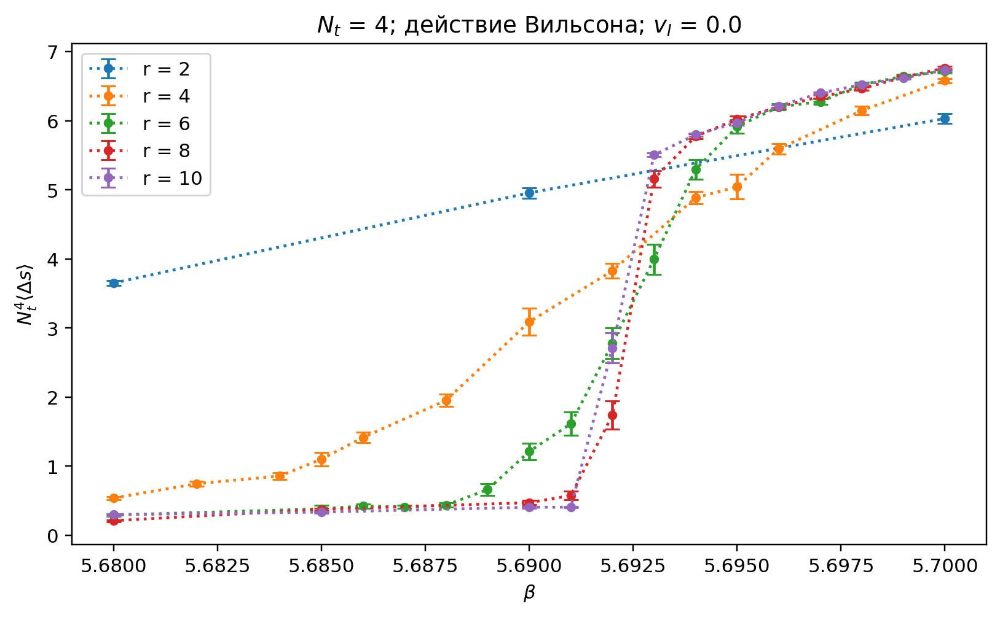

In [35]:
fig, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((5.69, 5.694))  # v = 0.00
target_domain = domains.GeometricRange((5.68, 5.70))  # v = 0.00
# target_domain = domains.GeometricRange((5.65, 5.69))  # v = 0.15
# target_domain = domains.GeometricRange((5.62, 5.69))  # v = 0.20
# target_domain = domains.GeometricRange((5.57, 5.69))  # v = 0.25
v = 0.000
v_group = calc_4w_ns_all_t.velocity_groups[v].data_holders
for holder in sorted(v_group, key=(lambda x: x.aspect_ratio)):
    if holder.aspect_ratio == 14:
        continue
    x_val, y_val, y_err = holder.get_delta_s_nt4_data()
    plotters.draw_point_rep(
        plt, ax, plotters.PointRep(x_val, y_val, y_err),
        r_colormap[holder.aspect_ratio],
        label=f"r = {int(holder.aspect_ratio)}",
        domain=target_domain)
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$N_t^4 \langle \Delta s \rangle$")
plt.title(f"$N_t$ = 4; действие Вильсона; $v_I$ = {v:.1f}")
# plt.savefig(f"{output_dir_name}narrow_delta_s_nt4_v{int(v * 10000)}_001.png")
plt.show()

In [15]:
r_domains = {
    0.000: {
        4: domains.GeometricRange((5.685, 5.694)),
        6: domains.GeometricRange((5.690, 5.694)),
        8: domains.GeometricRange((5.600, 5.660)),
        10: domains.GeometricRange((5.590, 5.670)),
    },
    0.150: {
        4: domains.GeometricRange((5.658, 5.675)),
        6: domains.GeometricRange((5.662, 5.675)),
        8: domains.GeometricRange((5.664, 5.678)),
        10: domains.GeometricRange((5.662, 5.680)),
    },
    0.200: {
        4: domains.GeometricRange((5.637, 5.657)),
        6: domains.GeometricRange((5.640, 5.662)),
        8: domains.GeometricRange((5.637, 5.665)),
        10: domains.GeometricRange((5.635, 5.670)),
    },
    0.250: {
        4: domains.GeometricRange((5.610, 5.635)),
        6: domains.GeometricRange((5.610, 5.650)),
        8: domains.GeometricRange((5.605, 5.655)),
        10: domains.GeometricRange((5.600, 5.660)),
    },
}

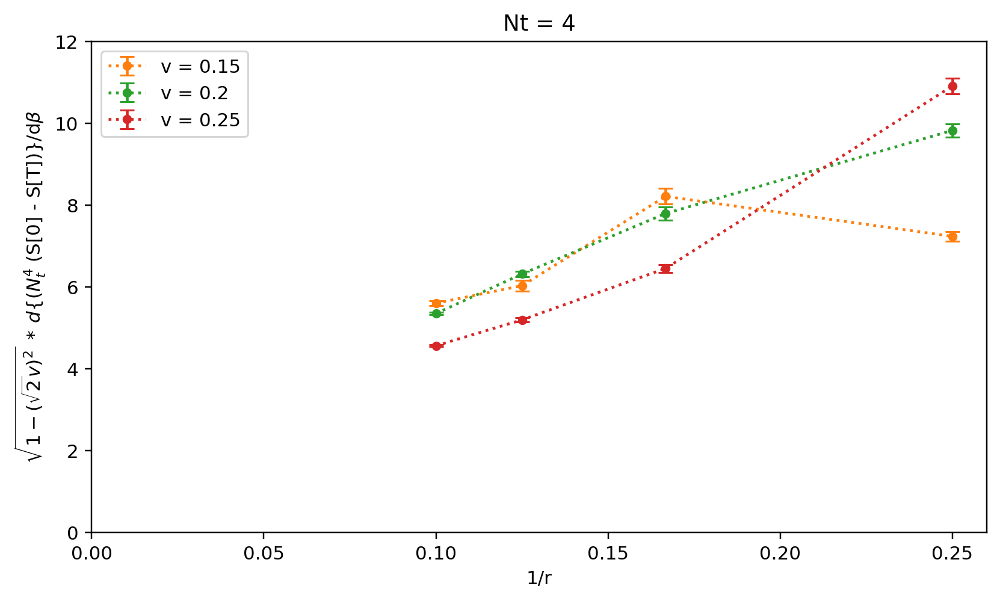

In [17]:
fig, ax = plotters.make_figure_and_111axis(plt)

# r_to_inspect = np.array([4, 6, 8, 10])
r_to_inspect = np.array([10, 8, 6, 4])
for v in [0.150, 0.200, 0.250]:
    slope_dict = dict()
    slope_err_dict = dict()
    v_group = calc_4w_ns_all_t.velocity_groups[v].data_holders
    for holder in v_group:
        r = holder.aspect_ratio
        if r not in r_to_inspect:
            continue
        res = fitters.LinearFitter.fit_pointrep(
            holder.get_delta_s_nt4_pointrep().subpointrep_in_domain(
                r_domains[v][r]))
        slope_dict[r] = res.b
        slope_err_dict[r] = res.b_error
    slope = np.array([slope_dict[r] for r in r_to_inspect])
    slope_err = np.array([slope_err_dict[r] for r in r_to_inspect])
    # assumed_factor = v**2
    # assumed_factor = 1.0 - np.sqrt(1 - v**2)
    assumed_factor = 1.0 - np.sqrt(1 - (1.41 * v)**2)
    plotters.draw_point_rep(
        plt, ax, plotters.PointRep(1 / r_to_inspect, slope * assumed_factor,
                                   slope_err * assumed_factor),
        velocity_colormap[v], label=f"$v_I$ = {v}")
plt.legend(loc="upper left")
plt.xlabel("1/r")
plt.ylabel(r"$\sqrt{1 - (\sqrt{2}v)^2} \: * \: d\{(N_t^4$$\langle \Delta s \rangle$$\}$/d$\beta$")
plt.title(f"$N_t$ = 4")
plt.xlim([0.00, 0.26])
# plt.ylim([0, 400])
# plt.ylim([0, 260])
# plt.ylim([0, 160])
plt.ylim([0, 12])
# plt.savefig(f"{output_dir_name}slope_nt4_vAll_3_000.png")
plt.show()

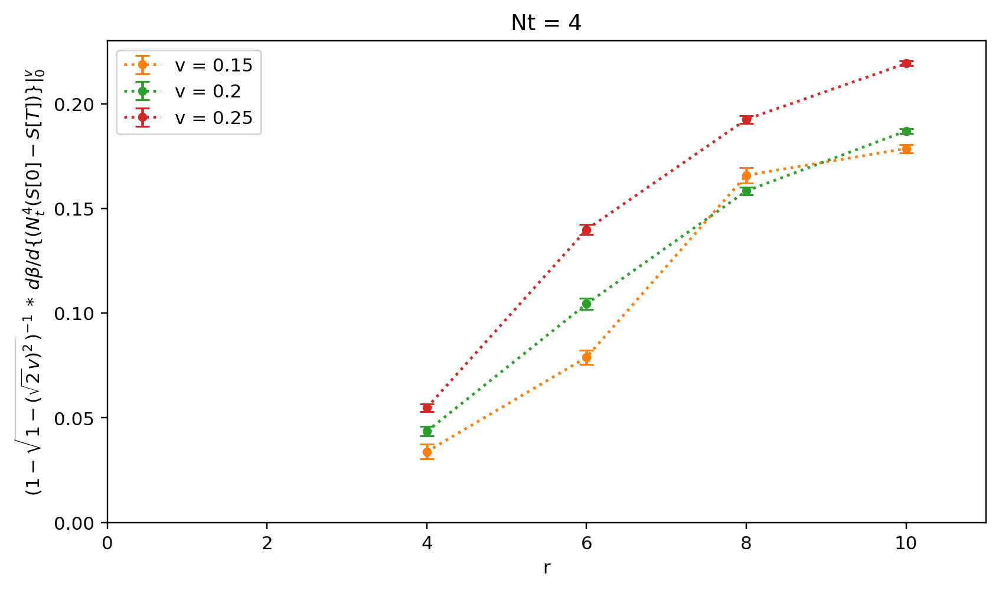

In [15]:
fig, ax = plotters.make_figure_and_111axis(plt)

v_base = 0.000
inv_slope_base = dict()
inv_slope_err_base = dict()
r_to_inspect_base = np.array([4, 6])
v_group_base = calc_4w_ns_all_t.velocity_groups[v_base].data_holders
for holder in v_group_base:
    r = holder.aspect_ratio
    if r not in r_to_inspect_base:
        continue
    res = fitters.LinearFitter.fit_pointrep(
        holder.get_delta_s_nt4_pointrep().subpointrep_in_domain(
            r_domains[v_base][r]))
    inv_slope_base[r] = 1 / res.b
    inv_slope_err_base[r] = res.b_error / res.b**2
inv_slope_base = np.array([inv_slope_base[r] for r in r_to_inspect_base]
                          + [0.0, 0.0])
inv_slope_err_base = np.array([inv_slope_err_base[r]
                               for r in r_to_inspect_base]
                              + [0.0, 0.0])

r_to_inspect = np.array([4, 6, 8, 10])
for v in [0.150, 0.200, 0.250]:
    slope_dict = dict()
    slope_err_dict = dict()
    v_group = calc_4w_ns_all_t.velocity_groups[v].data_holders
    for holder in v_group:
        r = holder.aspect_ratio
        if r not in r_to_inspect:
            continue
        res = fitters.LinearFitter.fit_pointrep(
            holder.get_delta_s_nt4_pointrep().subpointrep_in_domain(
                r_domains[v][r]))
        slope_dict[r] = res.b
        slope_err_dict[r] = res.b_error
    slope = np.array([slope_dict[r] for r in r_to_inspect])
    slope_err = np.array([slope_err_dict[r] for r in r_to_inspect])
    # assumed_factor = 1.0
    # assumed_factor = 1.0 / v**2
    # assumed_factor = 1.0 / (1.0 - np.sqrt(1 - v**2))
    assumed_factor = 1.0 / (1.0 - np.sqrt(1 - (1.41 * v)**2))
    plotters.draw_point_rep(
        plt, ax,
        plotters.PointRep(
            r_to_inspect,
            (1/slope - inv_slope_base) * assumed_factor,
            ((slope_err / slope**2)**2 + inv_slope_err_base**2)**0.5
                * assumed_factor),
        velocity_colormap[v], label=f"$v_I$ = {v}")
plt.legend(loc="upper left")
plt.xlabel("r")
plt.ylabel(r"$ (1 - \sqrt{1 - (\sqrt{2}v)^2})^{-1} \: * \: d\beta/d\{(N_t^4$\langle \Delta s \rangle$\} {|}_0^v$")
plt.title(f"$N_t$ = 4")
plt.xlim([0, 11])
plt.ylim([0.00, 0.23])
# plt.savefig(f"{output_dir_name}slope_nt4_vAll_7_000.png")
plt.show()

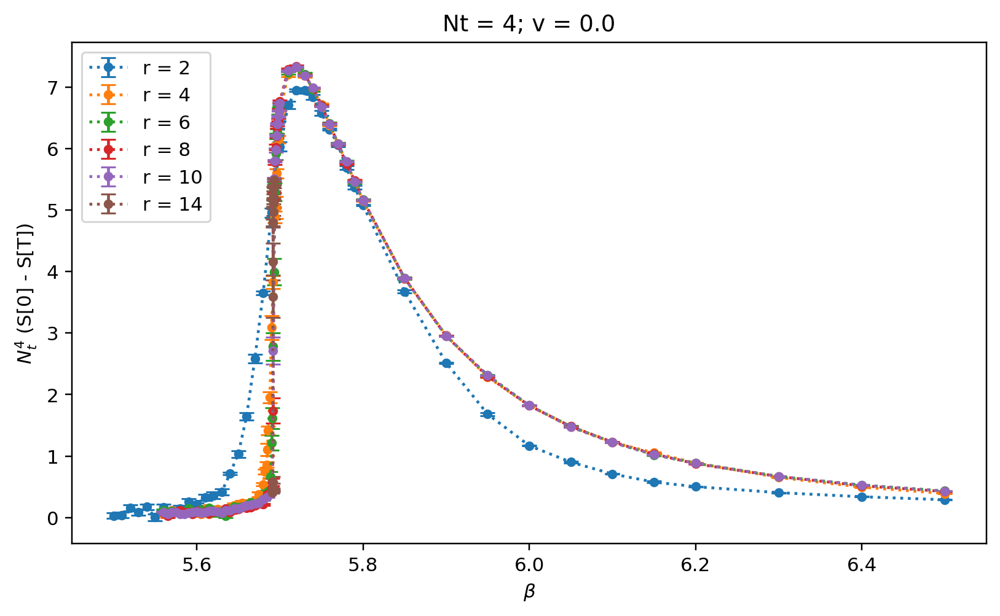

In [16]:
fig, ax = plotters.make_figure_and_111axis(plt)

v = 0.000
v_group = calc_4w_ns_all_t.velocity_groups[v].data_holders
for holder in sorted(v_group, key=(lambda x: x.aspect_ratio)):
    x_val, y_val, y_err = holder.get_delta_s_nt4_data()
    plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val, y_val, y_err),
                            r_colormap[holder.aspect_ratio],
                            label=f"r = {int(holder.aspect_ratio)}")
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$N_t^4$$\langle \Delta s \rangle$")
plt.title(f"$N_t$ = 4; $v_I$ = {v:.3f}")
# plt.savefig(f"{output_dir_name}wide_delta_s_nt4_v0000_000.png")
plt.show()

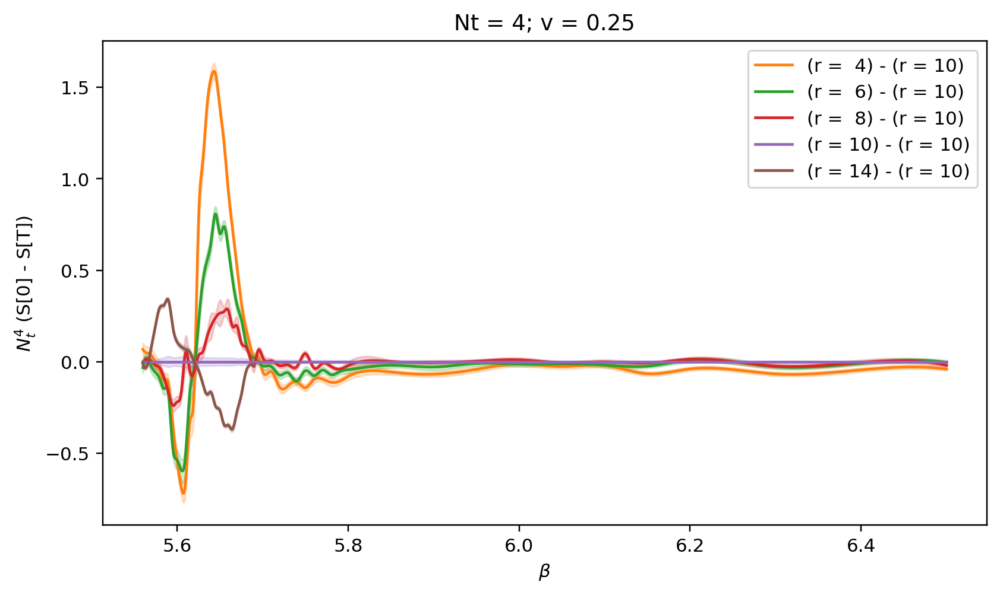

In [17]:
fig, ax = plotters.make_figure_and_111axis(plt)

v = 0.250
v_group = calc_4w_ns_all_t.velocity_groups[v].data_holders
holder_r10 = None
for holder in v_group:
    if holder.aspect_ratio == 10:
        holder_r10 = holder
r10_rep = holder_r10.get_delta_s_nt4_splrep()
for holder in sorted(v_group, key=(lambda x: x.aspect_ratio)):
    if holder.aspect_ratio == 2:
        continue
    r_rep = holder.get_delta_s_nt4_splrep()
    plotters.draw_spl_rep(
        plt, ax, r_rep.subtract_splrep(r10_rep, add_errors=False),
        r_colormap[holder.aspect_ratio],
        label=f"(r = {int(holder.aspect_ratio):{2}}) - (r = 10)")
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$N_t^4$$\langle \Delta s \rangle$")
plt.title(f"$N_t$ = 4; $v_I$ = {v:.3f}")
# plt.savefig(f"{output_dir_name}diff_delta_s_nt4_v{int(v * 10000)}_000.png")
plt.show()

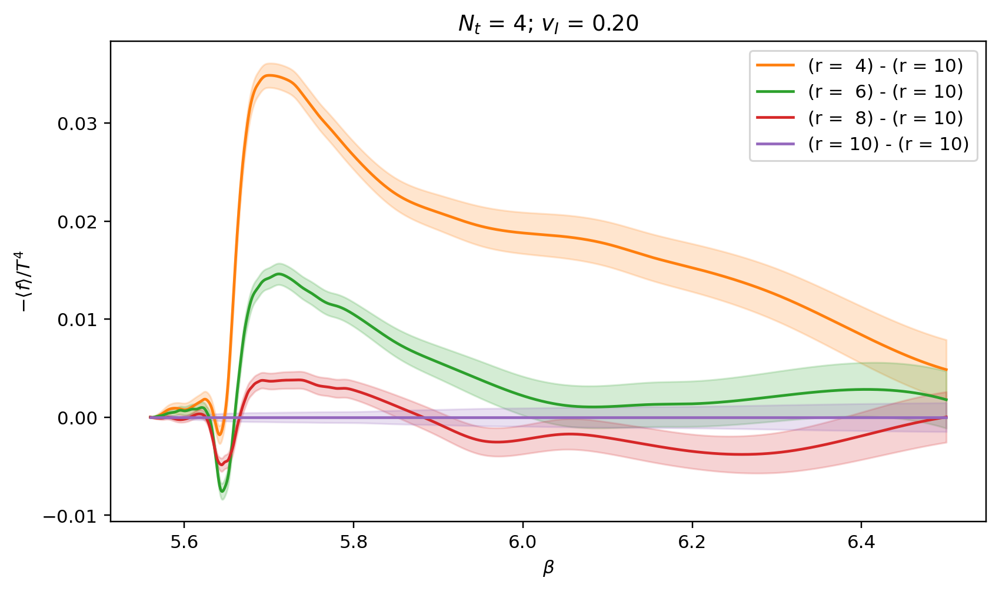

In [45]:
fig, ax = plotters.make_figure_and_111axis(plt)

v = 0.200
v_group = calc_4w_ns_all_t.velocity_groups[v].data_holders
holder_r10 = None
for holder in v_group:
    if holder.aspect_ratio == 10:
        holder_r10 = holder
r10_rep = holder_r10.get_energy_splrep()
for holder in sorted(v_group, key=(lambda x: x.aspect_ratio)):
    if holder.aspect_ratio == 2 or holder.aspect_ratio == 14:
        continue
    r_rep = holder.get_energy_splrep()
    plotters.draw_spl_rep(
        plt, ax, r_rep.subtract_splrep(r10_rep, add_errors=False),
        r_colormap[holder.aspect_ratio],
        label=f"(r = {int(holder.aspect_ratio):{2}}) - (r = 10)")
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$- \langle f \rangle/T^4$")
plt.title(f"$N_t$ = 4; $v_I$ = {v:.2f}")
# plt.savefig(f"{output_dir_name}diff_eos_nt4_v{int(v * 10000)}_diploma_000.png")
plt.show()

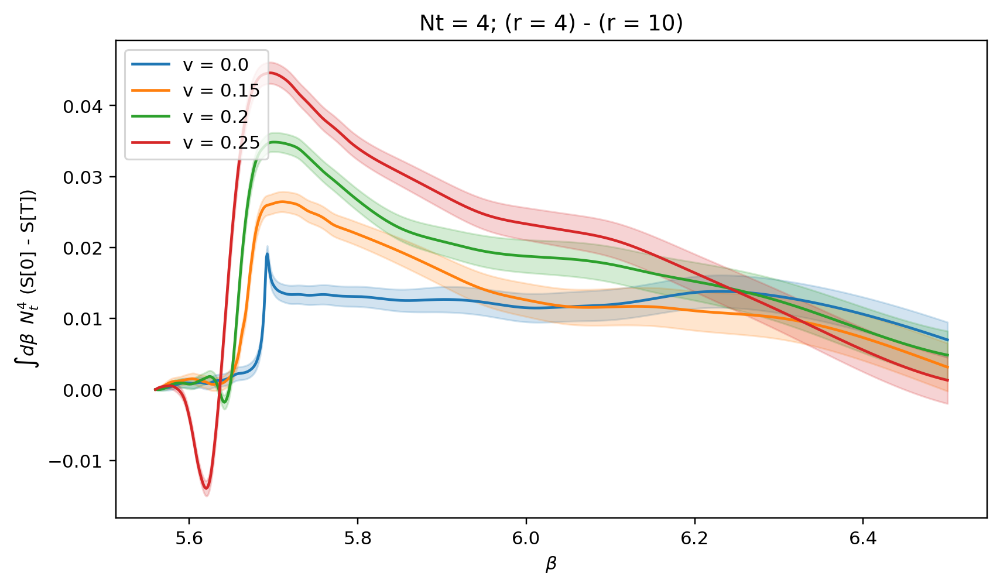

In [19]:
fig, ax = plotters.make_figure_and_111axis(plt)

r_base = 4
for v in [0.000, 0.150, 0.200, 0.250]:
    v_group = calc_4w_ns_all_t.velocity_groups[v].data_holders
    holder_r10 = None
    for holder in v_group:
        if holder.aspect_ratio == 10:
            holder_r10 = holder
    r10_rep = holder_r10.get_energy_splrep()
    for holder in v_group:
        if holder.aspect_ratio != r_base:
            continue
        r_base_rep = holder.get_energy_splrep()
        plotters.draw_spl_rep(
            plt, ax, r_base_rep.subtract_splrep(r10_rep, add_errors=True),
            velocity_colormap[v], label=f"$v_I$ = {v:.3f}")
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$\int d\beta \;\: N_t^4$$\langle \Delta s \rangle$")
plt.title(f"$N_t$ = 4; (r = {r_base}) - (r = 10)")
# plt.savefig(f"{output_dir_name}diff_eos_nt4_r4_vAll_000.png")
plt.show()

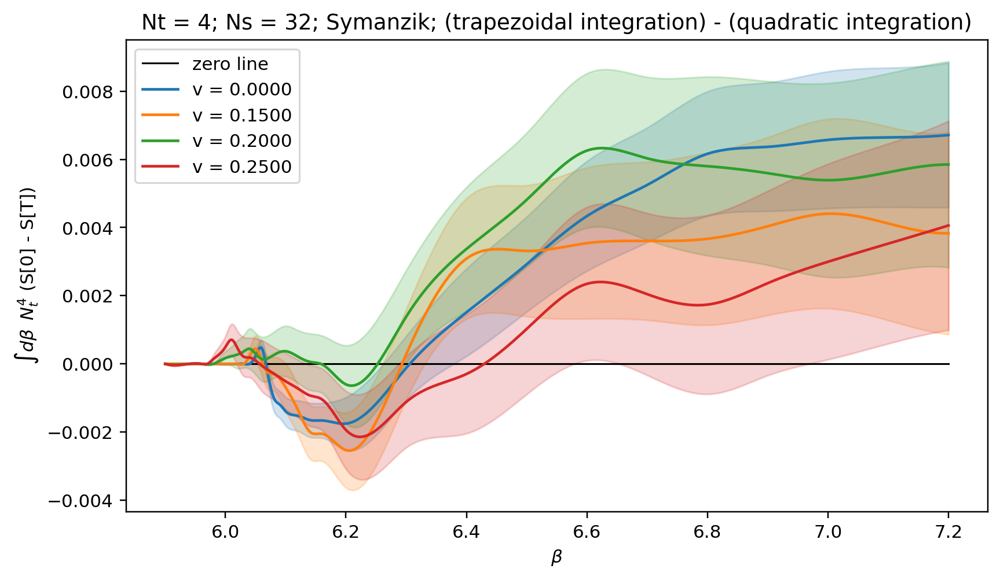

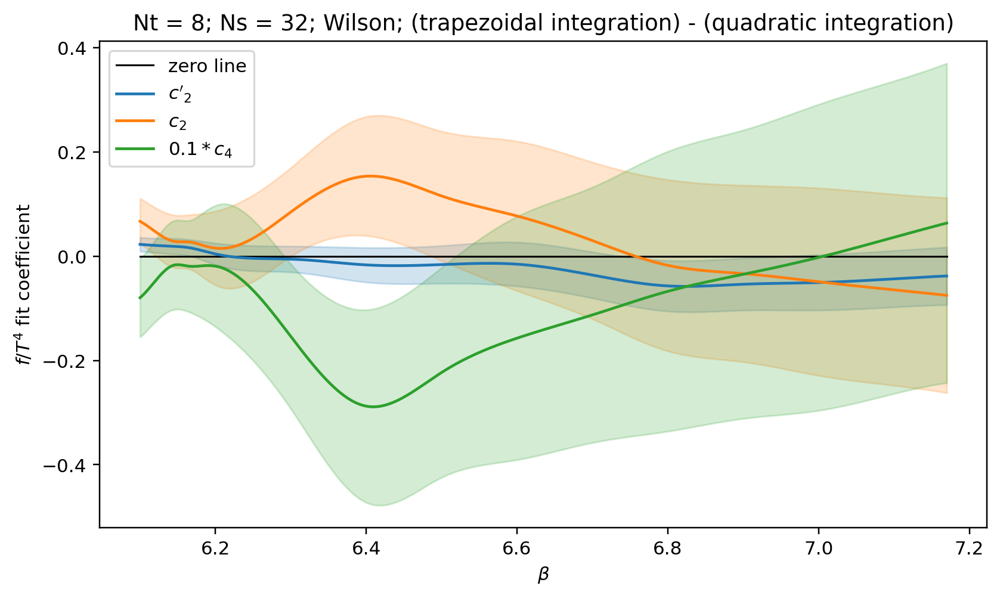

In [143]:
fig, ax = plotters.make_figure_and_111axis(plt)
# velocities = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449, 0.2739, 0.3000])
# velocity_to_idx = {
#     0.0000: 0,
#     0.1225: 1,
#     0.1732: 2,
#     0.2121: 3,
#     0.2449: 4,
#     0.2739: 5,
#     0.3000: 6,
# }
velocities = np.array([0.000, 0.150, 0.200, 0.250])
velocity_to_idx = {
    0.000: 0,
    0.150: 1,
    0.200: 2,
    0.250: 3,
}

int_splreps: List[Optional[plotters.SplineRep]] = [
    None for _ in range(len(velocities))]
target_r = 32/8
for counter, v in enumerate(velocities):
    v_group_t = calc_8w_ns32_t.velocity_groups[v].data_holders
    holder_t = None
    for holder in v_group_t:
        if holder.aspect_ratio == target_r:
            holder_t = holder
    v_group_q = calc_8w_ns32_q.velocity_groups[v].data_holders
    holder_q = None
    for holder in v_group_q:
        if holder.aspect_ratio == target_r:
            holder_q = holder
    x_val = holder_t._betas
    raw_errors = holder_t._deltaS_Nt4_err  # common for holder_t and holder_q
    int_val_t = holder_t._int_val
    int_err_t = holder_t._int_err
    int_weights_t = holder_t._int_weights
    int_val_q = holder_q._int_val
    int_err_q = holder_q._int_err
    int_weights_q = holder_q._int_weights
    int_val = int_val_t - int_val_q
    int_err = np.array([
        np.sqrt(np.sum((raw_errors*(int_weights_t[i] - int_weights_q[i]))**2))
        for i in range(len(x_val))
    ])
    if counter == 0:
        # for i in range(len(x_val)):
        #     print(int_err[i] / int_err_t[i], int_err[i] / int_err_q[i])
        plt.plot(x_val, 0.0 * x_val, label="zero line", color="black",
                 linewidth=1.0)
    rep_to_draw = plotters.SplineRep.from_points(x_val, int_val, int_err)
    int_splreps[counter] = rep_to_draw
    plotters.draw_spl_rep(
        plt, ax, rep_to_draw, velocity_colormap[v], label=f"$v_I$ = {v:.4f}")
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
plt.ylabel(r"$\int d\beta \;\: N_t^4$$\langle \Delta s \rangle$")
plt.title("$N_t$ = 4; $N_s$ = 32; Symanzik; "
          "(trapezoidal integration) - (quadratic integration)")
# plt.savefig(f"{output_dir_name}int_method_difference/diff_eos_nt8w_ns32_vAll_000.png")
plt.show()

# domain_to_draw = domains.GeometricRange((4.09, 4.97))  # nt = 4 (imp)
# domain_to_draw = domains.GeometricRange((4.22, 4.97))  # nt = 5 (imp)
# domain_to_draw = domains.GeometricRange((4.33, 4.97))  # nt = 6 (imp)
# domain_to_draw = domains.GeometricRange((5.72, 6.47))  # nt = 4
# domain_to_draw = domains.GeometricRange((5.82, 6.77))  # nt = 5
# domain_to_draw = domains.GeometricRange((5.92, 6.77))  # nt = 6
# domain_to_draw = domains.GeometricRange((6.00, 6.77))  # nt = 7
domain_to_draw = domains.GeometricRange((6.10, 7.17))  # nt = 8

x_val = np.linspace(domain_to_draw.left, domain_to_draw.right)
int_val = []
int_err = []
for v in velocities:
    val, err = int_splreps[velocity_to_idx[v]].calculate_points(x_val)
    int_val.append(val)
    int_err.append(err)
int_val = np.array(int_val)
int_err = np.array(int_err)

c0only_val = [0.0 for _ in x_val]
c0only_err = [0.0 for _ in x_val]
c2only_val = [0.0 for _ in x_val]
c2only_err = [0.0 for _ in x_val]
c0_val = [0.0 for _ in x_val]
c0_err = [0.0 for _ in x_val]
c2_val = [0.0 for _ in x_val]
c2_err = [0.0 for _ in x_val]
c4_val = [0.0 for _ in x_val]
c4_err = [0.0 for _ in x_val]

fitter_l = fitters.LinearFitter()
fitter_q = fitters.QuadraticFitter()

for idx, _ in enumerate(x_val):
    res_l = fitter_l.perform_fit_new(velocities**2,
                                     int_val[:, idx], int_err[:, idx])
    c0only_val[idx] = res_l.c0_val
    c0only_err[idx] = res_l.c0_err
    c2only_val[idx] = res_l.c1_val
    c2only_err[idx] = res_l.c1_err
    res_q = fitter_q.perform_fit(velocities**2,
                                 int_val[:, idx], int_err[:, idx])
    c0_val[idx] = res_q.c0_val
    c0_err[idx] = res_q.c0_err
    c2_val[idx] = res_q.c1_val
    c2_err[idx] = res_q.c1_err
    c4_val[idx] = res_q.c2_val
    c4_err[idx] = res_q.c2_err
c0only_rep = plotters.SplineRep.from_points(x_val, c0only_val, c0only_err)
c2only_rep = plotters.SplineRep.from_points(x_val, c2only_val, c2only_err)
c0_rep = plotters.SplineRep.from_points(x_val, c0_val, c0_err)
c2_rep = plotters.SplineRep.from_points(x_val, c2_val, c2_err)
c4_rep = plotters.SplineRep.from_points(x_val, c4_val, c4_err)

fig, ax = plotters.make_figure_and_111axis(plt)

plt.plot(x_val, 0.0 * x_val, label="zero line", color="black",
                 linewidth=1.0)
plotters.draw_spl_rep(plt, ax, c2only_rep,
                      "C0", label=r"$c'_2$")
plotters.draw_spl_rep(plt, ax, c2_rep,
                      "C1", label=r"$c_2$")
plotters.draw_spl_rep(plt, ax, c4_rep.multiply_by_constant(0.1),
                      "C2", label=r"$0.1 * c_4$")
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle f \rangle/T^4$ fit coefficient")
plt.title("$N_t$ = 8; $N_s$ = 32; Wilson; "
          "(trapezoidal integration) - (quadratic integration)")
# plt.savefig(f"{output_dir_name}int_method_difference/diff_eos_fit_nt8w_ns32_000.png")
plt.show()

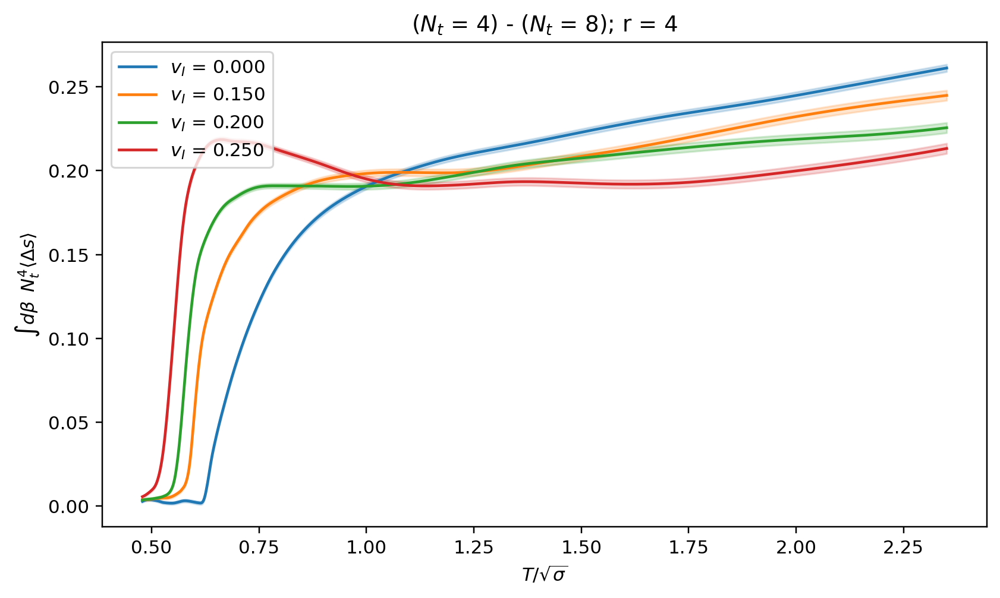

In [5]:
fig, ax = plotters.make_figure_and_111axis(plt)
velocities = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449, 0.2739, 0.3000])
# velocities = np.array([0.000, 0.150, 0.200, 0.250])

for v in [0.000, 0.150, 0.200, 0.250]:
    v_group_nt4 = calc_4w_ns_all_t.velocity_groups[v].data_holders
    v_group_nt8 = calc_8w_ns32_t.velocity_groups[v].data_holders
    for holder_nt4 in v_group_nt4:
        if holder_nt4.aspect_ratio != 4:
            continue
        for holder_nt8 in v_group_nt8:
            if holder_nt8.aspect_ratio != 4:
                continue
            beta_nt4, val_nt4, err_nt4 = holder_nt4.get_energy_data()
            temp_in_sigma_nt4 = np.array(
                [omegabeta_roenko.temperature_in_tension_units(beta, 4)
                 for beta in beta_nt4])
            beta_nt8, val_nt8, err_nt8 = holder_nt8.get_energy_data()
            temp_in_sigma_nt8 = np.array(
                [omegabeta_roenko.temperature_in_tension_units(beta, 8)
                 for beta in beta_nt8])
            nt4_splrep = plotters.SplineRep.from_points(temp_in_sigma_nt4,
                                                        val_nt4, err_nt4)
            nt8_splrep = plotters.SplineRep.from_points(temp_in_sigma_nt8,
                                                        val_nt8, err_nt8)
            plotters.draw_spl_rep(
                plt, ax,
                nt4_splrep.subtract_splrep(nt8_splrep, add_errors=False),
                # nt4_splrep,
                # nt8_splrep,
                velocity_colormap[v], label=f"$v_I$ = {v:.3f}")
plt.legend(loc="upper left")
plt.xlabel(r"$T/\sqrt{\sigma}$")
plt.ylabel(r"$\int d\beta \;\: N_t^4$$\langle \Delta s \rangle$")
plt.title("($N_t$ = 4) - ($N_t$ = 8); r = 4")
# plt.savefig(f"{output_dir_name}diff_eos_Nt4vsNt8_r4_vAll_001.png")
plt.show()

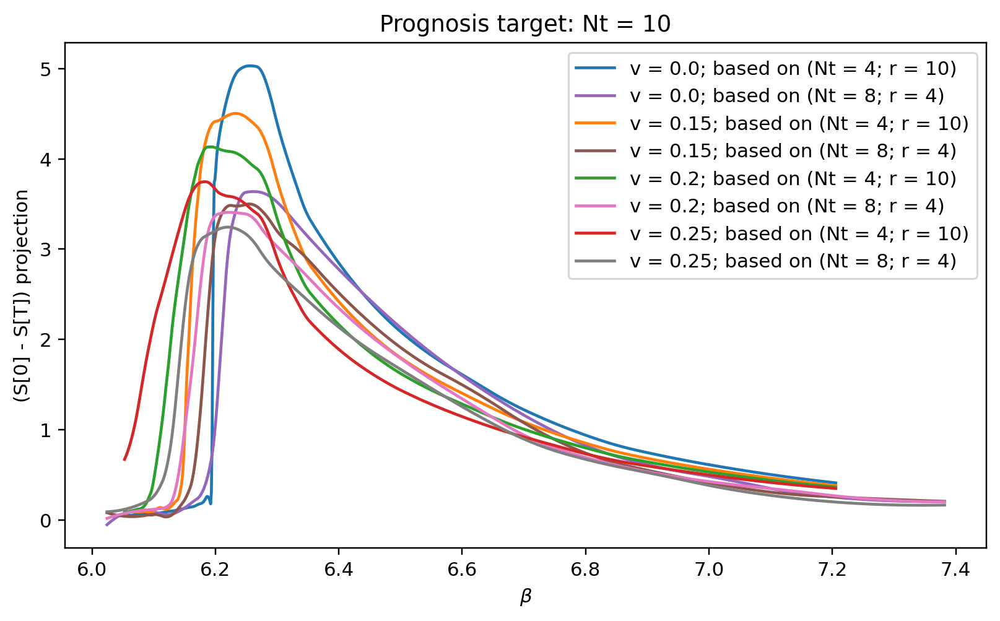

In [4]:
fig, ax = plotters.make_figure_and_111axis(plt)

target_nt = 10
target_temp_min_in_mev = scale_setter_ext.get_temperature_in_mev(
    [5.6], target_nt)
target_temp_max_in_mev = scale_setter_ext.get_temperature_in_mev(
    [7.4], target_nt)

step = 0.0001
converter_accuracy = 0.000001
for counter, v in enumerate([0.00, 0.15, 0.20, 0.25]):
    v_group_nt4 = calc_4w_ns_all_t.velocity_groups[v].data_holders
    v_group_nt8 = calc_8w_ns32_t.velocity_groups[v].data_holders
    for holder_nt4 in v_group_nt4:
        if holder_nt4.aspect_ratio != 10:
            continue
        for holder_nt8 in v_group_nt8:
            if holder_nt8.aspect_ratio != 4:
                continue
            _beta_nt4, _val_nt4, _err_nt4 = holder_nt4.get_energy_data()
            beta_nt4 = []
            val_nt4 = []
            err_nt4 = []
            for i, beta in enumerate(_beta_nt4):
                if 5.6 <= beta <= 7.4:
                    t = scale_setter_ext.get_temperature_in_mev([beta], 4)
                    if target_temp_min_in_mev <= t <= target_temp_max_in_mev:
                        beta_nt4.append(beta)
                        val_nt4.append(_val_nt4[i])
                        err_nt4.append(_err_nt4[i])
            temp_in_mev_nt4 = scale_setter_ext.get_temperature_in_mev(
                beta_nt4, 4)
            target_beta_from_nt4 = (
                scale_setter_ext.beta_from_temperature_in_mev(
                    temp_in_mev_nt4, target_nt, converter_accuracy))

            _beta_nt8, _val_nt8, _err_nt8 = holder_nt8.get_energy_data()
            beta_nt8 = []
            val_nt8 = []
            err_nt8 = []
            for i, beta in enumerate(_beta_nt8):
                if 5.6 <= beta <= 7.4:
                    t = scale_setter_ext.get_temperature_in_mev([beta], 8)
                    if target_temp_min_in_mev <= t <= target_temp_max_in_mev:
                        beta_nt8.append(beta)
                        val_nt8.append(_val_nt8[i])
                        err_nt8.append(_err_nt8[i])
            temp_in_mev_nt8 = scale_setter_ext.get_temperature_in_mev(
                beta_nt8, 8)

            target_beta_from_nt8 = (
                scale_setter_ext.beta_from_temperature_in_mev(
                    temp_in_mev_nt8, target_nt, converter_accuracy))

            _nt4_splrep = plotters.SplineRep.from_points(target_beta_from_nt4,
                                                         val_nt4, err_nt4)
            target_beta_from_nt4_for_prognosis = np.arange(
                target_beta_from_nt4[0], target_beta_from_nt4[-1], step=step)
            nt4_delta_s_prognosis = _nt4_splrep.calculate_der_in_points(
                target_beta_from_nt4_for_prognosis, 1)
            nt4_splrep = plotters.SplineRep.from_points(
                target_beta_from_nt4_for_prognosis, nt4_delta_s_prognosis)

            _nt8_splrep = plotters.SplineRep.from_points(target_beta_from_nt8,
                                                         val_nt8, err_nt8)
            target_beta_from_nt8_for_prognosis = np.arange(
                target_beta_from_nt8[0], target_beta_from_nt8[-1], step=step)
            nt8_delta_s_prognosis = _nt8_splrep.calculate_der_in_points(
                target_beta_from_nt8_for_prognosis, 1)
            nt8_splrep = plotters.SplineRep.from_points(
                target_beta_from_nt8_for_prognosis, nt8_delta_s_prognosis)

            plotters.draw_spl_rep(
                plt, ax, nt4_splrep, f"C{counter}",
                label=f"$v_I$ = {v:.2f}; based on ($N_t$ = 4; r = 10)")
            plotters.draw_spl_rep(
                plt, ax, nt8_splrep, f"C{counter + 4}",
                label=f"$v_I$ = {v:.2f}; based on ($N_t$ = 8; r = 4)")
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle \Delta s \rangle$ projection")
plt.title(f"Prognosis target: $N_t$ = {target_nt}")
# plt.xlim([5.65, 5.90])  # target_nt = 5
# plt.xlim([5.70, 5.95])  # target_nt = 6
# plt.xlim([5.80, 6.05])  # target_nt = 7
# plt.xlim([5.90, 6.15])  # target_nt = 8
# plt.xlim([5.95, 6.20])  # target_nt = 9
# plt.xlim([6.00, 6.25])  # target_nt = 10
# plt.savefig(f"{output_dir_name}delta_s_transition_prognosis_nt{target_nt}_v2.png")
plt.show()

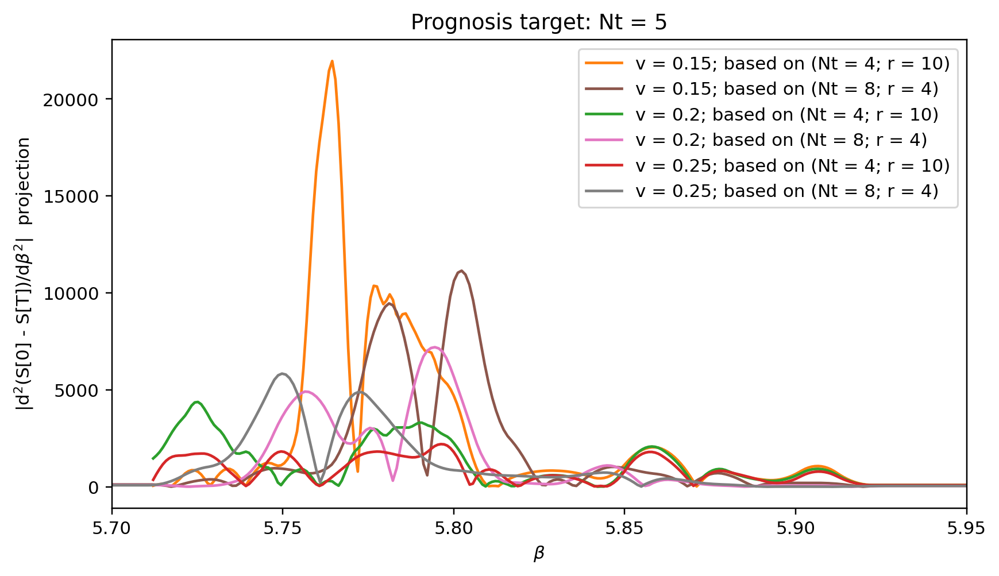

In [6]:
fig, ax = plotters.make_figure_and_111axis(plt)

target_nt = 5
target_temp_min_in_mev = scale_setter_ext.get_temperature_in_mev(
    [5.6], target_nt)
target_temp_max_in_mev = scale_setter_ext.get_temperature_in_mev(
    [7.4], target_nt)

step = 0.0001
converter_accuracy = 0.000001
width = 0.010
step_2nd_der = 0.001
for counter, v in enumerate([0.15, 0.20, 0.25]):
    v_group_nt4 = calc_4w_ns_all_t.velocity_groups[v].data_holders
    v_group_nt8 = calc_8w_ns32_t.velocity_groups[v].data_holders
    for holder_nt4 in v_group_nt4:
        if holder_nt4.aspect_ratio != 10:
            continue
        for holder_nt8 in v_group_nt8:
            if holder_nt8.aspect_ratio != 4:
                continue
            _beta_nt4, _val_nt4, _err_nt4 = holder_nt4.get_energy_data()
            beta_nt4 = []
            val_nt4 = []
            err_nt4 = []
            for i, beta in enumerate(_beta_nt4):
                if 5.6 <= beta <= 7.4:
                    t = scale_setter_ext.get_temperature_in_mev([beta], 4)
                    if target_temp_min_in_mev <= t <= target_temp_max_in_mev:
                        beta_nt4.append(beta)
                        val_nt4.append(_val_nt4[i])
                        err_nt4.append(_err_nt4[i])
            temp_in_mev_nt4 = scale_setter_ext.get_temperature_in_mev(
                beta_nt4, 4)

            target_beta_from_nt4 = (
                scale_setter_ext.beta_from_temperature_in_mev(
                    temp_in_mev_nt4, target_nt, converter_accuracy))
            _beta_nt8, _val_nt8, _err_nt8 = holder_nt8.get_energy_data()
            beta_nt8 = []
            val_nt8 = []
            err_nt8 = []
            for i, beta in enumerate(_beta_nt8):
                if 5.6 <= beta <= 7.4:
                    t = scale_setter_ext.get_temperature_in_mev([beta], 8)
                    if target_temp_min_in_mev <= t <= target_temp_max_in_mev:
                        beta_nt8.append(beta)
                        val_nt8.append(_val_nt8[i])
                        err_nt8.append(_err_nt8[i])
            temp_in_mev_nt8 = scale_setter_ext.get_temperature_in_mev(
                beta_nt8, 8)
            target_beta_from_nt8 = (
                scale_setter_ext.beta_from_temperature_in_mev(
                    temp_in_mev_nt8, target_nt, converter_accuracy))

            _nt4_splrep = plotters.SplineRep.from_points(target_beta_from_nt4,
                                                         val_nt4, err_nt4)
            target_beta_from_nt4_for_prognosis = np.arange(
                target_beta_from_nt4[0], target_beta_from_nt4[-1], step=step)
            nt4_delta_s_prognosis = _nt4_splrep.calculate_der_in_points(
                target_beta_from_nt4_for_prognosis, 1)
            nt4_splrep_delta_s = plotters.SplineRep.from_points(
                target_beta_from_nt4_for_prognosis, nt4_delta_s_prognosis)
            target_beta_from_nt4_for_2nd_der_prognosis = np.arange(
                target_beta_from_nt4[0] + 2 * width,
                target_beta_from_nt4[-1] - 2 * width, step=step_2nd_der)
            der_val_nt4 = []
            for beta in target_beta_from_nt4_for_2nd_der_prognosis:
                res, _ = nt4_splrep_delta_s.calculate_points([beta - width,
                                                              beta,
                                                              beta + width])
                der_val_nt4.append(abs((res[0] + res[2] - 2 * res[1])
                                       / width**2))
            nt4_splrep = plotters.SplineRep.from_points(
                target_beta_from_nt4_for_2nd_der_prognosis, der_val_nt4)

            _nt8_splrep = plotters.SplineRep.from_points(target_beta_from_nt8,
                                                         val_nt8, err_nt8)
            target_beta_from_nt8_for_prognosis = np.arange(
                target_beta_from_nt8[0], target_beta_from_nt8[-1], step=step)
            nt8_delta_s_prognosis = _nt8_splrep.calculate_der_in_points(
                target_beta_from_nt8_for_prognosis, 1)
            nt8_splrep_delta_s = plotters.SplineRep.from_points(
                target_beta_from_nt8_for_prognosis, nt8_delta_s_prognosis)
            target_beta_from_nt8_for_2nd_der_prognosis = np.arange(
                target_beta_from_nt8[0] + 2 * width,
                target_beta_from_nt8[-1] - 2 * width, step=step_2nd_der)
            der_val_nt8 = []
            for beta in target_beta_from_nt8_for_2nd_der_prognosis:
                res, _ = nt8_splrep_delta_s.calculate_points([beta - width,
                                                              beta,
                                                              beta + width])
                der_val_nt8.append(abs((res[0] + res[2] - 2 * res[1])
                                       / width**2))
            nt8_splrep = plotters.SplineRep.from_points(
                target_beta_from_nt8_for_2nd_der_prognosis, der_val_nt8)

            plotters.draw_spl_rep(
                plt, ax, nt4_splrep, f"C{counter}",
                label=f"$v_I$ = {v:.2f}; based on ($N_t$ = 4; r = 10)")
            plotters.draw_spl_rep(
                plt, ax, nt8_splrep, f"C{counter + 4}",
                label=f"$v_I$ = {v:.2f}; based on ($N_t$ = 8; r = 4)")
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel(r"|d${}^2$$\langle \Delta s \rangle$/d$\beta^2$|  projection")
plt.title(f"Prognosis target: $N_t$ = {target_nt}")
# plt.ylim([5, 20000])
# plt.ylim([0.5, 110])
plt.xlim([5.70, 5.95]) # target_nt = 5
# plt.xlim([5.70, 5.95]) # target_nt = 6
# plt.xlim([5.80, 6.05]) # target_nt = 7
# plt.xlim([5.90, 6.15]) # target_nt = 8
# plt.xlim([5.95, 6.20]) # target_nt = 9
# plt.xlim([6.00, 6.25]) # target_nt = 10
# ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}delta_s_2nd_der_prognosis_nt{target_nt}_v1.png")
plt.show()

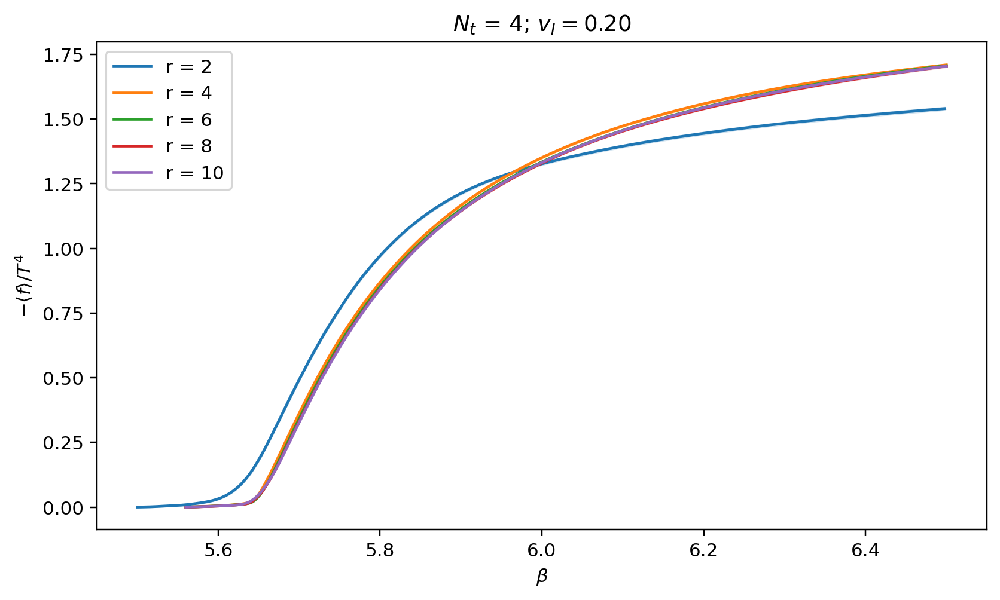

In [41]:
fig, ax = plotters.make_figure_and_111axis(plt)

for r in sorted(calc_4w_ns_all_t.inertia_analysis_dict):
    if r == 14:
        continue
    betas, en_val, en_err = calc_4w_ns_all_t.inertia_analysis_dict[r].get_energies()
    v = 0.20
    splerp = plotters.SplineRep.from_points(betas, en_val[v], en_err[v])
    # _, splerp = calc_4w_ns_all_t.inertia_analysis_dict[r].get_linear_fit_splrep()
    plotters.draw_spl_rep(plt, ax, splerp,
                          r_colormap[r], label=f"r = {int(r)}")
plt.legend(loc="upper left")
plt.xlabel(r"$\beta$")
# plt.ylabel("proportional to moment_of_inertia")
plt.ylabel("$- \langle f \\rangle/T^4$")
plt.title("$N_t$ = 4; $v_I = 0.20$")
# plt.savefig(f"{output_dir_name}c2only_nt4_000.png")
# plt.savefig(f"{output_dir_name}eos_nt4_diploma_000.png")
plt.show()

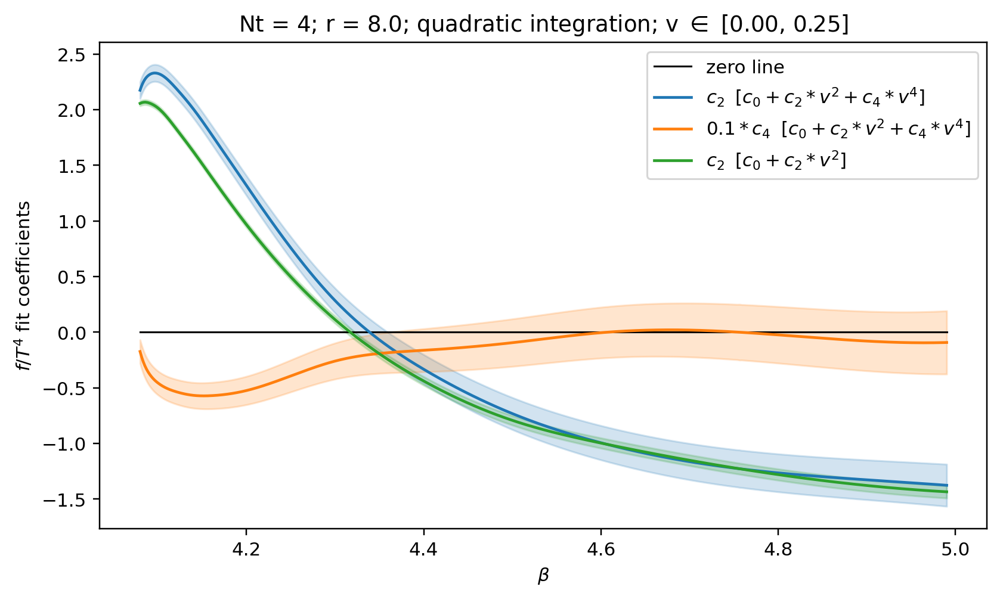

In [14]:
fig, ax = plotters.make_figure_and_111axis(plt)

r = 8.0
target_domain = domains.GeometricRange((4.08, 4.99))  # nt = 4 (imp)
# target_domain = domains.GeometricRange((5.693, 6.5))  # nt = 4

x_val = np.linspace(target_domain.left, target_domain.right)
# plt.plot(x_val, 0.0 * x_val)
plt.plot(x_val, 0.0 * x_val, label="zero line", color="black",
         linewidth=1.0)

_, c2_only_rep = calc_4s_ns32_q.inertia_analysis_dict[r].get_linear_fit_splrep()
_, c2_rep, c4_rep = calc_4s_ns32_q.inertia_analysis_dict[r].get_quadratic_fit_splrep()
plotters.draw_spl_rep(plt, ax, c2_rep, "C0",
                      label="$c_2 \;\; [c_0 + c_2 * v^2 + c_4 * v^4]$",
                      domain=target_domain)
plotters.draw_spl_rep(plt, ax, c4_rep.multiply_by_constant(0.1), "C1",
                      label="$0.1 * c_4 \;\; [c_0 + c_2 * v^2 + c_4 * v^4]$",
                      domain=target_domain)
plotters.draw_spl_rep(plt, ax, c2_only_rep, "C2",
                      label="$c_2 \;\; [c_0 + c_2 * v^2]$",
                      domain=target_domain)
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle f \\rangle/T^4$ fit coefficients")
plt.title(f"$N_t$ = 4; r = {r:.1f}; quadratic integration; "
          "v $\in$ [0.00, 0.25]")
# plt.savefig(f"{output_dir_name}diff_c2_vs_c2c4_nt4imp_ns32_000.png")
plt.show()

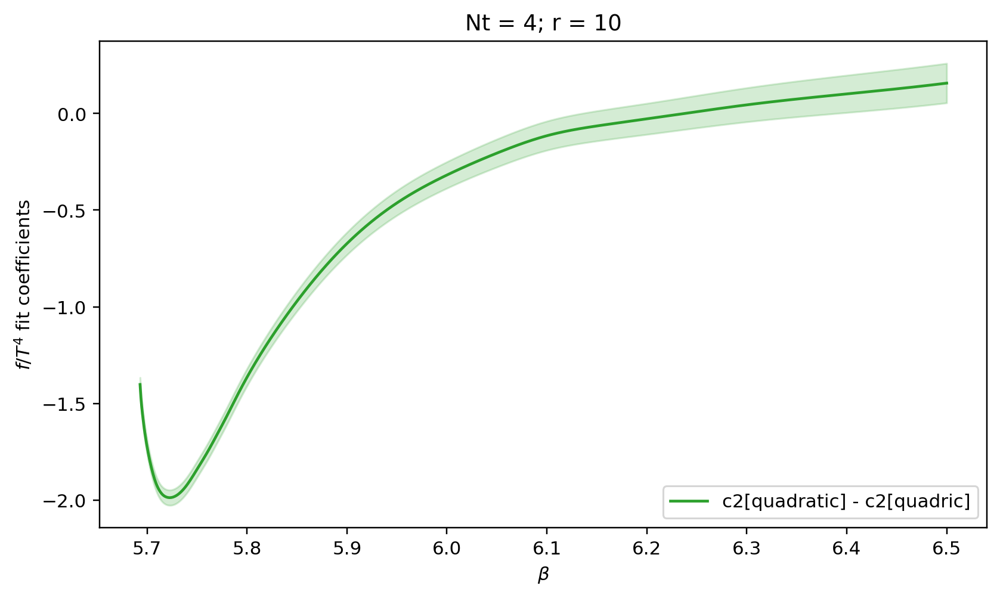

In [25]:
_, ax = plotters.make_figure_and_111axis(plt)

r = 10
_, c2_only_rep = calc_4w_ns_all_t.inertia_analysis_dict[r].get_linear_fit_splrep()
_, c2_rep, _ = calc_4w_ns_all_t.inertia_analysis_dict[r].get_quadratic_fit_splrep()
plotters.draw_spl_rep(plt, ax, c2_only_rep.subtract_splrep(c2_rep), "C2",
                      label="c2[quadratic] - c2[quadric]",
                      domain=domains.GeometricRange((5.693, 6.5)))
plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle f \\rangle/T^4$ fit coefficients")
plt.title(f"$N_t$ = 4; r = {r}")
# plt.savefig(f"{output_dir_name}diff_c2_linsqr_nt4_ns40_000.png")
plt.show()

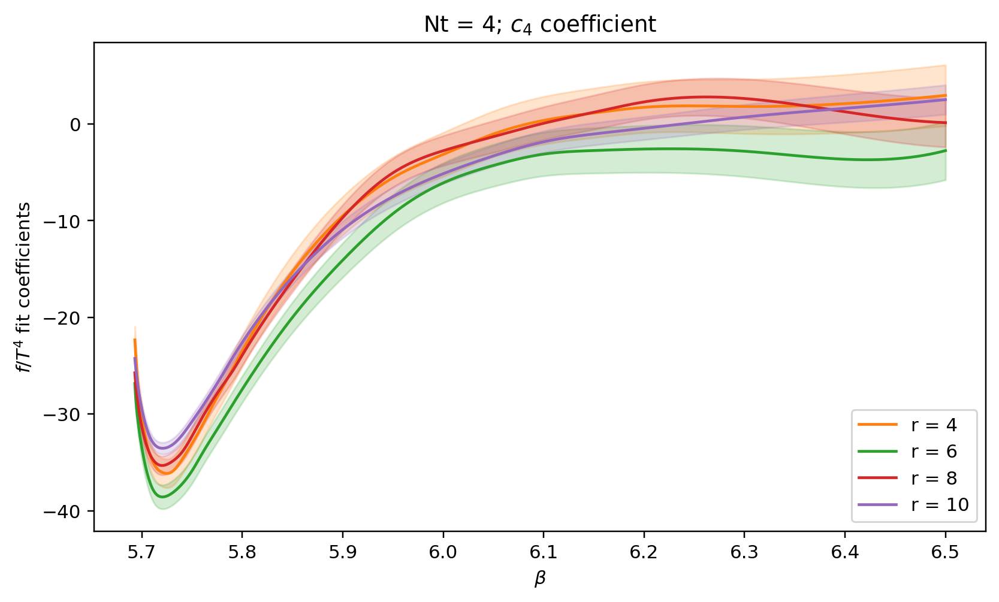

In [26]:
_, ax = plotters.make_figure_and_111axis(plt)

for r in [4, 6, 8, 10]:
    _, _, c4_rep = calc_4w_ns_all_t.inertia_analysis_dict[r].get_quadratic_fit_splrep()
    plotters.draw_spl_rep(plt, ax, c4_rep, r_colormap[r], label=f"r = {r}",
                          domain=domains.GeometricRange((5.693, 6.5)))
plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle f \\rangle/T^4$ fit coefficients")
plt.title("$N_t$ = 4; $c_4$ coefficient")
# plt.savefig(f"{output_dir_name}c4_nt4_nsAll_000.png")
plt.show()

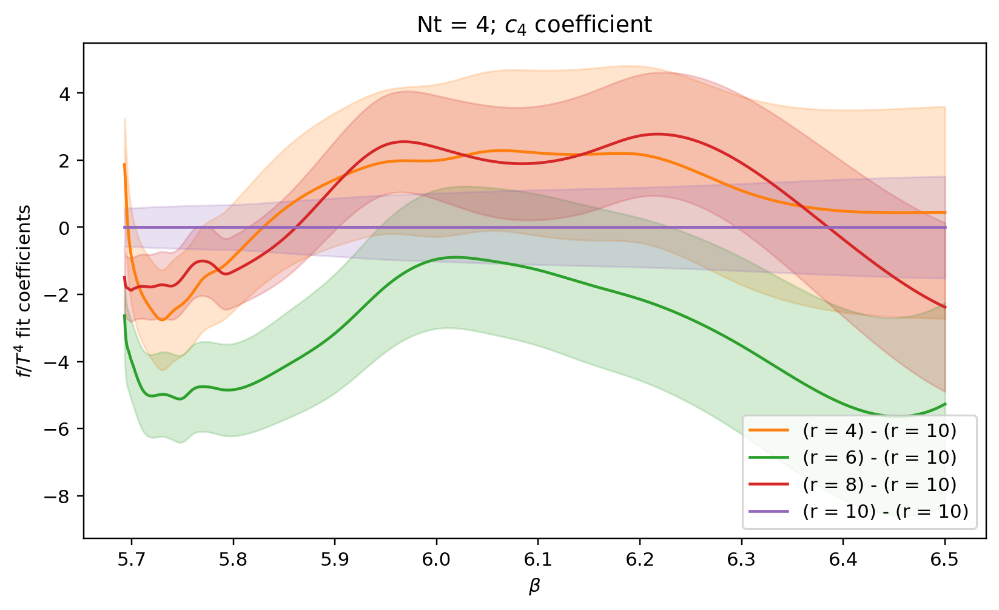

In [27]:
_, ax = plotters.make_figure_and_111axis(plt)

r_base = 10
_, _, c4_base_rep = calc_4w_ns_all_t.inertia_analysis_dict[r_base].get_quadratic_fit_splrep()
for r in [4, 6, 8, 10]:
    _, _, c4_rep = calc_4w_ns_all_t.inertia_analysis_dict[r].get_quadratic_fit_splrep()
    plotters.draw_spl_rep(
        plt, ax, c4_rep.subtract_splrep(c4_base_rep, add_errors=False),
        r_colormap[r], label=f"(r = {r}) - (r = {r_base})",
        domain=domains.GeometricRange((5.693, 6.5)))
plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle f \\rangle/T^4$ fit coefficients")
plt.title("$N_t$ = 4; $c_4$ coefficient")
# plt.savefig(f"{output_dir_name}diff_c4_nt4_nsAll_000.png")
plt.show()

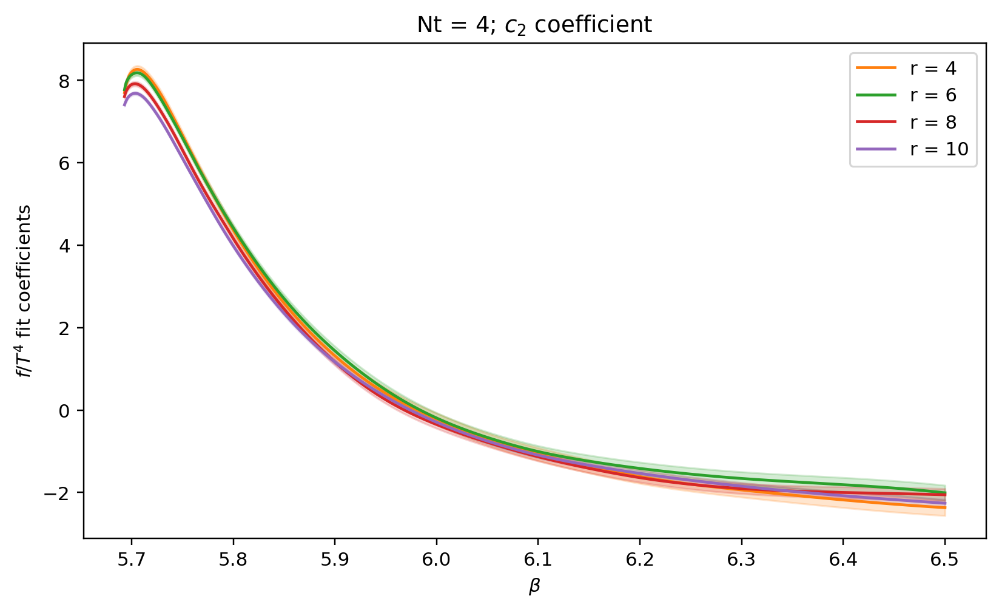

In [28]:
_, ax = plotters.make_figure_and_111axis(plt)

for r in [4, 6, 8, 10]:
    _, c2_rep, _ = calc_4w_ns_all_t.inertia_analysis_dict[r].get_quadratic_fit_splrep()
    plotters.draw_spl_rep(plt, ax, c2_rep, r_colormap[r], label=f"r = {r}",
                          domain=domains.GeometricRange((5.693, 6.5)))
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle f \\rangle/T^4$ fit coefficients")
plt.title("$N_t$ = 4; $c_2$ coefficient")
# plt.savefig(f"{output_dir_name}c2_nt4_nsAll_000.png")
plt.show()

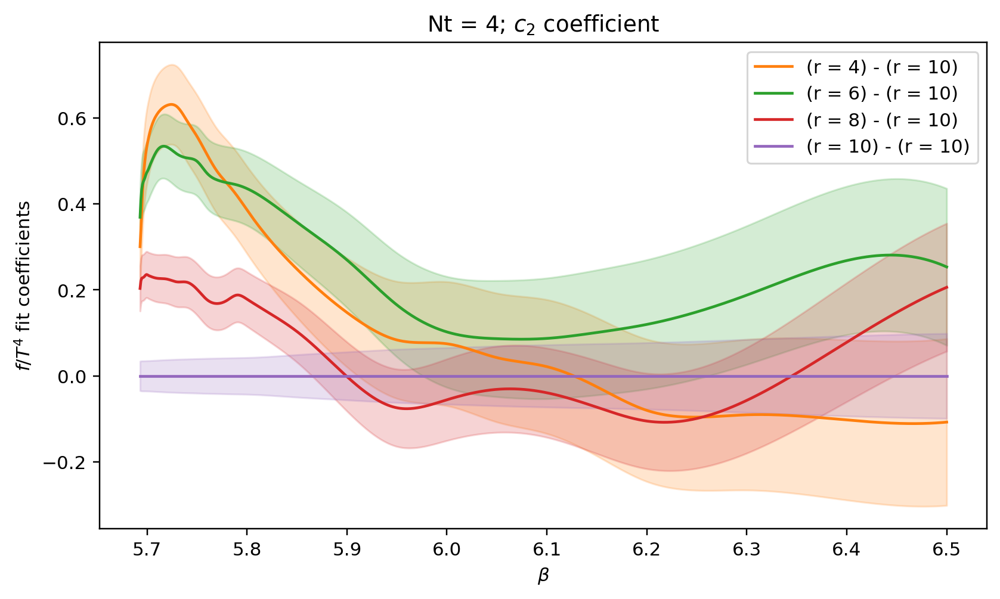

In [29]:
_, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((5.693, 6.5))
target_domain = None
r_base = 10
_, c2_base_rep, _ = calc_4w_ns_all_t.inertia_analysis_dict[r_base].get_quadratic_fit_splrep()
for r in [4, 6, 8, 10]:
    _, c2_rep, _ = calc_4w_ns_all_t.inertia_analysis_dict[r].get_quadratic_fit_splrep()
    plotters.draw_spl_rep(
        plt, ax, c2_rep.subtract_splrep(c2_base_rep, add_errors=False),
        r_colormap[r], label=f"(r = {r}) - (r = {r_base})",
        domain=target_domain)
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel("$\langle f \\rangle/T^4$ fit coefficients")
plt.title("$N_t$ = 4; $c_2$ coefficient")
# plt.savefig(f"{output_dir_name}diff_c2_nt4_nsAll_000.png")
plt.show()

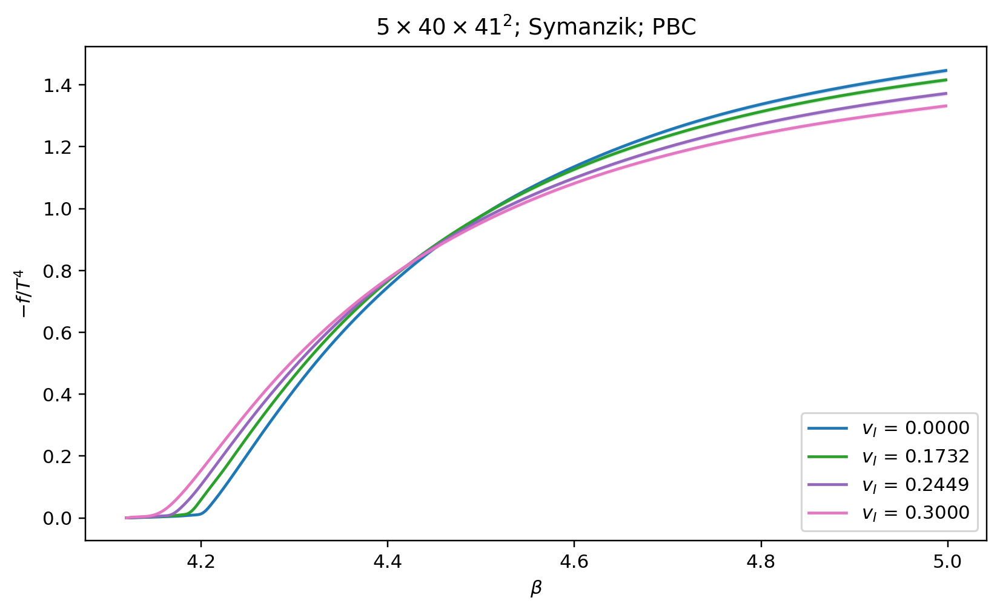

In [11]:
_, ax = plotters.make_figure_and_111axis(plt)

velocities = np.array([
    0.0000,
#     0.1225,
    0.1732,
#     0.2121,
    0.2449,
#     0.2739,
    0.3000,
])
# target_domain = domains.GeometricRange((5.693, 6.5))
target_domain = None
r = 40/5
betas, en_val, en_err = calc_5s_ns40_q.inertia_analysis_dict[r].get_energies()
for v in velocities:
    plotters.draw_spl_rep(
        plt, ax, plotters.SplineRep.from_points(betas, en_val[v], en_err[v]),
        velocity_colormap[v], label=f"$v_I$ = {v:.4f}", domain=target_domain)
plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
# plt.ylabel("$-\langle f \\rangle/T^4$")
plt.ylabel("$-f/T^4$")
# plt.title(f"$N_t$ = 4; Wilson; PBC; r = {r:.1f}")
plt.title(r"$5 \times 40 \times 41^2$; Symanzik; PBC")
plt.savefig(f"{output_dir_name}eos_nt5s_pres_v0.png")
# plt.show()

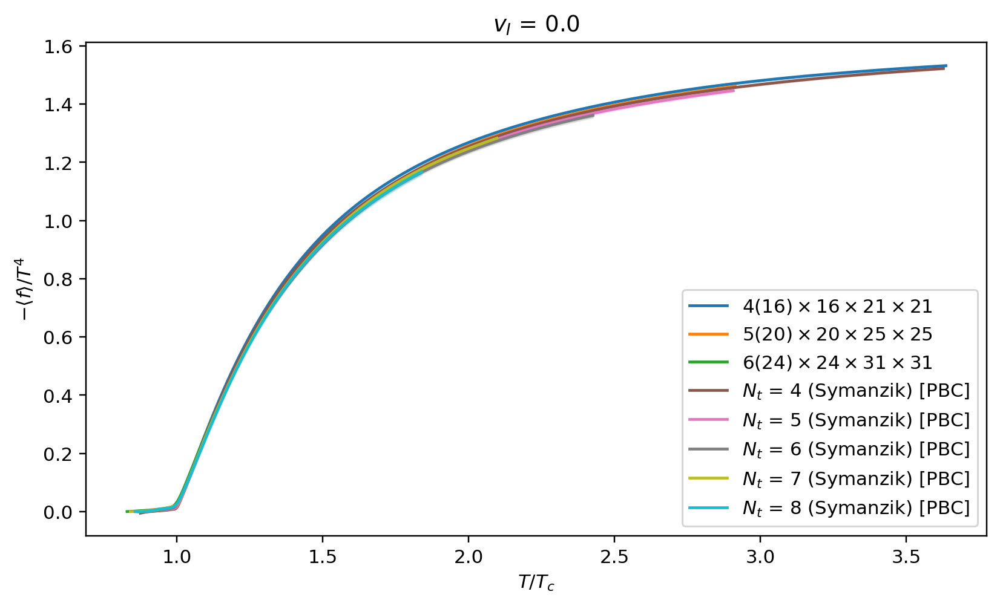

0 1.10 12.52 0.93 0.07
1 1.20 4.26 1.61 0.38
2 1.30 3.67 1.92 0.52
3 1.40 3.18 1.94 0.61
4 1.50 3.23 1.93 0.60
5 1.60 3.60 1.97 0.55
6 1.70 4.11 2.04 0.50
7 1.80 4.63 2.16 0.47


In [11]:
_, ax = plotters.make_figure_and_111axis(plt)

# target_domain = domains.GeometricRange((5.693, 6.5))
# target_domain = domains.GeometricRange((0.6, 1.8))
# target_domain = domains.GeometricRange((1.0, 2.4))
# target_domain = domains.GeometricRange((1.0, 1.8))
target_domain = None
v = 0.0
r_w = [10.0, 40/5, 40/6, 40/7, 4.0]
calc_w =[
    calc_4w_ns_all_q,
    calc_5w_ns40_q,
    calc_6w_ns40_q,
    calc_7w_ns40_q,
    calc_8w_ns32_q,
]
tc_in_mev_w = [
    tc_in_mev_nt4,
    tc_in_mev_nt5,
    tc_in_mev_nt6,
    tc_in_mev_nt7,
    tc_in_mev_nt8,
]
rep_w: List[Optional[plotters.SplineRep]] = [None for i in range(5)]

betas, en_val, en_err = calc_6s_ns40_q.inertia_analysis_dict[40/6].get_energies()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 6) / tc_in_mev_nt6imp
base_rep = plotters.SplineRep.from_points(temp_per_tc, en_val[v], en_err[v])

for i in range(5):
    nt = i + 4
    betas, en_val, en_err = calc_w[i].inertia_analysis_dict[r_w[i]].get_energies()
    if i == 0:
        betas = np.array([j for j in betas[25:]])
        en_val = np.array([j for j in en_val[v][25:]])
        en_err = np.array([j for j in en_err[v][25:]])
    else:
        en_val = en_val[v]
        en_err = en_err[v]
    temp_per_tc = scale_setter_ext.get_temperature_in_mev(betas, nt) / tc_in_mev_w[i]
    rep_w[i] = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)

r_s = [40/4, 40/5, 40/6, 40/7, 40/8]
calc_s =[
    calc_4s_ns40_q,
    calc_5s_ns40_q,
    calc_6s_ns40_q,
    calc_7s_ns40_q,
    calc_8s_ns40_q,
]
tc_in_mev_s = [
    tc_in_mev_nt4imp,
    tc_in_mev_nt5imp,
    tc_in_mev_nt6imp,
    tc_in_mev_nt7imp,
    tc_in_mev_nt8imp,
]
rep_s: List[Optional[plotters.SplineRep]] = [None for i in range(5)]

for i in range(5):
    nt = i + 4
    betas, en_val, en_err = calc_s[i].inertia_analysis_dict[r_s[i]].get_energies()
    temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, nt) / tc_in_mev_s[i]
    rep_s[i] = plotters.SplineRep.from_points(temp_per_tc, en_val[v], en_err[v])

r_so = [40/4, 40/5, 40/6, 40/7, 40/8]
calc_so =[
    calc_4so_ns40_q,
    calc_5so_ns40_q,
    calc_6so_ns40_q,
    calc_7so_ns40_q,
    calc_8so_ns40_q,
]
tc_in_mev_so = [
    tc_in_mev_nt4imp_obc,
    tc_in_mev_nt5imp_obc,
    tc_in_mev_nt6imp_obc,
    tc_in_mev_nt7imp_obc,
    tc_in_mev_nt8imp_obc,
]
rep_so: List[Optional[plotters.SplineRep]] = [None for i in range(5)]

for i in range(5):
    nt = i + 4
    betas, en_val, en_err = calc_so[i].inertia_analysis_dict[r_so[i]].get_energies()
    temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, nt) / tc_in_mev_so[i]
    rep_so[i] = plotters.SplineRep.from_points(temp_per_tc, en_val[v], en_err[v])


# for i in range(1, 5):
#     plotters.draw_spl_rep(
#         plt, ax, rep_w[i].subtract_splrep(base_rep, add_errors=False),
#         f"C{i}", label=f"$N_t$ = {i + 4}", domain=target_domain)
# for i in range(5):
#     plotters.draw_spl_rep(
#         plt, ax, rep_s[i].subtract_splrep(base_rep, add_errors=False),
#         f"C{i + 5}", label=f"$N_t$ = {i + 4} (imp)", domain=target_domain)

betas, en_val, en_err = data_holder_nt4_t.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 4) / tc_in_mev_nt4imp
rep_nt4_t = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt4_t,
    "C0", label=r"$4(16) \times 16 \times 21 \times 21$", domain=target_domain)

betas, en_val, en_err = data_holder_nt5_t.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 5) / tc_in_mev_nt5imp
rep_nt5_t = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt5_t,
    "C1", label=r"$5(20) \times 20 \times 25 \times 25$", domain=target_domain)

betas, en_val, en_err = data_holder_nt6_t.get_energy_data()
temp_per_tc = symanzik_scale_setter.get_temperature_in_mev(betas, 6) / tc_in_mev_nt6imp
rep_nt6_t = plotters.SplineRep.from_points(temp_per_tc, en_val, en_err)
plotters.draw_spl_rep(
    plt, ax, rep_nt6_t,
    "C2", label=r"$6(24) \times 24 \times 31 \times 31$", domain=target_domain)

# for i in range(1, 5):
#     plotters.draw_spl_rep(
#         plt, ax, rep_w[i],
#         f"C{i}", label=f"$N_t$ = {i + 4} (Wilson) [PBC]", domain=target_domain)
for i in range(5):
    plotters.draw_spl_rep(
        plt, ax, rep_s[i],
        f"C{i + 5}", label=f"$N_t$ = {i + 4} (Symanzik) [PBC]", domain=target_domain)
# for i in range(5):
#     plotters.draw_spl_rep(
#         plt, ax, rep_so[i],
#         f"C{i}", label=f"$N_t$ = {i + 4} (Symanzik) [OBC]", domain=target_domain)
# plt.legend(loc="upper left")
plt.legend(loc="lower right")
plt.xlabel("$T/T_c$")
plt.ylabel("$-\langle f \\rangle/T^4$")
plt.title(f"$v_I$ = 0.0")
# plt.savefig(f"{output_dir_name}eos_all_004.png")
plt.show()
#
t_per_tc_target = np.linspace(1.10, 1.80, 8)

for counter_out, t_per_tc in enumerate(t_per_tc_target):
    # fig, ax = plotters.make_figure_and_111axis(plt)

    i_w = [i for i in range(1, 5)]
    i_s = [i for i in range(5)]
    prep_w: List[Optional[plotters.PointRep]] = [None for i in range(5)]
    prep_s: List[Optional[plotters.PointRep]] = [None for i in range(5)]

    shift = 0.0003
    for i in i_w:
        en_val, en_err = rep_w[i].calculate_points([t_per_tc])
        prep_w[i] = plotters.PointRep([1 / (4 + i)**2 - shift], en_val, en_err)
    for i in i_s:
        en_val, en_err = rep_s[i].calculate_points([t_per_tc])
        prep_s[i] = plotters.PointRep([1 / (4 + i)**2 + shift], en_val, en_err)

    frac_w = (prep_w[1].y_val[0] - prep_w[-1].y_val[0]) / (1/5**2 - 1/8**2)
    frac_s = (prep_s[0].y_val[0] - prep_s[-3].y_val[0]) / (1/4**2 - 1/6**2)
    print(f"{counter_out} {t_per_tc:.2f} {frac_w/frac_s:.2f} {frac_w:.2f} {frac_s:.2f}")

    # wilson_marker = "o"
    # symanzik_marker = "v"
    # for i in i_w:
    #     plotters.draw_point_rep(plt, ax, prep_w[i],
    #                             f"C{i}", label=f"$N_t$ = {i + 4} (Wilson)", markertype=wilson_marker)
    # for i in i_s:
    #     plotters.draw_point_rep(plt, ax, prep_s[i],
    #                             f"C{5 + i}", label=f"$N_t$ = {i + 4} (Symanzik)", markertype=symanzik_marker)
    # plt.xlim([-0.005, 0.10])
    # # plt.xlim([-0.005, 0.065])
    # plt.legend(loc="upper right")
    # plt.xlabel("$1/N_s^2$")
    # plt.ylabel("$-\langle f \\rangle/T^4$")
    # plt.title(f"$v_I$ = 0.0; $T/T_c$ = {t_per_tc:.2f}")
    # # plt.savefig(f"{output_dir_name}eos_nt4_ns40_000.png")
    # plt.show()

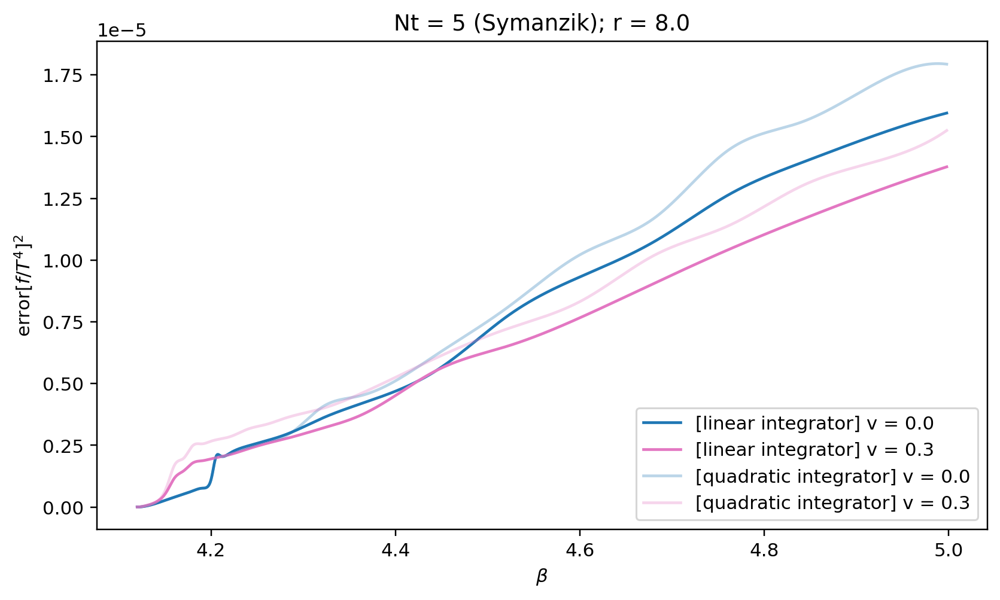

In [16]:
_, ax = plotters.make_figure_and_111axis(plt)

target_v = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449, 0.2739, 0.3000])
# target_v = np.array([0.00, 0.15, 0.20, 0.25])

# target_domain = domains.GeometricRange((5.693, 6.5))
target_domain = None
# r = 10.0
r = 40/5
# r = 4.0
calc1 = calc_5s_ns40_t
calc2 = calc_5s_ns40_q
betas, en_val, en_err = calc1.inertia_analysis_dict[r].get_energies()
for v in target_v:
    if not (v == 0.0 or v == 0.3):
        continue
    plotters.draw_spl_rep(
        plt, ax, plotters.SplineRep.from_points(betas, en_err[v]**2),
        velocity_colormap[v], label=f"[linear integrator] $v_I$ = {v}", domain=target_domain)
betas, en_val, en_err = calc2.inertia_analysis_dict[r].get_energies()
for v in target_v:
    if not (v == 0.0 or v == 0.3):
        continue
    plotters.draw_spl_rep(
        plt, ax, plotters.SplineRep.from_points(betas, en_err[v]**2),
        velocity_colormap[v], label=f"[quadratic integrator] $v_I$ = {v}", domain=target_domain,
        alpha=0.3)
plt.legend(loc="lower right")
plt.xlabel(r"$\beta$")
plt.ylabel("error$[\langle f \\rangle/T^4]^2$")
plt.title(f"$N_t$ = 5 (Symanzik); r = {r:.1f}")
# plt.savefig(f"{output_dir_name}eos_err_nt5imp_ns40_002.png")
plt.show()

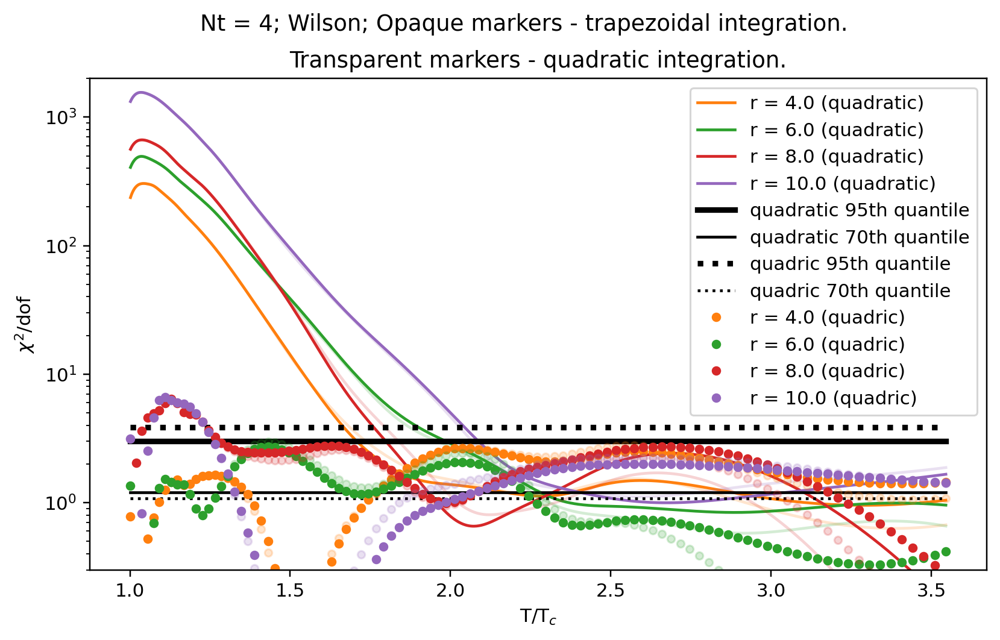

In [99]:
fig, ax = plotters.make_figure_and_111axis(plt)

velocities = np.array([0.00, 0.15, 0.20, 0.25])
velocity_to_idx = {
    0.00: 0,
    0.15: 1,
    0.20: 2,
    0.25: 3,
}
# velocities = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449, 0.2739, 0.3000])
# velocity_to_idx = {
#     0.0000: 0,
#     0.1225: 1,
#     0.1732: 2,
#     0.2121: 3,
#     0.2449: 4,
#     0.2739: 5,
#     0.3000: 6,
# }
# velocities = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449])
# velocity_to_idx = {
#     0.0000: 0,
#     0.1225: 1,
#     0.1732: 2,
#     0.2121: 3,
#     0.2449: 4,
# }
# target_beta_domain = domains.GeometricRange((4.09, 4.95))  # nt = 4 (imp)
# target_beta_domain = domains.GeometricRange((4.21, 4.95))  # nt = 5 (imp)
# target_beta_domain = domains.GeometricRange((4.33, 4.95))  # nt = 6 (imp)
target_beta_domain = domains.GeometricRange((5.70, 6.45))  # nt = 4
# target_beta_domain = domains.GeometricRange((5.80, 6.75))  # nt = 5
# target_beta_domain = domains.GeometricRange((5.90, 6.75))  # nt = 6
# target_beta_domain = domains.GeometricRange((6.00, 6.75))  # nt = 7
# target_beta_domain = domains.GeometricRange((6.10, 7.10))  # nt = 8
betas = np.linspace(target_beta_domain.left, target_beta_domain.right, 100)
# r_to_plot = [32/4]  # nt = 4 (imp0)
# r_to_plot = [40/4]  # nt = 4 (imp)
# r_to_plot = [40/5]  # nt = 5 (imp)
# r_to_plot = [40/6]  # nt = 6 (imp)
r_to_plot = [4.0, 6.0, 8.0, 10.0]  # nt = 4
# r_to_plot = [40/5]  # nt = 5
# r_to_plot = [40/6]  # nt = 6
# r_to_plot = [40/7]  # nt = 7
# r_to_plot = [4.0]  # nt = 8
# t_crit = tc_in_mev_nt6
# t_per_tc = (symanzik_scale_setter.get_temperature_in_mev(betas, 6)
#             / tc_in_mev_nt6imp)
t_per_tc = scale_setter.get_temperature_in_mev(betas, 4) / tc_in_mev_nt4
target_t_per_tc_domain = domains.GeometricRange((t_per_tc[0], t_per_tc[-1]))
for r in r_to_plot:
    for counter, calc in enumerate([calc_4w_ns_all_t, calc_4w_ns_all_q]):
        chi_sqr_quadratic = np.ones(len(betas))
        chi_sqr_quadric = np.ones(len(betas))
        inertia_calc = calc.inertia_analysis_dict[r]
        for beta_idx, beta in enumerate(betas):
            energies = 0.0 * velocities
            energy_errors = 0.0 * velocities
            for holder in inertia_calc.holders_pool.data_holders:
                idx = velocity_to_idx[holder.velocity]
                val, err = holder.get_energy_interpolation_at_values([beta])
                energies[idx] = val
                energy_errors[idx] = err
            c0_rep, c2_rep, c4_rep = inertia_calc.get_quadratic_fit_splrep()
            c0, _ = c0_rep.calculate_points([beta])
            c2, _ = c2_rep.calculate_points([beta])
            c4, _ = c4_rep.calculate_points([beta])
            energies_fit = c0 + c2 * velocities**2 + c4 * velocities**4
            chi_sqr = np.sum(((energies - energies_fit) / energy_errors)**2)
            dof = len(energies) - 3
            chi_sqr_quadric[beta_idx] = chi_sqr / dof

            c0_rep, c2_rep = inertia_calc.get_linear_fit_splrep()
            c0, _ = c0_rep.calculate_points([beta])
            c2, _ = c2_rep.calculate_points([beta])
            energies_fit = c0 + c2 * velocities**2
            chi_sqr = np.sum(((energies - energies_fit) / energy_errors)**2)
            dof = len(energies) - 2
            chi_sqr_quadratic[beta_idx] = chi_sqr / dof
        alpha = (1.0 if counter == 0 else 0.20)
        label_2 = (f"r = {r:.1f} (quadratic)" if counter == 0 else None)
        label_4 = (f"r = {r:.1f} (quadric)" if counter == 0 else None)
        result_rep = plotters.SplineRep.from_points(t_per_tc, chi_sqr_quadratic)
        plotters.draw_spl_rep(plt, ax, result_rep, r_colormap[r],
                              label=label_2,
                              domain=target_t_per_tc_domain, alpha=alpha)
        plotters.draw_point_rep(plt, ax, plotters.PointRep(t_per_tc,
                                                           chi_sqr_quadric),
                                r_colormap[r], label=label_4, linestyle="",
                                domain=target_t_per_tc_domain, alpha=alpha)
_betas = np.linspace(t_per_tc[0], t_per_tc[-1])
chi_dof1_95 = 3.841 * np.ones(len(_betas))  # dof = 1
chi_dof2_95 = 2.996 * np.ones(len(_betas))  # dof = 2
chi_dof3_95 = 2.605 * np.ones(len(_betas))  # dof = 3
chi_dof4_95 = 2.372 * np.ones(len(_betas))  # dof = 4
chi_dof5_95 = 2.214 * np.ones(len(_betas))  # dof = 5
chi_dof1_70 = 1.074 * np.ones(len(_betas))  # dof = 1
chi_dof2_70 = 1.204 * np.ones(len(_betas))  # dof = 2
chi_dof3_70 = 1.222 * np.ones(len(_betas))  # dof = 3
chi_dof4_70 = 1.220 * np.ones(len(_betas))  # dof = 4
chi_dof5_70 = 1.213 * np.ones(len(_betas))  # dof = 5
# quadratic_chi_dof_95 = chi_dof5_95
# quadric_chi_dof_95 = chi_dof4_95
# quadratic_chi_dof_70 = chi_dof5_70
# quadric_chi_dof_70 = chi_dof4_70
quadratic_chi_dof_95 = chi_dof2_95
quadric_chi_dof_95 = chi_dof1_95
quadratic_chi_dof_70 = chi_dof2_70
quadric_chi_dof_70 = chi_dof1_70
plt.plot(_betas, quadratic_chi_dof_95, linewidth=3, linestyle="solid",
         label="quadratic 95th quantile", color="black")
plt.plot(_betas, quadratic_chi_dof_70, linewidth=1.5, linestyle="solid",
         label="quadratic 70th quantile", color="black")
plt.plot(_betas, quadric_chi_dof_95, linewidth=3, linestyle="dotted",
         label="quadric 95th quantile", color="black")
plt.plot(_betas, quadric_chi_dof_70, linewidth=1.5, linestyle="dotted",
         label="quadric 70th quantile", color="black")
plt.legend(loc="upper right")
plt.xlabel("T/T${}_c$")
plt.ylabel(r"$\chi^2$/dof")
plt.suptitle("$N_t$ = 4; Wilson; Opaque markers - trapezoidal integration.")
plt.title("Transparent markers - quadratic integration.")
plt.ylim([3*10**-1, 2*10**3])  # nt = 4
# plt.ylim([3*10**-1, 5*10**1])  # nt = 5
ax.set_yscale("log")
# plt.savefig(f"{output_dir_name}c4_significance/quantile_nt4w_nsAll_000.png")
plt.show()

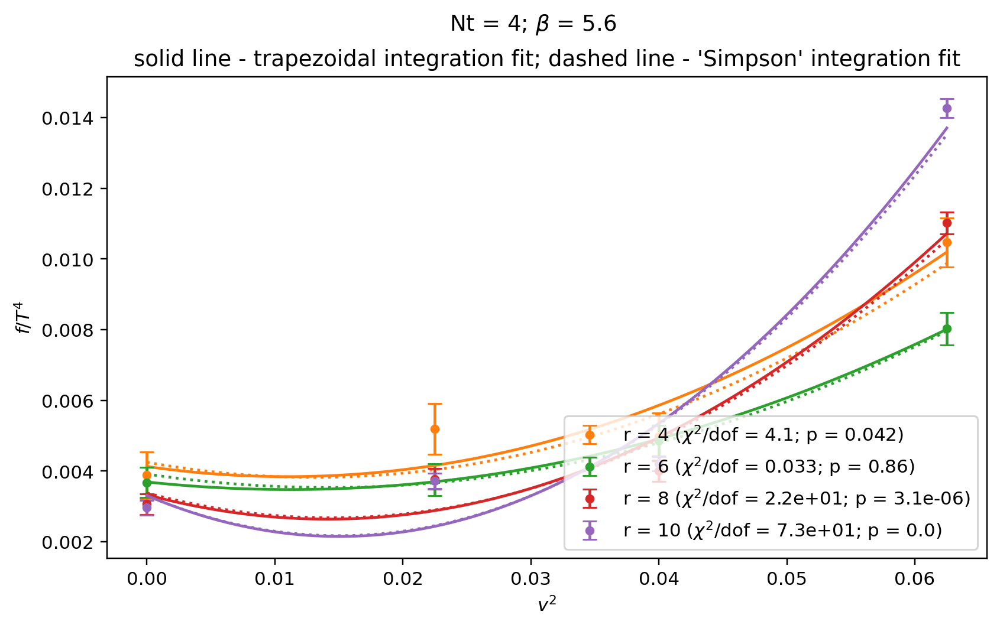

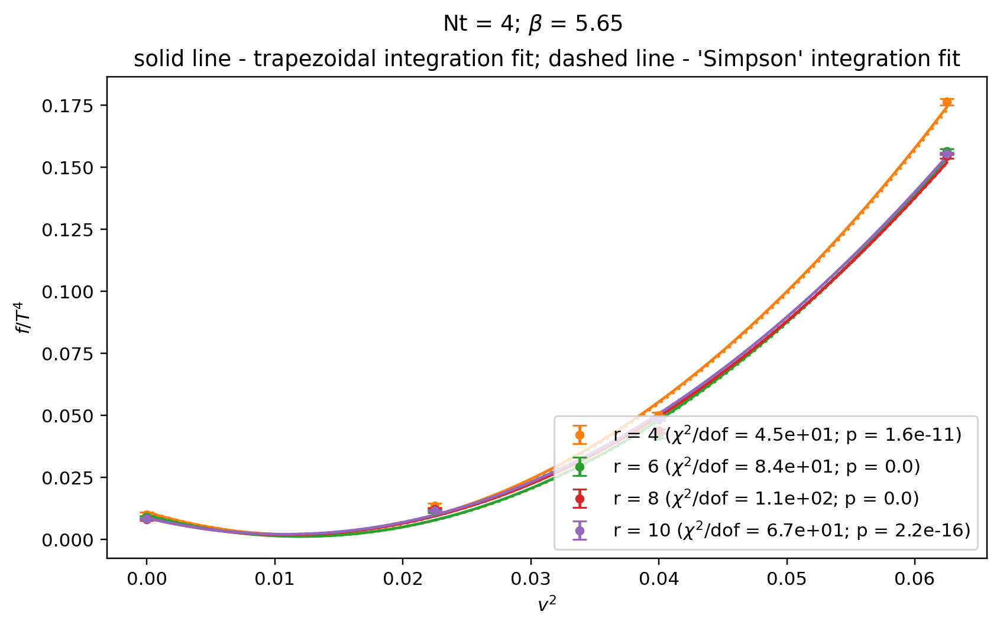

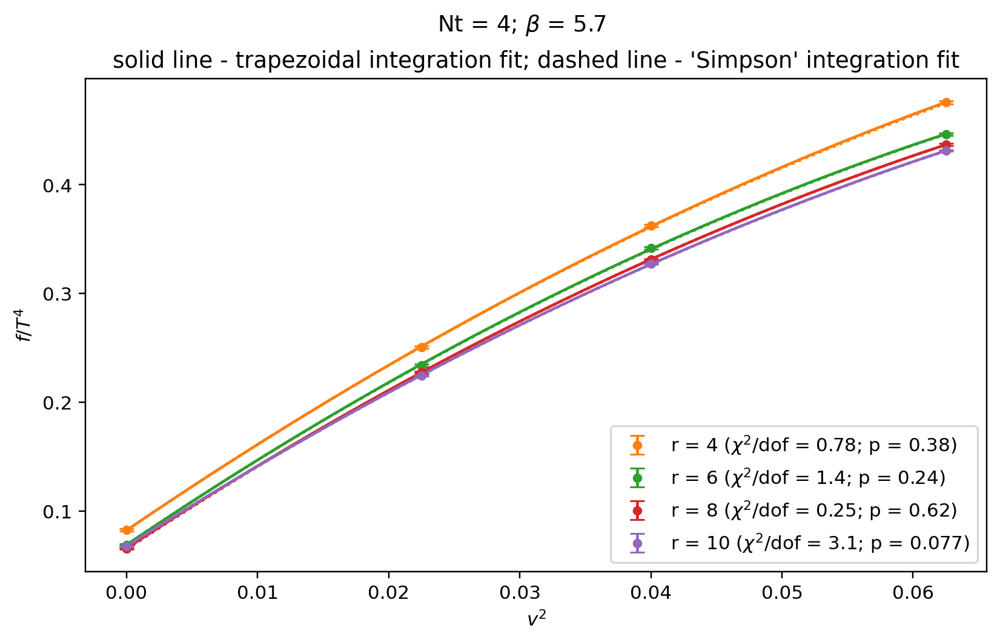

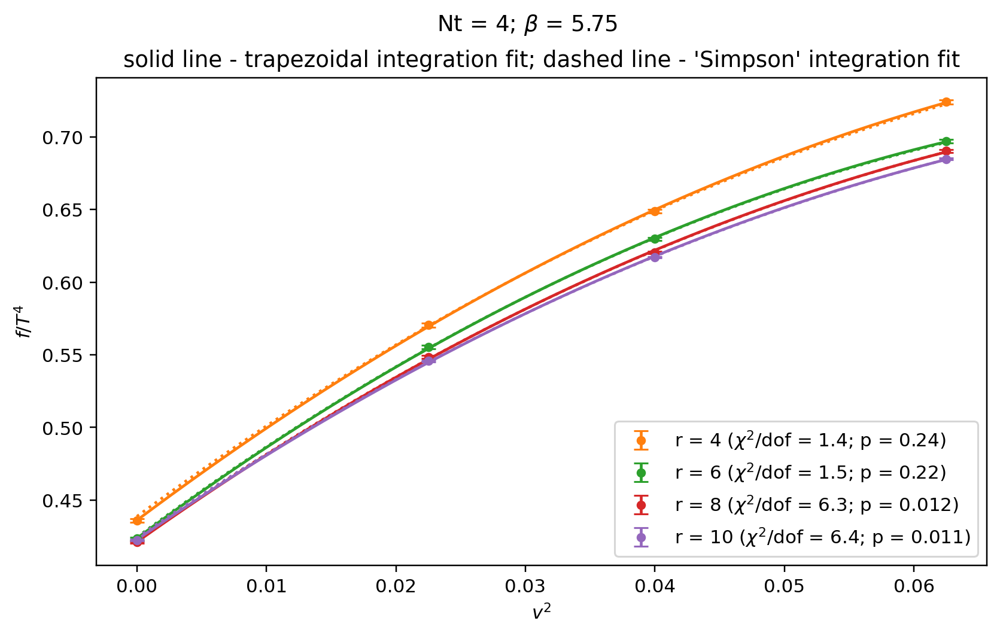

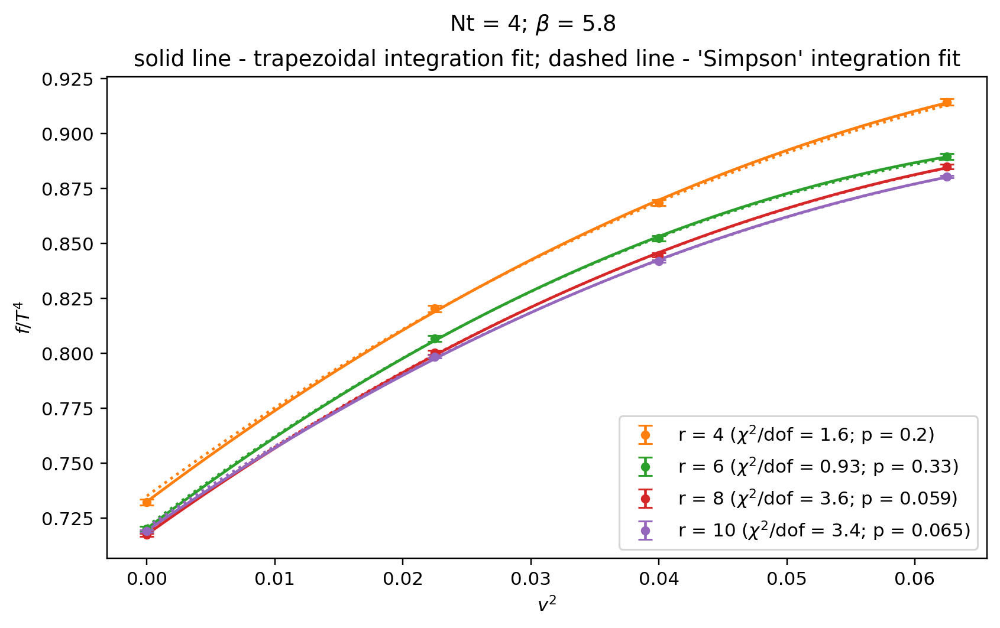

...

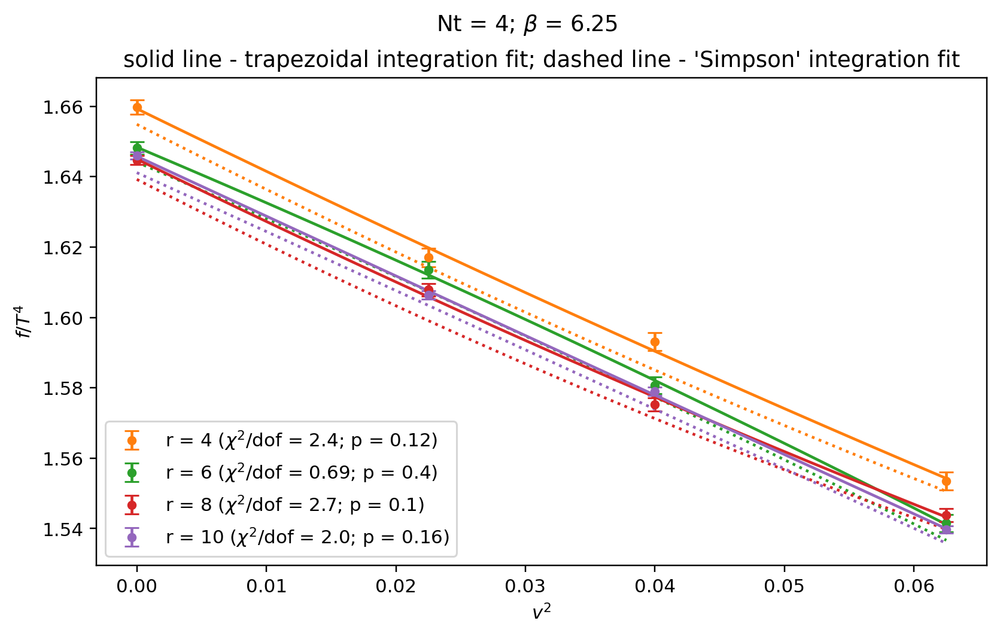

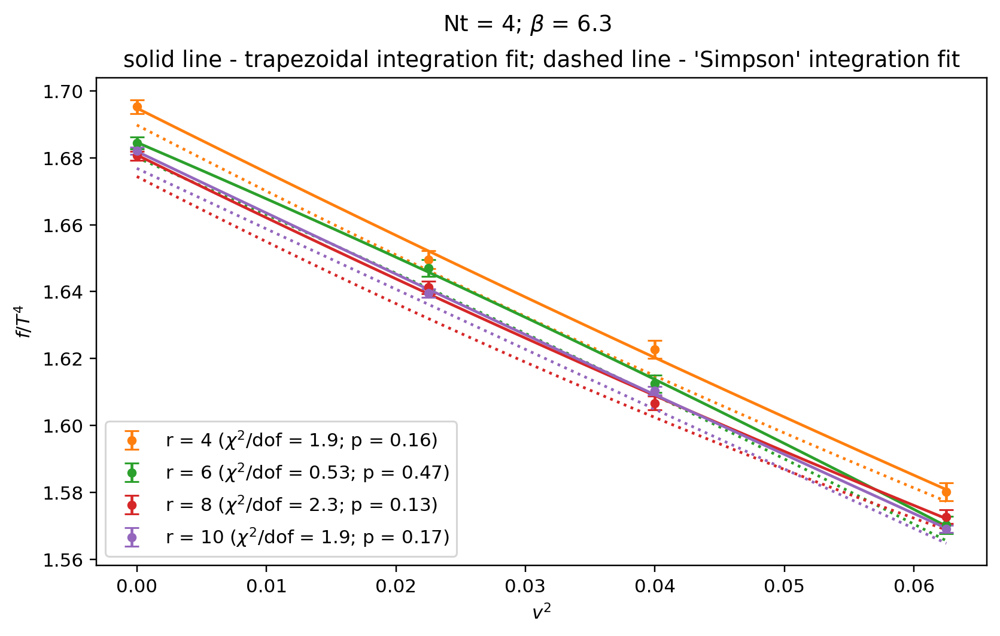

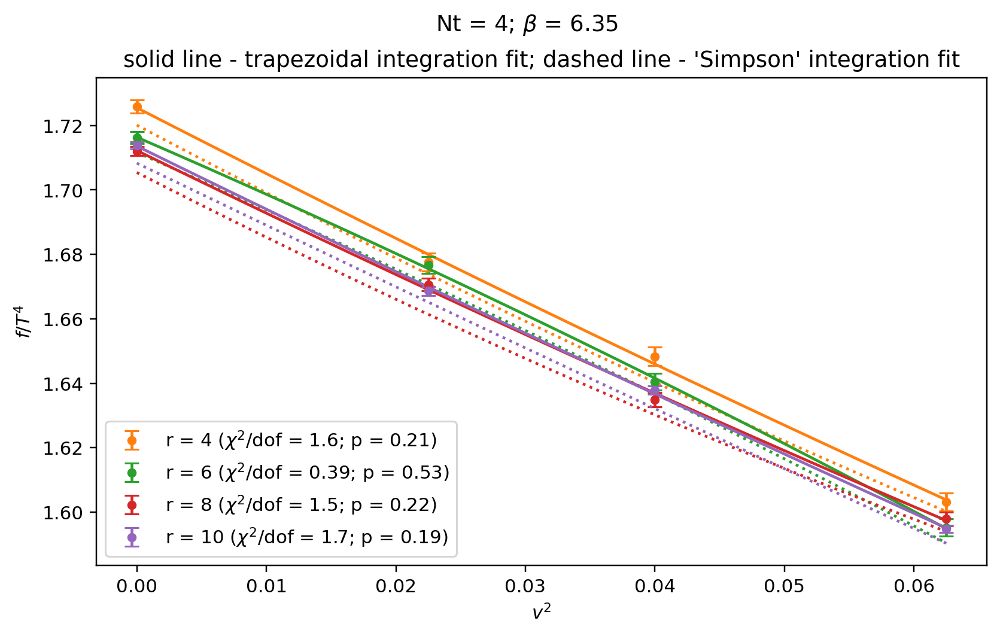

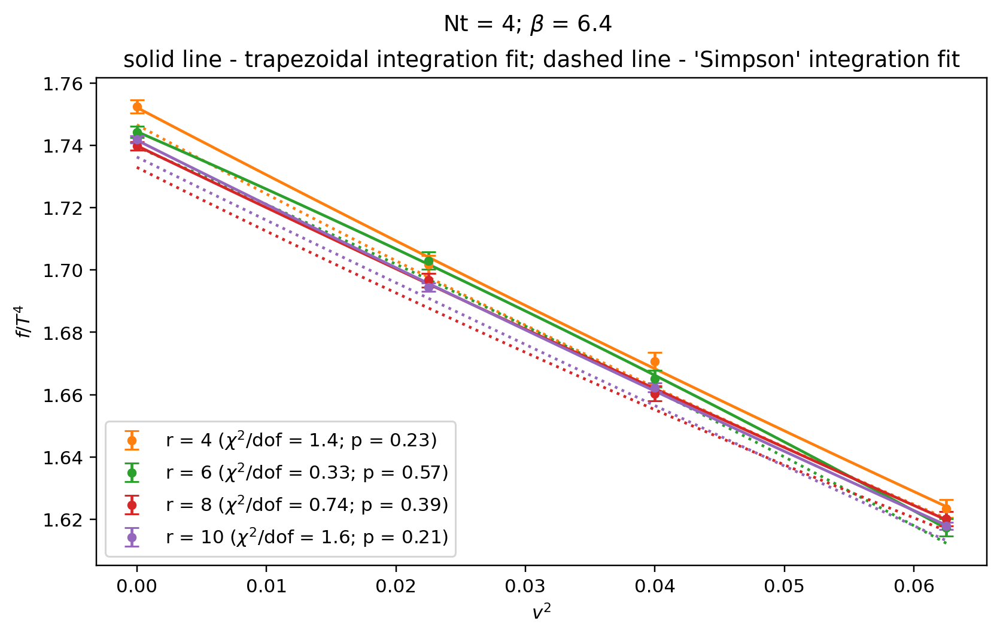

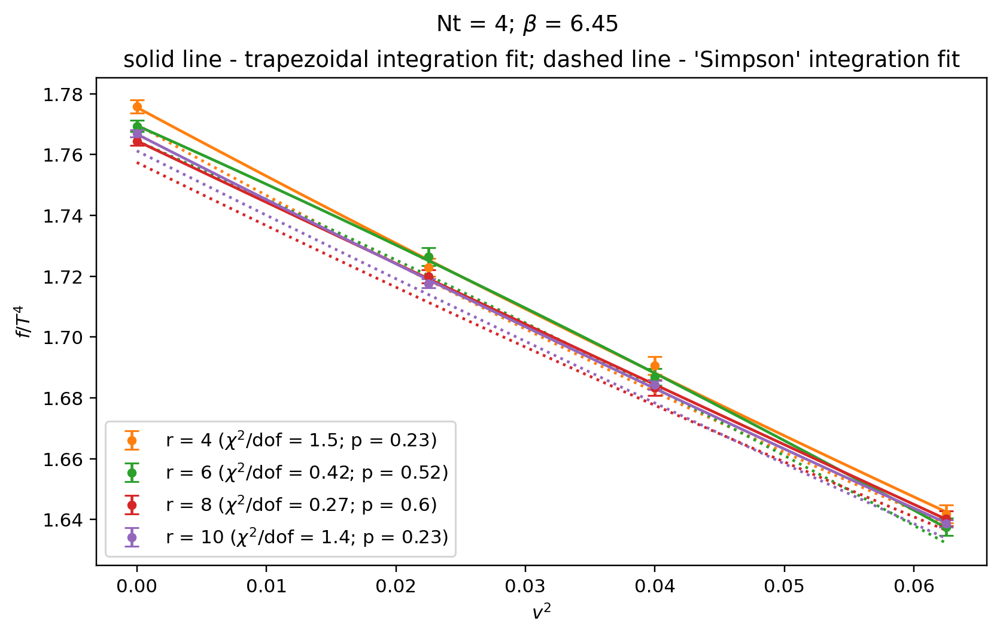

In [7]:
velocities = np.array([0.00, 0.15, 0.20, 0.25])
velocity_to_idx = {
    0.00: 0,
    0.15: 1,
    0.20: 2,
    0.25: 3,
}

betas = np.linspace(5.6, 6.45, 18)
# betas = np.array([6.0])
for counter_out, beta in enumerate(betas):
    fig, ax = plotters.make_figure_and_111axis(plt)

    r_to_plot = [4, 6, 8, 10]
    # r_to_plot = [10]
    for r in r_to_plot:
        for counter, calc in enumerate([calc_4w_ns_all_t, calc_4w_ns_all_q]):
            inertia_calc = calc.inertia_analysis_dict[r]
            energies = 0.0 * velocities
            energy_errors = 0.0 * velocities
            for holder in inertia_calc.holders_pool.data_holders:
                idx = velocity_to_idx[holder.velocity]
                val, err = holder.get_energy_interpolation_at_values([beta])
                energies[idx] = val
                energy_errors[idx] = err
            c0_rep, c2_rep, c4_rep = inertia_calc.get_quadratic_fit_splrep()
            c0, _ = c0_rep.calculate_points([beta])
            c2, _ = c2_rep.calculate_points([beta])
            c4, _ = c4_rep.calculate_points([beta])
            energies_fit = c0 + c2 * velocities**2 + c4 * velocities**4
            chi_sqr = np.sum(((energies - energies_fit) / energy_errors)**2)
            dof = len(energies) - 3
            chi_sqr_per_dof = chi_sqr / dof

            x_val_fit = np.linspace(velocities[0]**2, velocities[-1]**2)
            y_val_fit = c0 + c2 * x_val_fit + c4 * x_val_fit**2
            if counter == 0:
                plotters.draw_point_rep(
                    plt, ax,
                    plotters.PointRep(velocities**2, energies, energy_errors),
                    r_colormap[r], linestyle="",
                    label=(f"r = {r} ($\\chi^2$/dof = {chi_sqr_per_dof:.2f}; "
                           f"p = {1.0 - scipy.stats.chi2.cdf(chi_sqr, dof):.3f})"))
            fit_rep = plotters.SplineRep.from_points(x_val_fit, y_val_fit)
            plotters.draw_spl_rep(plt, ax, fit_rep, r_colormap[r],
                                  linestyle=("-" if counter == 0 else ":"))
    plt.legend(loc=("lower right" if beta < 5.91 else "lower left"))
    plt.xlabel("$v^2$")
    plt.ylabel("$-\langle f \\rangle/T^4$")
    plt.suptitle(f"$N_t$ = 4; $\\beta$ = {beta:.2f}")
    plt.title("solid line - trapezoidal integration fit; dashed line - "
              "'Simpson' integration fit")
    # plt.savefig(f"{output_dir_name}eos_fit_nt4_p{counter_out + 1}_000.png")
    plt.show()

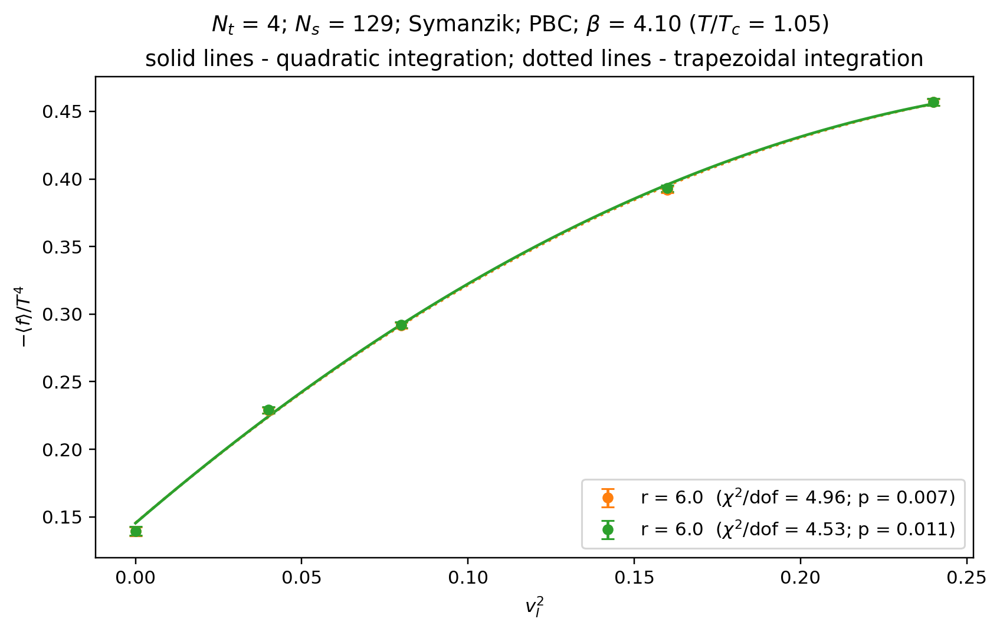

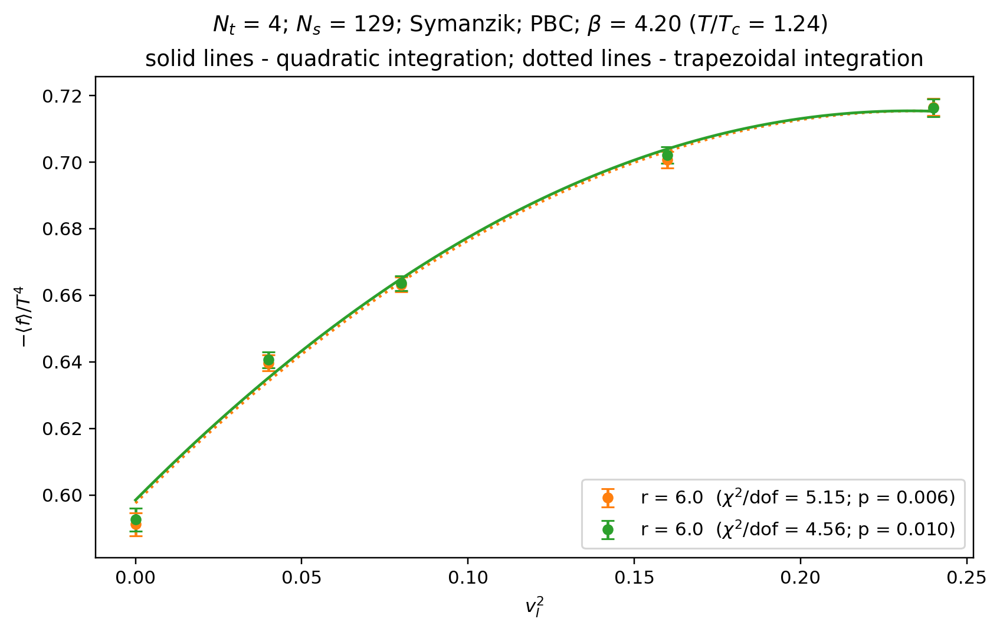

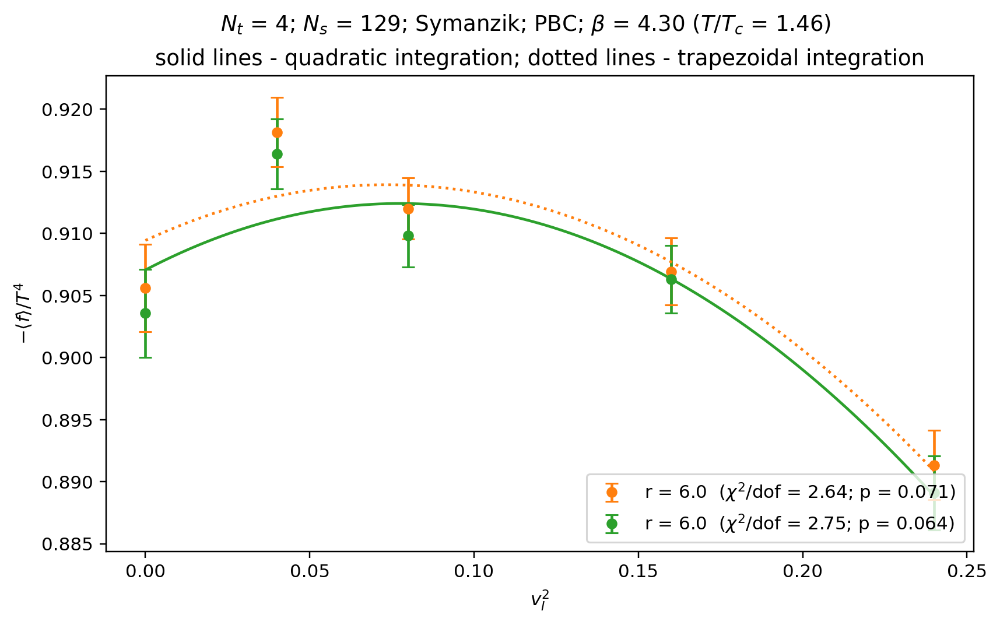

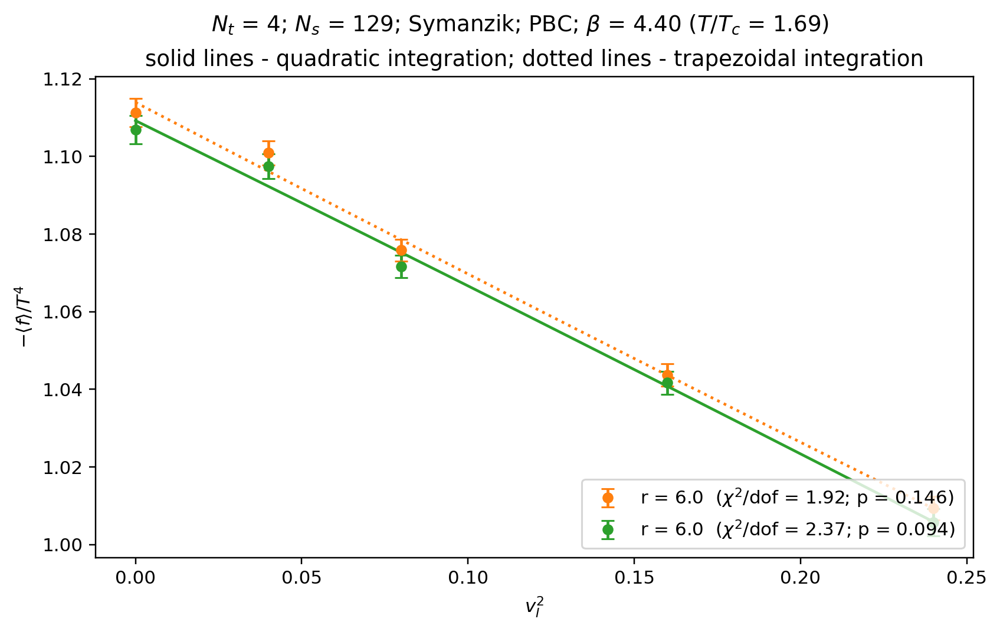

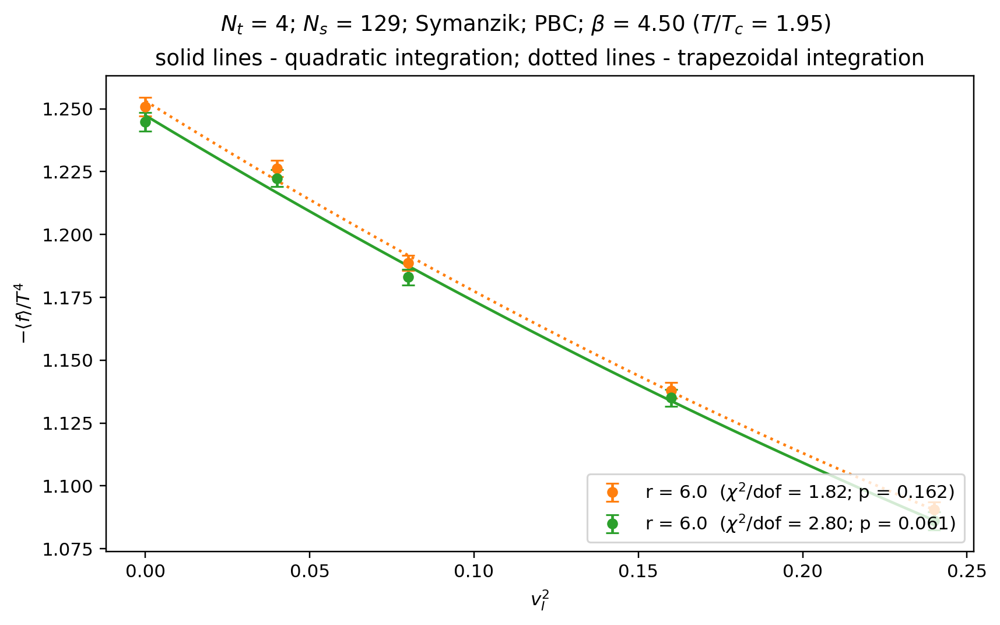

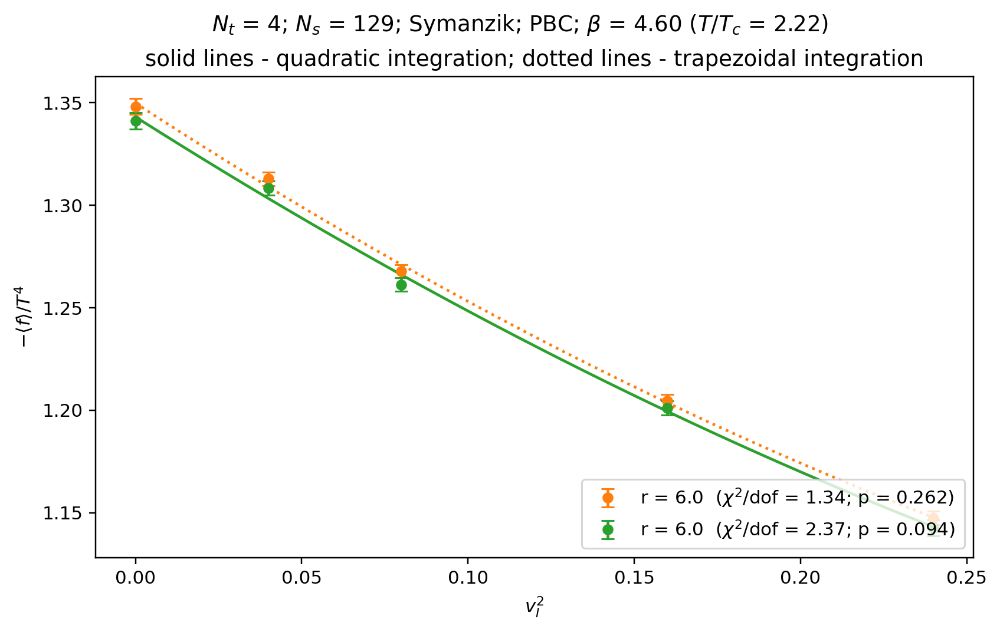

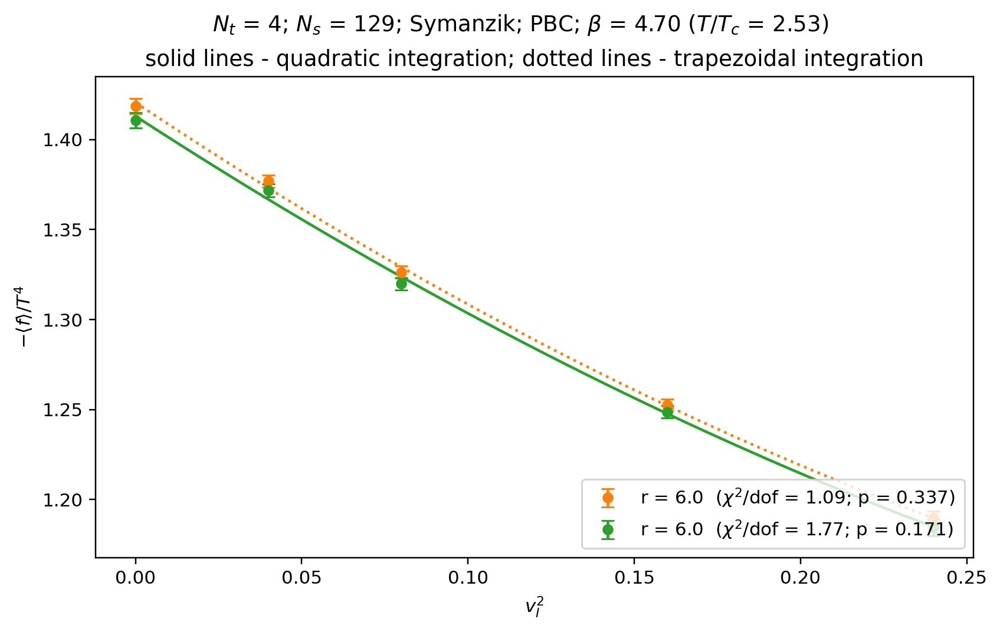

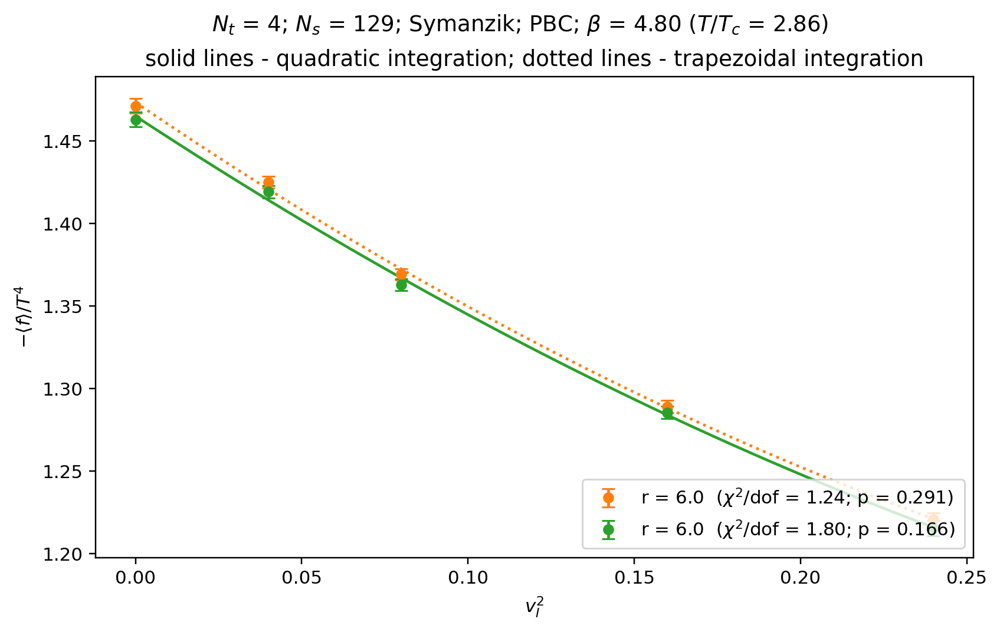

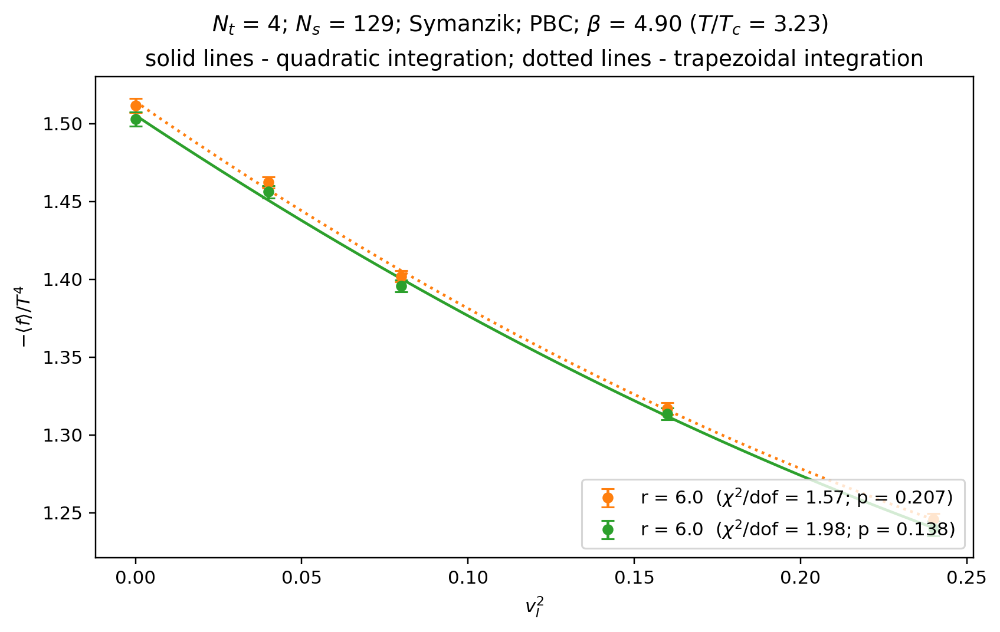

In [33]:
velocities = np.array([
    0.0000, 
    0.2000, 
    0.2828, 
    0.4000, 
    0.4899, 
#     0.5657, 
#     0.6928,
])
velocity_to_idx = {
    0.0000: 0,
    0.2000: 1,
    0.2828: 2,
    0.4000: 3,
    0.4899: 4,
#     0.5657: 5,
#     0.6928: 6,
}
# velocities = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449, 0.2739, 0.3000])
# velocity_to_idx = {
#     0.0000: 0,
#     0.1225: 1,
#     0.1732: 2,
#     0.2121: 3,
#     0.2449: 4,
#     0.2739: 5,
#     0.3000: 6,
# }
# velocities = np.array([0.00, 0.15, 0.20, 0.25])
# velocity_to_idx = {
#     0.00: 0,
#     0.15: 1,
#     0.20: 2,
#     0.25: 3,
# }

betas = np.linspace(4.10, 4.90, 9)  # nt = 4 (imp_obc)
# betas = np.linspace(4.25, 4.95, 8)  # nt = 5 (imp_obc)
# betas = np.linspace(4.39, 4.99, 7)  # nt = 6 (imp_obc)
# betas = np.linspace(4.10, 4.90, 9)  # nt = 4 (imp)
# betas = np.linspace(4.25, 4.95, 8)  # nt = 5 (imp)
# betas = np.linspace(4.35, 4.95, 7)  # nt = 6 (imp)
# betas = np.linspace(4.45, 4.95, 7)  # nt = 7 (imp)
# betas = np.linspace(4.55, 4.95, 6)  # nt = 8 (imp)
# betas = np.linspace(5.75, 6.45, 8)  # nt = 4
# betas = np.linspace(5.85, 6.75, 10)  # nt = 5
# betas = np.linspace(5.95, 6.75, 9)  # nt = 6
# betas = np.linspace(6.05, 6.75, 8)  # nt = 7
# betas = np.linspace(6.1, 7.0, 10)  # nt = 8
for counter_out, beta in enumerate(betas):
    fig, ax = plotters.make_figure_and_111axis(plt)

    # r_to_plot = [8.0]  # nt = 4 (imp)
    # r_to_plot = [10.0]  # nt = 4
#     r_to_plot = [40/5]  # nt = 5
#     r_to_plot = [40/6]  # nt = 6
    # r_to_plot = [40/7]  # nt = 7
    # r_to_plot = [40/8]  # nt = 8 (v2)
    # r_to_plot = [4.0]  # nt = 8 (v1)
#     r = r_to_plot[0]
    r = 24/4
    # [calc_4s_ns32_t, calc_4s_ns32_q]
    # [calc_8w_ns32_t, calc_8w_ns32_q]
    # [calc_4w_ns_all_t, calc_4w_ns_all_q]
    for counter, calc in enumerate([calc_rs32c2_pbc_t, calc_rs32c2_pbc_q]):
        inertia_calc = calc.inertia_analysis_dict[r]
        energies = 0.0 * velocities
        energy_errors = 0.0 * velocities
        for holder in inertia_calc.holders_pool.data_holders:
            idx = velocity_to_idx[holder.velocity]
            val, err = holder.get_energy_interpolation_at_values([beta])
            energies[idx] = val
            energy_errors[idx] = err
        fitter = fitters.QuadraticFitter()
        res = fitter.perform_fit(velocities**2, energies, energy_errors)
        # print(counter, res.c1c2_corr)
        c0_rep, c2_rep, c4_rep = inertia_calc.get_quadratic_fit_splrep()
        c0, _ = c0_rep.calculate_points([beta])
        c2, _ = c2_rep.calculate_points([beta])
        c4, _ = c4_rep.calculate_points([beta])
        c0_rep_l, c2_rep_l = inertia_calc.get_linear_fit_splrep()
        c0_l, _ = c0_rep_l.calculate_points([beta])
        c2_l, _ = c2_rep_l.calculate_points([beta])
        energies_fit = c0 + c2 * velocities**2 + c4 * velocities**4
        energies_fit_l = c0_l + c2_l * velocities**2
        chi_sqr = np.sum(((energies - energies_fit) / energy_errors)**2)
        dof = len(energies) - 3
        chi_sqr_per_dof = chi_sqr / dof
        r_sqr_q = 1.0 - (np.sum((energies - energies_fit)**2)
                         / np.sum((energies - energies.mean())**2))
        r_sqr_l = 1.0 - (np.sum((energies - energies_fit_l)**2)
                         / np.sum((energies - energies.mean())**2))

        x_val_fit = np.linspace(velocities[0]**2, velocities[-1]**2)
        y_val_fit = c0 + c2*x_val_fit + c4*x_val_fit**2
        # int_meth_str = ("[t]" if counter == 0 else "[q]")
        int_meth_str = ""
        plotters.draw_point_rep(
            plt, ax,
            plotters.PointRep(velocities**2, energies, energy_errors),
            ("C1" if counter == 0 else "C2"), linestyle="",
            label=(f"r = {r:.1f} {int_meth_str} "
                   f"($\\chi^2$/dof = {chi_sqr_per_dof:.2f}; "
                   f"p = {1.0 - scipy.stats.chi2.cdf(chi_sqr,dof):.3f}) "
                   # f"($R_q^2$ = {r_sqr_q:.4f}; "
                   # f"$R_l^2$ = {r_sqr_l:.4f})"
                   )
        )
        fit_rep = plotters.SplineRep.from_points(x_val_fit, y_val_fit)
        plotters.draw_spl_rep(plt, ax, fit_rep,
                              ("C1" if counter == 0 else "C2"),
                              linestyle=(":" if counter == 0 else "-"))
    plt.legend(loc=("lower right" if beta < 6.45 else "lower left"))
    plt.xlabel("$v_I^2$")
    plt.ylabel("$-\langle f \\rangle/T^4$")
    plt.suptitle(f"$N_t$ = 4; $N_s$ = 129; Symanzik; PBC; $\\beta$ = {beta:.2f} "
                 f"($T/T_c$ = {symanzik_scale_setter.get_temperature_in_mev([beta], 4)[0] / tc_in_mev_nt4imp:.2f})")
    plt.title("solid lines - quadratic integration; dotted lines - trapezoidal integration")
#     plt.title("сплошная (пунктир) - кусочно-квадратичный(-линейный) метод")
#     plt.savefig(f"{output_dir_name}eos_fits/nt5w_ns40/eos_fit_nt5w_ns40_p{counter_out + 1}_pres_001.png")
    plt.savefig(f"{output_dir_name}eos_fits/nt4s_ns129_pbc_cut2/eos_fit_p{counter_out + 1}_pres_000.png")
    plt.show()

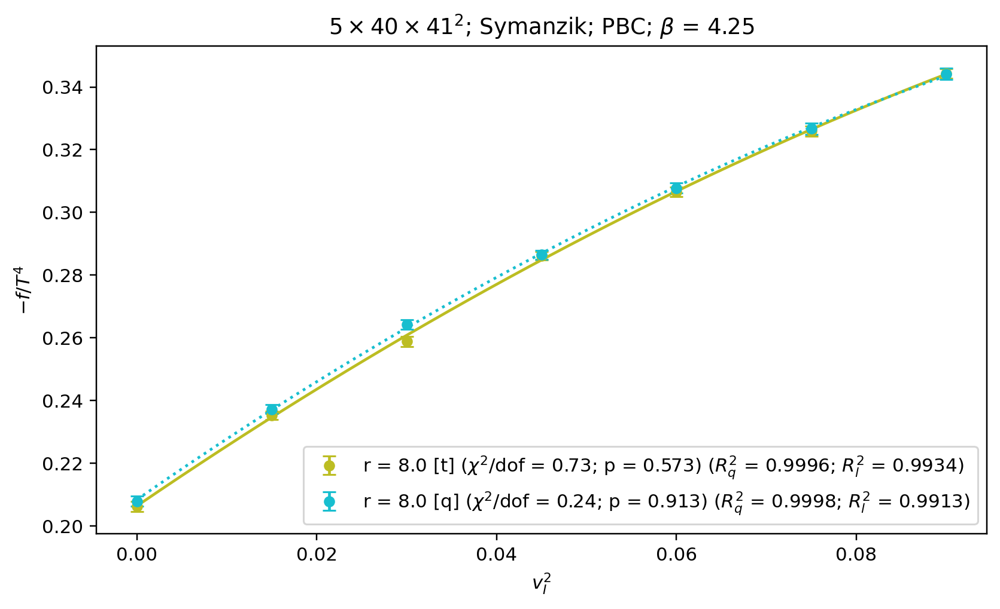

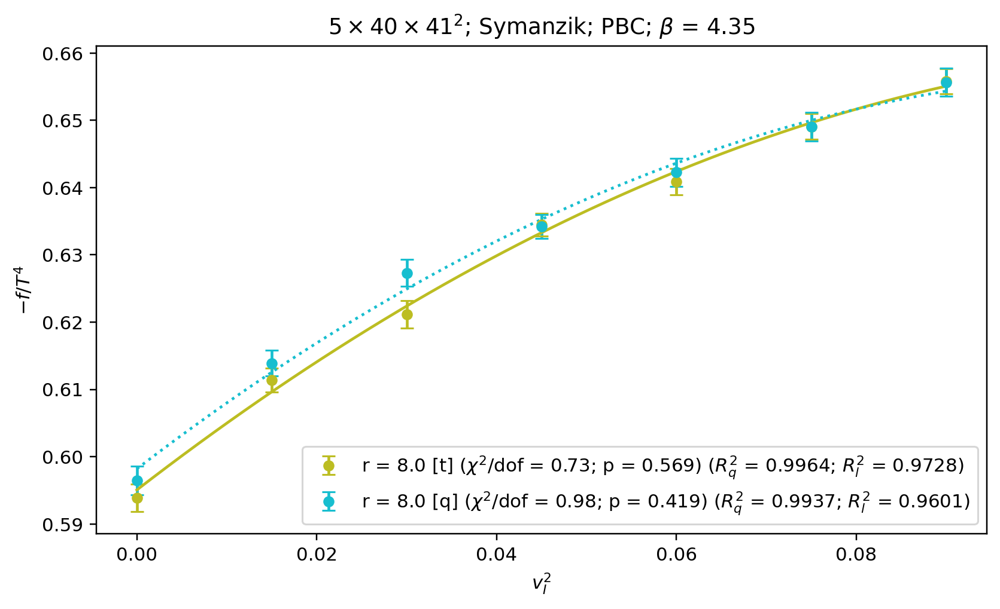

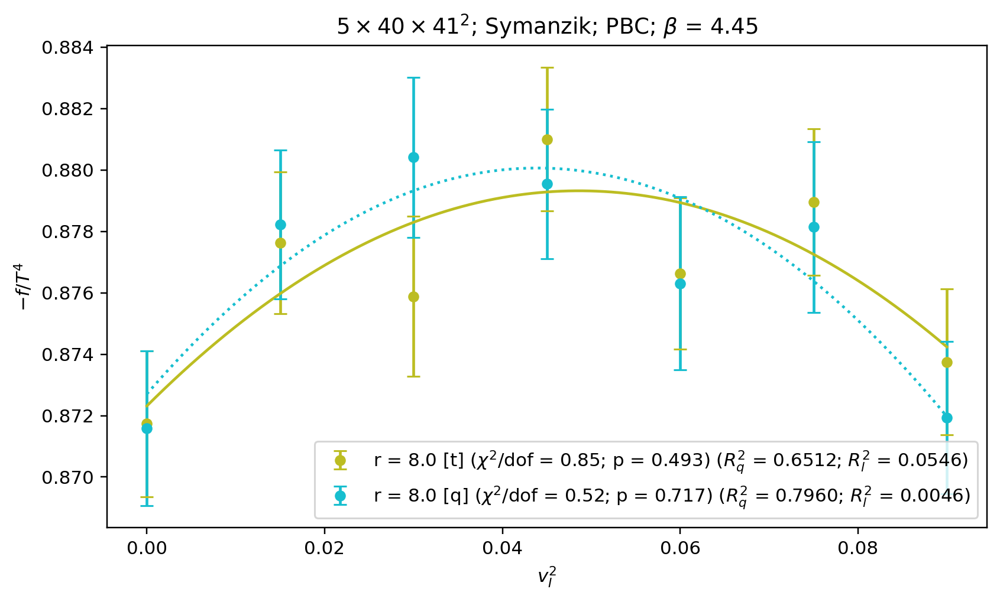

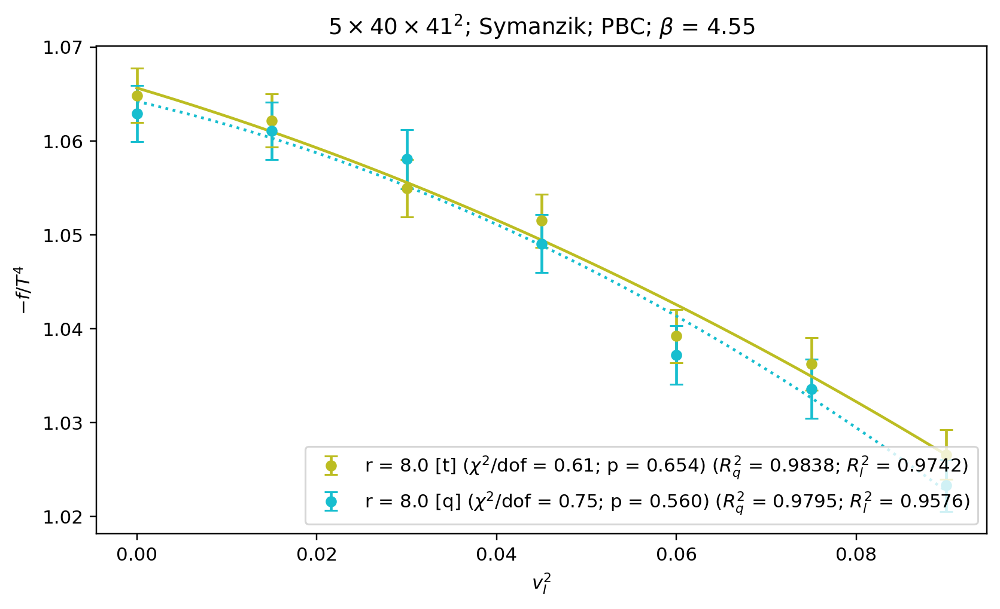

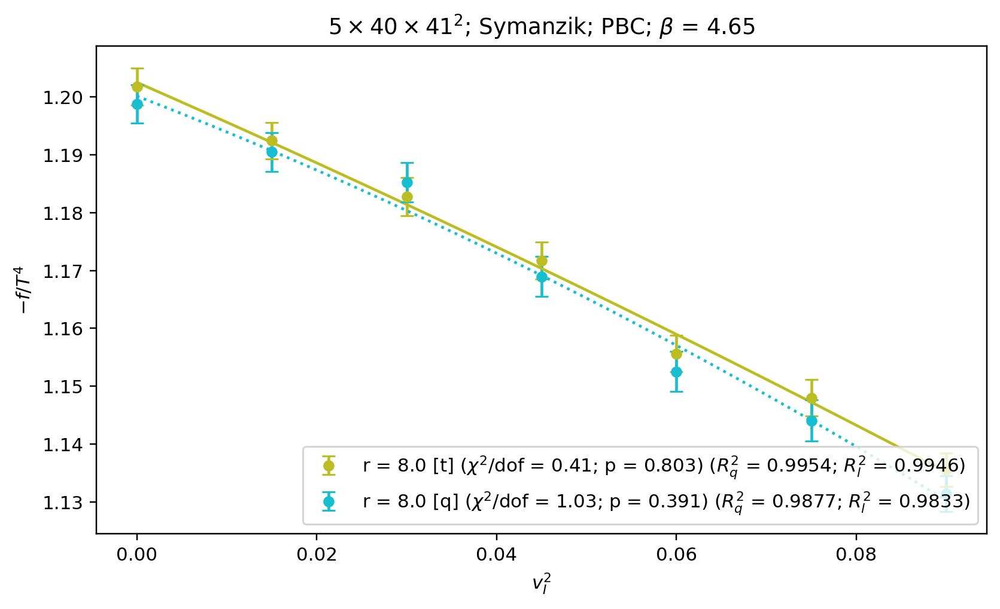

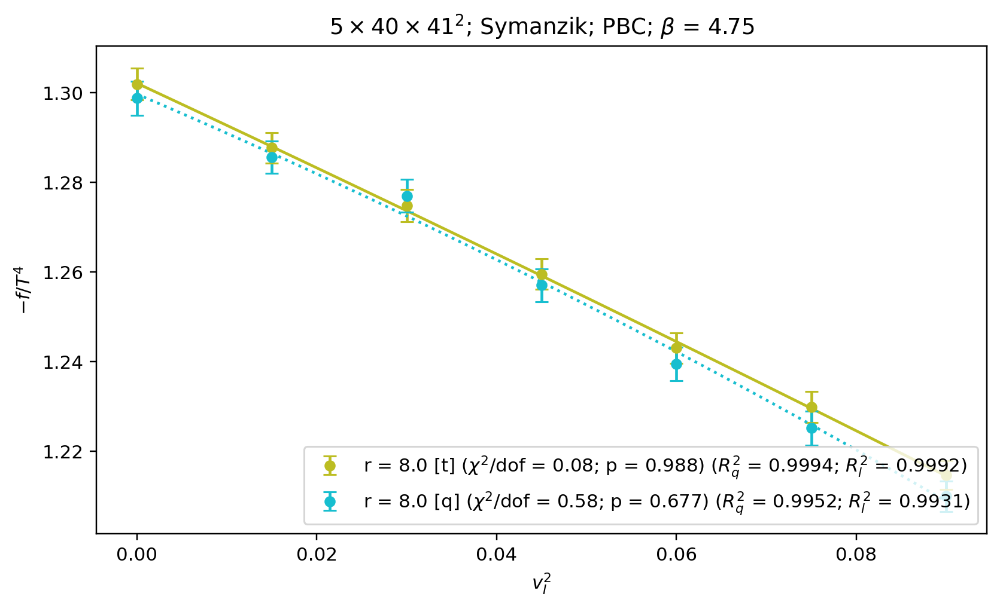

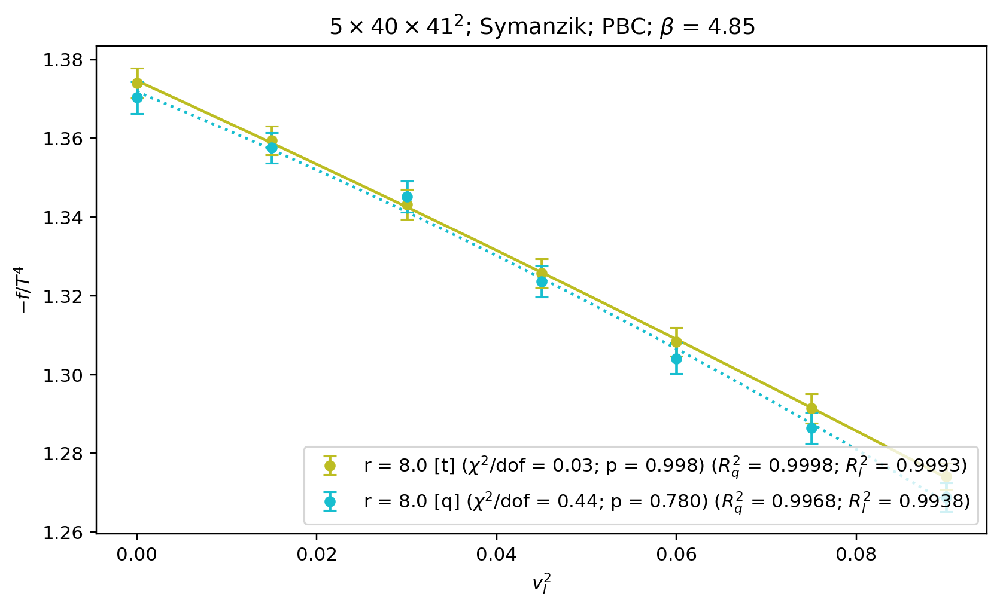

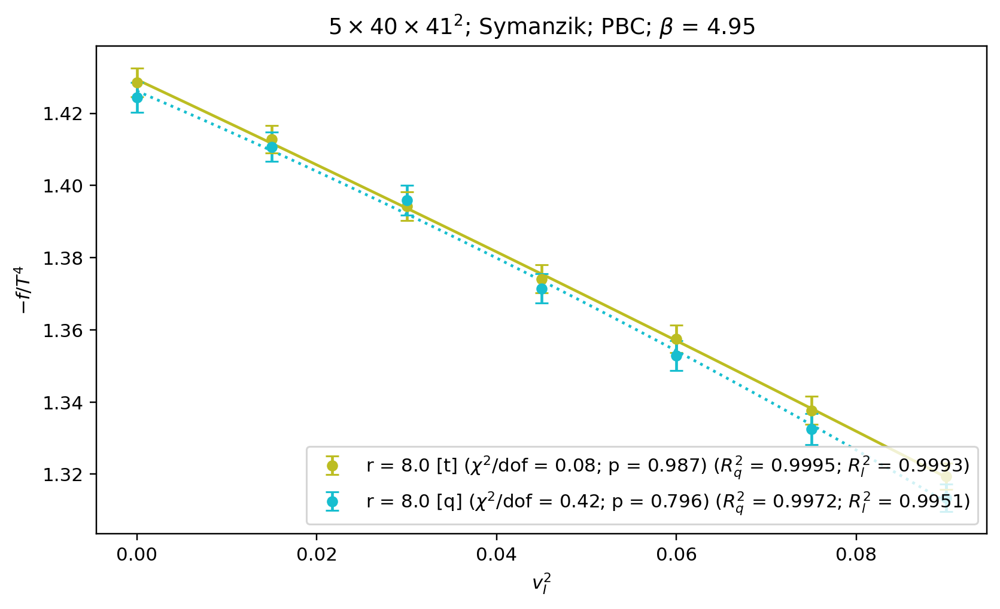

In [15]:
velocities = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449, 0.2739, 0.3000])
velocity_to_idx = {
    0.0000: 0,
    0.1225: 1,
    0.1732: 2,
    0.2121: 3,
    0.2449: 4,
    0.2739: 5,
    0.3000: 6,
}
# velocities = np.array([0.0000, 0.1225, 0.1732, 0.2121, 0.2449])
# velocity_to_idx = {
#     0.0000: 0,
#     0.1225: 1,
#     0.1732: 2,
#     0.2121: 3,
#     0.2449: 4,
# }
# betas = np.linspace(4.10, 4.90, 9)  # nt = 4 (imp_obc)
# betas = np.linspace(4.25, 4.95, 8)  # nt = 5 (imp_obc)
# betas = np.linspace(4.39, 4.99, 7)  # nt = 6 (imp_obc)
# betas = np.linspace(4.55, 4.95, 6)  # nt = 7 (imp_obc)
# betas = np.linspace(4.69, 4.99, 4)  # nt = 8 (imp_obc)
# betas = np.linspace(4.10, 4.90, 9)  # nt = 4 (imp)
betas = np.linspace(4.25, 4.95, 8)  # nt = 5 (imp)
# betas = np.linspace(4.35, 4.95, 7)  # nt = 6 (imp)
# betas = np.linspace(4.45, 4.95, 7)  # nt = 7 (imp)
# betas = np.linspace(4.55, 4.95, 6)  # nt = 8 (imp)
# betas = np.linspace(5.75, 6.45, 8)  # nt = 4
# betas = np.linspace(5.85, 6.75, 10)  # nt = 5
# betas = np.linspace(5.95, 6.75, 9)  # nt = 6
# betas = np.linspace(6.05, 6.75, 8)  # nt = 7
# betas = np.linspace(6.1, 7.0, 10)  # nt = 8

# betas = np.linspace(4.15, 4.95, 9)  # nt = 4 (imp)
# betas = np.linspace(4.25, 4.95, 8)  # nt = 5 (imp)
# betas = np.linspace(4.35, 4.95, 7)  # nt = 6 (imp)
# betas = np.linspace(5.85, 6.75, 10)  # nt = 5
# betas = np.linspace(5.95, 6.75, 9)  # nt = 6
# betas = np.linspace(6.05, 6.75, 8)  # nt = 7
for counter_out, beta in enumerate(betas):
    fig, ax = plotters.make_figure_and_111axis(plt)

    r_to_plot = [40/5]
    r = r_to_plot[0]
    # [calc_6s_ns40_t, calc_6s_ns40_q]
    # [calc_6w_ns40_t, calc_6w_ns40_q]
    for counter, calc in enumerate([calc_5s_ns40_t, calc_5s_ns40_q]):
        inertia_calc = calc.inertia_analysis_dict[r]
        energies = 0.0 * velocities
        energy_errors = 0.0 * velocities
        for holder in inertia_calc.holders_pool.data_holders:
            idx = velocity_to_idx[holder.velocity]
            val, err = holder.get_energy_interpolation_at_values([beta])
            energies[idx] = val
            energy_errors[idx] = err
        fitter = fitters.QuadraticFitter()
        res = fitter.perform_fit(velocities**2, energies, energy_errors)
        # print(counter, res.c1c2_corr)
        c0_rep, c2_rep, c4_rep = inertia_calc.get_quadratic_fit_splrep()
        c0, _ = c0_rep.calculate_points([beta])
        c2, _ = c2_rep.calculate_points([beta])
        c4, _ = c4_rep.calculate_points([beta])
        l_c0_rep, l_c2_rep = inertia_calc.get_linear_fit_splrep()
        l_c0, _ = l_c0_rep.calculate_points([beta])
        l_c2, _ = l_c2_rep.calculate_points([beta])
        energies_fit = c0 + c2 * velocities**2 + c4 * velocities**4
        energies_fit_l = l_c0 + l_c2 * velocities**2
        chi_sqr = np.sum(((energies - energies_fit) / energy_errors)**2)
        dof = len(energies) - 3
        chi_sqr_per_dof = chi_sqr / dof
        r_sqr_q = 1.0 - (np.sum((energies - energies_fit)**2)
                         / np.sum((energies - energies.mean())**2))
        r_sqr_l = 1.0 - (np.sum((energies - energies_fit_l)**2)
                         / np.sum((energies - energies.mean())**2))

        x_val_fit = np.linspace(velocities[0]**2, velocities[-1]**2)
        y_val_fit = c0 + c2*x_val_fit + c4*x_val_fit**2
        int_meth_str = ("[t]" if counter == 0 else "[q]")
        plotters.draw_point_rep(
            plt, ax,
            plotters.PointRep(velocities**2, energies, energy_errors),
            ("C8" if counter == 0 else "C9"), linestyle="",
            label=(f"r = {r:.1f} {int_meth_str} "
                   f"($\\chi^2$/dof = {chi_sqr_per_dof:.2f}; "
                   f"p = {1.0 - scipy.stats.chi2.cdf(chi_sqr,dof):.3f}) "
                   f"($R_q^2$ = {r_sqr_q:.4f}; "
                   f"$R_l^2$ = {r_sqr_l:.4f})"))
        fit_rep = plotters.SplineRep.from_points(x_val_fit, y_val_fit)
        plotters.draw_spl_rep(plt, ax, fit_rep,
                              ("C8" if counter == 0 else "C9"),
                              linestyle=("-" if counter == 0 else ":"))
    plt.legend(loc=("lower right" if beta < 6.30 else "lower left"))
    plt.xlabel("$v_I^2$")
#     plt.ylabel("$-\langle f \\rangle/T^4$")
    plt.ylabel("$-f/T^4$")
#     plt.title(f"$N_t$ = 5; Symanzik; PBC; $\\beta$ = {beta:.2f}")
    plt.title(f"$5 \\times 40 \\times 41^2$; Symanzik; PBC; $\\beta$ = {beta:.2f}")
    plt.savefig(f"{output_dir_name}eos_fit_nt5s_p{counter_out + 1}_000.png")
#     plt.show()

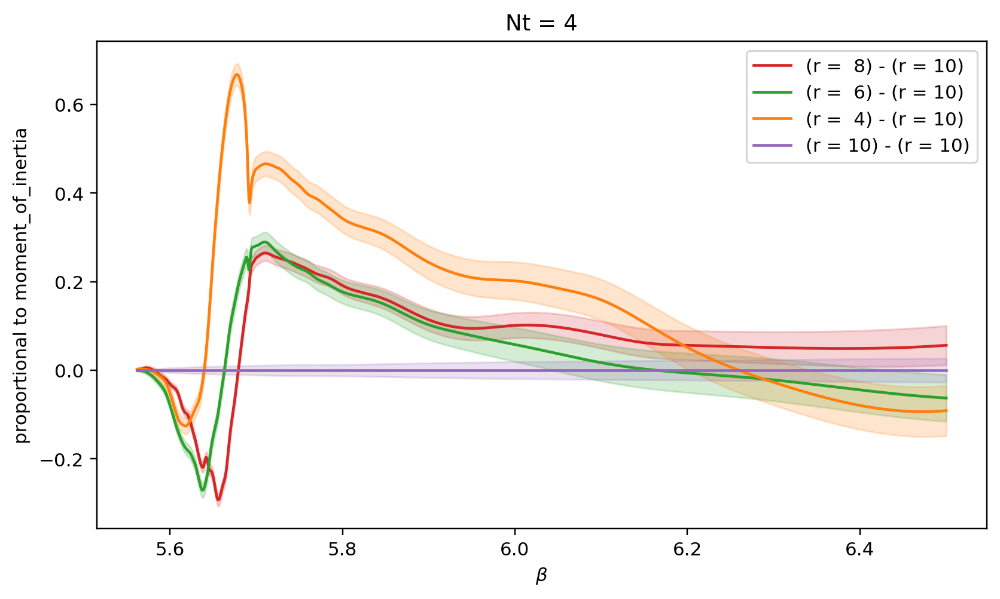

In [17]:
fig, ax = plotters.make_figure_and_111axis(plt)

_, r10_rep = calc.inertia_analysis_dict[10.].get_linear_fit_splrep()
for r in calc.inertia_analysis_dict:
    if r == 2:
        continue
    plotters.draw_spl_rep(
        plt, ax,
        calc.inertia_analysis_dict[r].get_linear_fit_splrep()[1].subtract_splrep(
            r10_rep, add_errors=False),
        r_colormap[r], label=f"(r = {int(r):{2}}) - (r = 10)")
plt.legend(loc="upper right")
plt.xlabel(r"$\beta$")
plt.ylabel("proportional to moment_of_inertia")
plt.title("$N_t$ = 4")
# plt.savefig(f"{output_dir_name}diff_c2only_nt4_nsAll_000.png")
plt.show()

<ipython-input-48-1e44d0d4fc30>:821: RuntimeWarning: divide by zero encountered in true_divide
  y_vals = coeffs_v1[0][0] - coeffs_v1[0][1] / (x_vals - 1)


cont. limit; chi2/ndof = 0.015
(a_val, b_val) = (2.216, 1.101); (a_err, b_err) = (0.058, 0.026)
---------------------------
cont. limit; chi2/ndof = 0.014
(gamma_val, b_val) = (1.096, 0.920); (gamma_err, b_err) = (0.026, 0.026)
nt = 5; chi2/ndof = 0.302
(a_val, b_val) = (2.712, 1.249); (a_err, b_err) = (0.088, 0.049)
---------------------------
nt = 5; chi2/ndof = 0.445
(gamma_val, b_val) = (1.370, 0.645); (gamma_err, b_err) = (0.048, 0.036)
nt = 6; chi2/ndof = 0.013
(a_val, b_val) = (2.516, 1.189); (a_err, b_err) = (0.282, 0.145)
---------------------------
nt = 6; chi2/ndof = 0.011
(gamma_val, b_val) = (1.288, 0.747); (gamma_err, b_err) = (0.162, 0.108)
nt = 7; chi2/ndof = 0.015
(a_val, b_val) = (2.518, 1.193); (a_err, b_err) = (0.146, 0.056)
---------------------------
nt = 7; chi2/ndof = 0.133
(gamma_val, b_val) = (1.223, 0.778); (gamma_err, b_err) = (0.069, 0.070)
nt = 8; chi2/ndof = 0.028
(a_val, b_val) = (2.314, 1.087); (a_err, b_err) = (0.430, 0.199)
---------------------------

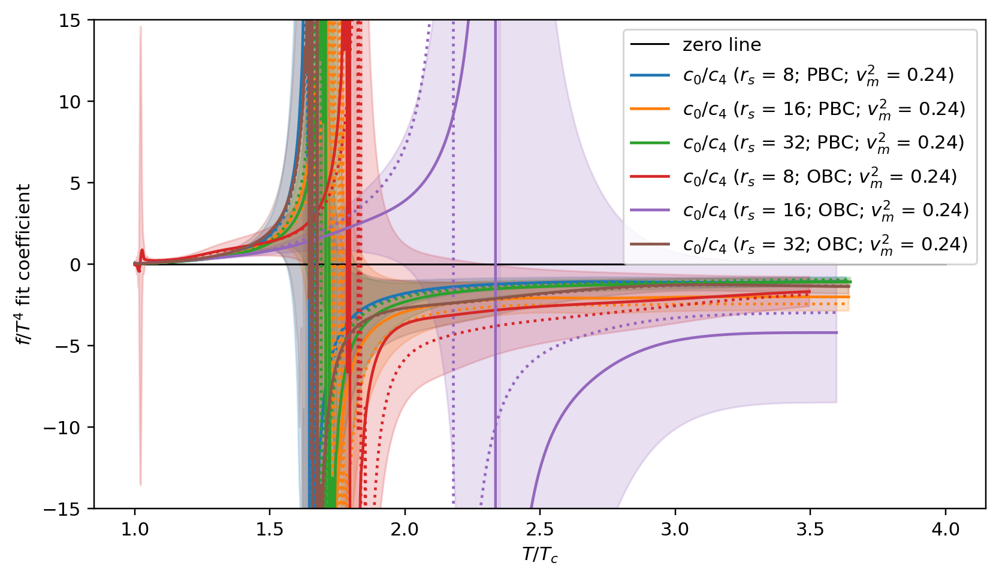

In [48]:
fig, ax = plotters.make_figure_and_111axis(plt)
# plt.clf()
# fig, ax = plt.subplots(constrained_layout=True)

domain_to_draw = domains.GeometricRange((1.0, 4.0))
# domain_to_draw = domains.GeometricRange((1.0, 3.5))
# domain_to_draw = domains.GeometricRange((1.0, 3.2))
# domain_to_draw = domains.GeometricRange((1.0, 1.7))
# domain_to_draw = domains.GeometricRange((1.15, 2.05))
# domain_to_draw = domains.GeometricRange((1.4, 1.7))
# domain_to_draw = domains.GeometricRange((1.4, 1.95))
# domain_to_draw = domains.GeometricRange((1.0, 4.0))
# domain_to_draw = domains.GeometricRange((2.0, 2.5))
# domain_to_draw = domains.GeometricRange((0.6, 2.6))
domain_to_draw_points = domains.GeometricRange((1.20, 2.00))

r_nt4 = 40 / 4
r_nt5 = 40 / 5
r_nt6 = 40 / 6
r_nt7 = 40 / 7
r_nt8ns40 = 40 / 8
r_nt8 = 32 / 8

# err_factor = 1.4

# domain_to_draw = domains.GeometricRange((1.72, 1.78))
# domain_to_draw = domains.GeometricRange((1.70, 1.85))
# domain_to_draw = domains.GeometricRange((1.67, 1.87))
# domain_to_draw = domains.GeometricRange((1.55, 1.80))
# domain_to_draw = domains.GeometricRange((1.60, 2.00))

# domain_to_draw = domains.GeometricRange((1.52, 1.59))
# domain_to_draw = domains.GeometricRange((1.52, 1.64))
# domain_to_draw = domains.GeometricRange((1.45, 1.70))
# domain_to_draw = domains.GeometricRange((1.30, 1.50))
# domain_to_draw = domains.GeometricRange((1.40, 1.90))

# domain_to_draw = domains.GeometricRange((1.40, 1.60))

# domain_to_draw = domains.GeometricRange((1.60, 1.90))
# domain_to_draw = domains.GeometricRange((1.50, 2.00))
# domain_to_draw = domains.GeometricRange((1.30, 2.30))

# domain_to_draw = domains.GeometricRange((1.50, 1.53))
# domain_to_draw = domains.GeometricRange((1.43, 1.47))
# domain_to_draw = domains.GeometricRange((1.44, 1.50))
# domain_to_draw = domains.GeometricRange((1.44, 1.52))
# domain_to_draw = domains.GeometricRange((1.40, 1.53))

# domain_to_draw = domains.GeometricRange((1.45, 1.65))
# domain_to_draw = domains.GeometricRange((1.40, 2.70))

# domain_to_draw = domains.GeometricRange((1.54, 1.62))
# domain_to_draw = domains.GeometricRange((1.55, 1.75))
# domain_to_draw = domains.GeometricRange((1.45, 1.95))

# domain_to_draw = domains.GeometricRange((1.63, 1.65))
# domain_to_draw = domains.GeometricRange((1.63, 1.67))
# domain_to_draw = domains.GeometricRange((1.57, 1.64))
# domain_to_draw = domains.GeometricRange((1.55, 1.70))
# domain_to_draw = domains.GeometricRange((1.65, 1.80))

def common_betas_func(beta_lists: Sequence[List]) -> List:
    _result = [beta for beta in beta_lists[0]]
    
    beta_tolerance = 0.0001
    for betas in beta_lists:
        result = []
        for beta in _result:
            for _beta in betas:
                if abs(beta - _beta) < beta_tolerance:
                    result.append(beta)
                    break
    return result

def indexes_func(_list: List, _sublist: List) -> List[int]:
    result = []
    item_tolerance = 0.00001
    for item in _sublist:
        i = 0
        for _item in _list:
            if abs(item - _item) < item_tolerance:
                result.append(i)
                break
            else:
                i += 1
    return result

def my_function_000(
    _calc: calculator.Calculator, r: float, nt: int, tc_in_mev: float,
    _scale_setter: scale_setters.GluoScaleSetter = scale_setter
) -> plotters.PointRep:
    """Extracts raw integration data from Calculators."""
    _result = dict()
    for holder in _calc.r_groups[r].data_holders:
        betas, int_val, int_err = holder.get_energy_data()
        _result[holder.velocity] = (betas, int_val, int_err)
    velocities = []
    for velocity in _result:
        velocities.append(velocity)
    velocities.sort()
    
    _common_betas = common_betas_func([_result[v][0] for v in velocities])
    _common_t_per_tc = _scale_setter.get_temperature_in_mev(
        np_array_(_common_betas), nt) / tc_in_mev
    t_threshold = 1.03
    i = 0
    for t in _common_t_per_tc:
        if t < t_threshold:
            i += 1
        else:
            break
#     print(_common_t_per_tc[i:])
    common_t_per_tc = _common_t_per_tc[i:]
    common_betas = [beta for beta in _common_betas[i:]]
#     print(common_betas)
    index_lists = [indexes_func(_result[v][0], common_betas) for v in velocities]
    energies_arr = []
    for counter, v in enumerate(velocities):
        int_val = [_result[v][1][i] for i in index_lists[counter]]
        int_err = [_result[v][2][i] for i in index_lists[counter]]
        energies_arr.append([int_val, int_err])
    energies_arr = np.array(energies_arr)
#     print(energies_arr[0])
    result = []
    k2_vals = []
    k2_errs = []
    for counter, t in enumerate(common_t_per_tc):
        energies_val = [energies_arr[idx_v][0][counter] for idx_v, _ in enumerate(velocities)]
        energies_err = [energies_arr[idx_v][1][counter] for idx_v, _ in enumerate(velocities)]
#         linear_fit_results = fitters.LinearFitter.perform_fit_new(
#                 np_array_(velocities)**2, energies_val, energies_err)
        linear_fit_results = fitters.LinearFitter.perform_fit_new_combined(
                np_array_(velocities)**2, energies_val, energies_err)
        c2_val = linear_fit_results.c1_val
        c2_err = linear_fit_results.c1_err
        k2_val = -2.0 * c2_val / energies_val[0]
        k2_err = 2.0 * c2_err / energies_val[0]
#         result.append([t, k2_val, k2_err,])
        k2_vals.append(k2_val)
        k2_errs.append(k2_err)
        result.append((energies_err[0] / energies_val[0]) / abs(k2_err / k2_val))
#     print(result)
#     print(k2_vals)
#     print(k2_errs)
#     print("-----------------")
    return plotters.PointRep(common_t_per_tc, k2_vals, k2_errs)

k2_rep_4s_q = my_function_000(calc_4s_ns40_q, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
k2_rep_5s_q = my_function_000(calc_5s_ns40_q, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
k2_rep_6s_q = my_function_000(calc_6s_ns40_q, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
k2_rep_7s_q = my_function_000(calc_7s_ns40_q, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
k2_rep_8s_q = my_function_000(calc_8s_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)

k2_rep_4so_q = my_function_000(calc_4so_ns40_q, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)
k2_rep_5so_q = my_function_000(calc_5so_ns40_q, r_nt5, 5, tc_in_mev_nt5imp_obc, symanzik_scale_setter)
k2_rep_6so_q = my_function_000(calc_6so_ns40_q, r_nt6, 6, tc_in_mev_nt6imp_obc, symanzik_scale_setter)
k2_rep_7so_q = my_function_000(calc_7so_ns40_q, r_nt7, 7, tc_in_mev_nt7imp_obc, symanzik_scale_setter)
k2_rep_8so_q = my_function_000(calc_8so_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp_obc, symanzik_scale_setter)

def my_func(
    _calc: calculator.Calculator, r: float, nt: int, tc_in_mev: float,
    _scale_setter: scale_setters.GluoScaleSetter = scale_setter
) -> Tuple[plotters.SplineRep, plotters.SplineRep, plotters.SplineRep]:
    """Does something. (????)"""
    _, _c2only_splrep = _calc.inertia_analysis_dict[r].get_linear_fit_splrep()
    _, _c2_splrep, _c4_splrep = (
        _calc.inertia_analysis_dict[r].get_quadratic_fit_splrep())
    beta_domain = _c2only_splrep.domain.intersection_with(
        _scale_setter.get_beta_domain())
    betas = np.linspace(beta_domain.left, beta_domain.right, 500)
    val_c2only, err_c2only = _c2only_splrep.calculate_points(betas)
    val_c2, err_c2 = _c2_splrep.calculate_points(betas)
    val_c4, err_c4 = _c4_splrep.calculate_points(betas)
    temp_per_tc = _scale_setter.get_temperature_in_mev(betas, nt) / tc_in_mev
    c2only_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                                   val_c2only, err_c2only)
    c2_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c2, err_c2)
    c4_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c4, err_c4)
    return c2only_splrep, c2_splrep, c4_splrep

def my_func_ratios(
    _calc: calculator.Calculator, r: float, nt: int, tc_in_mev: float,
    _scale_setter: scale_setters.GluoScaleSetter = scale_setter
) -> Tuple[plotters.SplineRep, plotters.SplineRep, plotters.SplineRep]:
    """Does something. (????)"""
    _, _c2only_splrep = _calc.inertia_analysis_dict[r].get_linear_fit_splrep()
    _c0_splrep, _c2_splrep, _c4_splrep = (
        _calc.inertia_analysis_dict[r].get_quadratic_fit_splrep())
    beta_domain = _c2only_splrep.domain.intersection_with(
        _scale_setter.get_beta_domain())
    betas = np.linspace(beta_domain.left, beta_domain.right, 500)
    val_c2only, err_c2only = _c2only_splrep.calculate_points(betas)
    val_c0, err_c0 = _c0_splrep.calculate_points(betas)
    val_c2, err_c2 = _c2_splrep.calculate_points(betas)
    val_c4, err_c4 = _c4_splrep.calculate_points(betas)
    temp_per_tc = _scale_setter.get_temperature_in_mev(betas, nt) / tc_in_mev
    c2only_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                                   val_c2only/val_c0, err_c2only/val_c0)
    c2_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c2/val_c0, err_c2/val_c0)
    c4_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c4/val_c0, err_c4/val_c0)
    return c2only_splrep, c2_splrep, c4_splrep

def my_func_rev_ratios(
    _calc: calculator.Calculator, r: float, nt: int, tc_in_mev: float,
    _scale_setter: scale_setters.GluoScaleSetter = scale_setter
) -> Tuple[plotters.SplineRep, plotters.SplineRep, plotters.SplineRep]:
    """Does something. (????)"""
    _, _c2only_splrep = _calc.inertia_analysis_dict[r].get_linear_fit_splrep()
    _c0_splrep, _c2_splrep, _c4_splrep = (
        _calc.inertia_analysis_dict[r].get_quadratic_fit_splrep())
    beta_domain = _c2only_splrep.domain.intersection_with(
        _scale_setter.get_beta_domain())
    betas = np.linspace(beta_domain.left, beta_domain.right, 500)
    val_c2only, err_c2only = _c2only_splrep.calculate_points(betas)
    val_c0, err_c0 = _c0_splrep.calculate_points(betas)
    val_c2, err_c2 = _c2_splrep.calculate_points(betas)
    val_c4, err_c4 = _c4_splrep.calculate_points(betas)
    temp_per_tc = _scale_setter.get_temperature_in_mev(betas, nt) / tc_in_mev
    c2only_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                                   val_c0/val_c2only, val_c0*err_c2only/val_c2only/val_c2only)
    c2_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c0/val_c2, val_c0*err_c2/val_c2/val_c2)
    c4_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c0/val_c4, val_c0*err_c4/val_c4/val_c4)
    return c2only_splrep, c2_splrep, c4_splrep

def gluing_function(v1: float, v2: float, fraction: float) -> float:
    """Used to glue two scale setting functions."""
    if fraction < 0.5:
        factor = 2 * fraction**2
    else:
        factor = 1 - 2 * (1 - fraction)**2
    return (1 - factor) * v1 + factor * v2

def glue_splreps(splrep_l: plotters.SplineRep, splrep_r: plotters.SplineRep,
                 trans_domain: domains.GeometricRange) -> plotters.SplineRep:
    steps = 100
    margin = (trans_domain.right - trans_domain.left) / steps
    x_vals_trans = np.linspace(trans_domain.left + margin, trans_domain.right - margin, steps)
    fractions = np.linspace(0.0, 1.0, steps)
    val_l_trans, err_l_trans = splrep_l.calculate_points(x_vals_trans)
    val_r_trans, err_r_trans = splrep_r.calculate_points(x_vals_trans)
    y_vals_trans = []
    for i in range(steps):
        y_vals_trans.append(gluing_function(val_l_trans[i], val_r_trans[i], fractions[i]))
    y_errs_trans = []
    for i in range(steps):
        y_errs_trans.append(gluing_function(err_l_trans[i], err_r_trans[i], fractions[i]))
    
    x_vals_l = np.linspace(splrep_l.domain.left, trans_domain.left, steps)
    val_l, err_l = splrep_l.calculate_points(x_vals_l)
    x_vals_r = np.linspace(trans_domain.right, splrep_r.domain.right, steps)
    val_r, err_r = splrep_r.calculate_points(x_vals_r)
    
    x_vals = []
    for item in x_vals_l:
        x_vals.append(item)
    for item in x_vals_trans:
        x_vals.append(item)
    for item in x_vals_r:
        x_vals.append(item)
    y_vals = []
    for item in val_l:
        y_vals.append(item)
    for item in y_vals_trans:
        y_vals.append(item)
    for item in val_r:
        y_vals.append(item)
    y_errs = []
    for item in err_l:
        y_errs.append(item)
    for item in y_errs_trans:
        y_errs.append(item)
    for item in err_r:
        y_errs.append(item)
#     print(x_vals)
#     print(y_vals)
#     print(y_errs)
#     print('===========================')
    return plotters.SplineRep.from_points(x_vals, y_vals, y_errs)

# def fit_splrep_2par_func(splrep: plotters.SplineRep, func: Callable,
#                          domain_to_fit: domains.GeometricRange) -> Tuple[Tuple, plotters.SplineRep, float]:
def fit_splrep_2par_func(splrep, func, domain_to_fit):
    steps = 100
    x_vals = np.linspace(domain_to_fit.left, domain_to_fit.right, steps)
    y_vals, y_errs = splrep.calculate_points(x_vals)
    popt, pcov = scipy.optimize.curve_fit(
            func,
            x_vals, y_vals, sigma=y_errs,
            absolute_sigma=True)
    fit_vals = func(x_vals, *popt)
    chi2_ndof = np.sum((y_vals - fit_vals)**2 / y_errs**2) / steps
    return (((popt[0], popt[1]), (np.sqrt(np.diag(pcov))[0], np.sqrt(np.diag(pcov))[1])),
            plotters.SplineRep.from_points(x_vals, fit_vals, y_errs), chi2_ndof)

# def fit_prep_2par_func(prep: plotters.PointRep, func: Callable,
#                        domain_to_fit: domains.GeometricRange) -> Tuple[Tuple, plotters.SplineRep, float]:
def fit_prep_2par_func(prep, func, domain_to_fit):
    prep = prep.subpointrep_in_domain(domain_to_fit)
    popt, pcov = scipy.optimize.curve_fit(
            func,
            prep.x_val, prep.y_val, sigma=prep.y_err,
            absolute_sigma=True)
    chi2_ndof = np.sum((prep.y_val - func(prep.x_val, *popt))**2 / prep.y_err**2) / (len(prep.x_val) - 2)
    steps = 100
    x_vals = np.linspace(domain_to_fit.left, domain_to_fit.right, steps)
    fit_vals = func(x_vals, *popt)
    return (((popt[0], popt[1]), (np.sqrt(np.diag(pcov))[0], np.sqrt(np.diag(pcov))[1])),
            plotters.SplineRep.from_points(x_vals, fit_vals), chi2_ndof)

# nt8imp_rc2only_s, nt8imp_rc2_s, nt8imp_rc4_s = my_func_ratios(
#     calc_8s_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
# nt4imp_obc_rrc2only_s, nt4imp_obc_rrc2_s, nt4imp_obc_rrc4_s = my_func_rev_ratios(
#     calc_4so_ns40_q, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)

nt4_rs8_pbc_rrc2only_t, nt4_rs8_pbc_rrc2_t, nt4_rs8_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs8_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8_pbc_rrc2only_s, nt4_rs8_pbc_rrc2_s, nt4_rs8_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs8_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16_pbc_rrc2only_t, nt4_rs16_pbc_rrc2_t, nt4_rs16_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs16_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16_pbc_rrc2only_s, nt4_rs16_pbc_rrc2_s, nt4_rs16_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs16_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32_pbc_rrc2only_t, nt4_rs32_pbc_rrc2_t, nt4_rs32_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs32_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32_pbc_rrc2only_s, nt4_rs32_pbc_rrc2_s, nt4_rs32_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs32_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs8c1_pbc_rrc2only_t, nt4_rs8c1_pbc_rrc2_t, nt4_rs8c1_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs8c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8c1_pbc_rrc2only_s, nt4_rs8c1_pbc_rrc2_s, nt4_rs8c1_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs8c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16c1_pbc_rrc2only_t, nt4_rs16c1_pbc_rrc2_t, nt4_rs16c1_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs16c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16c1_pbc_rrc2only_s, nt4_rs16c1_pbc_rrc2_s, nt4_rs16c1_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs16c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32c1_pbc_rrc2only_t, nt4_rs32c1_pbc_rrc2_t, nt4_rs32c1_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs32c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32c1_pbc_rrc2only_s, nt4_rs32c1_pbc_rrc2_s, nt4_rs32c1_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs32c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs8c2_pbc_rrc2only_t, nt4_rs8c2_pbc_rrc2_t, nt4_rs8c2_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs8c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8c2_pbc_rrc2only_s, nt4_rs8c2_pbc_rrc2_s, nt4_rs8c2_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs8c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16c2_pbc_rrc2only_t, nt4_rs16c2_pbc_rrc2_t, nt4_rs16c2_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs16c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16c2_pbc_rrc2only_s, nt4_rs16c2_pbc_rrc2_s, nt4_rs16c2_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs16c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32c2_pbc_rrc2only_t, nt4_rs32c2_pbc_rrc2_t, nt4_rs32c2_pbc_rrc4_t = my_func_rev_ratios(
    calc_rs32c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32c2_pbc_rrc2only_s, nt4_rs32c2_pbc_rrc2_s, nt4_rs32c2_pbc_rrc4_s = my_func_rev_ratios(
    calc_rs32c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)

nt4_rs8_obc_rrc2only_t, nt4_rs8_obc_rrc2_t, nt4_rs8_obc_rrc4_t = my_func_rev_ratios(
    calc_rs8_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8_obc_rrc2only_s, nt4_rs8_obc_rrc2_s, nt4_rs8_obc_rrc4_s = my_func_rev_ratios(
    calc_rs8_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16_obc_rrc2only_t, nt4_rs16_obc_rrc2_t, nt4_rs16_obc_rrc4_t = my_func_rev_ratios(
    calc_rs16_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16_obc_rrc2only_s, nt4_rs16_obc_rrc2_s, nt4_rs16_obc_rrc4_s = my_func_rev_ratios(
    calc_rs16_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32_obc_rrc2only_t, nt4_rs32_obc_rrc2_t, nt4_rs32_obc_rrc4_t = my_func_rev_ratios(
    calc_rs32_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32_obc_rrc2only_s, nt4_rs32_obc_rrc2_s, nt4_rs32_obc_rrc4_s = my_func_rev_ratios(
    calc_rs32_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs8c1_obc_rrc2only_t, nt4_rs8c1_obc_rrc2_t, nt4_rs8c1_obc_rrc4_t = my_func_rev_ratios(
    calc_rs8c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8c1_obc_rrc2only_s, nt4_rs8c1_obc_rrc2_s, nt4_rs8c1_obc_rrc4_s = my_func_rev_ratios(
    calc_rs8c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16c1_obc_rrc2only_t, nt4_rs16c1_obc_rrc2_t, nt4_rs16c1_obc_rrc4_t = my_func_rev_ratios(
    calc_rs16c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16c1_obc_rrc2only_s, nt4_rs16c1_obc_rrc2_s, nt4_rs16c1_obc_rrc4_s = my_func_rev_ratios(
    calc_rs16c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32c1_obc_rrc2only_t, nt4_rs32c1_obc_rrc2_t, nt4_rs32c1_obc_rrc4_t = my_func_rev_ratios(
    calc_rs32c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32c1_obc_rrc2only_s, nt4_rs32c1_obc_rrc2_s, nt4_rs32c1_obc_rrc4_s = my_func_rev_ratios(
    calc_rs32c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs8c2_obc_rrc2only_t, nt4_rs8c2_obc_rrc2_t, nt4_rs8c2_obc_rrc4_t = my_func_rev_ratios(
    calc_rs8c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8c2_obc_rrc2only_s, nt4_rs8c2_obc_rrc2_s, nt4_rs8c2_obc_rrc4_s = my_func_rev_ratios(
    calc_rs8c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16c2_obc_rrc2only_t, nt4_rs16c2_obc_rrc2_t, nt4_rs16c2_obc_rrc4_t = my_func_rev_ratios(
    calc_rs16c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16c2_obc_rrc2only_s, nt4_rs16c2_obc_rrc2_s, nt4_rs16c2_obc_rrc4_s = my_func_rev_ratios(
    calc_rs16c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32c2_obc_rrc2only_t, nt4_rs32c2_obc_rrc2_t, nt4_rs32c2_obc_rrc4_t = my_func_rev_ratios(
    calc_rs32c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32c2_obc_rrc2only_s, nt4_rs32c2_obc_rrc2_s, nt4_rs32c2_obc_rrc4_s = my_func_rev_ratios(
    calc_rs32c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)

nt4_rs8_pbc_rc2only_t, nt4_rs8_pbc_rc2_t, nt4_rs8_pbc_rc4_t = my_func_ratios(
    calc_rs8_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8_pbc_rc2only_s, nt4_rs8_pbc_rc2_s, nt4_rs8_pbc_rc4_s = my_func_ratios(
    calc_rs8_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16_pbc_rc2only_t, nt4_rs16_pbc_rc2_t, nt4_rs16_pbc_rc4_t = my_func_ratios(
    calc_rs16_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16_pbc_rc2only_s, nt4_rs16_pbc_rc2_s, nt4_rs16_pbc_rc4_s = my_func_ratios(
    calc_rs16_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32_pbc_rc2only_t, nt4_rs32_pbc_rc2_t, nt4_rs32_pbc_rc4_t = my_func_ratios(
    calc_rs32_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32_pbc_rc2only_s, nt4_rs32_pbc_rc2_s, nt4_rs32_pbc_rc4_s = my_func_ratios(
    calc_rs32_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs8c1_pbc_rc2only_t, nt4_rs8c1_pbc_rc2_t, nt4_rs8c1_pbc_rc4_t = my_func_ratios(
    calc_rs8c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8c1_pbc_rc2only_s, nt4_rs8c1_pbc_rc2_s, nt4_rs8c1_pbc_rc4_s = my_func_ratios(
    calc_rs8c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16c1_pbc_rc2only_t, nt4_rs16c1_pbc_rc2_t, nt4_rs16c1_pbc_rc4_t = my_func_ratios(
    calc_rs16c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16c1_pbc_rc2only_s, nt4_rs16c1_pbc_rc2_s, nt4_rs16c1_pbc_rc4_s = my_func_ratios(
    calc_rs16c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32c1_pbc_rc2only_t, nt4_rs32c1_pbc_rc2_t, nt4_rs32c1_pbc_rc4_t = my_func_ratios(
    calc_rs32c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32c1_pbc_rc2only_s, nt4_rs32c1_pbc_rc2_s, nt4_rs32c1_pbc_rc4_s = my_func_ratios(
    calc_rs32c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs8c2_pbc_rc2only_t, nt4_rs8c2_pbc_rc2_t, nt4_rs8c2_pbc_rc4_t = my_func_ratios(
    calc_rs8c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8c2_pbc_rc2only_s, nt4_rs8c2_pbc_rc2_s, nt4_rs8c2_pbc_rc4_s = my_func_ratios(
    calc_rs8c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16c2_pbc_rc2only_t, nt4_rs16c2_pbc_rc2_t, nt4_rs16c2_pbc_rc4_t = my_func_ratios(
    calc_rs16c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16c2_pbc_rc2only_s, nt4_rs16c2_pbc_rc2_s, nt4_rs16c2_pbc_rc4_s = my_func_ratios(
    calc_rs16c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32c2_pbc_rc2only_t, nt4_rs32c2_pbc_rc2_t, nt4_rs32c2_pbc_rc4_t = my_func_ratios(
    calc_rs32c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32c2_pbc_rc2only_s, nt4_rs32c2_pbc_rc2_s, nt4_rs32c2_pbc_rc4_s = my_func_ratios(
    calc_rs32c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)

nt4_rs8_obc_rc2only_t, nt4_rs8_obc_rc2_t, nt4_rs8_obc_rc4_t = my_func_ratios(
    calc_rs8_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8_obc_rc2only_s, nt4_rs8_obc_rc2_s, nt4_rs8_obc_rc4_s = my_func_ratios(
    calc_rs8_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16_obc_rc2only_t, nt4_rs16_obc_rc2_t, nt4_rs16_obc_rc4_t = my_func_ratios(
    calc_rs16_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16_obc_rc2only_s, nt4_rs16_obc_rc2_s, nt4_rs16_obc_rc4_s = my_func_ratios(
    calc_rs16_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32_obc_rc2only_t, nt4_rs32_obc_rc2_t, nt4_rs32_obc_rc4_t = my_func_ratios(
    calc_rs32_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32_obc_rc2only_s, nt4_rs32_obc_rc2_s, nt4_rs32_obc_rc4_s = my_func_ratios(
    calc_rs32_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs8c1_obc_rc2only_t, nt4_rs8c1_obc_rc2_t, nt4_rs8c1_obc_rc4_t = my_func_ratios(
    calc_rs8c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8c1_obc_rc2only_s, nt4_rs8c1_obc_rc2_s, nt4_rs8c1_obc_rc4_s = my_func_ratios(
    calc_rs8c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16c1_obc_rc2only_t, nt4_rs16c1_obc_rc2_t, nt4_rs16c1_obc_rc4_t = my_func_ratios(
    calc_rs16c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16c1_obc_rc2only_s, nt4_rs16c1_obc_rc2_s, nt4_rs16c1_obc_rc4_s = my_func_ratios(
    calc_rs16c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32c1_obc_rc2only_t, nt4_rs32c1_obc_rc2_t, nt4_rs32c1_obc_rc4_t = my_func_ratios(
    calc_rs32c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32c1_obc_rc2only_s, nt4_rs32c1_obc_rc2_s, nt4_rs32c1_obc_rc4_s = my_func_ratios(
    calc_rs32c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs8c2_obc_rc2only_t, nt4_rs8c2_obc_rc2_t, nt4_rs8c2_obc_rc4_t = my_func_ratios(
    calc_rs8c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8c2_obc_rc2only_s, nt4_rs8c2_obc_rc2_s, nt4_rs8c2_obc_rc4_s = my_func_ratios(
    calc_rs8c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16c2_obc_rc2only_t, nt4_rs16c2_obc_rc2_t, nt4_rs16c2_obc_rc4_t = my_func_ratios(
    calc_rs16c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16c2_obc_rc2only_s, nt4_rs16c2_obc_rc2_s, nt4_rs16c2_obc_rc4_s = my_func_ratios(
    calc_rs16c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32c2_obc_rc2only_t, nt4_rs32c2_obc_rc2_t, nt4_rs32c2_obc_rc4_t = my_func_ratios(
    calc_rs32c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32c2_obc_rc2only_s, nt4_rs32c2_obc_rc2_s, nt4_rs32c2_obc_rc4_s = my_func_ratios(
    calc_rs32c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)

nt4_rs8_pbc_c2only_t, nt4_rs8_pbc_c2_t, nt4_rs8_pbc_c4_t = my_func(
    calc_rs8_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8_pbc_c2only_s, nt4_rs8_pbc_c2_s, nt4_rs8_pbc_c4_s = my_func(
    calc_rs8_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16_pbc_c2only_t, nt4_rs16_pbc_c2_t, nt4_rs16_pbc_c4_t = my_func(
    calc_rs16_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16_pbc_c2only_s, nt4_rs16_pbc_c2_s, nt4_rs16_pbc_c4_s = my_func(
    calc_rs16_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32_pbc_c2only_t, nt4_rs32_pbc_c2_t, nt4_rs32_pbc_c4_t = my_func(
    calc_rs32_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32_pbc_c2only_s, nt4_rs32_pbc_c2_s, nt4_rs32_pbc_c4_s = my_func(
    calc_rs32_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs8c1_pbc_c2only_t, nt4_rs8c1_pbc_c2_t, nt4_rs8c1_pbc_c4_t = my_func(
    calc_rs8c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8c1_pbc_c2only_s, nt4_rs8c1_pbc_c2_s, nt4_rs8c1_pbc_c4_s = my_func(
    calc_rs8c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16c1_pbc_c2only_t, nt4_rs16c1_pbc_c2_t, nt4_rs16c1_pbc_c4_t = my_func(
    calc_rs16c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16c1_pbc_c2only_s, nt4_rs16c1_pbc_c2_s, nt4_rs16c1_pbc_c4_s = my_func(
    calc_rs16c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32c1_pbc_c2only_t, nt4_rs32c1_pbc_c2_t, nt4_rs32c1_pbc_c4_t = my_func(
    calc_rs32c1_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32c1_pbc_c2only_s, nt4_rs32c1_pbc_c2_s, nt4_rs32c1_pbc_c4_s = my_func(
    calc_rs32c1_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs8c2_pbc_c2only_t, nt4_rs8c2_pbc_c2_t, nt4_rs8c2_pbc_c4_t = my_func(
    calc_rs8c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs8c2_pbc_c2only_s, nt4_rs8c2_pbc_c2_s, nt4_rs8c2_pbc_c4_s = my_func(
    calc_rs8c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs8_pbc, symanzik_scale_setter)
nt4_rs16c2_pbc_c2only_t, nt4_rs16c2_pbc_c2_t, nt4_rs16c2_pbc_c4_t = my_func(
    calc_rs16c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs16c2_pbc_c2only_s, nt4_rs16c2_pbc_c2_s, nt4_rs16c2_pbc_c4_s = my_func(
    calc_rs16c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs16_pbc, symanzik_scale_setter)
nt4_rs32c2_pbc_c2only_t, nt4_rs32c2_pbc_c2_t, nt4_rs32c2_pbc_c4_t = my_func(
    calc_rs32c2_pbc_t, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)
nt4_rs32c2_pbc_c2only_s, nt4_rs32c2_pbc_c2_s, nt4_rs32c2_pbc_c4_s = my_func(
    calc_rs32c2_pbc_q, 24/4, 4, tc_in_mev_nt4_rs32_pbc, symanzik_scale_setter)

nt4_rs8_obc_c2only_t, nt4_rs8_obc_c2_t, nt4_rs8_obc_c4_t = my_func(
    calc_rs8_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8_obc_c2only_s, nt4_rs8_obc_c2_s, nt4_rs8_obc_c4_s = my_func(
    calc_rs8_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16_obc_c2only_t, nt4_rs16_obc_c2_t, nt4_rs16_obc_c4_t = my_func(
    calc_rs16_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16_obc_c2only_s, nt4_rs16_obc_c2_s, nt4_rs16_obc_c4_s = my_func(
    calc_rs16_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32_obc_c2only_t, nt4_rs32_obc_c2_t, nt4_rs32_obc_c4_t = my_func(
    calc_rs32_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32_obc_c2only_s, nt4_rs32_obc_c2_s, nt4_rs32_obc_c4_s = my_func(
    calc_rs32_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs8c1_obc_c2only_t, nt4_rs8c1_obc_c2_t, nt4_rs8c1_obc_c4_t = my_func(
    calc_rs8c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8c1_obc_c2only_s, nt4_rs8c1_obc_c2_s, nt4_rs8c1_obc_c4_s = my_func(
    calc_rs8c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16c1_obc_c2only_t, nt4_rs16c1_obc_c2_t, nt4_rs16c1_obc_c4_t = my_func(
    calc_rs16c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16c1_obc_c2only_s, nt4_rs16c1_obc_c2_s, nt4_rs16c1_obc_c4_s = my_func(
    calc_rs16c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32c1_obc_c2only_t, nt4_rs32c1_obc_c2_t, nt4_rs32c1_obc_c4_t = my_func(
    calc_rs32c1_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32c1_obc_c2only_s, nt4_rs32c1_obc_c2_s, nt4_rs32c1_obc_c4_s = my_func(
    calc_rs32c1_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs8c2_obc_c2only_t, nt4_rs8c2_obc_c2_t, nt4_rs8c2_obc_c4_t = my_func(
    calc_rs8c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs8c2_obc_c2only_s, nt4_rs8c2_obc_c2_s, nt4_rs8c2_obc_c4_s = my_func(
    calc_rs8c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs8_obc, symanzik_scale_setter)
nt4_rs16c2_obc_c2only_t, nt4_rs16c2_obc_c2_t, nt4_rs16c2_obc_c4_t = my_func(
    calc_rs16c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs16c2_obc_c2only_s, nt4_rs16c2_obc_c2_s, nt4_rs16c2_obc_c4_s = my_func(
    calc_rs16c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs16_obc, symanzik_scale_setter)
nt4_rs32c2_obc_c2only_t, nt4_rs32c2_obc_c2_t, nt4_rs32c2_obc_c4_t = my_func(
    calc_rs32c2_obc_t, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)
nt4_rs32c2_obc_c2only_s, nt4_rs32c2_obc_c2_s, nt4_rs32c2_obc_c4_s = my_func(
    calc_rs32c2_obc_q, 24/4, 4, tc_in_mev_nt4_rs32_obc, symanzik_scale_setter)

nt4imp_obc_rrc2only_t, nt4imp_obc_rrc2_t, nt4imp_obc_rrc4_t = my_func_rev_ratios(
    calc_4so_ns40_t, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)
nt4imp_obc_rrc2only_s, nt4imp_obc_rrc2_s, nt4imp_obc_rrc4_s = my_func_rev_ratios(
    calc_4so_ns40_q, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)
nt5imp_obc_rrc2only_t, nt5imp_obc_rrc2_t, nt5imp_obc_rrc4_t = my_func_rev_ratios(
    calc_5so_ns40_t, r_nt5, 5, tc_in_mev_nt5imp_obc, symanzik_scale_setter)
nt5imp_obc_rrc2only_s, nt5imp_obc_rrc2_s, nt5imp_obc_rrc4_s = my_func_rev_ratios(
    calc_5so_ns40_q, r_nt5, 5, tc_in_mev_nt5imp_obc, symanzik_scale_setter)
nt6imp_obc_rrc2only_t, nt6imp_obc_rrc2_t, nt6imp_obc_rrc4_t = my_func_rev_ratios(
    calc_6so_ns40_t, r_nt6, 6, tc_in_mev_nt6imp_obc, symanzik_scale_setter)
nt6imp_obc_rrc2only_s, nt6imp_obc_rrc2_s, nt6imp_obc_rrc4_s = my_func_rev_ratios(
    calc_6so_ns40_q, r_nt6, 6, tc_in_mev_nt6imp_obc, symanzik_scale_setter)
nt7imp_obc_rrc2only_t, nt7imp_obc_rrc2_t, nt7imp_obc_rrc4_t = my_func_rev_ratios(
    calc_7so_ns40_t, r_nt7, 7, tc_in_mev_nt7imp_obc, symanzik_scale_setter)
nt7imp_obc_rrc2only_s, nt7imp_obc_rrc2_s, nt7imp_obc_rrc4_s = my_func_rev_ratios(
    calc_7so_ns40_q, r_nt7, 7, tc_in_mev_nt7imp_obc, symanzik_scale_setter)
nt8imp_obc_rrc2only_t, nt8imp_obc_rrc2_t, nt8imp_obc_rrc4_t = my_func_rev_ratios(
    calc_8so_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp_obc, symanzik_scale_setter)
nt8imp_obc_rrc2only_s, nt8imp_obc_rrc2_s, nt8imp_obc_rrc4_s = my_func_rev_ratios(
    calc_8so_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp_obc, symanzik_scale_setter)
nt4imp_rrc2only_t, nt4imp_rrc2_t, nt4imp_rrc4_t = my_func_rev_ratios(
    calc_4s_ns40_t, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt4imp_rrc2only_s, nt4imp_rrc2_s, nt4imp_rrc4_s = my_func_rev_ratios(
    calc_4s_ns40_q, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt5imp_rrc2only_t, nt5imp_rrc2_t, nt5imp_rrc4_t = my_func_rev_ratios(
    calc_5s_ns40_t, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt5imp_rrc2only_s, nt5imp_rrc2_s, nt5imp_rrc4_s = my_func_rev_ratios(
    calc_5s_ns40_q, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt6imp_rrc2only_t, nt6imp_rrc2_t, nt6imp_rrc4_t = my_func_rev_ratios(
    calc_6s_ns40_t, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt6imp_rrc2only_s, nt6imp_rrc2_s, nt6imp_rrc4_s = my_func_rev_ratios(
    calc_6s_ns40_q, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt7imp_rrc2only_t, nt7imp_rrc2_t, nt7imp_rrc4_t = my_func_rev_ratios(
    calc_7s_ns40_t, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt7imp_rrc2only_s, nt7imp_rrc2_s, nt7imp_rrc4_s = my_func_rev_ratios(
    calc_7s_ns40_q, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt8imp_rrc2only_t, nt8imp_rrc2_t, nt8imp_rrc4_t = my_func_rev_ratios(
    calc_8s_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
nt8imp_rrc2only_s, nt8imp_rrc2_s, nt8imp_rrc4_s = my_func_rev_ratios(
    calc_8s_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)

nt4imp_obc_rc2only_t, nt4imp_obc_rc2_t, nt4imp_obc_rc4_t = my_func_ratios(
    calc_4so_ns40_t, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)
nt4imp_obc_rc2only_s, nt4imp_obc_rc2_s, nt4imp_obc_rc4_s = my_func_ratios(
    calc_4so_ns40_q, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)
nt5imp_obc_rc2only_t, nt5imp_obc_rc2_t, nt5imp_obc_rc4_t = my_func_ratios(
    calc_5so_ns40_t, r_nt5, 5, tc_in_mev_nt5imp_obc, symanzik_scale_setter)
nt5imp_obc_rc2only_s, nt5imp_obc_rc2_s, nt5imp_obc_rc4_s = my_func_ratios(
    calc_5so_ns40_q, r_nt5, 5, tc_in_mev_nt5imp_obc, symanzik_scale_setter)
nt6imp_obc_rc2only_t, nt6imp_obc_rc2_t, nt6imp_obc_rc4_t = my_func_ratios(
    calc_6so_ns40_t, r_nt6, 6, tc_in_mev_nt6imp_obc, symanzik_scale_setter)
nt6imp_obc_rc2only_s, nt6imp_obc_rc2_s, nt6imp_obc_rc4_s = my_func_ratios(
    calc_6so_ns40_q, r_nt6, 6, tc_in_mev_nt6imp_obc, symanzik_scale_setter)
nt7imp_obc_rc2only_t, nt7imp_obc_rc2_t, nt7imp_obc_rc4_t = my_func_ratios(
    calc_7so_ns40_t, r_nt7, 7, tc_in_mev_nt7imp_obc, symanzik_scale_setter)
nt7imp_obc_rc2only_s, nt7imp_obc_rc2_s, nt7imp_obc_rc4_s = my_func_ratios(
    calc_7so_ns40_q, r_nt7, 7, tc_in_mev_nt7imp_obc, symanzik_scale_setter)
nt8imp_obc_rc2only_t, nt8imp_obc_rc2_t, nt8imp_obc_rc4_t = my_func_ratios(
    calc_8so_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp_obc, symanzik_scale_setter)
nt8imp_obc_rc2only_s, nt8imp_obc_rc2_s, nt8imp_obc_rc4_s = my_func_ratios(
    calc_8so_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp_obc, symanzik_scale_setter)
nt4imp_rc2only_t, nt4imp_rc2_t, nt4imp_rc4_t = my_func_ratios(
    calc_4s_ns40_t, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt4imp_rc2only_s, nt4imp_rc2_s, nt4imp_rc4_s = my_func_ratios(
    calc_4s_ns40_q, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt5imp_rc2only_t, nt5imp_rc2_t, nt5imp_rc4_t = my_func_ratios(
    calc_5s_ns40_t, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt5imp_rc2only_s, nt5imp_rc2_s, nt5imp_rc4_s = my_func_ratios(
    calc_5s_ns40_q, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt6imp_rc2only_t, nt6imp_rc2_t, nt6imp_rc4_t = my_func_ratios(
    calc_6s_ns40_t, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt6imp_rc2only_s, nt6imp_rc2_s, nt6imp_rc4_s = my_func_ratios(
    calc_6s_ns40_q, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt7imp_rc2only_t, nt7imp_rc2_t, nt7imp_rc4_t = my_func_ratios(
    calc_7s_ns40_t, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt7imp_rc2only_s, nt7imp_rc2_s, nt7imp_rc4_s = my_func_ratios(
    calc_7s_ns40_q, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt8imp_rc2only_t, nt8imp_rc2_t, nt8imp_rc4_t = my_func_ratios(
    calc_8s_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
nt8imp_rc2only_s, nt8imp_rc2_s, nt8imp_rc4_s = my_func_ratios(
    calc_8s_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)

nt4imp_obc_c2only_t, nt4imp_obc_c2_t, nt4imp_obc_c4_t = my_func(
    calc_4so_ns40_t, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)
nt4imp_obc_c2only_s, nt4imp_obc_c2_s, nt4imp_obc_c4_s = my_func(
    calc_4so_ns40_q, r_nt4, 4, tc_in_mev_nt4imp_obc, symanzik_scale_setter)
nt5imp_obc_c2only_t, nt5imp_obc_c2_t, nt5imp_obc_c4_t = my_func(
    calc_5so_ns40_t, r_nt5, 5, tc_in_mev_nt5imp_obc, symanzik_scale_setter)
nt5imp_obc_c2only_s, nt5imp_obc_c2_s, nt5imp_obc_c4_s = my_func(
    calc_5so_ns40_q, r_nt5, 5, tc_in_mev_nt5imp_obc, symanzik_scale_setter)
nt6imp_obc_c2only_t, nt6imp_obc_c2_t, nt6imp_obc_c4_t = my_func(
    calc_6so_ns40_t, r_nt6, 6, tc_in_mev_nt6imp_obc, symanzik_scale_setter)
nt6imp_obc_c2only_s, nt6imp_obc_c2_s, nt6imp_obc_c4_s = my_func(
    calc_6so_ns40_q, r_nt6, 6, tc_in_mev_nt6imp_obc, symanzik_scale_setter)
nt7imp_obc_c2only_t, nt7imp_obc_c2_t, nt7imp_obc_c4_t = my_func(
    calc_7so_ns40_t, r_nt7, 7, tc_in_mev_nt7imp_obc, symanzik_scale_setter)
nt7imp_obc_c2only_s, nt7imp_obc_c2_s, nt7imp_obc_c4_s = my_func(
    calc_7so_ns40_q, r_nt7, 7, tc_in_mev_nt7imp_obc, symanzik_scale_setter)
nt8imp_obc_c2only_t, nt8imp_obc_c2_t, nt8imp_obc_c4_t = my_func(
    calc_8so_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp_obc, symanzik_scale_setter)
nt8imp_obc_c2only_s, nt8imp_obc_c2_s, nt8imp_obc_c4_s = my_func(
    calc_8so_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp_obc, symanzik_scale_setter)
nt4imp_c2only_t, nt4imp_c2_t, nt4imp_c4_t = my_func(
    calc_4s_ns40_t, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt4imp_c2only_s, nt4imp_c2_s, nt4imp_c4_s = my_func(
    calc_4s_ns40_q, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt5imp_c2only_t, nt5imp_c2_t, nt5imp_c4_t = my_func(
    calc_5s_ns40_t, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt5imp_c2only_s, nt5imp_c2_s, nt5imp_c4_s = my_func(
    calc_5s_ns40_q, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt6imp_c2only_t, nt6imp_c2_t, nt6imp_c4_t = my_func(
    calc_6s_ns40_t, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt6imp_c2only_s, nt6imp_c2_s, nt6imp_c4_s = my_func(
    calc_6s_ns40_q, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt7imp_c2only_t, nt7imp_c2_t, nt7imp_c4_t = my_func(
    calc_7s_ns40_t, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt7imp_c2only_s, nt7imp_c2_s, nt7imp_c4_s = my_func(
    calc_7s_ns40_q, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt8imp_c2only_t, nt8imp_c2_t, nt8imp_c4_t = my_func(
    calc_8s_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
nt8imp_c2only_s, nt8imp_c2_s, nt8imp_c4_s = my_func(
    calc_8s_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
nt4_c2only_t, nt4_c2_t, nt4_c4_t = my_func(calc_4w_ns_all_t, r_nt4, 4, tc_in_mev_nt4)
nt4_c2only_s, nt4_c2_s, nt4_c4_s = my_func(calc_4w_ns_all_q, r_nt4, 4,
                                           tc_in_mev_nt4)
nt5_c2only_t, nt5_c2_t, nt5_c4_t = my_func(calc_5w_ns40_t, r_nt5, 5, tc_in_mev_nt5)
nt5_c2only_s, nt5_c2_s, nt5_c4_s = my_func(calc_5w_ns40_q, r_nt5, 5,
                                           tc_in_mev_nt5)
nt6_c2only_t, nt6_c2_t, nt6_c4_t = my_func(calc_6w_ns40_t, r_nt6, 6, tc_in_mev_nt6)
nt6_c2only_s, nt6_c2_s, nt6_c4_s = my_func(calc_6w_ns40_q, r_nt6, 6,
                                           tc_in_mev_nt6)
nt7_c2only_t, nt7_c2_t, nt7_c4_t = my_func(calc_7w_ns40_t, r_nt7, 7, tc_in_mev_nt7)
nt7_c2only_s, nt7_c2_s, nt7_c4_s = my_func(calc_7w_ns40_q, r_nt7, 7,
                                           tc_in_mev_nt7)
nt8_c2only_t, nt8_c2_t, nt8_c4_t = my_func(calc_8w_ns32_t, r_nt8, 8, tc_in_mev_nt8)
nt8_c2only_s, nt8_c2_s, nt8_c4_s= my_func(calc_8w_ns32_q, r_nt8, 8,
                                          tc_in_mev_nt8)
c_extrapolator = extrapolators.ConstantExtrapolator()
l_extrapolator = extrapolators.LinearExtrapolator()
bil_extrapolator = extrapolators.BilinearExtrapolator()
_x_val4_imp_fixed = np.array([8.0, 6.0, 5.0, 4.0])**(-2)
_x_val4_imp_obc_fixed = np.array([7.0, 6.0, 5.0, 4.0])**(-2)
_x_val4_imp = np.array([6.0, 5.0, 4.0])**(-2)
_x_val6 = np.array([8.0, 7.0, 6.0])**(-2)
_x_val5 = np.array([8.0, 7.0, 6.0, 5.0])**(-2)
_x_val4 = np.array([8.0, 7.0, 6.0, 5.0, 4.0])**(-2)
_x_val4p = np.array([8.0, 7.0, 6.0, 5.0, 4.0, 4.0, 4.0, 4.0])**(-2)

c2only_t_list = [nt8_c2only_t, nt7_c2only_t, nt6_c2only_t, nt5_c2only_t,
                 nt4_c2only_t]
c2_t_list = [nt8_c2_t, nt7_c2_t, nt6_c2_t, nt5_c2_t, nt4_c2_t]
c4_t_list = [nt8_c4_t, nt7_c4_t, nt6_c4_t, nt5_c4_t, nt4_c4_t]
c2only_s_list = [nt8_c2only_s, nt7_c2only_s, nt6_c2only_s, nt5_c2only_s,
                 nt4_c2only_s]
c2_s_list = [nt8_c2_s, nt7_c2_s, nt6_c2_s, nt5_c2_s, nt4_c2_s]
c4_s_list = [nt8_c4_s, nt7_c4_s, nt6_c4_s, nt5_c4_s, nt4_c4_s]
c2only_t_longlist_imp = [nt8imp_c2only_t, nt7imp_c2only_t, nt6imp_c2only_t, nt5imp_c2only_t, nt4imp_c2only_t]
c2_t_longlist_imp = [nt8imp_c2_t, nt7imp_c2_t, nt6imp_c2_t, nt5imp_c2_t, nt4imp_c2_t]
c4_t_longlist_imp = [nt8imp_c4_t, nt7imp_c4_t, nt6imp_c4_t, nt5imp_c4_t, nt4imp_c4_t]
c2only_s_longlist_imp = [nt8imp_c2only_s, nt7imp_c2only_s, nt6imp_c2only_s, nt5imp_c2only_s, nt4imp_c2only_s]
c2_s_longlist_imp = [nt8imp_c2_s, nt7imp_c2_s, nt6imp_c2_s, nt5imp_c2_s, nt4imp_c2_s]
c4_s_longlist_imp = [nt8imp_c4_s, nt7imp_c4_s, nt6imp_c4_s, nt5imp_c4_s, nt4imp_c4_s]
c2only_t_longlist_imp_fixed = [nt8imp_c2only_t, nt6imp_c2only_t, nt5imp_c2only_t, nt4imp_c2only_t]
c2_t_longlist_imp_fixed = [nt8imp_c2_t, nt6imp_c2_t, nt5imp_c2_t, nt4imp_c2_t]
c4_t_longlist_imp_fixed = [nt8imp_c4_t, nt6imp_c4_t, nt5imp_c4_t, nt4imp_c4_t]
c2only_s_longlist_imp_fixed = [nt8imp_c2only_s, nt6imp_c2only_s, nt5imp_c2only_s, nt4imp_c2only_s]
c2_s_longlist_imp_fixed = [nt8imp_c2_s, nt6imp_c2_s, nt5imp_c2_s, nt4imp_c2_s]
c4_s_longlist_imp_fixed = [nt8imp_c4_s, nt6imp_c4_s, nt5imp_c4_s, nt4imp_c4_s]
c2only_t_list_imp = [nt6imp_c2only_t, nt5imp_c2only_t, nt4imp_c2only_t]
c2_t_list_imp = [nt6imp_c2_t, nt5imp_c2_t, nt4imp_c2_t]
c4_t_list_imp = [nt6imp_c4_t, nt5imp_c4_t, nt4imp_c4_t]
c2only_s_list_imp = [nt6imp_c2only_s, nt5imp_c2only_s, nt4imp_c2only_s]
c2_s_list_imp = [nt6imp_c2_s, nt5imp_c2_s, nt4imp_c2_s]
c4_s_list_imp = [nt6imp_c4_s, nt5imp_c4_s, nt4imp_c4_s]
rc2only_s_imp_list = [nt8imp_rc2only_s, nt7imp_rc2only_s, nt6imp_rc2only_s, nt5imp_rc2only_s, nt4imp_rc2only_s]
rc2only_t_imp_list = [nt8imp_rc2only_t, nt7imp_rc2only_t, nt6imp_rc2only_t, nt5imp_rc2only_t, nt4imp_rc2only_t]
rc2only_s_imp_obc_list = [nt8imp_obc_rc2only_s, nt7imp_obc_rc2only_s, nt6imp_obc_rc2only_s, nt5imp_obc_rc2only_s, nt4imp_obc_rc2only_s]
rc2only_t_imp_obc_list = [nt8imp_obc_rc2only_t, nt7imp_obc_rc2only_t, nt6imp_obc_rc2only_t, nt5imp_obc_rc2only_t, nt4imp_obc_rc2only_t]
rc2only_s_imp_obc_slist = [nt7imp_obc_rc2only_s, nt6imp_obc_rc2only_s, nt5imp_obc_rc2only_s, nt4imp_obc_rc2only_s]
rc2only_t_imp_obc_slist = [nt7imp_obc_rc2only_t, nt6imp_obc_rc2only_t, nt5imp_obc_rc2only_t, nt4imp_obc_rc2only_t]

c2only_t_c = c_extrapolator.from_splinereps(_x_val6, c2only_t_list[:3])
c2only_t_l = l_extrapolator.from_splinereps(_x_val6, c2only_t_list[:3])
c2_t_c = c_extrapolator.from_splinereps(_x_val6, c2_t_list[:3])
c2_t_l = l_extrapolator.from_splinereps(_x_val6, c2_t_list[:3])
c4_t_c = c_extrapolator.from_splinereps(_x_val6, c4_t_list[:3])
c4_t_l = l_extrapolator.from_splinereps( _x_val6, c4_t_list[:3])
c2only_s_c = c_extrapolator.from_splinereps(_x_val6, c2only_s_list[:3])
c2only_s_l = l_extrapolator.from_splinereps(_x_val6, c2only_s_list[:3])
c2_s_c = c_extrapolator.from_splinereps(_x_val6, c2_s_list[:3])
c2_s_l = l_extrapolator.from_splinereps(_x_val6, c2_s_list[:3])
c4_s_c = c_extrapolator.from_splinereps(_x_val6, c4_s_list[:3])
c4_s_l = l_extrapolator.from_splinereps(_x_val6, c4_s_list[:3])

c2only_s_nt6 = l_extrapolator.from_splinereps(_x_val6, c2only_s_list[:3])
c2_s_nt6 = l_extrapolator.from_splinereps(_x_val6, c2_s_list[:3])
c4_s_nt6 = l_extrapolator.from_splinereps(_x_val6, c4_s_list[:3])
c2only_s_nt5 = l_extrapolator.from_splinereps(_x_val5, c2only_s_list[:4])
c2_s_nt5 = l_extrapolator.from_splinereps(_x_val5, c2_s_list[:4])
c4_s_nt5 = l_extrapolator.from_splinereps(_x_val5, c4_s_list[:4])
c2only_s_nt4 = l_extrapolator.from_splinereps(_x_val4, c2only_s_list[:5])
c2_s_nt4 = l_extrapolator.from_splinereps(_x_val4, c2_s_list[:5])
c4_s_nt4 = l_extrapolator.from_splinereps(_x_val4, c4_s_list[:5])
c2only_s_imp = l_extrapolator.from_splinereps(_x_val4_imp,
                                              c2only_s_list_imp[:])
c2_s_imp = l_extrapolator.from_splinereps(_x_val4_imp, c2_s_list_imp[:])
c4_s_imp = l_extrapolator.from_splinereps(_x_val4_imp, c4_s_list_imp[:])
c2only_s_imp_fixed = l_extrapolator.from_splinereps(_x_val4_imp_fixed,
                                              c2only_s_longlist_imp_fixed)
c2_s_imp_fixed = l_extrapolator.from_splinereps(_x_val4_imp_fixed, c2_s_longlist_imp_fixed)
c4_s_imp_fixed = l_extrapolator.from_splinereps(_x_val4_imp_fixed, c4_s_longlist_imp_fixed)
c2only_s_imp_nt4 = l_extrapolator.from_splinereps(_x_val4,
                                              c2only_s_longlist_imp[:5])
c2_s_imp_nt4 = l_extrapolator.from_splinereps(_x_val4, c2_s_longlist_imp[:5])
c4_s_imp_nt4 = l_extrapolator.from_splinereps(_x_val4, c4_s_longlist_imp[:5])
c2only_s_imp_nt5 = l_extrapolator.from_splinereps(_x_val5,
                                              c2only_s_longlist_imp[:4])
c2_s_imp_nt5 = l_extrapolator.from_splinereps(_x_val5, c2_s_longlist_imp[:4])
c4_s_imp_nt5 = l_extrapolator.from_splinereps(_x_val5, c4_s_longlist_imp[:4])
c2only_s_imp_nt6 = l_extrapolator.from_splinereps(_x_val6,
                                              c2only_s_longlist_imp[:3])
c2_s_imp_nt6 = l_extrapolator.from_splinereps(_x_val6, c2_s_longlist_imp[:3])
c4_s_imp_nt6 = l_extrapolator.from_splinereps(_x_val6, c4_s_longlist_imp[:3])
c2only_t_nt6 = l_extrapolator.from_splinereps(_x_val6, c2only_t_list[:3])
c2_t_nt6 = l_extrapolator.from_splinereps(_x_val6, c2_t_list[:3])
c4_t_nt6 = l_extrapolator.from_splinereps(_x_val6, c4_t_list[:3])
c2only_t_nt5 = l_extrapolator.from_splinereps(_x_val5, c2only_t_list[:4])
c2_t_nt5 = l_extrapolator.from_splinereps(_x_val5, c2_t_list[:4])
c4_t_nt5 = l_extrapolator.from_splinereps(_x_val5, c4_t_list[:4])
c2only_t_nt4 = l_extrapolator.from_splinereps(_x_val4, c2only_t_list[:5])
c2_t_nt4 = l_extrapolator.from_splinereps(_x_val4, c2_t_list[:5])
c4_t_nt4 = l_extrapolator.from_splinereps(_x_val4, c4_t_list[:5])
c2only_t_imp = l_extrapolator.from_splinereps(_x_val4_imp,
                                              c2only_t_list_imp[:])
c2_t_imp = l_extrapolator.from_splinereps(_x_val4_imp, c2_t_list_imp[:])
c4_t_imp = l_extrapolator.from_splinereps(_x_val4_imp, c4_t_list_imp[:])
c2only_t_imp_fixed = l_extrapolator.from_splinereps(_x_val4_imp_fixed,
                                              c2only_t_longlist_imp_fixed)
c2_t_imp_fixed = l_extrapolator.from_splinereps(_x_val4_imp_fixed, c2_t_longlist_imp_fixed)
c4_t_imp_fixed = l_extrapolator.from_splinereps(_x_val4_imp_fixed, c4_t_longlist_imp_fixed)
c2only_t_imp_nt4 = l_extrapolator.from_splinereps(_x_val4,
                                              c2only_t_longlist_imp[:5])
c2_t_imp_nt4 = l_extrapolator.from_splinereps(_x_val4, c2_t_longlist_imp[:5])
c4_t_imp_nt4 = l_extrapolator.from_splinereps(_x_val4, c4_t_longlist_imp[:5])
c2only_t_imp_nt5 = l_extrapolator.from_splinereps(_x_val5,
                                              c2only_t_longlist_imp[:4])
c2_t_imp_nt5 = l_extrapolator.from_splinereps(_x_val5, c2_t_longlist_imp[:4])
c4_t_imp_nt5 = l_extrapolator.from_splinereps(_x_val5, c4_t_longlist_imp[:4])
c2only_t_imp_nt6 = l_extrapolator.from_splinereps(_x_val6,
                                              c2only_t_longlist_imp[:3])
c2_t_imp_nt6 = l_extrapolator.from_splinereps(_x_val6, c2_t_longlist_imp[:3])
c4_t_imp_nt6 = l_extrapolator.from_splinereps(_x_val6, c4_t_longlist_imp[:3])

# rc2only_s_imp_nt4 = l_extrapolator.from_splinereps(_x_val4, rc2only_s_imp_list[:5])
# rc2only_s_imp_nt5 = l_extrapolator.from_splinereps(_x_val5, rc2only_s_imp_list[:4])
# rc2only_s_imp_nt6 = l_extrapolator.from_splinereps(_x_val6, rc2only_s_imp_list[:3])
# rc2only_t_imp_nt4 = l_extrapolator.from_splinereps(_x_val4, rc2only_t_imp_list[:5])
# rc2only_t_imp_nt5 = l_extrapolator.from_splinereps(_x_val5, rc2only_t_imp_list[:4])
# rc2only_t_imp_nt6 = l_extrapolator.from_splinereps(_x_val6, rc2only_t_imp_list[:3])
rc2only_s_imp_nt4 = l_extrapolator.from_splinereps_combined(_x_val4, rc2only_s_imp_list[:5])
rc2only_s_imp_nt5 = l_extrapolator.from_splinereps_combined(_x_val5, rc2only_s_imp_list[:4])
rc2only_s_imp_nt57 = l_extrapolator.from_splinereps_combined(_x_val5[1:], rc2only_s_imp_list[1:4])
rc2only_s_imp_nt6 = l_extrapolator.from_splinereps_combined(_x_val6, rc2only_s_imp_list[:3])
rc2only_t_imp_nt4 = l_extrapolator.from_splinereps_combined(_x_val4, rc2only_t_imp_list[:5])
rc2only_t_imp_nt5 = l_extrapolator.from_splinereps_combined(_x_val5, rc2only_t_imp_list[:4])
rc2only_t_imp_nt57 = l_extrapolator.from_splinereps_combined(_x_val5[1:], rc2only_t_imp_list[1:4])
rc2only_t_imp_nt6 = l_extrapolator.from_splinereps_combined(_x_val6, rc2only_t_imp_list[:3])
rc2only_s_imp_glued = glue_splreps(rc2only_s_imp_nt5, rc2only_s_imp_nt57,
                                   domains.GeometricRange((1.60, 1.80)))
rc2only_t_imp_glued = glue_splreps(rc2only_t_imp_nt5, rc2only_t_imp_nt57,
                                   domains.GeometricRange((1.60, 1.80)))

coeffs_v1, fit_splrep_v1, chi2_ndof_v1 = fit_splrep_2par_func(
    rc2only_s_imp_glued.multiply_by_constant(-2),
    (lambda t, a, b: a - b / (t - 1)),
    domains.GeometricRange((1.20, 2.00)))
x_vals = np.linspace(domain_to_draw.left, domain_to_draw.right, 100)
y_vals = coeffs_v1[0][0] - coeffs_v1[0][1] / (x_vals - 1)
fit_splrep_v1_extended = plotters.SplineRep.from_points(x_vals, y_vals)
print(f"cont. limit; chi2/ndof = {chi2_ndof_v1:.3f}")
print(f"(a_val, b_val) = ({coeffs_v1[0][0]:.3f}, {coeffs_v1[0][1]:.3f}); "
      f"(a_err, b_err) = ({coeffs_v1[1][0]:.3f}, {coeffs_v1[1][1]:.3f})")
print("---------------------------")
coeffs_v2, fit_splrep_v2, chi2_ndof_v2 = fit_splrep_2par_func(
    rc2only_s_imp_glued.multiply_by_constant(-2),
    (lambda t, gamma, b: 2 - b / (t - 1)**gamma),
    domains.GeometricRange((1.20, 2.00)))
print(f"cont. limit; chi2/ndof = {chi2_ndof_v2:.3f}")
print(f"(gamma_val, b_val) = ({coeffs_v2[0][0]:.3f}, {coeffs_v2[0][1]:.3f}); "
      f"(gamma_err, b_err) = ({coeffs_v2[1][0]:.3f}, {coeffs_v2[1][1]:.3f})")
print("===========================")

coeffs_nt5_v1, fit_splrep_nt5_v1, chi2_ndof_nt5_v1 = fit_prep_2par_func(
    k2_rep_5s_q.multiply_by_constant(1.0),
    (lambda t, a, b: a - b / (t - 1)),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 5; chi2/ndof = {chi2_ndof_nt5_v1:.3f}")
print(f"(a_val, b_val) = ({coeffs_nt5_v1[0][0]:.3f}, {coeffs_nt5_v1[0][1]:.3f}); "
      f"(a_err, b_err) = ({coeffs_nt5_v1[1][0]:.3f}, {coeffs_nt5_v1[1][1]:.3f})")
print("---------------------------")
coeffs_nt5_v2, fit_splrep_nt5_v2, chi2_ndof_nt5_v2 = fit_prep_2par_func(
    k2_rep_5s_q.multiply_by_constant(1.0),
    (lambda t, gamma, b: 2 - b / (t - 1)**gamma),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 5; chi2/ndof = {chi2_ndof_nt5_v2:.3f}")
print(f"(gamma_val, b_val) = ({coeffs_nt5_v2[0][0]:.3f}, {coeffs_nt5_v2[0][1]:.3f}); "
      f"(gamma_err, b_err) = ({coeffs_nt5_v2[1][0]:.3f}, {coeffs_nt5_v2[1][1]:.3f})")
print("===========================")
coeffs_nt6_v1, fit_splrep_nt6_v1, chi2_ndof_nt6_v1 = fit_prep_2par_func(
    k2_rep_6s_q.multiply_by_constant(1.0),
    (lambda t, a, b: a - b / (t - 1)),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 6; chi2/ndof = {chi2_ndof_nt6_v1:.3f}")
print(f"(a_val, b_val) = ({coeffs_nt6_v1[0][0]:.3f}, {coeffs_nt6_v1[0][1]:.3f}); "
      f"(a_err, b_err) = ({coeffs_nt6_v1[1][0]:.3f}, {coeffs_nt6_v1[1][1]:.3f})")
print("---------------------------")
coeffs_nt6_v2, fit_splrep_nt6_v2, chi2_ndof_nt6_v2 = fit_prep_2par_func(
    k2_rep_6s_q.multiply_by_constant(1.0),
    (lambda t, gamma, b: 2 - b / (t - 1)**gamma),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 6; chi2/ndof = {chi2_ndof_nt6_v2:.3f}")
print(f"(gamma_val, b_val) = ({coeffs_nt6_v2[0][0]:.3f}, {coeffs_nt6_v2[0][1]:.3f}); "
      f"(gamma_err, b_err) = ({coeffs_nt6_v2[1][0]:.3f}, {coeffs_nt6_v2[1][1]:.3f})")
print("===========================")
coeffs_nt7_v1, fit_splrep_nt7_v1, chi2_ndof_nt7_v1 = fit_prep_2par_func(
    k2_rep_7s_q.multiply_by_constant(1.0),
    (lambda t, a, b: a - b / (t - 1)),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 7; chi2/ndof = {chi2_ndof_nt7_v1:.3f}")
print(f"(a_val, b_val) = ({coeffs_nt7_v1[0][0]:.3f}, {coeffs_nt7_v1[0][1]:.3f}); "
      f"(a_err, b_err) = ({coeffs_nt7_v1[1][0]:.3f}, {coeffs_nt7_v1[1][1]:.3f})")
print("---------------------------")
coeffs_nt7_v2, fit_splrep_nt7_v2, chi2_ndof_nt7_v2 = fit_prep_2par_func(
    k2_rep_7s_q.multiply_by_constant(1.0),
    (lambda t, gamma, b: 2 - b / (t - 1)**gamma),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 7; chi2/ndof = {chi2_ndof_nt7_v2:.3f}")
print(f"(gamma_val, b_val) = ({coeffs_nt7_v2[0][0]:.3f}, {coeffs_nt7_v2[0][1]:.3f}); "
      f"(gamma_err, b_err) = ({coeffs_nt7_v2[1][0]:.3f}, {coeffs_nt7_v2[1][1]:.3f})")
print("===========================")
coeffs_nt8_v1, fit_splrep_nt8_v1, chi2_ndof_nt8_v1 = fit_prep_2par_func(
    k2_rep_8s_q.multiply_by_constant(1.0),
    (lambda t, a, b: a - b / (t - 1)),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 8; chi2/ndof = {chi2_ndof_nt8_v1:.3f}")
print(f"(a_val, b_val) = ({coeffs_nt8_v1[0][0]:.3f}, {coeffs_nt8_v1[0][1]:.3f}); "
      f"(a_err, b_err) = ({coeffs_nt8_v1[1][0]:.3f}, {coeffs_nt8_v1[1][1]:.3f})")
print("---------------------------")
coeffs_nt8_v2, fit_splrep_nt8_v2, chi2_ndof_nt8_v2 = fit_prep_2par_func(
    k2_rep_8s_q.multiply_by_constant(1.0),
    (lambda t, gamma, b: 2 - b / (t - 1)**gamma),
    domains.GeometricRange((1.20, 2.00)))
print(f"nt = 8; chi2/ndof = {chi2_ndof_nt8_v2:.3f}")
print(f"(gamma_val, b_val) = ({coeffs_nt8_v2[0][0]:.3f}, {coeffs_nt8_v2[0][1]:.3f}); "
      f"(gamma_err, b_err) = ({coeffs_nt8_v2[1][0]:.3f}, {coeffs_nt8_v2[1][1]:.3f})")
print("===========================")

rc2only_s_imp_obc_nt4 = l_extrapolator.from_splinereps_combined(_x_val4, rc2only_s_imp_obc_list[:5])
rc2only_s_imp_obc_nt5 = l_extrapolator.from_splinereps_combined(_x_val5, rc2only_s_imp_obc_list[:4])
rc2only_s_imp_obc_nt6 = l_extrapolator.from_splinereps_combined(_x_val6, rc2only_s_imp_obc_list[:3])
rc2only_t_imp_obc_nt4 = l_extrapolator.from_splinereps_combined(_x_val4, rc2only_t_imp_obc_list[:5])
rc2only_t_imp_obc_nt5 = l_extrapolator.from_splinereps_combined(_x_val5, rc2only_t_imp_obc_list[:4])
rc2only_t_imp_obc_nt6 = l_extrapolator.from_splinereps_combined(_x_val6, rc2only_t_imp_obc_list[:3])
rc2only_s_imp_obc_fixed = l_extrapolator.from_splinereps_combined(_x_val4_imp_obc_fixed, rc2only_s_imp_obc_slist)
rc2only_t_imp_obc_fixed = l_extrapolator.from_splinereps_combined(_x_val4_imp_obc_fixed, rc2only_t_imp_obc_slist)

c2only_s_b = bil_extrapolator.from_splinereps(
    _x_val4, c2only_s_list[:5], _x_val4_imp, c2only_s_list_imp[:])
c2_s_b = bil_extrapolator.from_splinereps(
    _x_val4, c2_s_list[:5], _x_val4_imp, c2_s_list_imp[:])
c4_s_b = bil_extrapolator.from_splinereps(
    _x_val4, c4_s_list[:5], _x_val4_imp, c4_s_list_imp[:])
c2only_t_b = bil_extrapolator.from_splinereps(
    _x_val4, c2only_t_list[:5], _x_val4_imp, c2only_t_list_imp[:])
c2_t_b = bil_extrapolator.from_splinereps(
    _x_val4, c2_t_list[:5], _x_val4_imp, c2_t_list_imp[:])
c4_t_b = bil_extrapolator.from_splinereps(
    _x_val4, c4_t_list[:5], _x_val4_imp, c4_t_list_imp[:])
c2only_s_r = bil_extrapolator.from_splinereps(
    _x_val5, c2only_s_list[:4], _x_val4_imp, c2only_s_list_imp[:])
c2_s_r = bil_extrapolator.from_splinereps(
    _x_val5, c2_s_list[:4], _x_val4_imp, c2_s_list_imp[:])
c4_s_r = bil_extrapolator.from_splinereps(
    _x_val5, c4_s_list[:4], _x_val4_imp, c4_s_list_imp[:])
c2only_t_r = bil_extrapolator.from_splinereps(
    _x_val5, c2only_t_list[:4], _x_val4_imp, c2only_t_list_imp[:])
c2_t_r = bil_extrapolator.from_splinereps(
    _x_val5, c2_t_list[:4], _x_val4_imp, c2_t_list_imp[:])
c4_t_r = bil_extrapolator.from_splinereps(
    _x_val5, c4_t_list[:4], _x_val4_imp, c4_t_list_imp[:])

x_val = np.linspace(domain_to_draw.left, domain_to_draw.right)
# x_val = np.linspace(domain_to_draw.left * 0.25 + domain_to_draw.right * 0.75, domain_to_draw.right)
# plt.plot(x_val, 0.0 * x_val)
plt.plot(x_val, 0.0 * x_val,
         label="zero line",
         color="black",
         linewidth=1.0)
# plt.plot(x_val, 0.0 * x_val, color="black",
#          linewidth=1.0)
# plt.plot(x_val, 0.0 * x_val + 2.0, label=r"$T \to \infty$ limit", color="grey",
#          linewidth=1.0)
# plt.plot(x_val, 0.0 * x_val + 2.0, label=r"\textrm{Non-interacting limit}", color="black",
#          linewidth=1.0, linestyle="dashed")

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_rrc2_s.multiply_by_constant(-1), "C0",
#     label="$c_0 / c_2$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_rrc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_rrc2_s.multiply_by_constant(-1), "C1",
#     label="$c_0 / c_2$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_rrc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_rrc2_s.multiply_by_constant(-1), "C2",
#     label="$c_0 / c_2$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_rrc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_rrc2_s.multiply_by_constant(-1), "C3",
#     label="$c_0 / c_2$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_rrc2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_rrc2_s.multiply_by_constant(-1), "C4",
#     label="$c_0 / c_2$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_rrc2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_rrc2_s.multiply_by_constant(-1), "C5",
#     label="$c_0 / c_2$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_rrc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_pbc_rrc2_s.multiply_by_constant(-1), "C0",
#     label="$c_0 / c_2$ ($r_s$ = 8; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_pbc_rrc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_pbc_rrc2_s.multiply_by_constant(-1), "C1",
#     label="$c_0 / c_2$ ($r_s$ = 16; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_pbc_rrc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_pbc_rrc2_s.multiply_by_constant(-1), "C2",
#     label="$c_0 / c_2$ ($r_s$ = 32; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_pbc_rrc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_obc_rrc2_s.multiply_by_constant(-1), "C3",
#     label="$c_0 / c_2$ ($r_s$ = 8; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_obc_rrc2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_obc_rrc2_s.multiply_by_constant(-1), "C4",
#     label="$c_0 / c_2$ ($r_s$ = 16; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_obc_rrc2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_obc_rrc2_s.multiply_by_constant(-1), "C5",
#     label="$c_0 / c_2$ ($r_s$ = 32; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_obc_rrc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_pbc_rrc2_s.multiply_by_constant(-1), "C0",
#     label="$c_0 / c_2$ ($r_s$ = 8; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_pbc_rrc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_pbc_rrc2_s.multiply_by_constant(-1), "C1",
#     label="$c_0 / c_2$ ($r_s$ = 16; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_pbc_rrc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_pbc_rrc2_s.multiply_by_constant(-1), "C2",
#     label="$c_0 / c_2$ ($r_s$ = 32; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_pbc_rrc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_obc_rrc2_s.multiply_by_constant(-1), "C3",
#     label="$c_0 / c_2$ ($r_s$ = 8; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_obc_rrc2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_obc_rrc2_s.multiply_by_constant(-1), "C4",
#     label="$c_0 / c_2$ ($r_s$ = 16; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_obc_rrc2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_obc_rrc2_s.multiply_by_constant(-1), "C5",
#     label="$c_0 / c_2$ ($r_s$ = 32; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_obc_rrc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_rrc4_s.multiply_by_constant(-1), "C0",
#     label="$c_0 / c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_rrc4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_rrc4_s.multiply_by_constant(-1), "C1",
#     label="$c_0 / c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_rrc4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_rrc4_s.multiply_by_constant(-1), "C2",
#     label="$c_0 / c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_rrc4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_rrc4_s.multiply_by_constant(-1), "C3",
#     label="$c_0 / c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_rrc4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_rrc4_s.multiply_by_constant(-1), "C4",
#     label="$c_0 / c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_rrc4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_rrc4_s.multiply_by_constant(-1), "C5",
#     label="$c_0 / c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_rrc4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_pbc_rrc4_s.multiply_by_constant(-1), "C0",
#     label="$c_0 / c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_pbc_rrc4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_pbc_rrc4_s.multiply_by_constant(-1), "C1",
#     label="$c_0 / c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_pbc_rrc4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_pbc_rrc4_s.multiply_by_constant(-1), "C2",
#     label="$c_0 / c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_pbc_rrc4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_obc_rrc4_s.multiply_by_constant(-1), "C3",
#     label="$c_0 / c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_obc_rrc4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_obc_rrc4_s.multiply_by_constant(-1), "C4",
#     label="$c_0 / c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_obc_rrc4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_obc_rrc4_s.multiply_by_constant(-1), "C5",
#     label="$c_0 / c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_obc_rrc4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

plotters.draw_spl_rep(
    plt, ax, nt4_rs8c2_pbc_rrc4_s.multiply_by_constant(-1), "C0",
    label="$c_0 / c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.24)",
    domain=domain_to_draw)
plotters.draw_spl_rep(plt, ax, nt4_rs8c2_pbc_rrc4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
                      linestyle=":", no_error=True)
plotters.draw_spl_rep(
    plt, ax, nt4_rs16c2_pbc_rrc4_s.multiply_by_constant(-1), "C1",
    label="$c_0 / c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.24)",
    domain=domain_to_draw)
plotters.draw_spl_rep(plt, ax, nt4_rs16c2_pbc_rrc4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
                      linestyle=":", no_error=True)
plotters.draw_spl_rep(
    plt, ax, nt4_rs32c2_pbc_rrc4_s.multiply_by_constant(-1), "C2",
    label="$c_0 / c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.24)",
    domain=domain_to_draw)
plotters.draw_spl_rep(plt, ax, nt4_rs32c2_pbc_rrc4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
                      linestyle=":", no_error=True)
plotters.draw_spl_rep(
    plt, ax, nt4_rs8c2_obc_rrc4_s.multiply_by_constant(-1), "C3",
    label="$c_0 / c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.24)",
    domain=domain_to_draw)
plotters.draw_spl_rep(plt, ax, nt4_rs8c2_obc_rrc4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
                      linestyle=":", no_error=True)
plotters.draw_spl_rep(
    plt, ax, nt4_rs16c2_obc_rrc4_s.multiply_by_constant(-1), "C4",
    label="$c_0 / c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.24)",
    domain=domain_to_draw)
plotters.draw_spl_rep(plt, ax, nt4_rs16c2_obc_rrc4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
                      linestyle=":", no_error=True)
plotters.draw_spl_rep(
    plt, ax, nt4_rs32c2_obc_rrc4_s.multiply_by_constant(-1), "C5",
    label="$c_0 / c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.24)",
    domain=domain_to_draw)
plotters.draw_spl_rep(plt, ax, nt4_rs32c2_obc_rrc4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
                      linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_rc2_s.multiply_by_constant(-1), "C0",
#     label="$c_2 / c_0$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_rc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_rc2_s.multiply_by_constant(-1), "C1",
#     label="$c_2 / c_0$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_rc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_rc2_s.multiply_by_constant(-1), "C2",
#     label="$c_2 / c_0$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_rc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_rc2_s.multiply_by_constant(-1), "C3",
#     label="$c_2 / c_0$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_rc2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_rc2_s.multiply_by_constant(-1), "C4",
#     label="$c_2 / c_0$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_rc2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_rc2_s.multiply_by_constant(-1), "C5",
#     label="$c_2 / c_0$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_rc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_pbc_rc2_s.multiply_by_constant(-1), "C0",
#     label="$c_2 / c_0$ ($r_s$ = 8; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_pbc_rc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_pbc_rc2_s.multiply_by_constant(-1), "C1",
#     label="$c_2 / c_0$ ($r_s$ = 16; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_pbc_rc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_pbc_rc2_s.multiply_by_constant(-1), "C2",
#     label="$c_2 / c_0$ ($r_s$ = 32; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_pbc_rc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_obc_rc2_s.multiply_by_constant(-1), "C3",
#     label="$c_2 / c_0$ ($r_s$ = 8; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_obc_rc2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_obc_rc2_s.multiply_by_constant(-1), "C4",
#     label="$c_2 / c_0$ ($r_s$ = 16; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_obc_rc2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_obc_rc2_s.multiply_by_constant(-1), "C5",
#     label="$c_2 / c_0$ ($r_s$ = 32; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_obc_rc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_pbc_rc2_s.multiply_by_constant(-1), "C0",
#     label="$c_2 / c_0$ ($r_s$ = 8; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_pbc_rc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_pbc_rc2_s.multiply_by_constant(-1), "C1",
#     label="$c_2 / c_0$ ($r_s$ = 16; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_pbc_rc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_pbc_rc2_s.multiply_by_constant(-1), "C2",
#     label="$c_2 / c_0$ ($r_s$ = 32; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_pbc_rc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_obc_rc2_s.multiply_by_constant(-1), "C3",
#     label="$c_2 / c_0$ ($r_s$ = 8; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_obc_rc2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_obc_rc2_s.multiply_by_constant(-1), "C4",
#     label="$c_2 / c_0$ ($r_s$ = 16; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_obc_rc2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_obc_rc2_s.multiply_by_constant(-1), "C5",
#     label="$c_2 / c_0$ ($r_s$ = 32; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_obc_rc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_rc4_s.multiply_by_constant(-1), "C0",
#     label="$c_4 / c_0$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_rc4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_rc4_s.multiply_by_constant(-1), "C1",
#     label="$c_4 / c_0$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_rc4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_rc4_s.multiply_by_constant(-1), "C2",
#     label="$c_4 / c_0$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_rc4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_rc4_s.multiply_by_constant(-1), "C3",
#     label="$c_4 / c_0$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_rc4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_rc4_s.multiply_by_constant(-1), "C4",
#     label="$c_4 / c_0$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_rc4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_rc4_s.multiply_by_constant(-1), "C5",
#     label="$c_4 / c_0$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_rc4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_pbc_rc4_s.multiply_by_constant(-1), "C0",
#     label="$c_4 / c_0$ ($r_s$ = 8; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_pbc_rc4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_pbc_rc4_s.multiply_by_constant(-1), "C1",
#     label="$c_4 / c_0$ ($r_s$ = 16; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_pbc_rc4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_pbc_rc4_s.multiply_by_constant(-1), "C2",
#     label="$c_4 / c_0$ ($r_s$ = 32; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_pbc_rc4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_obc_rc4_s.multiply_by_constant(-1), "C3",
#     label="$c_4 / c_0$ ($r_s$ = 8; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_obc_rc4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_obc_rc4_s.multiply_by_constant(-1), "C4",
#     label="$c_4 / c_0$ ($r_s$ = 16; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_obc_rc4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_obc_rc4_s.multiply_by_constant(-1), "C5",
#     label="$c_4 / c_0$ ($r_s$ = 32; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_obc_rc4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_pbc_rc4_s.multiply_by_constant(-1), "C0",
#     label="$c_4 / c_0$ ($r_s$ = 8; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_pbc_rc4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_pbc_rc4_s.multiply_by_constant(-1), "C1",
#     label="$c_4 / c_0$ ($r_s$ = 16; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_pbc_rc4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_pbc_rc4_s.multiply_by_constant(-1), "C2",
#     label="$c_4 / c_0$ ($r_s$ = 32; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_pbc_rc4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_obc_rc4_s.multiply_by_constant(-1), "C3",
#     label="$c_4 / c_0$ ($r_s$ = 8; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_obc_rc4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_obc_rc4_s.multiply_by_constant(-1), "C4",
#     label="$c_4 / c_0$ ($r_s$ = 16; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_obc_rc4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_obc_rc4_s.multiply_by_constant(-1), "C5",
#     label="$c_4 / c_0$ ($r_s$ = 32; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_obc_rc4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_c2_s.multiply_by_constant(-1), "C3",
#     label="$c_2$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_c2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_c2_s.multiply_by_constant(-1), "C4",
#     label="$c_2$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_c2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_c2_s.multiply_by_constant(-1), "C5",
#     label="$c_2$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_c2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_c4_s.multiply_by_constant(-1), "C3",
#     label="$c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_c4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_c4_s.multiply_by_constant(-1), "C4",
#     label="$c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_c4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_c4_s.multiply_by_constant(-1), "C5",
#     label="$c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_c4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_pbc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_pbc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_pbc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_pbc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_pbc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_pbc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_obc_c4_s.multiply_by_constant(-1), "C3",
#     label="$c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_obc_c4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_obc_c4_s.multiply_by_constant(-1), "C4",
#     label="$c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_obc_c4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_obc_c4_s.multiply_by_constant(-1), "C5",
#     label="$c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_obc_c4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_pbc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_pbc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_pbc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_pbc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_pbc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_pbc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_obc_c4_s.multiply_by_constant(-1), "C3",
#     label="$c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_obc_c4_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_obc_c4_s.multiply_by_constant(-1), "C4",
#     label="$c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_obc_c4_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_obc_c4_s.multiply_by_constant(-1), "C5",
#     label="$c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_obc_c4_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_pbc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ ($r_s$ = 8; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_pbc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_pbc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ ($r_s$ = 8; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_pbc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_pbc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ ($r_s$ = 16; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_pbc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_pbc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ ($r_s$ = 16; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_pbc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_pbc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ ($r_s$ = 32; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_pbc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_pbc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ ($r_s$ = 32; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_pbc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_obc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ ($r_s$ = 8; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_obc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_obc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ ($r_s$ = 8; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_obc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_obc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ ($r_s$ = 16; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_obc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_obc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ ($r_s$ = 16; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_obc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_obc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ ($r_s$ = 32; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_obc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_obc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ ($r_s$ = 32; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_obc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_pbc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_pbc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_pbc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_pbc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_pbc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 8; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_pbc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_pbc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_pbc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_pbc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_pbc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_pbc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 16; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_pbc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_pbc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_pbc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_pbc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_pbc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_pbc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 32; PBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_pbc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8_obc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8_obc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c1_obc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c1_obc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs8c2_obc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 8; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs8c2_obc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16_obc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16_obc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c1_obc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c1_obc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs16c2_obc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 16; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs16c2_obc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32_obc_c4_s.multiply_by_constant(-1), "C0",
#     label="$c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.48)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32_obc_c4_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c1_obc_c4_s.multiply_by_constant(-1), "C1",
#     label="$c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.32)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c1_obc_c4_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4_rs32c2_obc_c4_s.multiply_by_constant(-1), "C2",
#     label="$c_4$ ($r_s$ = 32; OBC; $v_m^2$ = 0.24)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_rs32c2_obc_c4_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; д. Вильсона)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 5; д. Вильсона)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 6; д. Вильсона)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7_c2_s.multiply_by_constant(-1), "C3",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 7; д. Вильсона)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7_c2_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8_c2_s.multiply_by_constant(-1), "C4",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 8; д. Вильсона)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8_c2_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_l, "C8",
#     label="$c_2$ linear extrapolation",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_l, "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_c, "C9",
#     label="$c_2$ constant extrapolation",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_c, "C9", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_nt6.multiply_by_constant(-1), "C0",
#     label="$c_2$ [$N_t \in${6,7,8}; д. Вильсона]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_nt6.multiply_by_constant(-1),
#                       "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_nt5.multiply_by_constant(-1), "C1",
#     label="$c_2$ [$N_t \in${5,6,7,8}; Wilson; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_nt5.multiply_by_constant(-1),
#                       "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_nt4.multiply_by_constant(-1), "C2",
#     label="$c_2$ [$N_t \in${4,5,6,7,8}; д. Вильсона]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_nt4.multiply_by_constant(-1),
#                       "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_rrc2_s.multiply_by_constant(-1), "C0",
# #     label="$c_0 / c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; OBC)",
#     label="$c_0 / c_2$ [$4 \\times 40 \\times 41^2$] (Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_rrc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_obc_rrc2_s.multiply_by_constant(-1), "C1",
#     label="$c_0 / c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 5; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_obc_rrc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_obc_rrc2_s.multiply_by_constant(-1), "C2",
#     label="$c_0 / c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 6; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_obc_rrc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_rrc2_s.multiply_by_constant(-1), "C5",
# #     label="$c_0 / c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; PBC)",
#     label="$c_0 / c_2$ [$4 \\times 40 \\times 41^2$] (Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_rrc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_rrc2only_s.multiply_by_constant(-1), "C0",
#     label="$c_0 / c'_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_rrc2only_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_obc_rrc2only_s.multiply_by_constant(-1), "C1",
#     label="$c_0 / c'_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 5; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_obc_rrc2only_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_obc_rrc2only_s.multiply_by_constant(-1), "C2",
#     label="$c_0 / c'_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 6; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_obc_rrc2only_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_obc_rrc2only_s.multiply_by_constant(-1), "C3",
#     label="$c_0 / c'_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 7; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_obc_rrc2only_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_rrc2only_s.multiply_by_constant(-1), "C5",
#     label="$c_0 / c'_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_rrc2only_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_rc2_s.multiply_by_constant(-1), "C0",
#     label="$c_2 / c_0$ ($N_t$ = 4; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_rc2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_obc_rc2_s.multiply_by_constant(-1), "C1",
#     label="$c_2 / c_0$ ($N_t$ = 5; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_obc_rc2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_obc_rc2_s.multiply_by_constant(-1), "C2",
#     label="$c_2 / c_0$ ($N_t$ = 6; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_obc_rc2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_rc2_s.multiply_by_constant(-1), "C5",
#     label="$c_2 / c_0$ ($N_t$ = 4; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_rc2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_rc2_s.multiply_by_constant(-1), "C6",
#     label="$c_2 / c_0$ ($N_t$ = 5; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_rc2_t.multiply_by_constant(-1), "C6", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_rc2_s.multiply_by_constant(-1), "C7",
#     label="$c_2 / c_0$ ($N_t$ = 6; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_rc2_t.multiply_by_constant(-1), "C7", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_rc2_s.multiply_by_constant(-1), "C8",
#     label="$c_2 / c_0$ ($N_t$ = 7; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_rc2_t.multiply_by_constant(-1), "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8imp_rc2_s.multiply_by_constant(-1), "C9",
#     label="$c_2 / c_0$ ($N_t$ = 8; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8imp_rc2_t.multiply_by_constant(-1), "C9", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_rc2only_s.multiply_by_constant(-1), "C5",
#     label="$c'_2 / c_0$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_rc2only_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, rc2only_s_imp_nt4.multiply_by_constant(-1), "C8",
#     label="$c'_2 / c_0$ ($N_t \in${4,5,6,7,8}; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, rc2only_t_imp_nt4.multiply_by_constant(-1), "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# =========================================================================
# x_val = np.linspace(domain_to_draw.left, domain_to_draw.right, 500)
# y_val, y_err = rc2only_s_imp_glued.multiply_by_constant(-2).calculate_points(x_val)
# np.savetxt(f"{output_dir_name}k2_sym_cont_lim_data_v13.txt", np.transpose(np.array([x_val, y_val, y_err])))
# plotters.draw_spl_rep(
#     plt, ax, rc2only_s_imp_glued.multiply_by_constant(-2), 
# #     "C6",
#     colmap2[0],
# #     label="$c'_2 / c_0$ ($N_t \in${5,6,7,8}; Symanzik; PBC)",
# #     label=r"\textrm{cont. limit}",
#     label="cont. limit",
#     domain=domain_to_draw, errorfactor=err_factor, label_band=False, linewidth=1.0)
# # plotters.draw_spl_rep(plt, ax, rc2only_t_imp_glued.multiply_by_constant(-2), 
# # #                       "C6", 
# #                       colmap2[0],
# #                       domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_v1_extended, 
#                       "black", 
# #                       colmap2[0],
#                       domain=domain_to_draw,
#                       label="fit",
#                       linestyle="dashed", no_error=True, linewidth=1.0)
# plotters.draw_spl_rep(plt, ax, fit_splrep_v2, 
# #                       "C6", 
#                       colmap2[0],
#                       domain=domain_to_draw,
#                       linestyle="dashed", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt5_v1, 
# #                       "C6", 
#                       colmap2[1],
#                       domain=domain_to_draw,
#                       linestyle="dotted", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt6_v1, 
# #                       "C6", 
#                       colmap2[2],
#                       domain=domain_to_draw,
#                       linestyle="dotted", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt7_v1, 
# #                       "C6", 
#                       colmap2[3],
#                       domain=domain_to_draw,
#                       linestyle="dotted", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt8_v1, 
# #                       "C6", 
#                       colmap2[4],
#                       domain=domain_to_draw,
#                       linestyle="dotted", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt5_v2, 
# #                       "C6", 
#                       colmap2[1],
#                       domain=domain_to_draw,
#                       linestyle="dashed", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt6_v2, 
# #                       "C6", 
#                       colmap2[2],
#                       domain=domain_to_draw,
#                       linestyle="dashed", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt7_v2, 
# #                       "C6", 
#                       colmap2[3],
#                       domain=domain_to_draw,
#                       linestyle="dashed", no_error=True)
# plotters.draw_spl_rep(plt, ax, fit_splrep_nt8_v2, 
# #                       "C6", 
#                       colmap2[4],
#                       domain=domain_to_draw,
#                       linestyle="dashed", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, rc2only_s_imp_nt5.multiply_by_constant(-2), 
#     "C6",
# #     colmap2[0],
# #     label="$c'_2 / c_0$ ($N_t \in${5,6,7,8}; Symanzik; PBC)",
#     label="$N_t \in${5,6,7,8}",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, rc2only_t_imp_nt5.multiply_by_constant(-2), 
#                       "C6", 
# #                       colmap2[0],
#                       domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, rc2only_s_imp_nt57.multiply_by_constant(-2), 
#     "C7",
# #     colmap2[0],
# #     label="$c'_2 / c_0$ ($N_t \in${5,6,7,8}; Symanzik; PBC)",
#     label="$N_t \in${5,6,7}",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, rc2only_t_imp_nt57.multiply_by_constant(-2), 
#                       "C7", 
# #                       colmap2[0],
#                       domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, rc2only_s_imp_obc_nt4.multiply_by_constant(-2), "C7",
#     label="$c'_2 / c_0$ ($N_t \in${4,5,6,7,8}; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, rc2only_t_imp_obc_nt4.multiply_by_constant(-2), "C7", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, rc2only_s_imp_obc_fixed.multiply_by_constant(-1), "C8",
#     label="$c'_2 / c_0$ ($N_t \in${4,5,6,7}; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, rc2only_t_imp_obc_fixed.multiply_by_constant(-1), "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_rc2only_s.multiply_by_constant(-1), "C0",
#     label="$c'_2 / c_0$ ($N_t$ = 4; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_rc2only_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_obc_rc2only_s.multiply_by_constant(-1), "C1",
#     label="$c'_2 / c_0$ ($N_t$ = 5; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_obc_rc2only_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_obc_rc2only_s.multiply_by_constant(-1), "C2",
#     label="$c'_2 / c_0$ ($N_t$ = 6; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_obc_rc2only_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_obc_rc2only_s.multiply_by_constant(-1), "C3",
#     label="$c'_2 / c_0$ ($N_t$ = 7; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_obc_rc2only_t.multiply_by_constant(-1), "C3", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8imp_obc_rc2only_s.multiply_by_constant(-1), "C4",
#     label="$c'_2 / c_0$ ($N_t$ = 8; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8imp_obc_rc2only_t.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_rc2only_s.multiply_by_constant(-1), "C5",
#     label="$c'_2 / c_0$ ($N_t$ = 4; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_rc2only_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_rc2only_s.multiply_by_constant(-1), "C6",
#     label="$c'_2 / c_0$ ($N_t$ = 5; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_rc2only_t.multiply_by_constant(-1), "C6", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_rc2only_s.multiply_by_constant(-1), "C7",
#     label="$c'_2 / c_0$ ($N_t$ = 6; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_rc2only_t.multiply_by_constant(-1), "C7", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_rc2only_s.multiply_by_constant(-1), "C8",
#     label="$c'_2 / c_0$ ($N_t$ = 7; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_rc2only_t.multiply_by_constant(-1), "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8imp_rc2only_s.multiply_by_constant(-1), "C9",
#     label="$c'_2 / c_0$ ($N_t$ = 8; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8imp_rc2only_t.multiply_by_constant(-1), "C9", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_c2_s.multiply_by_constant(-1), "C0",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_c2_t.multiply_by_constant(-1), "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_obc_c2_s.multiply_by_constant(-1), "C1",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 5; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_obc_c2_t.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_obc_c2_s.multiply_by_constant(-1), "C2",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 6; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_obc_c2_t.multiply_by_constant(-1), "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_c2_s.multiply_by_constant(-1), "C5",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_c2_t.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_c2_s.multiply_by_constant(-1), "C6",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 5; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_c2_t.multiply_by_constant(-1), "C6", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_c2_s.multiply_by_constant(-1), "C7",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 6; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_c2_t.multiply_by_constant(-1), "C7", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_c2_s.multiply_by_constant(-1), "C8",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 7; д. Симанчика)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_c2_t.multiply_by_constant(-1), "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8imp_c2_s.multiply_by_constant(-1), "C9",
#     label="$c_2$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 8; д. Симанчика)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8imp_c2_t.multiply_by_constant(-1), "C9", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_imp.multiply_by_constant(-1), "C4",
#     label="$c_2$ [$N_t \in${4,5,6}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_imp.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_imp_nt4.multiply_by_constant(-1), "C5",
#     label="$c_2$ [$N_t \in${4,5,6,7,8}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_imp_nt4.multiply_by_constant(-1), "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_b, "black",
#     label="$c_2$ [bilinear (full)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_b, "black", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_r, "red",
#     label="$c_2$ [bilinear (without $N_t$=4 Wilson)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_r, "red", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

# # plotters.draw_spl_rep(
# #     plt, ax, nt4_c4_s.multiply_by_constant(-1), "C0",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; д. Вильсона)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt4_c4_t.multiply_by_constant(-1), "C0",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt5_c4_s.multiply_by_constant(-1), "C1",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 5; д. Вильсона)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt5_c4_t.multiply_by_constant(-1), "C1",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt6_c4_s.multiply_by_constant(-1), "C2",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 6; д. Вильсона)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt6_c4_t.multiply_by_constant(-1), "C2",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt7_c4_s.multiply_by_constant(-1), "C3",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 7; д. Вильсона)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt7_c4_t.multiply_by_constant(-1), "C3",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt8_c4_s.multiply_by_constant(-1), "C4",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 8; д. Вильсона)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt8_c4_t.multiply_by_constant(-1), "C4",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # # plotters.draw_spl_rep(
# # #     plt, ax, c4_s_l.multiply_by_constant(0.1), "C8",
# # #     label="$0.1 * c_4$ linear extrapolation",
# # #     domain=domain_to_draw)
# # # plotters.draw_spl_rep(plt, ax, c4_t_l.multiply_by_constant(0.1), "C8",
# # #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # # plotters.draw_spl_rep(
# # #     plt, ax, c4_s_c.multiply_by_constant(0.1), "C9",
# # #     label="$0.1 * c_4$  constant extrapolation",
# # #     domain=domain_to_draw)
# # # plotters.draw_spl_rep(plt, ax, c4_t_c.multiply_by_constant(0.1), "C9",
# # #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c4_s_nt6.multiply_by_constant(0.1), "C0",
# #     label="$0.1 * c_4$ [$N_t$$\in${6,7,8}]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c4_t_nt6.multiply_by_constant(0.1), "C0",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_nt5.multiply_by_constant(-1), "C1",
#     label="$c_4$ [$N_t \in${5,6,7,8}; Wilson; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_nt5.multiply_by_constant(-1), "C1",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c4_s_nt4.multiply_by_constant(0.1), "C2",
# #     label="$0.1 * c_4$ [$N_t$$\in${4,5,6,7,8}]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c4_t_nt4.multiply_by_constant(0.1), "C2",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_rrc4_s.multiply_by_constant(-1), "C0",
#     label="$c_0 / c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_rrc4_t.multiply_by_constant(-1), "C0",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_rrc4_s.multiply_by_constant(-1), "C5",
#     label="$c_0 / c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_rrc4_t.multiply_by_constant(-1), "C5",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_rc4_s.multiply_by_constant(-1), "C0",
#     label="$c_4 / c_0$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; OBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_rc4_t.multiply_by_constant(-1), "C0",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_rc4_s.multiply_by_constant(-1), "C5",
#     label="$c_4 / c_0$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; Symanzik; PBC)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_rc4_t.multiply_by_constant(-1), "C5",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_c4_s.multiply_by_constant(-1), "C5",
#     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 4; д. Симанчика)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_c4_t.multiply_by_constant(-1), "C5",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt5imp_c4_s.multiply_by_constant(-1), "C6",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 5; д. Симанчика)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt5imp_c4_t.multiply_by_constant(-1), "C6",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt6imp_c4_s.multiply_by_constant(-1), "C7",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 6; д. Симанчика)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt6imp_c4_t.multiply_by_constant(-1), "C7",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt7imp_c4_s.multiply_by_constant(-1), "C8",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 7; д. Симанчика)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt7imp_c4_t.multiply_by_constant(-1), "C8",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt8imp_c4_s.multiply_by_constant(-1), "C9",
# #     label="$c_4$ [$c_0$ + $c_2v_I^2$ + $c_4v_I^4$] ($N_t$ = 8; д. Симанчика)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt8imp_c4_t.multiply_by_constant(-1), "C9",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_imp.multiply_by_constant(-1), "C4",
#     label="$c_4$ [$N_t \in${4,5,6}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_imp.multiply_by_constant(-1), "C4",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_imp_fixed.multiply_by_constant(-1), "C8",
#     label="$c_4$ [$N_t \in${4,5,6,8}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_imp_fixed.multiply_by_constant(-1), "C8",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_imp_nt4.multiply_by_constant(-1), "C9",
#     label="$c_4$ [$N_t \in${4,5,6,7,8}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_imp_nt4.multiply_by_constant(-1), "C9",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_imp_fixed.multiply_by_constant(-1), "C3",
#     label="$c_2$ [$N_t \in${4,5,6,8}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_imp_fixed.multiply_by_constant(-1), "C3",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_imp_nt4.multiply_by_constant(-1), "C4",
#     label="$c_2$ [$N_t \in${4,5,6,7,8}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_imp_nt4.multiply_by_constant(-1), "C4",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_imp_nt4.multiply_by_constant(-1), "C5",
#     label="$c'_2$ [$N_t \in${4,5,6,7,8}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_imp_nt4.multiply_by_constant(-1), "C5",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_imp_nt5.multiply_by_constant(-1), "C6",
#     label="$c'_2$ [$N_t \in${5,6,7,8}; Symanzik; PBC]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_imp_nt5.multiply_by_constant(-1), "C6",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c4_s_b.multiply_by_constant(0.1), "black",
# #     label="$0.1 * c_4$ [bilinear (full)]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c4_t_b.multiply_by_constant(0.1), "black",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c4_s_r.multiply_by_constant(0.1), "red",
# #     label="$0.1 * c_4$ [bilinear (without $N_t$=4 Wilson)]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c4_t_r.multiply_by_constant(0.1), "red",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)

# plotters.draw_spl_rep(plt, ax, nt4_c2only_s, "C5",
#                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 4)",
#                       domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_c2only_t, "C5",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(plt, ax, nt5_c2only_s, "C6",
#                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 5)",
#                       domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5_c2only_t, "C6",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(plt, ax, nt6_c2only_s, "C7",
#                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 6)",
#                       domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6_c2only_t, "C7",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(plt, ax, nt7_c2only_s, "C8",
#                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 7)",
#                       domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7_c2only_t, "C8",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(plt, ax, nt8_c2only_s, "C9",
#                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 8)",
#                       domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8_c2only_t, "C9",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# # # plotters.draw_spl_rep(plt, ax, c2only_s_l, "C0",
# # #                       label="$c_2$ linear extrapolation",
# # #                       domain=domain_to_draw)
# # # plotters.draw_spl_rep(plt, ax, c2only_t_l, "C0",
# # #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # # plotters.draw_spl_rep(plt, ax, c2only_s_c, "C1",
# # #                       label="$c_2$ constant extrapolation",
# # #                       domain=domain_to_draw)
# # # plotters.draw_spl_rep(plt, ax, c2only_t_c, "C1",
# # #                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_nt6, "C0",
#     label="$c'_2$ [$N_t$$\in${6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_nt6, "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_nt5, "C1",
#     label="$c'_2$ [$N_t$$\in${5,6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_nt5, "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_nt4, "C2",
#     label="$c'_2$ [$N_t$$\in${4,5,6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_nt4, "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_c2only_s, "C5",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 4 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_c2only_t, "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_c2only_s, "C6",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 5 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_c2only_t, "C6", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_c2only_s, "C7",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 6 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_c2only_t, "C7", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_c2only_s, "C8",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 7 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_c2only_t, "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8imp_c2only_s, "C9",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 8 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8imp_c2only_t, "C9", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_imp, "C4",
#     label="$c'_2$ [$N_t$$\in${4,5,6} (Symanzik)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_imp, "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_b, "black",
#     label="$c'_2$ [bilinear (full)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_b, "black", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_r, "red",
#     label="$c'_2$ [bilinear (without $N_t$=4 Wilson)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_r, "red", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_obc_c2only_s, "C5",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 4 (Symanzik; OBC))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_obc_c2only_t, "C5", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_obc_c2only_s, "C6",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 5 (Symanzik; OBC))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_obc_c2only_t, "C6", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_obc_c2only_s, "C7",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 6 (Symanzik; OBC))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_obc_c2only_t, "C7", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_obc_c2only_s, "C8",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 7 (Symanzik; OBC))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_obc_c2only_t, "C8", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8imp_obc_c2only_s, "C9",
#     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 8 (Symanzik; OBC))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8imp_obc_c2only_t, "C9", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# x_val_40 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 4)[0] for row in kappa2_data_40]) / tc_in_mev_nt4imp
# print(x_val_40)
# y_val_40 = kappa2_data_40[:, 1]
# y_err_40 = kappa2_data_40[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_40, y_val_40, y_err_40).multiply_by_constant(-0.5),
#                        "C1", label=r"$c_2 = -\kappa_2$ [$4 \times 40 \times 41 \times 41$] (Symanzik; PBC)", linestyle="None",
#                         domain=domain_to_draw)
# # y_val_2_40 = a2_data_40[:, 1]
# # y_err_2_40 = a2_data_40[:, 2]
# # plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_40, y_val_2_40, y_err_2_40).multiply_by_constant(0.5),
# #                        "C2", label=r"$a_2$ [$4 \times 40 \times 41 \times 41$] ($N_t$ = 4; Symanzik; PBC)", linestyle="None",
# #                         domain=domain_to_draw)

# x_val_16_v2 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 4)[0] for row in kappa2_data_16_v2]) / tc_in_mev_nt4imp
# print(x_val_16_v2)
# y_val_16_v2 = kappa2_data_16_v2[:, 1]
# y_err_16_v2 = kappa2_data_16_v2[:, 2]
# c2_prep_nt4 = plotters.PointRep(x_val_16_v2, y_val_16_v2, y_err_16_v2).multiply_by_constant(-1.0)
# plotters.draw_point_rep(plt, ax, c2_prep_nt4,
#                        "C0", label=r"$4 \times 16 \times 21^2$", linestyle="None",
#                         domain=domain_to_draw, markertype=fmtlist[0])
# y_val_2_16_v2 = a2_data_16_v2[:, 1]
# y_err_2_16_v2 = a2_data_16_v2[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_16_v2, y_val_2_16_v2, y_err_2_16_v2).multiply_by_constant(1.0),
#                        "C3", label=r"$a_2$ [$4 \times 16 \times 21 \times 21$] ($N_t$ = 4; Symanzik; PBC)", linestyle="None",
#                         domain=domain_to_draw)

# x_val_16 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 4)[0] for row in kappa2_data_16]) / tc_in_mev_nt4imp
# print(x_val_16)
# y_val_16 = kappa2_data_16[:, 1]
# y_err_16 = kappa2_data_16[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_16, y_val_16, y_err_16).multiply_by_constant(-0.5),
#                        "C0", label=r"$c_2 = -\kappa_2$ [$4 \times 16 \times 21 \times 21$] (Symanzik; PBC)", linestyle="None",
#                         domain=domain_to_draw)
# y_val_2_16 = a2_data_16[:, 1]
# y_err_2_16 = a2_data_16[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_16, y_val_2_16, y_err_2_16).multiply_by_constant(0.5),
#                        "C3", label=r"$a_2$ [$4 \times 16 \times 21 \times 21$] ($N_t$ = 4; Symanzik; PBC)", linestyle="None",
#                         domain=domain_to_draw)

# x_val_20 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 5)[0] for row in kappa2_data_20]) / tc_in_mev_nt5imp
# print(x_val_20)
# y_val_20 = kappa2_data_20[:, 1]
# y_err_20 = kappa2_data_20[:, 2]
# c2_prep_nt5 = plotters.PointRep(x_val_20, y_val_20, y_err_20).multiply_by_constant(-1.0)
# plotters.draw_point_rep(plt, ax, c2_prep_nt5,
#                        "C2", label=r"$5 \times 20 \times 25^2$", linestyle="None",
#                         domain=domain_to_draw, markertype=fmtlist[1])
# y_val_2_16 = a2_data_16[:, 1]
# y_err_2_16 = a2_data_16[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_16, y_val_2_16, y_err_2_16).multiply_by_constant(0.5),
#                        "C3", label=r"$a_2$ [$4 \times 16 \times 21 \times 21$] ($N_t$ = 4; Symanzik; PBC)", linestyle="None",
#                         domain=domain_to_draw)

# x_val_24 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 6)[0] for row in kappa2_data_24]) / tc_in_mev_nt6imp
# print(x_val_24)
# y_val_24 = kappa2_data_24[:, 1]
# y_err_24 = kappa2_data_24[:, 2]
# factor = (x_val_20[-1] - x_val_20[-2]) / (x_val_24[-1] - x_val_24[-2])
# print("factor", factor)
# y_val_24[-1] = y_val_24[-2] + (y_val_24[-1] - y_val_24[-2]) * factor
# c2_prep_nt6 = plotters.PointRep(x_val_20, y_val_24, y_err_24).multiply_by_constant(-1.0)
# plotters.draw_point_rep(plt, ax, c2_prep_nt6,
#                        "C1", label=r"$6 \times 24 \times 31^2$", linestyle="None",
#                         domain=domain_to_draw, markertype=fmtlist[2])
# y_val_2_24 = a2_data_24[:, 1]
# y_err_2_24 = a2_data_24[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_24, y_val_2_24, y_err_2_24).multiply_by_constant(1.0),
#                        "C4", label=r"$a_2$ [$6 \times 24 \times 31 \times 31$] ($N_t$ = 6; Symanzik; PBC)", linestyle="None",
#                         domain=domain_to_draw)

# c2_prep_etx = l_extrapolator.from_pointreps(_x_val4_imp, [c2_prep_nt6, c2_prep_nt5, c2_prep_nt4])
# plotters.draw_point_rep(plt, ax, c2_prep_etx,
#                        "blue", label="cont. limit", linestyle="None",
#                         domain=domain_to_draw, markertype=fmtlist[3])

# plotters.draw_point_rep(plt, ax, k2_rep_4s_q.multiply_by_constant(0.5),
#                        "C0", label=r"$K_2$ [$4 \times 40 \times 41 \times 41$] (Symanzik; PBC)", linestyle="None",
#                         domain=domain_to_draw)
# plotters.draw_point_rep(plt, ax, k2_rep_5s_q.multiply_by_constant(1.0), colmap2[1],
# #                         label=r"$K_2$ [$5 \times 40 \times 41 \times 41$]",
#                         label=r"$5 \times 40 \times 41^2$",
#                         linestyle="None", domain=domain_to_draw_points, markertype=fmtlist[0], errorfactor=err_factor)
# plotters.draw_point_rep(plt, ax, k2_rep_6s_q.multiply_by_constant(1.0), colmap2[2],
# #                         label=r"$K_2$ [$6 \times 40 \times 41 \times 41$]",
#                         label=r"$6 \times 40 \times 41^2$",
#                         linestyle="None", domain=domain_to_draw_points, markertype=fmtlist[1], errorfactor=err_factor)
# plotters.draw_point_rep(plt, ax, k2_rep_7s_q.multiply_by_constant(1.0), colmap2[3],
# #                         label=r"$K_2$ [$7 \times 40 \times 41 \times 41$]",
#                         label=r"$7 \times 40 \times 41^2$",
#                         linestyle="None", domain=domain_to_draw_points, markertype=fmtlist[2], errorfactor=err_factor)
# plotters.draw_point_rep(plt, ax, k2_rep_8s_q.multiply_by_constant(1.0), colmap2[4],
# #                         label=r"$K_2$ [$8 \times 40 \times 41 \times 41$]",
#                         label=r"$8 \times 40 \times 41^2$",
#                         linestyle="None", domain=domain_to_draw_points, markertype=fmtlist[3], errorfactor=err_factor)

# plotters.draw_point_rep(plt, ax, k2_rep_4so_q.multiply_by_constant(1.0),
#                        "C0", label=r"$K_2$ [$4 \times 40 \times 41 \times 41$] (Symanzik; OBC)", linestyle="None",
#                         domain=domain_to_draw)
# plotters.draw_point_rep(plt, ax, k2_rep_5so_q.multiply_by_constant(1.0), "C1",
#                         label=r"$K_2$ [$5 \times 40 \times 41 \times 41$] (Symanzik; OBC)",
# #                         label=r"$5 \times 40 \times 41 \times 41$",
#                         linestyle="None", domain=domain_to_draw)
# plotters.draw_point_rep(plt, ax, k2_rep_6so_q.multiply_by_constant(1.0), "C2",
#                         label=r"$K_2$ [$6 \times 40 \times 41 \times 41$] (Symanzik; OBC)",
# #                         label=r"$6 \times 40 \times 41 \times 41$",
#                         linestyle="None", domain=domain_to_draw)
# plotters.draw_point_rep(plt, ax, k2_rep_7so_q.multiply_by_constant(1.0), "C3",
#                         label=r"$K_2$ [$7 \times 40 \times 41 \times 41$] (Symanzik; OBC)",
# #                         label=r"$7 \times 40 \times 41 \times 41$",
#                         linestyle="None", domain=domain_to_draw)
# plotters.draw_point_rep(plt, ax, k2_rep_8so_q.multiply_by_constant(1.0), "C4",
#                         label=r"$K_2$ [$8 \times 40 \times 41 \times 41$] (Symanzik; OBC)",
# #                         label=r"$8 \times 40 \times 41 \times 41$",
#                         linestyle="None", domain=domain_to_draw)

# ax.text(1.475, -3.650, "$T_s$", horizontalalignment="center", verticalalignment="top", color=colmap0[1], fontsize=16)
# ax.tick_params(axis="both", which="both", direction="in", bottom=1, top=1, left=1, right=1)
# ax.minorticks_on()
# ax.grid(False)

plt.legend(loc="upper right")
# plt.legend(loc="lower right", fontsize=12)
plt.xlabel("$T/T_c$")
# plt.ylabel("$K_2$")
# plt.ylabel("$c_4$")
# plt.ylabel("$c_2 / c_0$")
plt.ylabel("$f/T^4$ fit coefficient")
# plt.ylabel(r"$\langle f \rangle/T^4$ fit coefficient")
# plt.suptitle("($N_t$ = 4,5,6,7; $N_s$ = 40) vs ($N_t$ = 8; $N_s$ = 32) vs "
#              "($N_t$ = 4; $N_s$ = 32; Symanzik)")
# plt.suptitle("($N_t$ = 4,5,6,7; $N_s$ = 40) vs ($N_t$ = 8; $N_s$ = 32); "
#              r"$N_t$$\to\infty$ extrapolation")
# plt.title("solid lines - quadratic integration; dotted lines - trapezoidal integration")
# plt.title("Symanzik; PBC")
# plt.title("сплошная (пунктир) - кусочно-квадратичное(-линейное) интегрирование")
# plt.ylim([-100.0, 1.0])
# plt.ylim([-2.0, 1.0])
# plt.ylim([-4.0, 2.3])
# plt.ylim([-4.0, 1.7])
# plt.ylim([-0.7, 0.3])
# plt.ylim([-5.0, 5.0])
# plt.ylim([-2.0, 1.0])
# plt.ylim([-1.0, 2.0])
# plt.ylim([-5.0, 5.0])
plt.ylim([-15.0, 15.0])
# ax.set_xlim(domain_to_draw.left, domain_to_draw.right)
# x0, x1 = (ax.get_xlim())
# ax.hlines(0, x0, x1, color="grey", linestyles="dotted", linewidth=1.0)
# ax.hlines(0, x0, x1, color='black', linestyles='solid', linewidth=1.0)
# ax.set_xlim(domain_to_draw.left - 0.05, domain_to_draw.right + 0.05)
# ax.set_xlim(domain_to_draw.left, domain_to_draw.right)
# ax.set_xlim(x0, x1)
# ax.set_xlim(1.19, 2.01)
# ax.set_xlim(1.187, 2.000)
# ax.set_xlim(1.20, 2.00)

# y0, y1 = ax.get_ylim()
# ax.vlines(1.50, y0, y1, color=colmap0[1], alpha=0.5)
# ax.axvspan(1.40, 1.60,  color=colmap0[0], alpha=0.5, hatch="//")

# ax.set_xscale("log")
# ax.set_yscale("symlog", linthresh=1.0)
# plt.savefig(f"{output_dir_name}continuous_limit/fit_eos_ntdiff_c2_000.png")
# plt.savefig(f"{output_dir_name}continuous_limit/fit_eos_ntdiff_c4_diploma_000.png")
# plt.savefig(f"{output_dir_name}c2_kudrov_cont_lim_v1.png")
# plt.savefig(f"{output_dir_name}c2_rs_test_v1.png")
# plt.savefig(f"{output_dir_name}c2_rs32_obc_cuts_v0.png")
# plt.savefig(f"{output_dir_name}rc2_rs_test_cut2_v1.png")
# plt.savefig(f"{output_dir_name}rrc2_rs_test_cut2_v1.png")
# plt.savefig(f"{output_dir_name}c4_rs_test_cut2_v1.png")
# plt.savefig(f"{output_dir_name}c4_rs32_obc_cuts_v0.png")
# plt.savefig(f"{output_dir_name}rc4_rs_test_cut2_v1.png")
# plt.savefig(f"{output_dir_name}rrc4_rs_test_cut2_v1.png")
plt.show()
# plt.savefig(f"{output_dir_name}kudrov_compare_010.png")
# plt.savefig(f"{output_dir_name}kudrov_compare_010_pres.png")
# plt.savefig(f"{output_dir_name}kudrov_compare_002_v2.png")
# plt.savefig(f"{output_dir_name}fit_eos_cont_lim_kudrov_011.png")
# plt.savefig(f"{output_dir_name}fit_eos_cont_lim_c4_000.png")
# plt.savefig(f"{output_dir_name}fit_eos_cont_lim_c2_pres_000.png")
# plt.savefig(f"{output_dir_name}fit_eos_cont_lim_c2_diploma_001.png")
# plt.savefig(f"{output_dir_name}fit_eos_rc2only_bc_002.png")

# plt.savefig(f"{output_dir_name}cont_limits_rc2only_v0.png")
# plt.savefig(f"{output_dir_name}rc2_sym_pbc_v0.png")
# plt.savefig(f"{output_dir_name}c4_sym_pbc_fixed_comp_v0.png")
# plt.savefig(f"{output_dir_name}c2_wil_cont_lim_v0.png")
# plt.savefig(f"{output_dir_name}k2_sym_cont_lim_v0.png")
# plt.savefig(f"{output_dir_name}k2_sym_cont_lim_v13.png")
# plt.savefig(f"{output_dir_name}k2_sym_cont_lim_v13.pdf")
# plt.savefig(f"{output_dir_name}k2_sym_nt4_cont_lim_v0.png")
# plt.savefig(f"{output_dir_name}diagnostic_k2_sym_obc_cont_lim_v0.png")

# plt.savefig(f"{output_dir_name}pres_k2_sym_cont_lim_v0.png")
# plt.savefig(f"{output_dir_name}pres_rrc2_sym_nt4_lim_v0.png")

[0.70013339 0.94229779 1.08627397 1.24357819 1.36982133 1.59571408
 1.99956668 2.46391846 3.00309258 3.63531167]
[0.70186741 0.94187914 1.08580825 1.24334627 1.36952348 1.59615074
 1.9999245  2.46291106]
[0.70004109 0.94179488 1.08704995 1.24276305 1.36893699 1.59489433
 1.99925796 2.42602209]


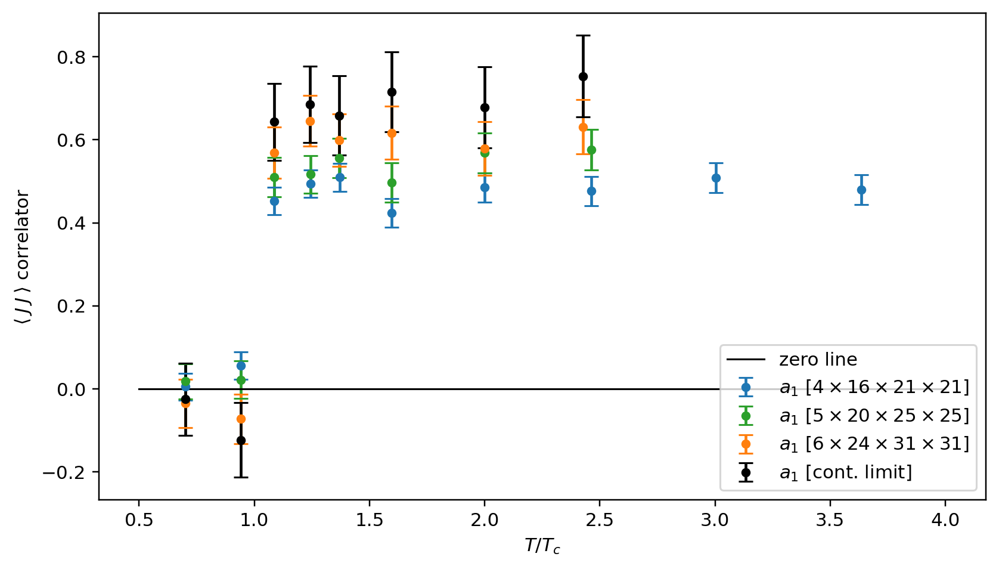

In [20]:
fig, ax = plotters.make_figure_and_111axis(plt)

domain_to_draw = domains.GeometricRange((0.5, 4.0))

x_val = np.linspace(domain_to_draw.left, domain_to_draw.right)
# plt.plot(x_val, 0.0 * x_val)
plt.plot(x_val, 0.0 * x_val, label="zero line", color="black",
         linewidth=1.0)

x_val_16_v2 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 4)[0] for row in kappa2_data_16_v2]) / tc_in_mev_nt4imp - 0.0
print(x_val_16_v2)
y_val_16_v2 = a1_data_16_v2[:, 1]
y_err_16_v2 = a1_data_16_v2[:, 2]
a1_prep_nt4 = plotters.PointRep(x_val_16_v2, y_val_16_v2, y_err_16_v2).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, a1_prep_nt4,
                       "C0", label=r"$a_1$ [$4 \times 16 \times 21 \times 21$]", linestyle="None",
                        domain=domain_to_draw)

x_val_20 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 5)[0] for row in kappa2_data_20]) / tc_in_mev_nt5imp
print(x_val_20)
y_val_20 = a1_data_20[:, 1]
y_err_20 = a1_data_20[:, 2]
a1_prep_nt5 = plotters.PointRep(x_val_20, y_val_20, y_err_20).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, a1_prep_nt5,
                       "C2", label=r"$a_1$ [$5 \times 20 \times 25 \times 25$]", linestyle="None",
                        domain=domain_to_draw)

x_val_24 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 6)[0] for row in kappa2_data_24]) / tc_in_mev_nt6imp + 0.0
print(x_val_24)
y_val_24 = a1_data_24[:, 1]
y_err_24 = a1_data_24[:, 2]
a1_prep_nt6 = plotters.PointRep(x_val_24, y_val_24, y_err_24).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, a1_prep_nt6,
                       "C1", label=r"$a_1$ [$6 \times 24 \times 31 \times 31$]", linestyle="None",
                        domain=domain_to_draw)

a1_prep_etx = l_extrapolator.from_pointreps(_x_val4_imp, [a1_prep_nt6, a1_prep_nt5, a1_prep_nt4])
plotters.draw_point_rep(plt, ax, a1_prep_etx,
                       "black", label=r"$a_1$ [cont. limit]", linestyle="None",
                        domain=domain_to_draw)

# x_val_24 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 6)[0] for row in kappa2_data_24_p0]) / tc_in_mev_nt6imp + 0.0
# print(x_val_24)
# y_val_24 = a1_data_24_p0[:, 1]
# y_err_24 = a1_data_24_p0[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_24, y_val_24, y_err_24).multiply_by_constant(-1.0),
#                        "C5", label=r"$a_1$ [$6 \times 24 \times 31 \times 31$] (p0)",
#                         linestyle="None", domain=domain_to_draw, alpha=0.3, markertype="v")

# x_val_24 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 6)[0] for row in kappa2_data_24_p1]) / tc_in_mev_nt6imp + 0.0
# print(x_val_24)
# y_val_24 = a1_data_24_p1[:, 1]
# y_err_24 = a1_data_24_p1[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_24, y_val_24, y_err_24).multiply_by_constant(-1.0),
#                        "C6", label=r"$a_1$ [$6 \times 24 \times 31 \times 31$] (p1)", linestyle="None",
#                         domain=domain_to_draw, alpha=0.3, markertype="v")

# x_val_24 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 6)[0] for row in kappa2_data_24_p2]) / tc_in_mev_nt6imp + 0.0
# print(x_val_24)
# y_val_24 = a1_data_24_p2[:, 1]
# y_err_24 = a1_data_24_p2[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_24, y_val_24, y_err_24).multiply_by_constant(-1.0),
#                        "C7", label=r"$a_1$ [$6 \times 24 \times 31 \times 31$] (p2)", linestyle="None",
#                         domain=domain_to_draw, alpha=0.3, markertype="v")

# x_val_24 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 6)[0] for row in kappa2_data_24_p3]) / tc_in_mev_nt6imp + 0.0
# print(x_val_24)
# y_val_24 = a1_data_24_p3[:, 1]
# y_err_24 = a1_data_24_p3[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_24, y_val_24, y_err_24).multiply_by_constant(-1.0),
#                        "C8", label=r"$a_1$ [$6 \times 24 \times 31 \times 31$] (p3)", linestyle="None",
#                         domain=domain_to_draw, alpha=0.3, markertype="v")

# x_val_24 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 6)[0] for row in kappa2_data_24_p4]) / tc_in_mev_nt6imp + 0.0
# print(x_val_24)
# y_val_24 = a1_data_24_p4[:, 1]
# y_err_24 = a1_data_24_p4[:, 2]
# plotters.draw_point_rep(plt, ax, plotters.PointRep(x_val_24, y_val_24, y_err_24).multiply_by_constant(-1.0),
#                        "C9", label=r"$a_1$ [$6 \times 24 \times 31 \times 31$] (p4)", linestyle="None",
#                         domain=domain_to_draw, alpha=0.3, markertype="v")

# plt.legend(loc="upper right")
plt.legend(loc="lower right")
plt.xlabel("$T/T_c$")
# plt.ylabel(r"$\langle f \rangle/T^4$ fit coefficient")
plt.ylabel(r"$\langle\; J\;J\: \rangle$ correlator")
# plt.suptitle("($N_t$ = 4,5,6,7; $N_s$ = 40) vs ($N_t$ = 8; $N_s$ = 32) vs "
#              "($N_t$ = 4; $N_s$ = 32; Symanzik)")
# plt.suptitle("($N_t$ = 4,5,6,7; $N_s$ = 40) vs ($N_t$ = 8; $N_s$ = 32); "
#              r"$N_t$$\to\infty$ extrapolation")
# plt.title("solid lines - quadratic integration; dotted lines - trapezoidal integration")
# plt.title("сплошная (пунктир) - кусочно-квадратичное(-линейное) интегрирование")
# plt.ylim([-100.0, 1.0])
# ax.set_xscale("log")
# ax.set_yscale("symlog", linthresh=1.0)
# plt.savefig(f"{output_dir_name}continuous_limit/fit_eos_ntdiff_c2_000.png")
# plt.savefig(f"{output_dir_name}continuous_limit/fit_eos_ntdiff_c4_diploma_000.png")
plt.show()
# plt.savefig(f"{output_dir_name}kudrov_compare_011_v2.png")
# plt.savefig(f"{output_dir_name}kudrov_compare_010_v3.png")
# plt.savefig(f"{output_dir_name}kudrov_compare_011_v4.png")


<Figure size 460.8x345.6 with 0 Axes>

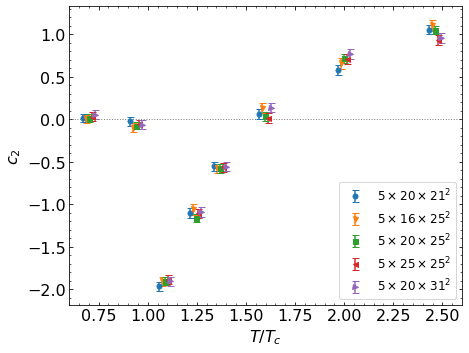

In [68]:
# fig, ax = plotters.make_figure_and_111axis(plt)
plt.clf()
fig, ax = plt.subplots(constrained_layout=True)

domain_to_draw = domains.GeometricRange((0.6, 2.6))

x_val = np.linspace(domain_to_draw.left, domain_to_draw.right)
# plt.plot(x_val, 0.0 * x_val)
plt.plot(x_val, 0.0 * x_val, color="grey", linestyle="dotted",
         linewidth=1.0)

# x_val_nt5_rt3 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 5)[0] for row in kappa2_data_nt5_rt3]) / tc_in_mev_nt5imp
# y_val_nt5_rt3 = kappa2_data_nt5_rt3[:, 1]
# y_err_nt5_rt3 = kappa2_data_nt5_rt3[:, 2]
# kappa2_prep_nt5_rt3 = plotters.PointRep(x_val_nt5_rt3, y_val_nt5_rt3, y_err_nt5_rt3).multiply_by_constant(-1.0)
# plotters.draw_point_rep(plt, ax, kappa2_prep_nt5_rt3,
#                        "C0", label=r"$5(15) \times 20 \times 25 \times 25$", linestyle="None",
#                         domain=domain_to_draw)

x_val_nt5_rs4 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 5)[0] for row in kappa2_data_nt5_rs4]) / tc_in_mev_nt5imp
y_val_nt5_rs4 = kappa2_data_nt5_rs4[:, 1]
y_err_nt5_rs4 = kappa2_data_nt5_rs4[:, 2]
kappa2_prep_nt5_rs4 = plotters.PointRep(x_val_nt5_rs4 - 0.030, y_val_nt5_rs4, y_err_nt5_rs4).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, kappa2_prep_nt5_rs4,
                       "C0", label=r"$5 \times 20 \times 21^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[0])

x_val_nt5_rz3 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 5)[0] for row in kappa2_data_nt5_rz3]) / tc_in_mev_nt5imp
y_val_nt5_rz3 = kappa2_data_nt5_rz3[:, 1]
y_err_nt5_rz3 = kappa2_data_nt5_rz3[:, 2]
kappa2_prep_nt5_rz3 = plotters.PointRep(x_val_nt5_rz3 - 0.015, y_val_nt5_rz3, y_err_nt5_rz3).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, kappa2_prep_nt5_rz3,
                       "C1", label=r"$5 \times 16 \times 25^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[1])

x_val_20 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 5)[0] for row in kappa2_data_20]) / tc_in_mev_nt5imp
y_val_20 = kappa2_data_20[:, 1]
y_err_20 = kappa2_data_20[:, 2]
a1_prep_20 = plotters.PointRep(x_val_20, y_val_20, y_err_20).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, a1_prep_20,
                       "C2", label=r"$5 \times 20 \times 25^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[2])

# x_val_nt5_rt5 = np.array([
#     symanzik_scale_setter.get_temperature_in_mev(
#      [row[0]], 5)[0] for row in kappa2_data_nt5_rt5]) / tc_in_mev_nt5imp
# y_val_nt5_rt5 = kappa2_data_nt5_rt5[:, 1]
# y_err_nt5_rt5 = kappa2_data_nt5_rt5[:, 2]
# kappa2_prep_nt5_rt5 = plotters.PointRep(x_val_nt5_rt5, y_val_nt5_rt5, y_err_nt5_rt5).multiply_by_constant(-1.0)
# plotters.draw_point_rep(plt, ax, kappa2_prep_nt5_rt5,
#                        "C1", label=r"$5(25) \times 20 \times 25 \times 25$", linestyle="None",
#                         domain=domain_to_draw)

x_val_nt5_rz5 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 5)[0] for row in kappa2_data_nt5_rz5]) / tc_in_mev_nt5imp
y_val_nt5_rz5 = kappa2_data_nt5_rz5[:, 1]
y_err_nt5_rz5 = kappa2_data_nt5_rz5[:, 2]
kappa2_prep_nt5_rz5 = plotters.PointRep(x_val_nt5_rz5 + 0.015, y_val_nt5_rz5, y_err_nt5_rz5).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, kappa2_prep_nt5_rz5,
                       "C3", label=r"$5 \times 25 \times 25^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[3])

x_val_nt5_rs6 = np.array([
    symanzik_scale_setter.get_temperature_in_mev(
     [row[0]], 5)[0] for row in kappa2_data_nt5_rs6]) / tc_in_mev_nt5imp
y_val_nt5_rs6 = kappa2_data_nt5_rs6[:, 1]
y_err_nt5_rs6 = kappa2_data_nt5_rs6[:, 2]
kappa2_prep_nt5_rs6 = plotters.PointRep(x_val_nt5_rs6 + 0.030, y_val_nt5_rs6, y_err_nt5_rs6).multiply_by_constant(-1.0)
plotters.draw_point_rep(plt, ax, kappa2_prep_nt5_rs6,
                       "C4", label=r"$5 \times 20 \times 31^2$", linestyle="None",
                        domain=domain_to_draw, markertype=fmtlist[4])

ax.tick_params(axis="both", which="both", direction="in", bottom=1, top=1, left=1, right=1)
ax.minorticks_on()
ax.grid(False)

plt.legend(loc="lower right", fontsize=12)
ax.set_xlim(domain_to_draw.left, domain_to_draw.right)
# plt.legend(loc="upper right")
# plt.legend(loc="lower right")
plt.xlabel("$T/T_c$")
# plt.ylabel(r"$\langle f \rangle/T^4$ fit coefficient")
plt.ylabel("$c_2$")
# plt.ylim([-100.0, 1.0])
plt.savefig(f"{output_dir_name}c2_kudrov_aspect_v1.png")
plt.show()
# plt.savefig(f"{output_dir_name}kudrov_aspect_compare_011_rs.png")


[q] Symanzik c4 constant extrapolation: chi2/dof = 4.93; p = 0.001
[t] Symanzik c4 constant extrapolation: chi2/dof = 2.65; p = 0.031
[q] Symanzik c4 linear extrapolation: chi2/dof = 6.52; p = 0.000
[t] Symanzik c4 linear extrapolation: chi2/dof = 3.54; p = 0.014
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 1.58; p = 0.193
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.54; p = 0.213
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.03; p = 0.857
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 1.02; p = 0.381
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.95; p = 0.387
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.00; p = 0.999


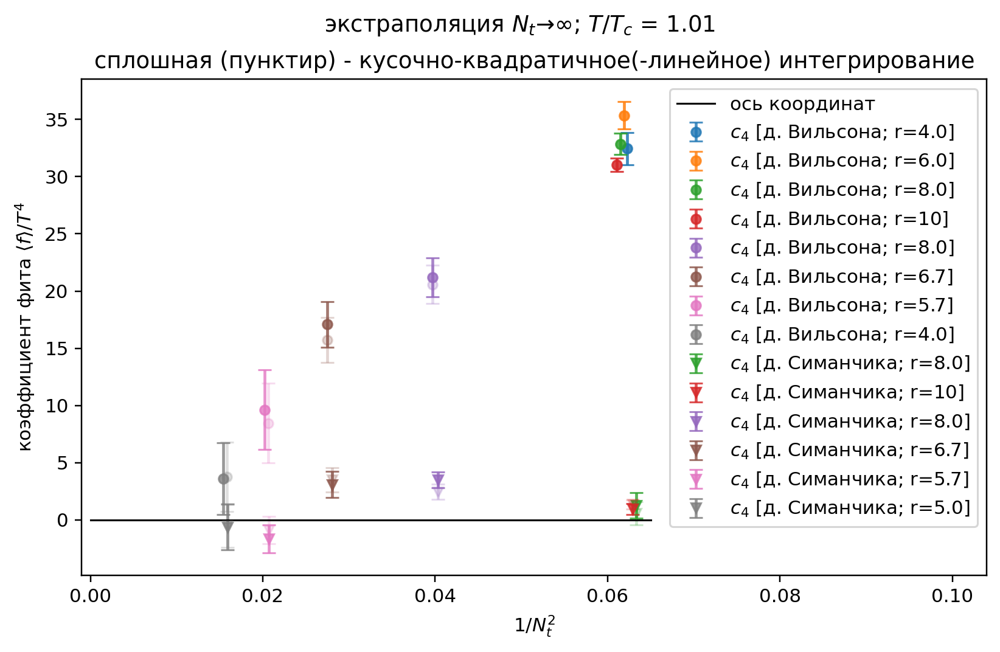

[q] Symanzik c4 constant extrapolation: chi2/dof = 4.23; p = 0.002
[t] Symanzik c4 constant extrapolation: chi2/dof = 2.11; p = 0.077
[q] Symanzik c4 linear extrapolation: chi2/dof = 5.60; p = 0.001
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.81; p = 0.038
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.76; p = 0.516
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.67; p = 0.509
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.02; p = 0.887
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.36; p = 0.784
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.30; p = 0.743
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.14; p = 0.711


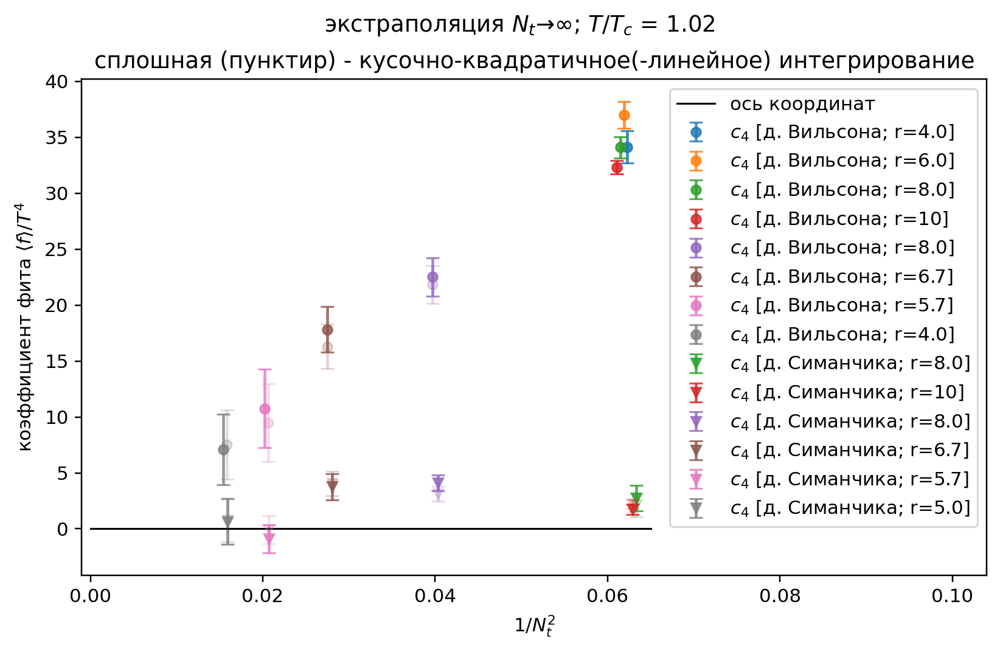

[q] Symanzik c4 constant extrapolation: chi2/dof = 3.76; p = 0.005
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.91; p = 0.106
[q] Symanzik c4 linear extrapolation: chi2/dof = 4.99; p = 0.002
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.52; p = 0.056
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.51; p = 0.677
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.44; p = 0.645
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.10; p = 0.750
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.882
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.22; p = 0.800
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.35; p = 0.556


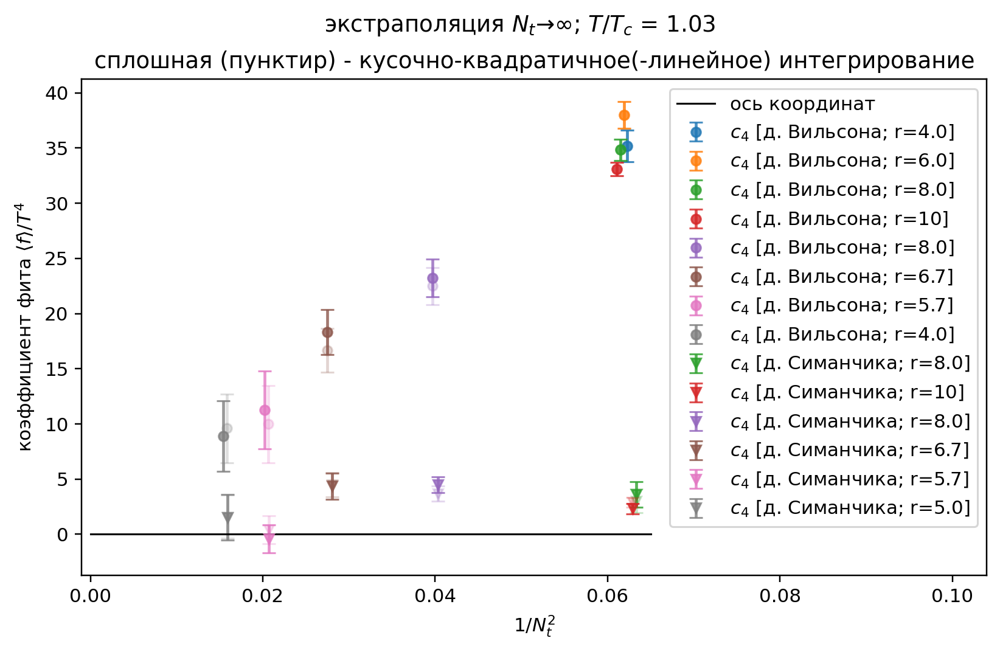

[q] Symanzik c4 constant extrapolation: chi2/dof = 3.72; p = 0.005
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.92; p = 0.103
[q] Symanzik c4 linear extrapolation: chi2/dof = 4.95; p = 0.002
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.54; p = 0.055
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.40; p = 0.752
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.34; p = 0.715
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.16; p = 0.690
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.896
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.788
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.47; p = 0.494


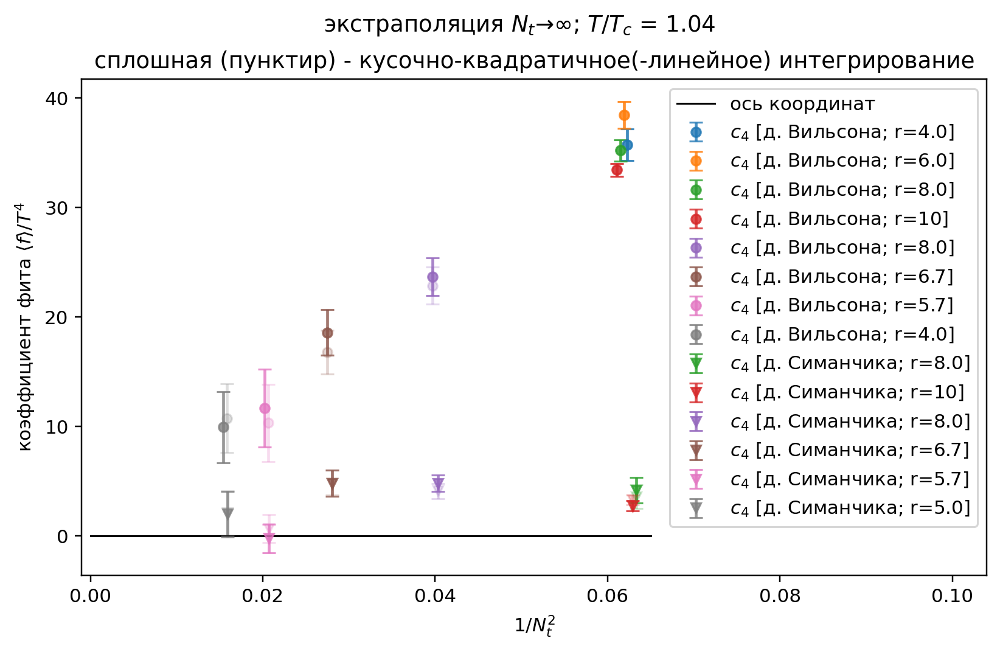

[q] Symanzik c4 constant extrapolation: chi2/dof = 3.87; p = 0.004
[t] Symanzik c4 constant extrapolation: chi2/dof = 2.02; p = 0.089
[q] Symanzik c4 linear extrapolation: chi2/dof = 5.16; p = 0.001
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.66; p = 0.046
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.36; p = 0.780
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.29; p = 0.750
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.18; p = 0.671
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.895
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.25; p = 0.776
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.51; p = 0.476


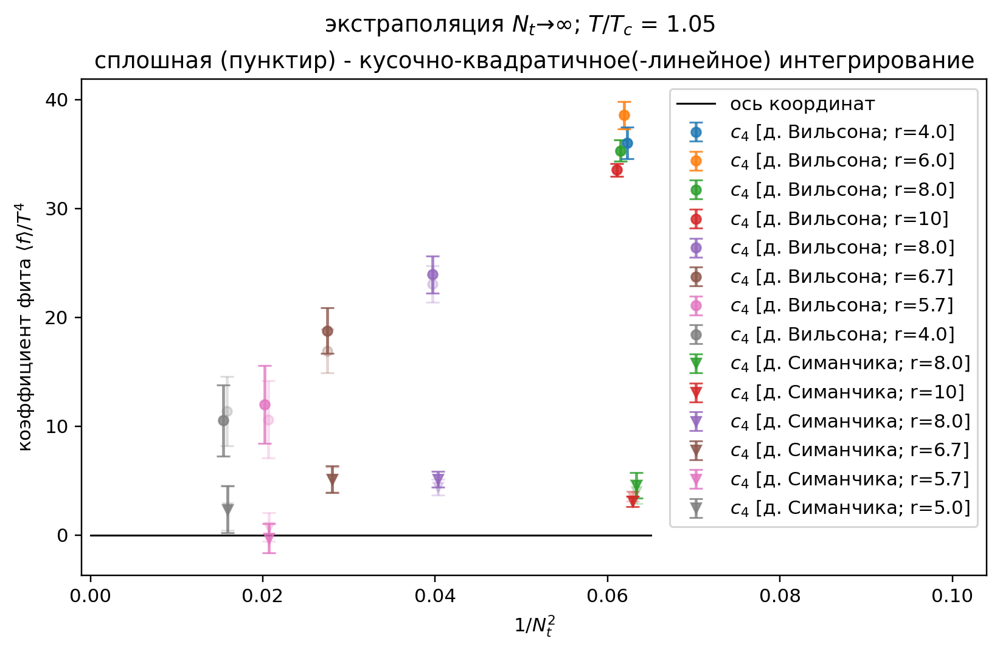

[q] Symanzik c4 constant extrapolation: chi2/dof = 4.08; p = 0.003
[t] Symanzik c4 constant extrapolation: chi2/dof = 2.13; p = 0.075
[q] Symanzik c4 linear extrapolation: chi2/dof = 5.44; p = 0.001
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.79; p = 0.039
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.35; p = 0.790
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.26; p = 0.770
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.19; p = 0.666
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.21; p = 0.891
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.26; p = 0.769
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.52; p = 0.472


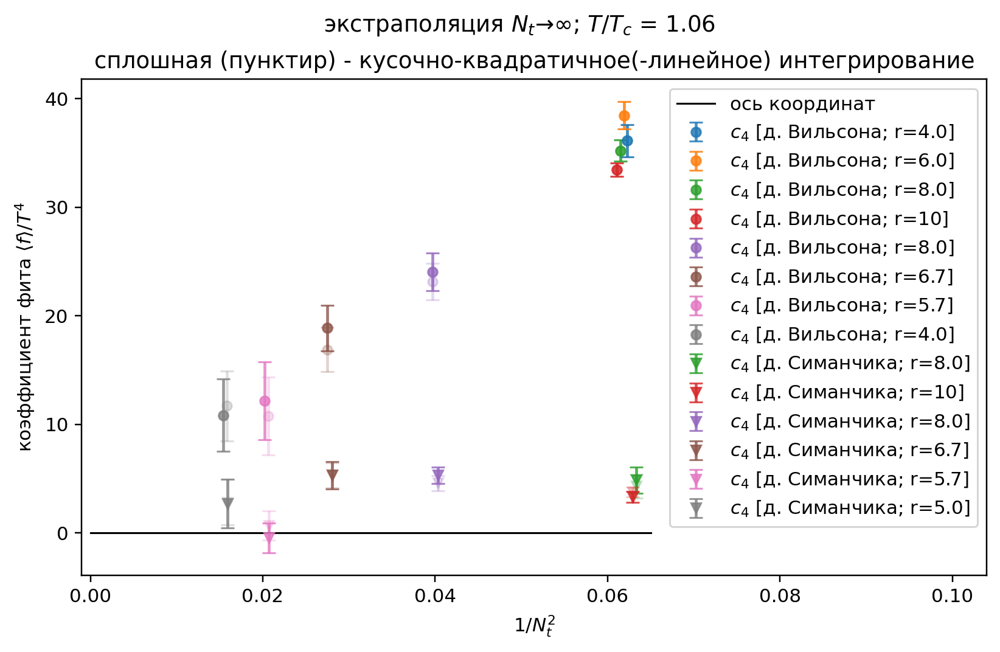

[q] Symanzik c4 constant extrapolation: chi2/dof = 4.18; p = 0.002
[t] Symanzik c4 constant extrapolation: chi2/dof = 2.18; p = 0.068
[q] Symanzik c4 linear extrapolation: chi2/dof = 5.56; p = 0.001
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.83; p = 0.037
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.33; p = 0.805
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.783
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.21; p = 0.644
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.881
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.29; p = 0.747
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.56; p = 0.455


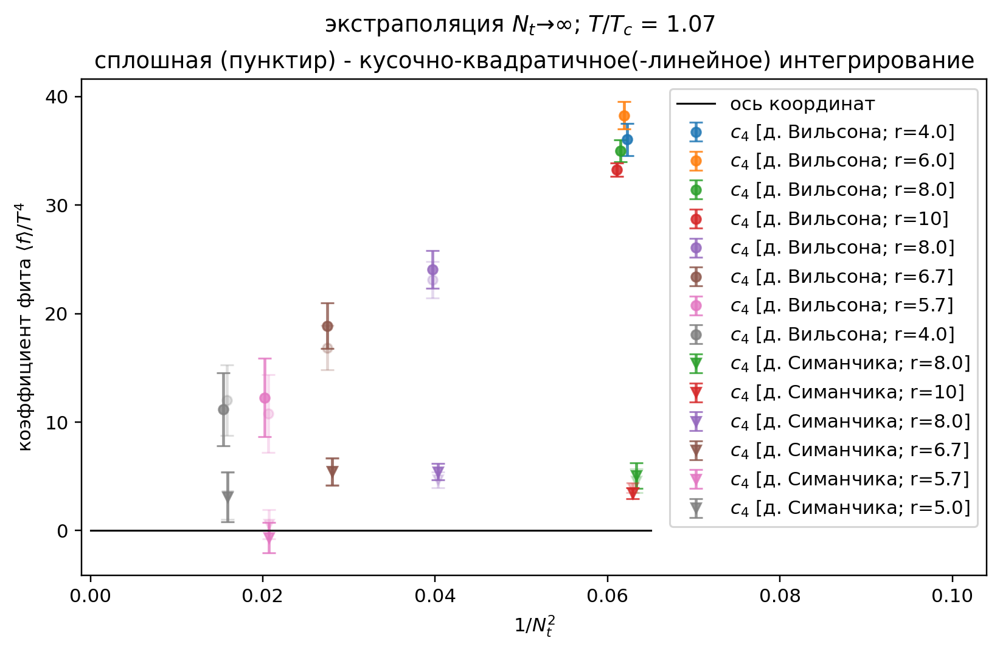

[q] Symanzik c4 constant extrapolation: chi2/dof = 4.11; p = 0.002
[t] Symanzik c4 constant extrapolation: chi2/dof = 2.17; p = 0.070
[q] Symanzik c4 linear extrapolation: chi2/dof = 5.47; p = 0.001
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.78; p = 0.039
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.30; p = 0.824
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.790
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.28; p = 0.599
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.859
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.35; p = 0.705
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.65; p = 0.421


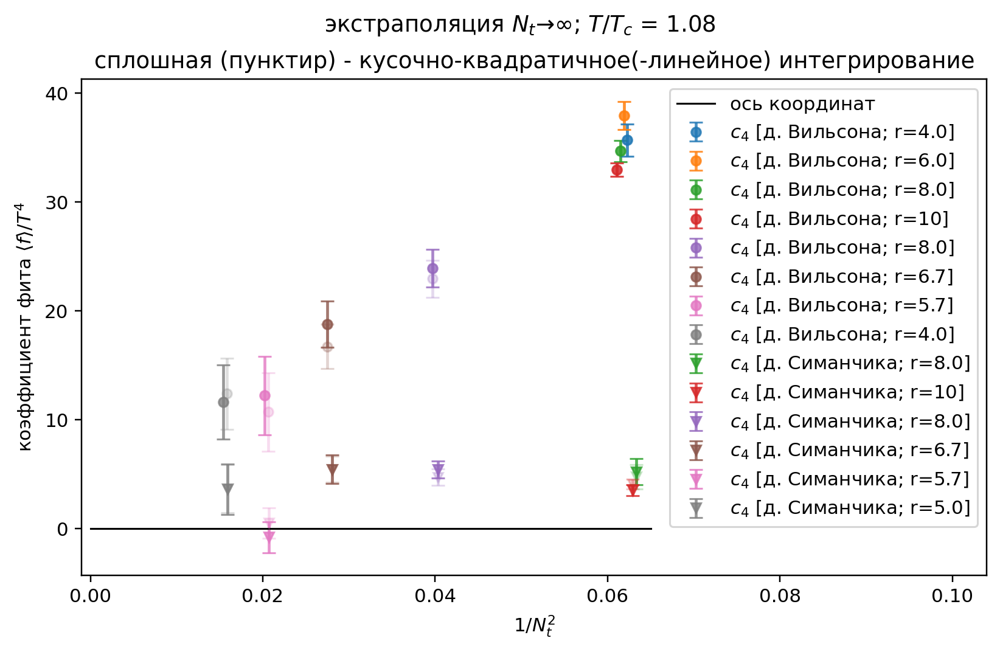

[q] Symanzik c4 constant extrapolation: chi2/dof = 3.92; p = 0.003
[t] Symanzik c4 constant extrapolation: chi2/dof = 2.09; p = 0.079
[q] Symanzik c4 linear extrapolation: chi2/dof = 5.21; p = 0.001
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.66; p = 0.047
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.28; p = 0.840
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.785
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.36; p = 0.547
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.30; p = 0.826
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.43; p = 0.651
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.77; p = 0.381


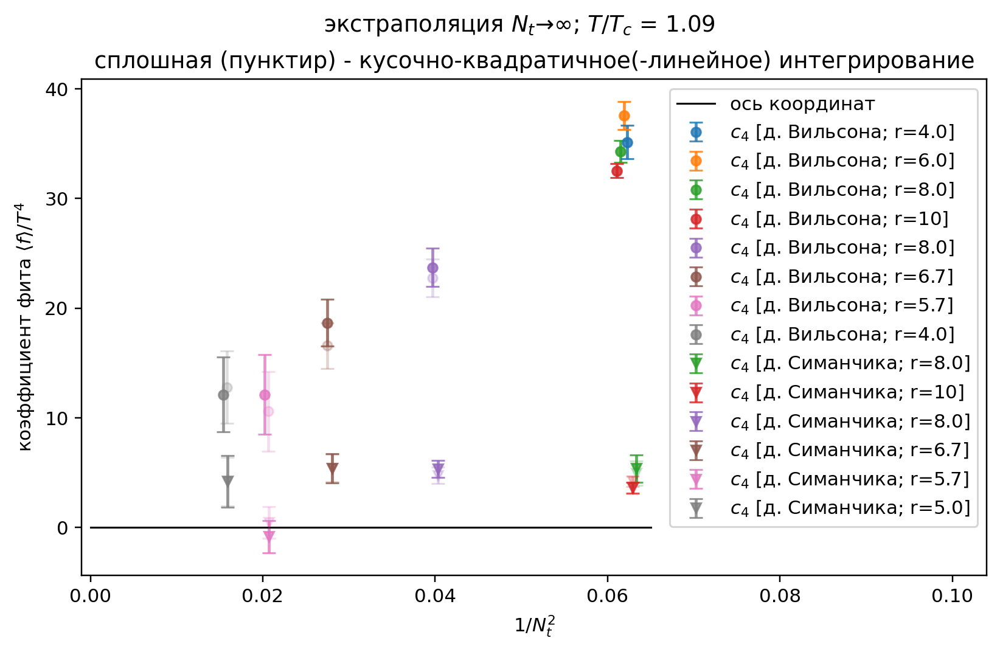

[q] Symanzik c4 constant extrapolation: chi2/dof = 3.65; p = 0.006
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.96; p = 0.098
[q] Symanzik c4 linear extrapolation: chi2/dof = 4.85; p = 0.002
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.47; p = 0.060
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.27; p = 0.849
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.26; p = 0.771
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.46; p = 0.500
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.35; p = 0.786
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.52; p = 0.595
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.90; p = 0.344


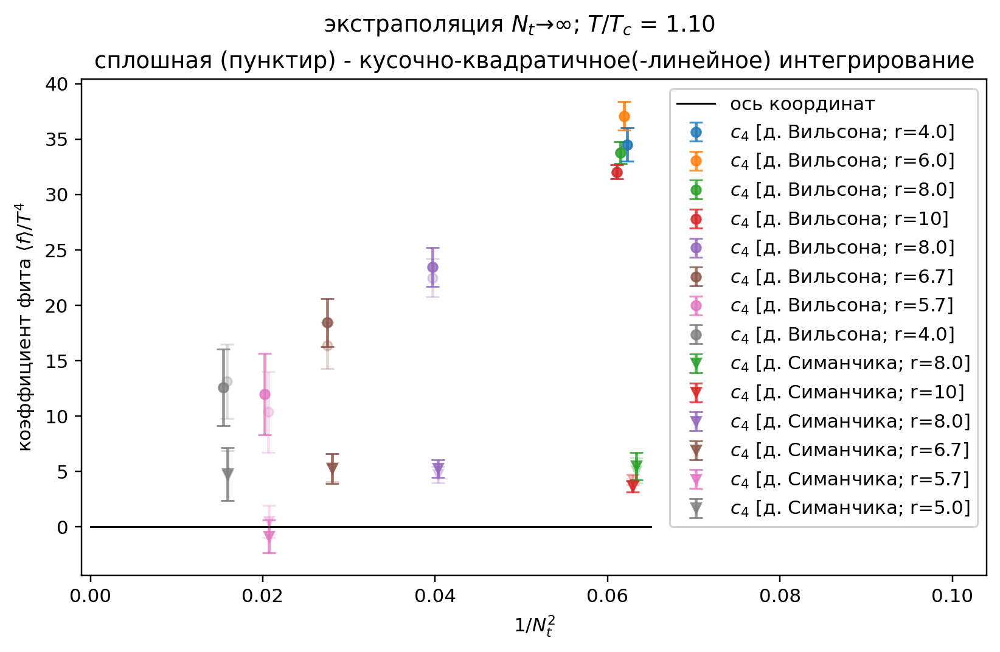

[q] Symanzik c4 constant extrapolation: chi2/dof = 3.36; p = 0.009
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.78; p = 0.130
[q] Symanzik c4 linear extrapolation: chi2/dof = 4.47; p = 0.004
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.25; p = 0.080
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.853
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.28; p = 0.755
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.54; p = 0.464
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.41; p = 0.747
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.60; p = 0.547
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.01; p = 0.314


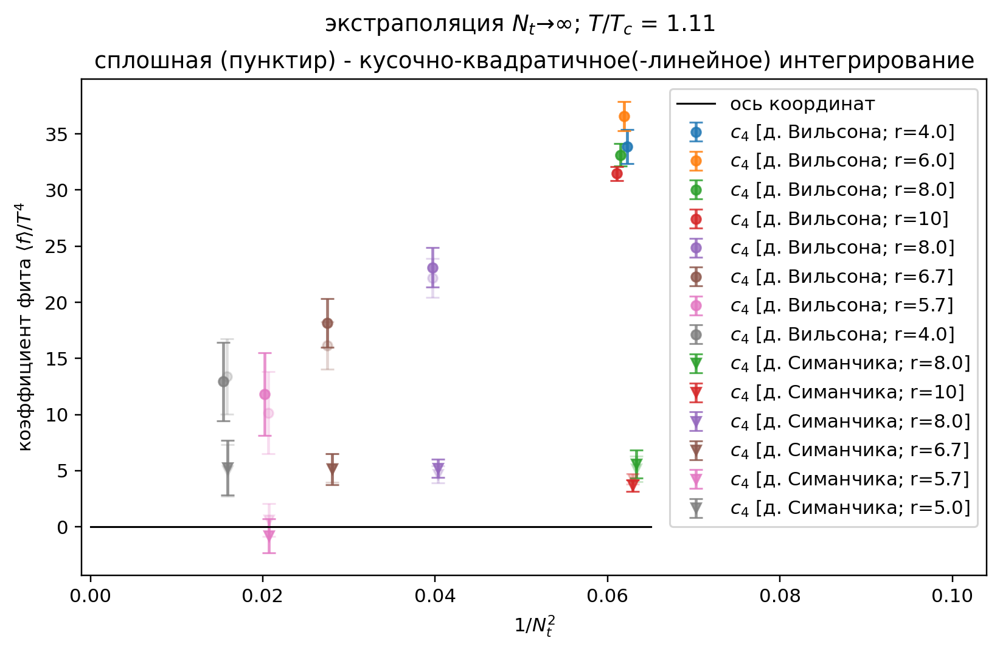

[q] Symanzik c4 constant extrapolation: chi2/dof = 3.08; p = 0.015
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.59; p = 0.174
[q] Symanzik c4 linear extrapolation: chi2/dof = 4.10; p = 0.006
[t] Symanzik c4 linear extrapolation: chi2/dof = 2.02; p = 0.109
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.855
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.30; p = 0.740
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.60; p = 0.440
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.45; p = 0.714
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.68; p = 0.509
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.11; p = 0.291


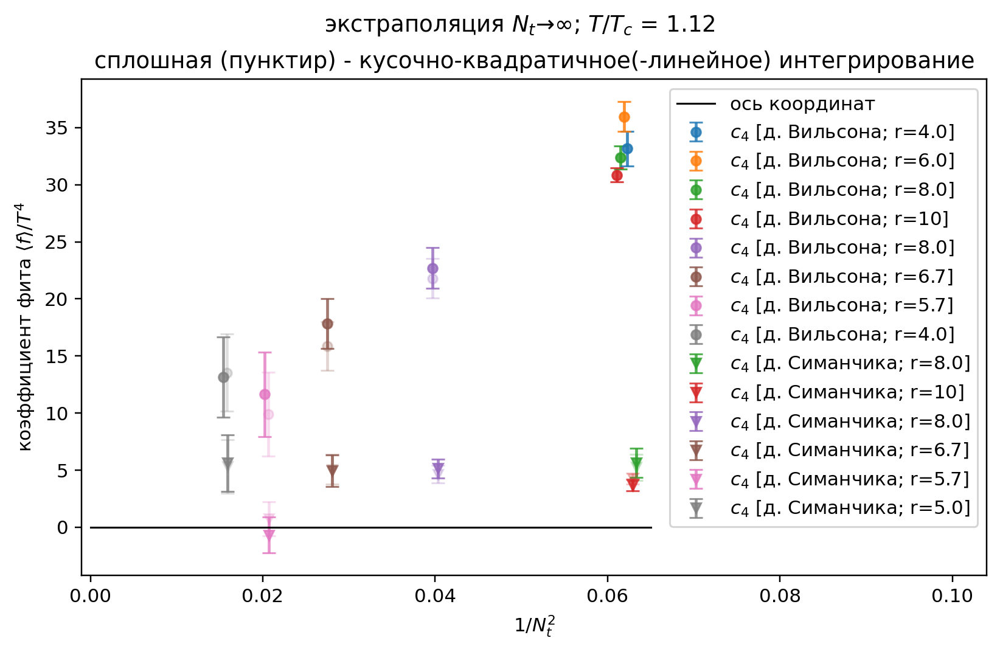

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.85; p = 0.023
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.41; p = 0.229
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.79; p = 0.010
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.80; p = 0.144
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.857
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.32; p = 0.729
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.63; p = 0.427
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.49; p = 0.689
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.73; p = 0.481
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.19; p = 0.276


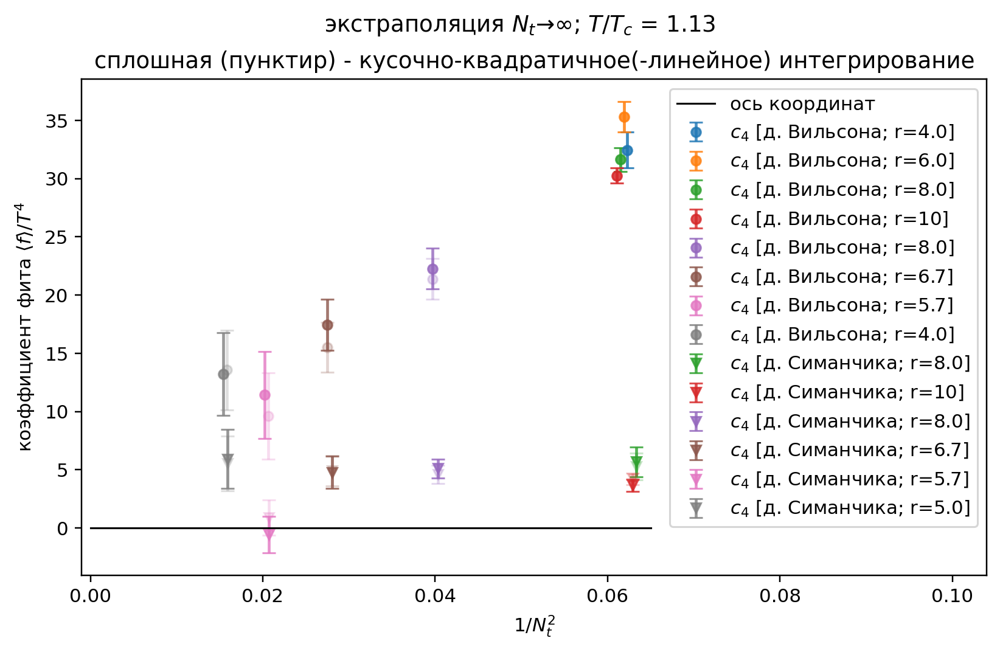

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.66; p = 0.031
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.26; p = 0.284
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.55; p = 0.014
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.63; p = 0.180
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.862
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.32; p = 0.724
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.65; p = 0.422
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.51; p = 0.674
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.77; p = 0.465
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.24; p = 0.266


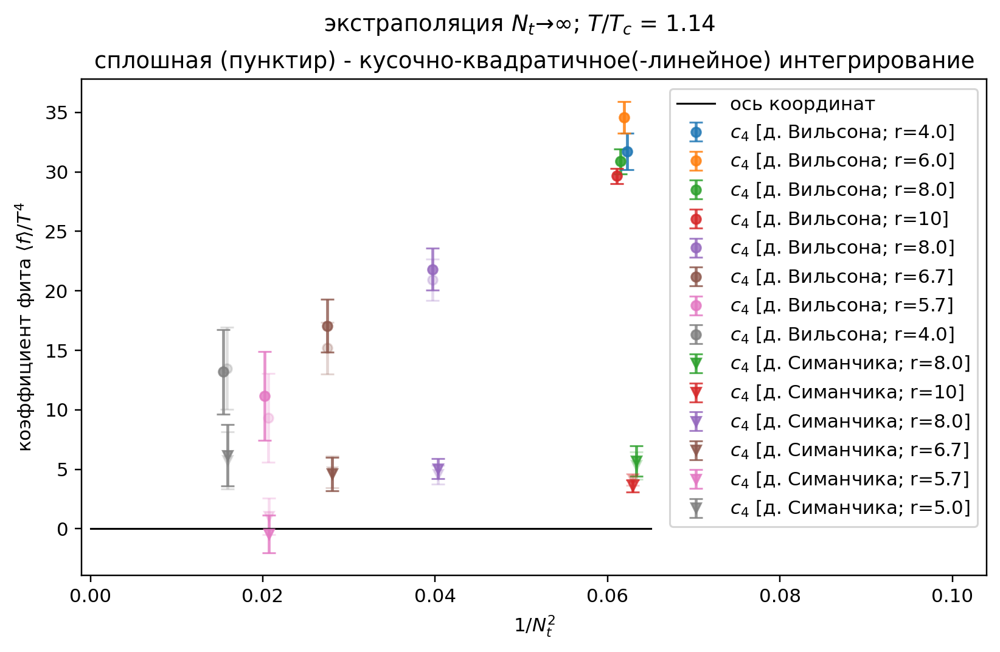

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.55; p = 0.037
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.16; p = 0.328
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.40; p = 0.017
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.51; p = 0.209
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.24; p = 0.866
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.33; p = 0.722
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.65; p = 0.421
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.53; p = 0.665
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.79; p = 0.455
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.27; p = 0.260


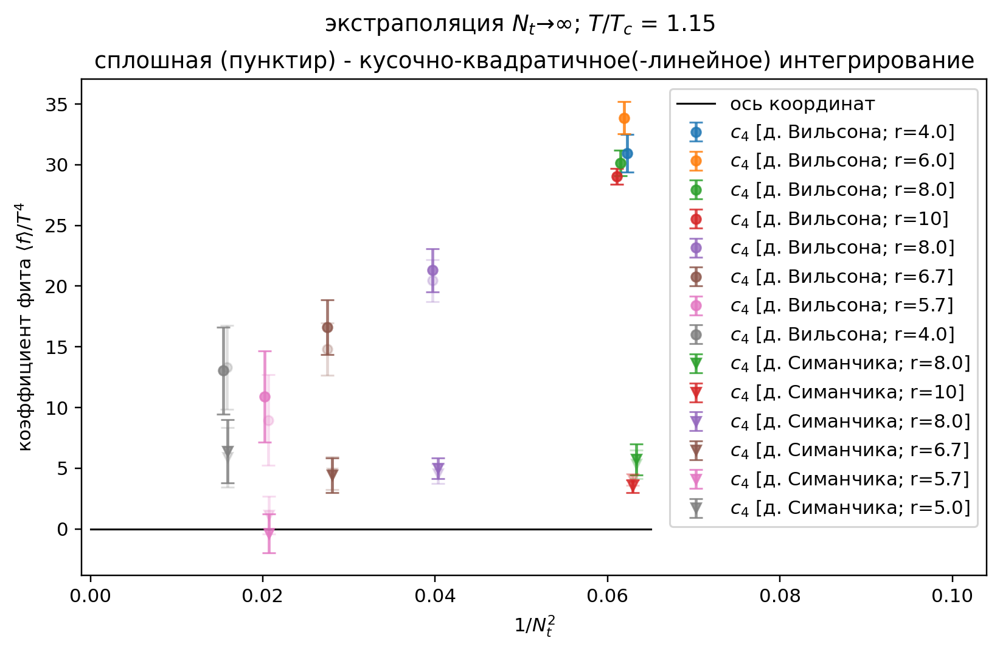

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.51; p = 0.040
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.11; p = 0.349
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.35; p = 0.018
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.46; p = 0.222
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.24; p = 0.868
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.33; p = 0.719
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.65; p = 0.420
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.54; p = 0.656
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.81; p = 0.446
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.30; p = 0.253


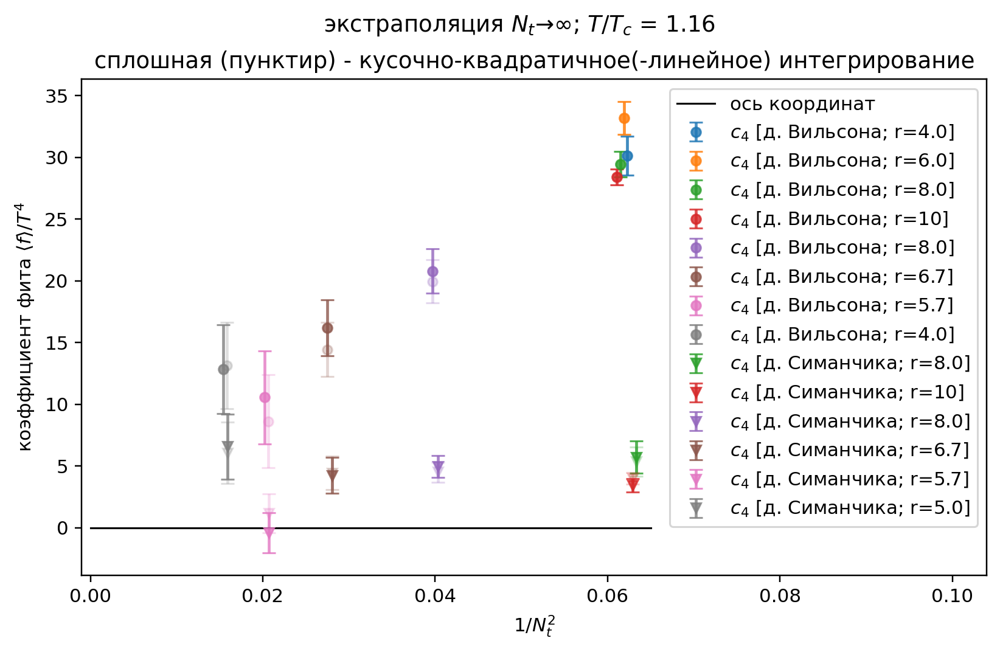

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.54; p = 0.038
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.12; p = 0.347
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.38; p = 0.017
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.47; p = 0.220
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.24; p = 0.865
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.34; p = 0.709
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.67; p = 0.412
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.56; p = 0.641
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.84; p = 0.431
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.36; p = 0.244


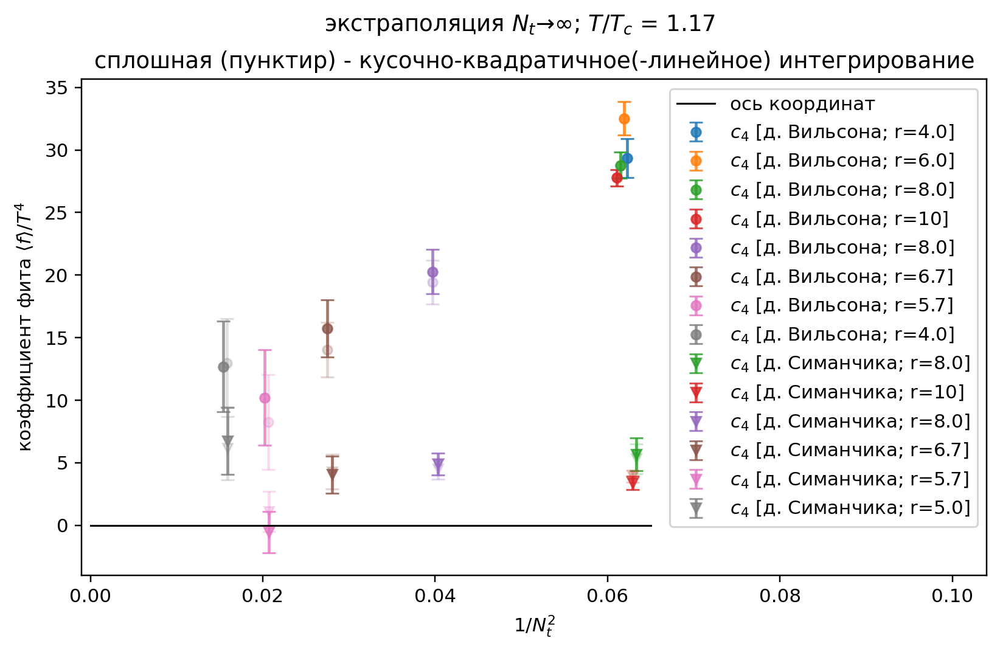

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.61; p = 0.034
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.15; p = 0.330
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.48; p = 0.015
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.52; p = 0.206
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.856
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.37; p = 0.689
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.72; p = 0.397
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.60; p = 0.617
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.89; p = 0.409
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.44; p = 0.230


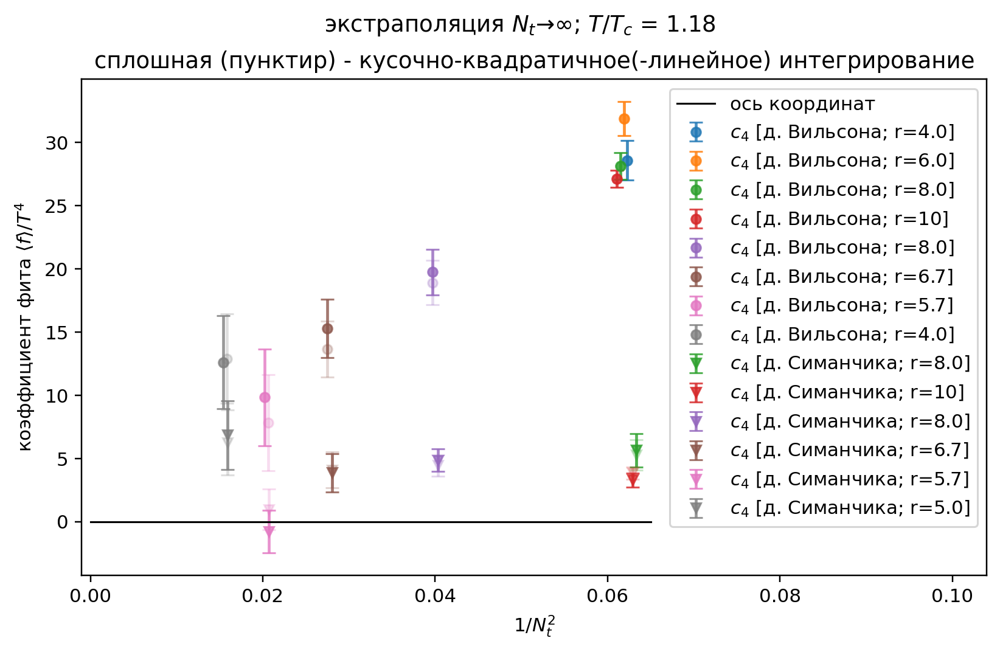

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.70; p = 0.029
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.21; p = 0.306
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.60; p = 0.013
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.59; p = 0.189
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.28; p = 0.839
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.41; p = 0.661
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.79; p = 0.375
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.64; p = 0.586
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.96; p = 0.382
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.54; p = 0.214


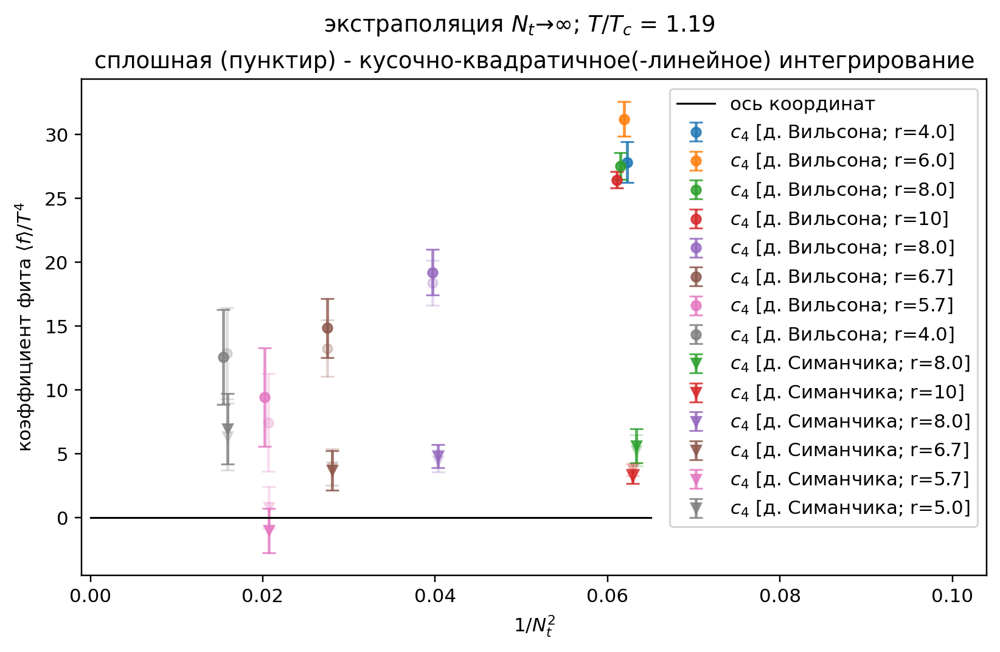

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.80; p = 0.025
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.26; p = 0.281
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.73; p = 0.011
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.67; p = 0.171
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.31; p = 0.816
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.47; p = 0.628
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.87; p = 0.350
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.70; p = 0.552
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.04; p = 0.354
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.67; p = 0.197


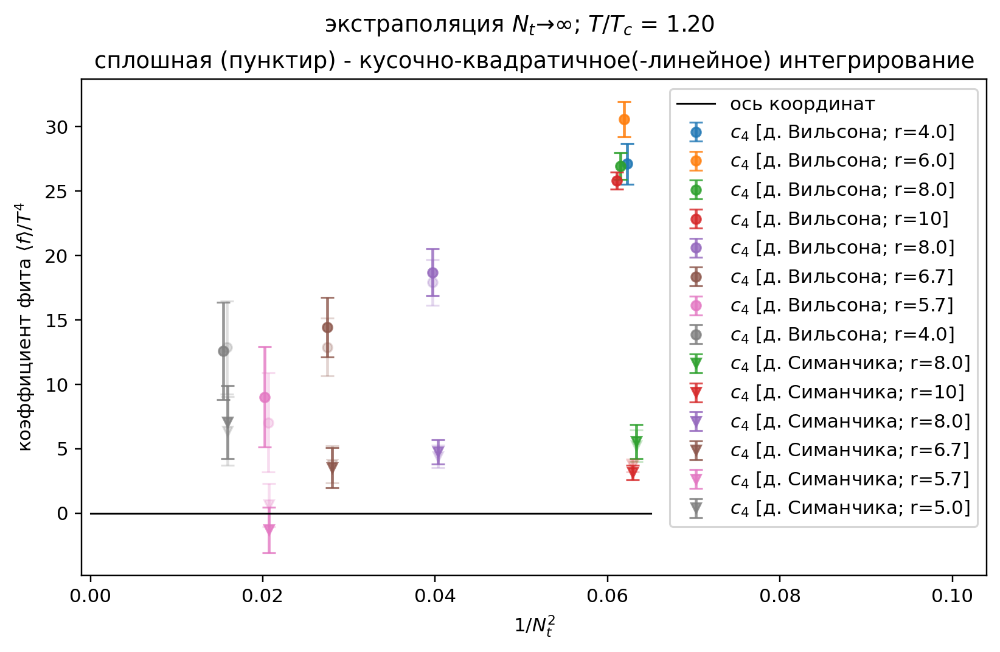

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.88; p = 0.021
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.32; p = 0.261
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.84; p = 0.009
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.73; p = 0.157
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.35; p = 0.791
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.52; p = 0.594
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.97; p = 0.324
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.76; p = 0.518
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.12; p = 0.326
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.80; p = 0.180


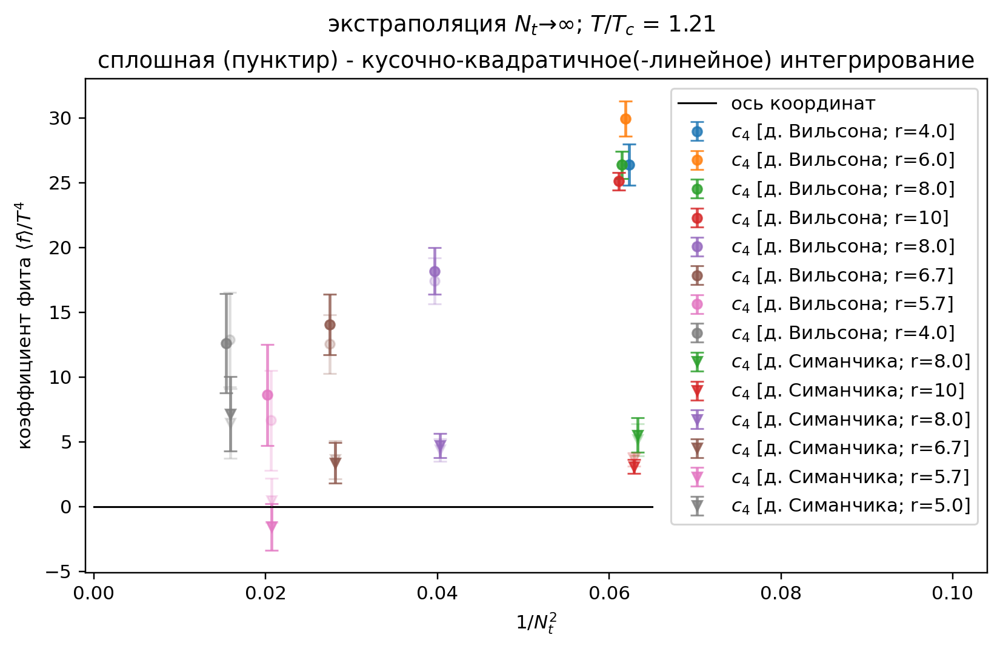

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.95; p = 0.019
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.35; p = 0.249
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.93; p = 0.008
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.78; p = 0.149
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.38; p = 0.764
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.58; p = 0.562
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.07; p = 0.301
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.81; p = 0.485
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.20; p = 0.301
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.92; p = 0.166


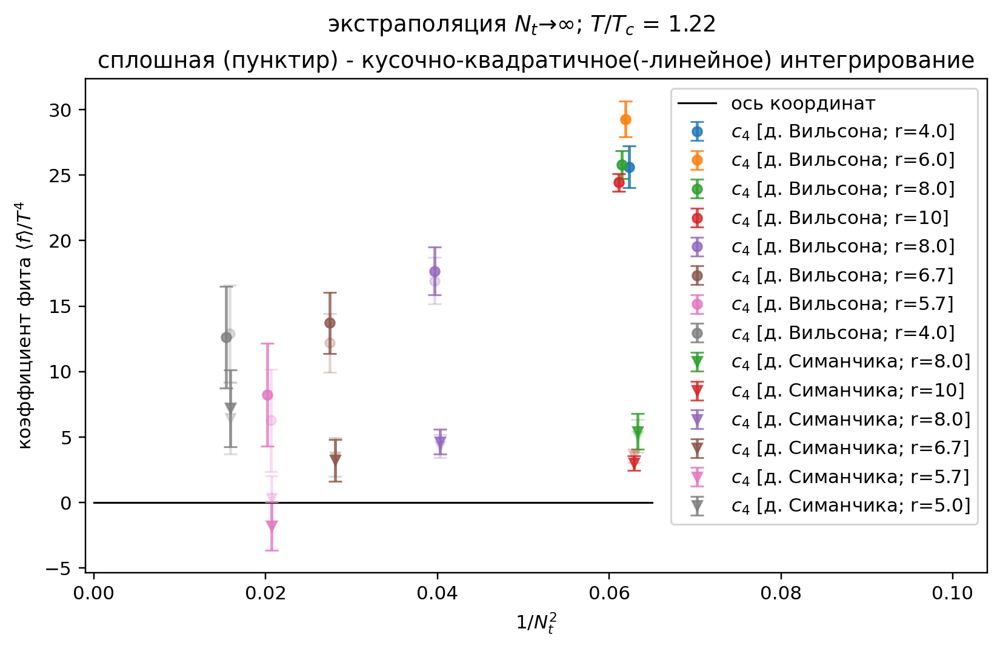

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.98; p = 0.018
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.36; p = 0.245
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.96; p = 0.008
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.79; p = 0.147
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.42; p = 0.740
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.63; p = 0.535
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.16; p = 0.282
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.87; p = 0.458
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.27; p = 0.280
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 2.03; p = 0.154


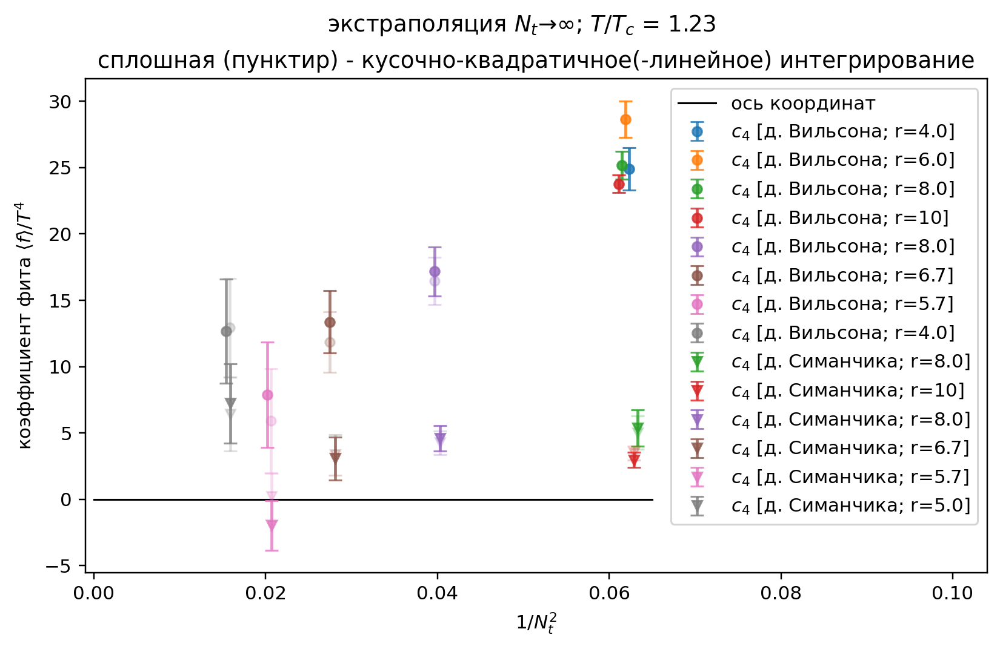

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.98; p = 0.018
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.35; p = 0.249
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.96; p = 0.008
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.77; p = 0.151
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.44; p = 0.721
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.66; p = 0.515
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.23; p = 0.268
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.91; p = 0.436
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.33; p = 0.266
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 2.12; p = 0.146


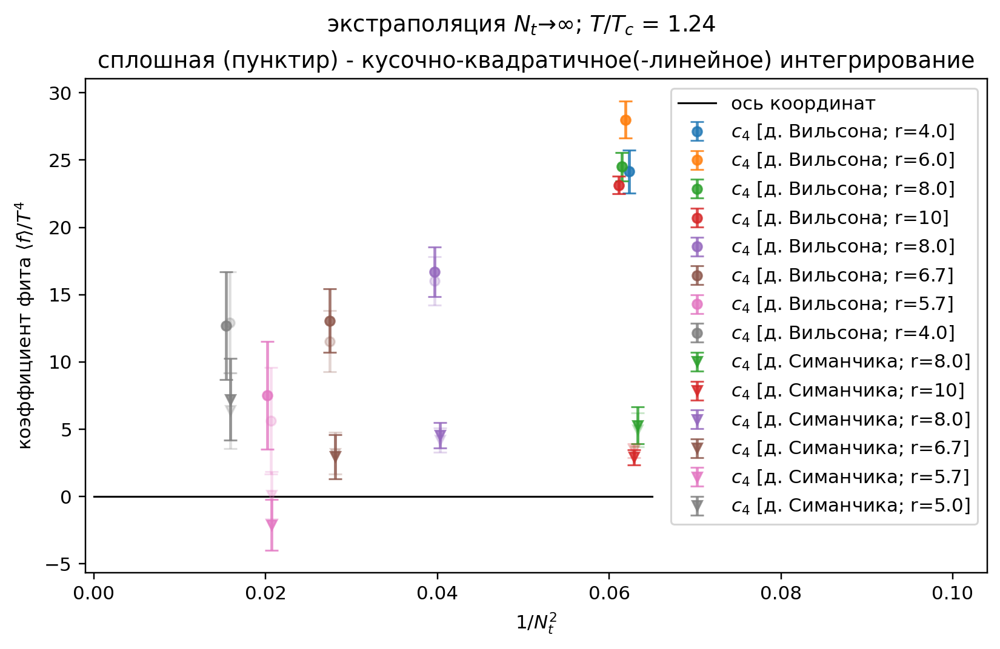

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.95; p = 0.019
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.32; p = 0.258
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.92; p = 0.008
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.73; p = 0.158
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.46; p = 0.710
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.68; p = 0.505
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.27; p = 0.260
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.94; p = 0.423
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.36; p = 0.257
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 2.16; p = 0.142


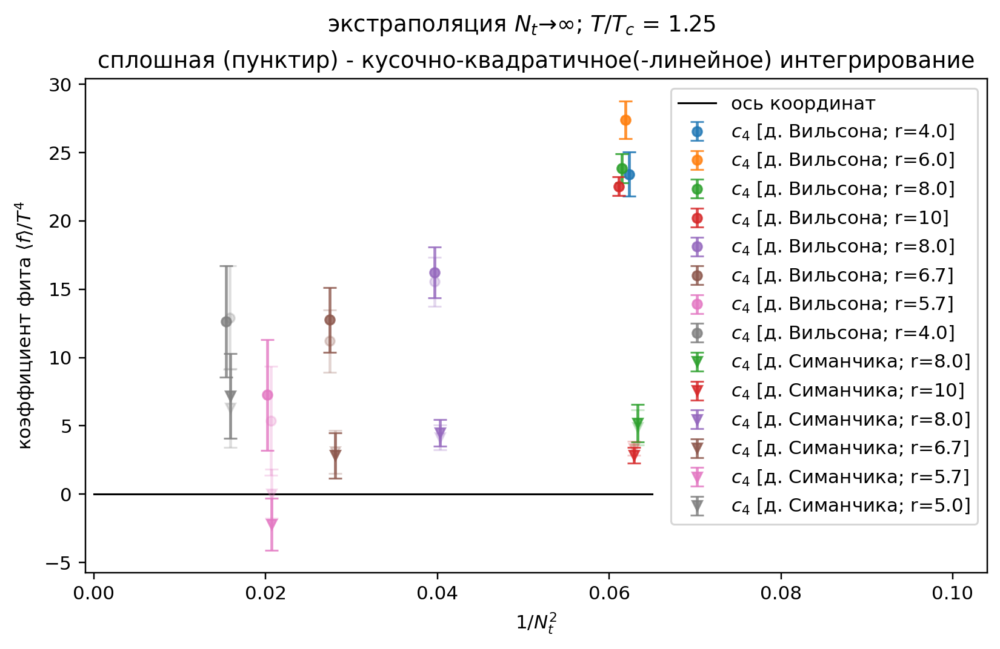

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.91; p = 0.020
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.29; p = 0.273
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.85; p = 0.009
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.68; p = 0.169
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.46; p = 0.707
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.69; p = 0.504
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.27; p = 0.260
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.95; p = 0.417
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.37; p = 0.255
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 2.16; p = 0.142


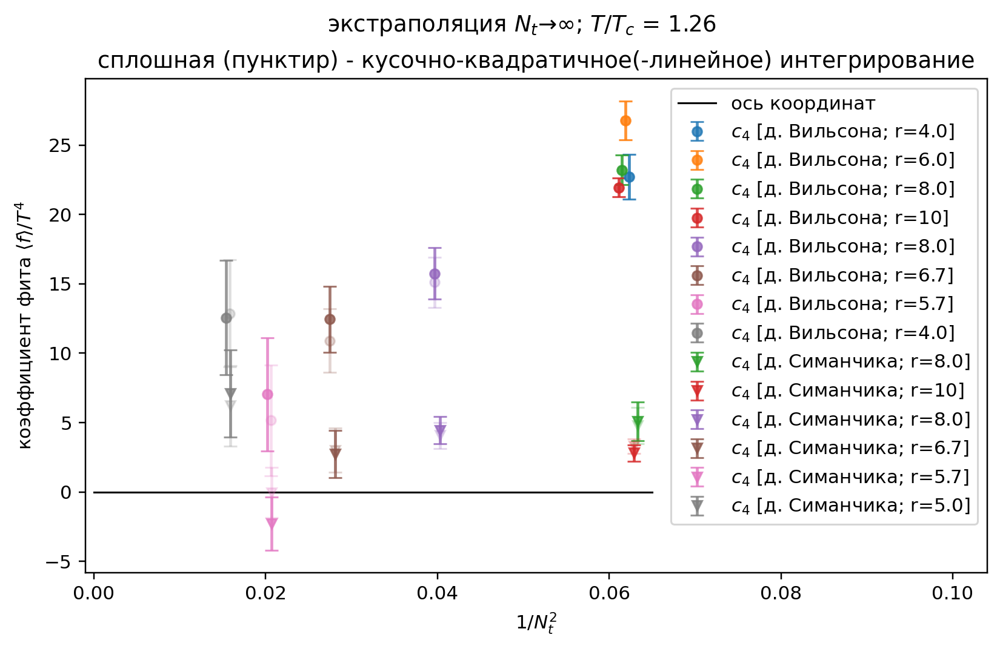

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.84; p = 0.023
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.24; p = 0.291
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.76; p = 0.010
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.62; p = 0.183
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.46; p = 0.711
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.67; p = 0.511
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.24; p = 0.265
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.95; p = 0.418
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.35; p = 0.258
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 2.12; p = 0.145


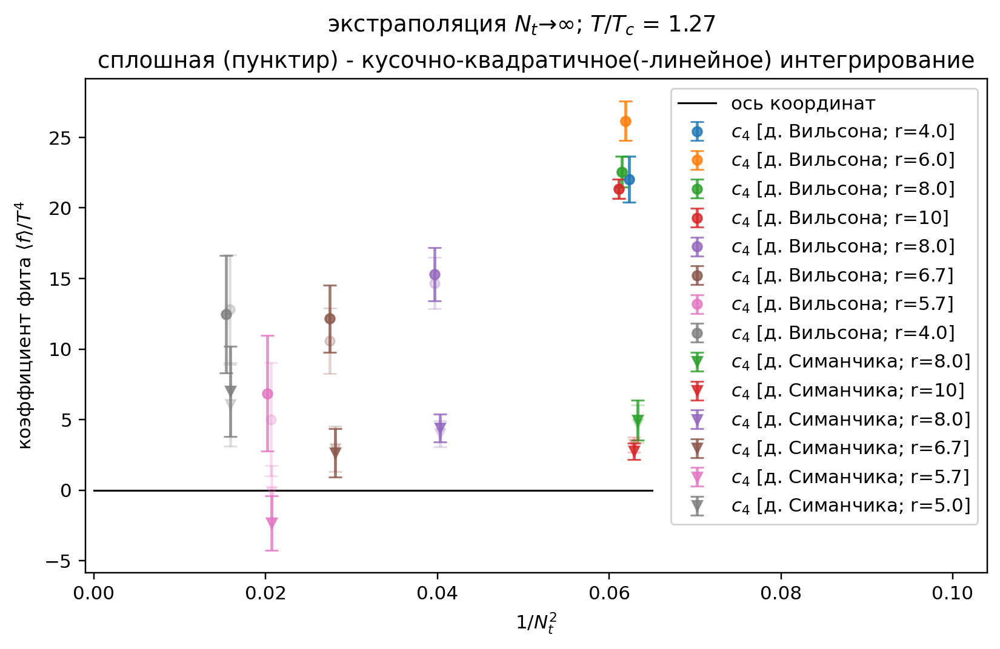

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.76; p = 0.026
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.19; p = 0.311
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.65; p = 0.012
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.56; p = 0.198
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.44; p = 0.721
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.64; p = 0.526
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.18; p = 0.277
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.93; p = 0.424
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.33; p = 0.266
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 2.05; p = 0.152


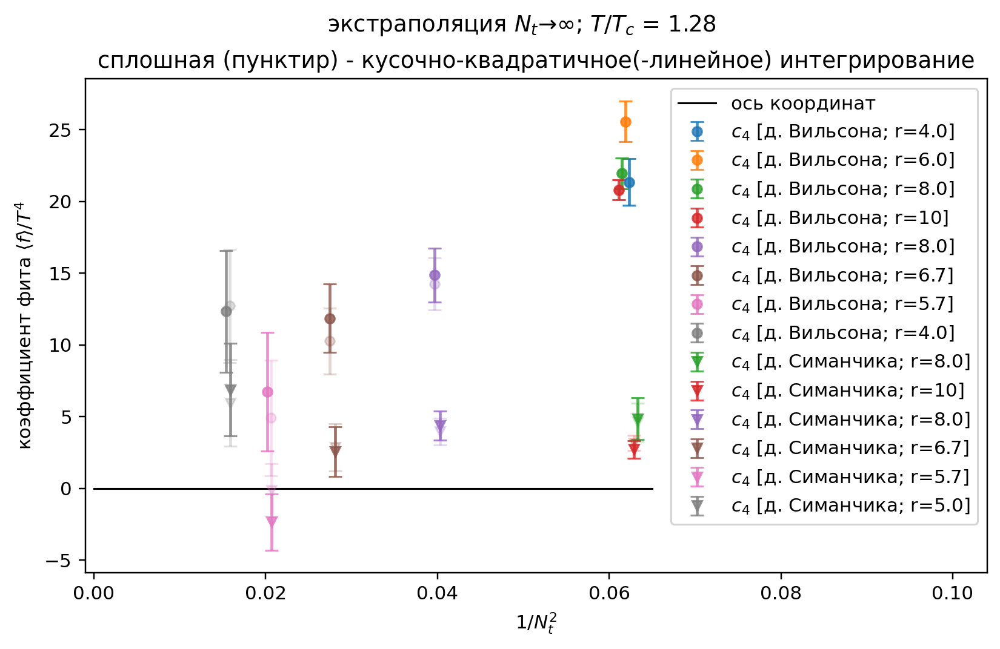

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.67; p = 0.031
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.15; p = 0.331
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.53; p = 0.014
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.49; p = 0.214
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.42; p = 0.737
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.60; p = 0.546
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.10; p = 0.293
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.91; p = 0.434
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.29; p = 0.277
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.95; p = 0.163


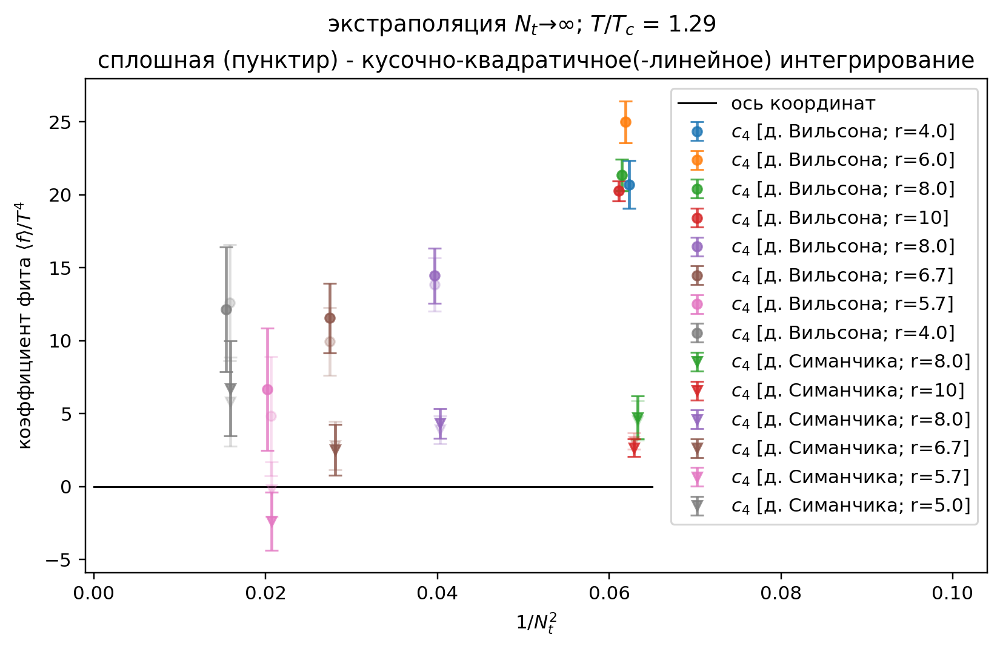

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.57; p = 0.036
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.11; p = 0.352
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.41; p = 0.017
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.44; p = 0.230
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.40; p = 0.756
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.56; p = 0.571
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.01; p = 0.315
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.89; p = 0.448
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.24; p = 0.290
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.84; p = 0.176


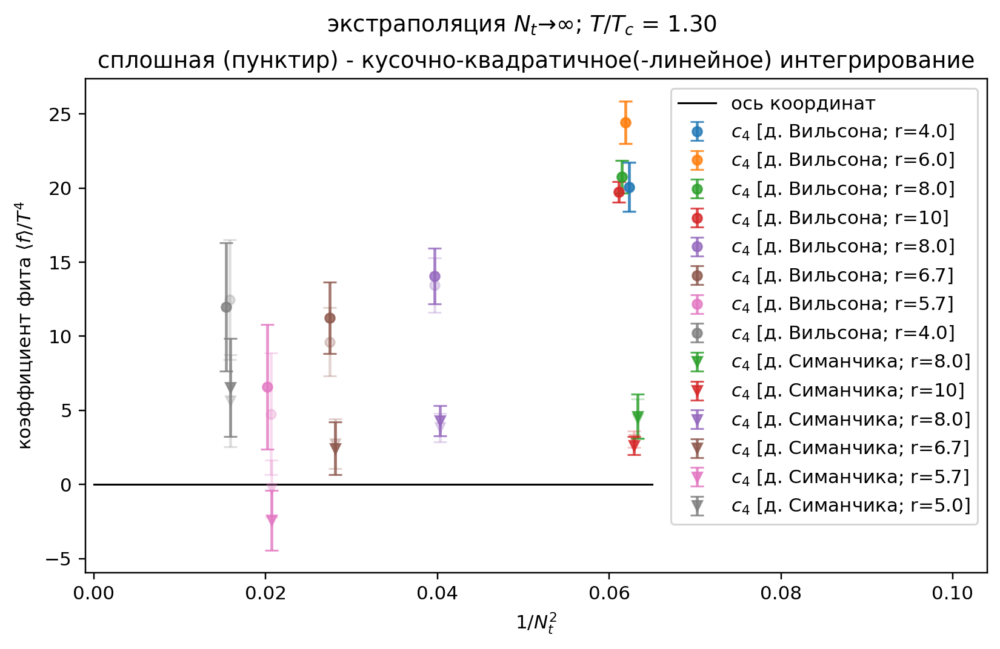

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.48; p = 0.042
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.07; p = 0.371
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.28; p = 0.020
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.38; p = 0.246
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.37; p = 0.777
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.51; p = 0.600
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.91; p = 0.340
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.86; p = 0.464
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.18; p = 0.306
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.71; p = 0.191


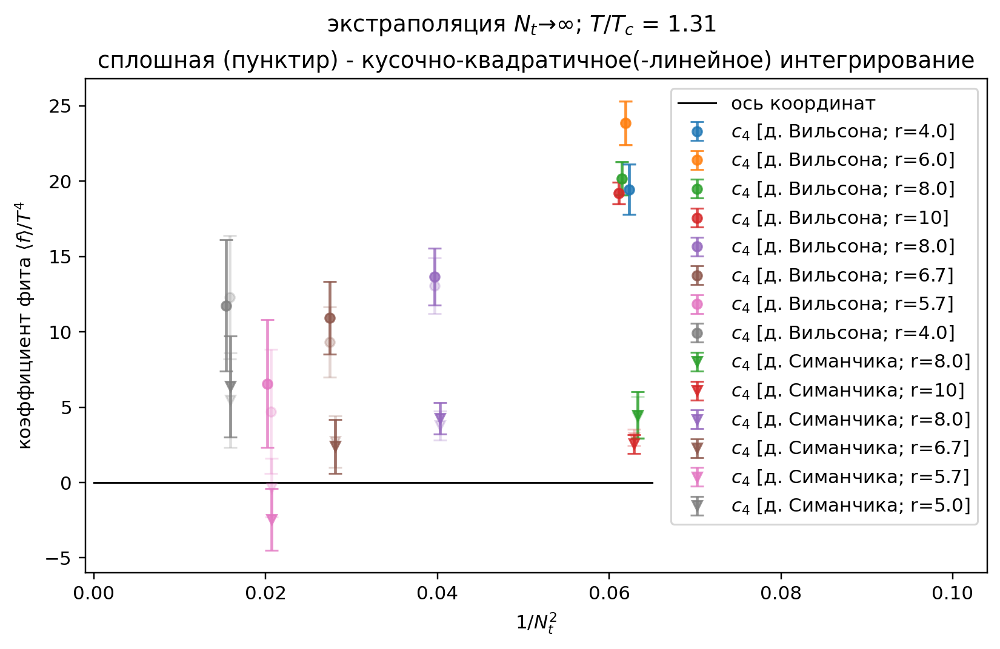

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.38; p = 0.049
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.03; p = 0.390
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.16; p = 0.024
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.33; p = 0.261
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.34; p = 0.799
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.46; p = 0.630
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.80; p = 0.370
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.82; p = 0.481
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.13; p = 0.324
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.58; p = 0.208


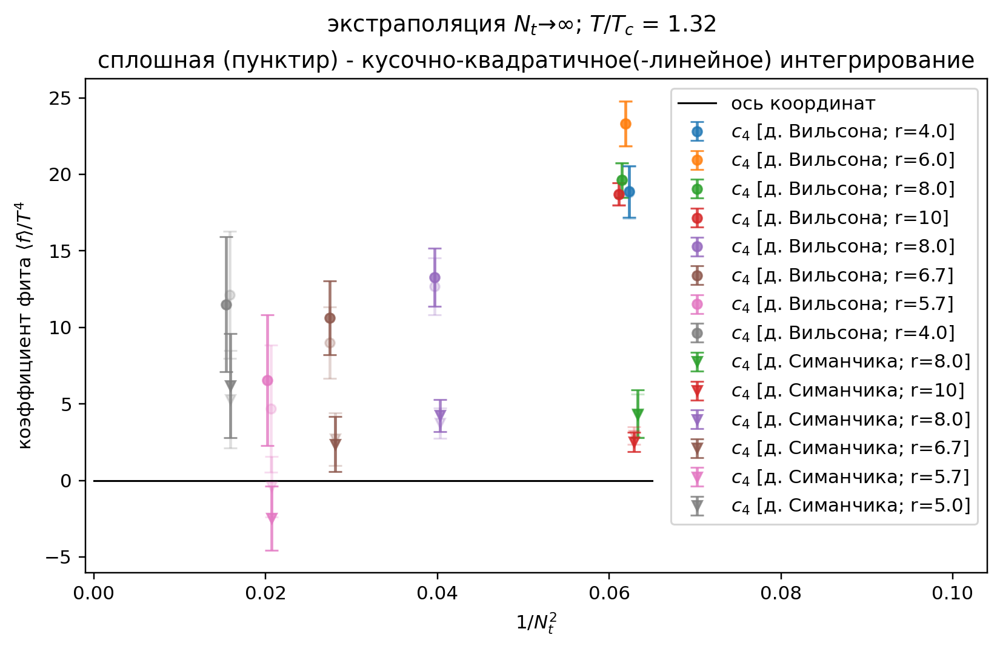

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.29; p = 0.057
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.00; p = 0.406
[q] Symanzik c4 linear extrapolation: chi2/dof = 3.04; p = 0.028
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.29; p = 0.275
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.31; p = 0.822
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.41; p = 0.662
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.70; p = 0.402
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.79; p = 0.500
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.07; p = 0.343
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.46; p = 0.227


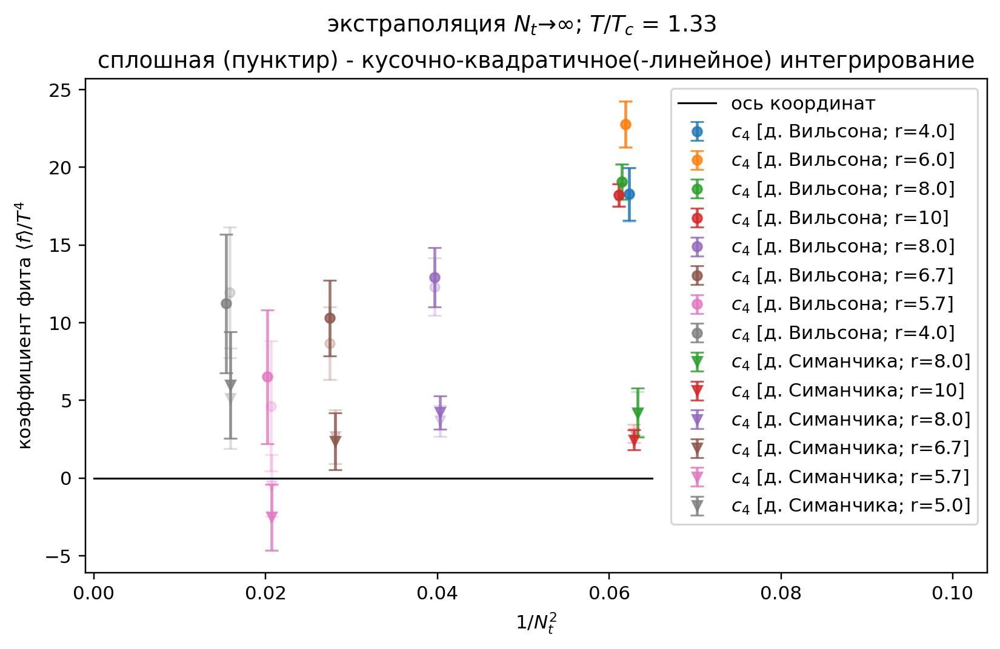

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.21; p = 0.065
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.97; p = 0.421
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.93; p = 0.032
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.26; p = 0.287
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.27; p = 0.844
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.37; p = 0.694
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.61; p = 0.435
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.75; p = 0.520
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 1.02; p = 0.362
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.34; p = 0.246


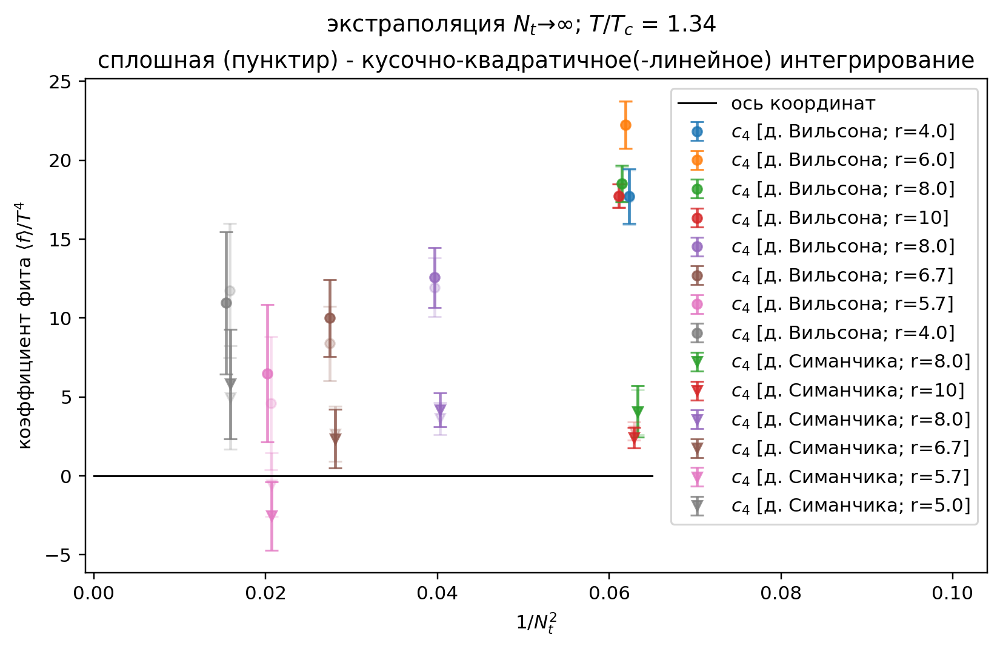

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.13; p = 0.074
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.95; p = 0.434
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.84; p = 0.037
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.23; p = 0.298
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.865
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.32; p = 0.725
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.52; p = 0.471
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.72; p = 0.540
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.96; p = 0.382
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.24; p = 0.266


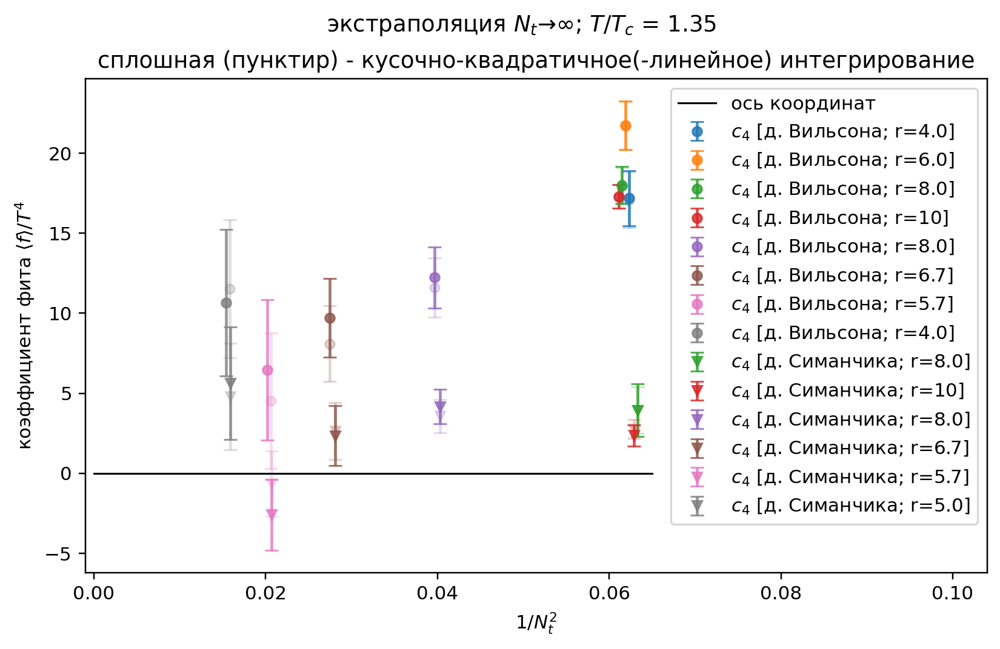

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.06; p = 0.083
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.93; p = 0.445
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.75; p = 0.041
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.20; p = 0.307
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.885
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.28; p = 0.755
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.44; p = 0.507
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.68; p = 0.562
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.91; p = 0.403
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.14; p = 0.286


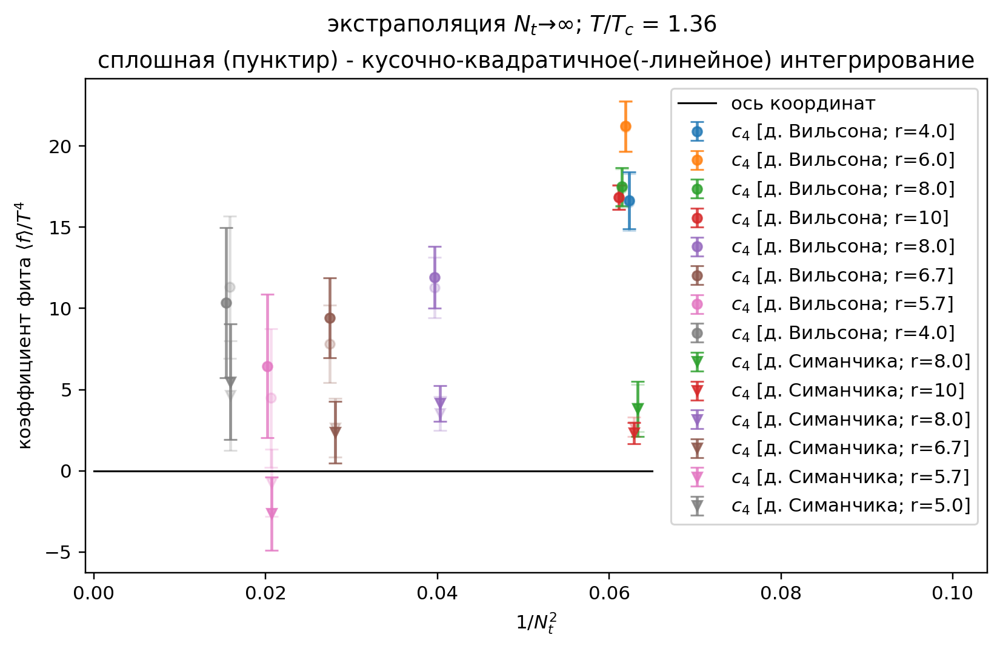

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.01; p = 0.091
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.92; p = 0.453
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.67; p = 0.046
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.19; p = 0.314
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.904
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.785
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.37; p = 0.543
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.65; p = 0.584
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.86; p = 0.424
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 1.05; p = 0.306


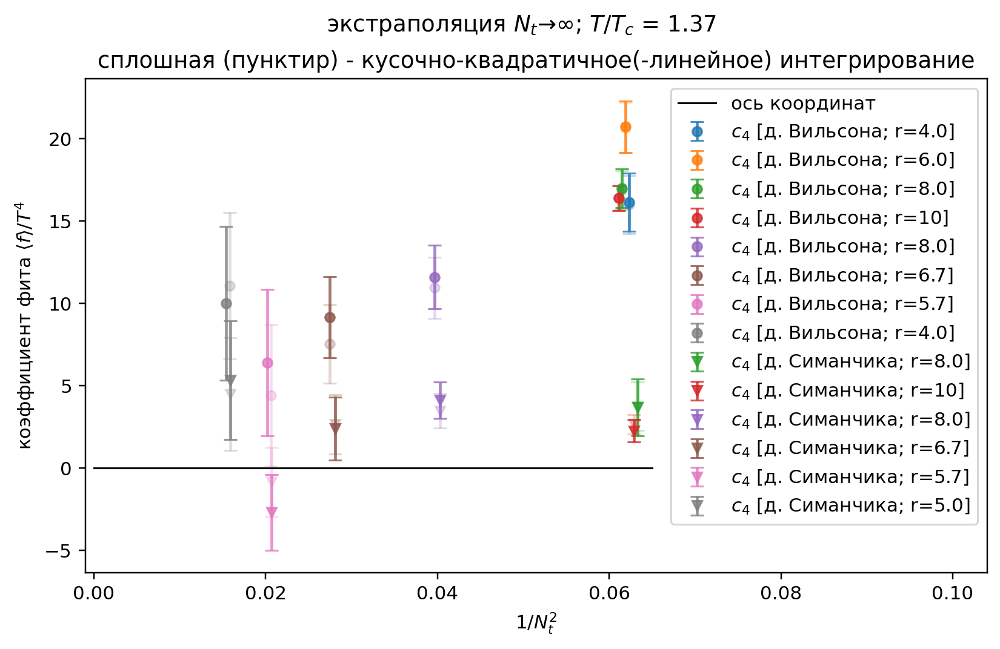

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.96; p = 0.098
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.91; p = 0.458
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.61; p = 0.050
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.17; p = 0.318
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.16; p = 0.921
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.21; p = 0.813
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.31; p = 0.579
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.61; p = 0.607
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.81; p = 0.447
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.96; p = 0.326


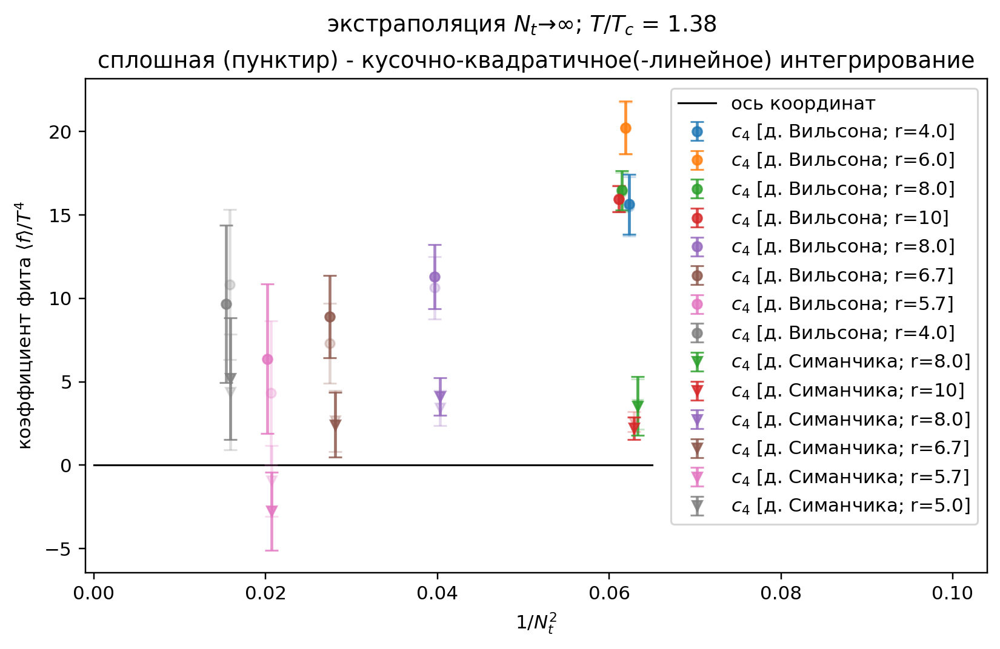

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.92; p = 0.104
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.90; p = 0.461
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.56; p = 0.053
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.17; p = 0.320
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.14; p = 0.937
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.17; p = 0.841
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.25; p = 0.615
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.58; p = 0.631
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.76; p = 0.470
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.89; p = 0.346


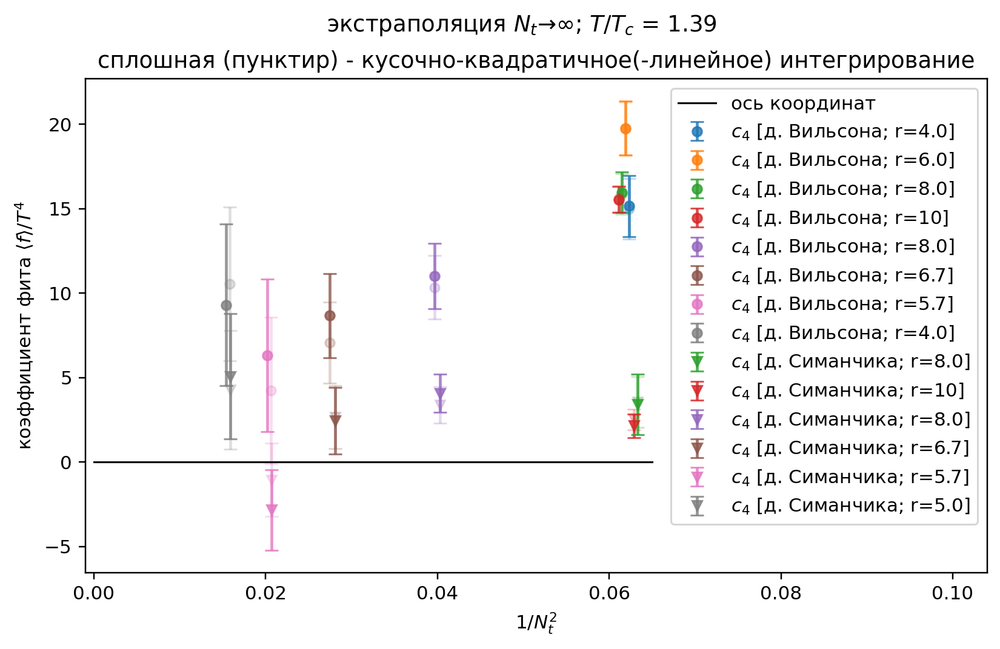

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.89; p = 0.109
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.90; p = 0.462
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.52; p = 0.056
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.17; p = 0.320
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.12; p = 0.951
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.14; p = 0.867
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.21; p = 0.649
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.54; p = 0.655
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.71; p = 0.494
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.82; p = 0.364


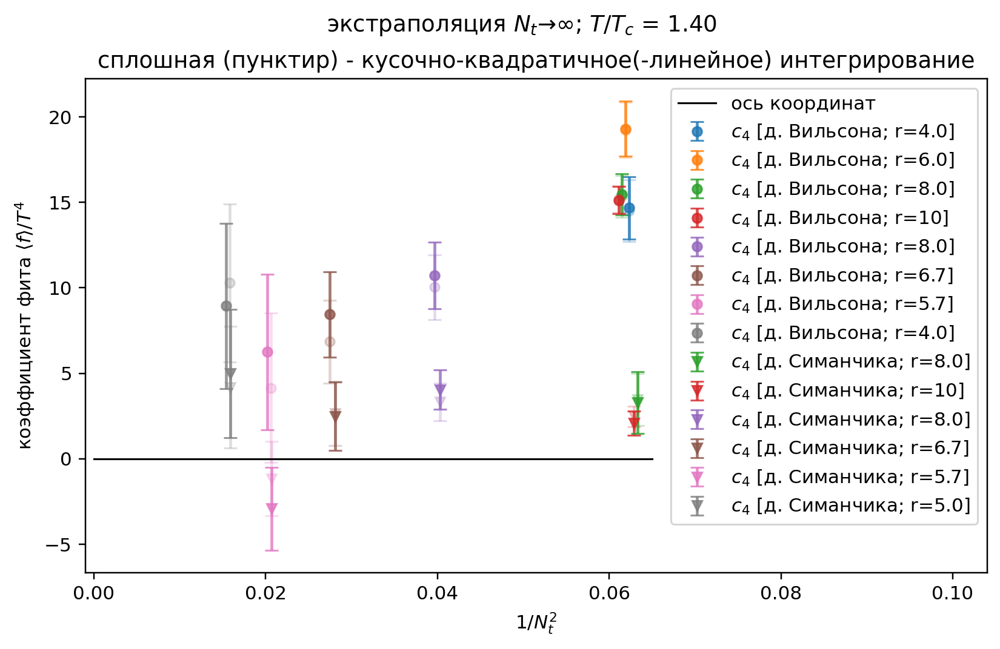

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.87; p = 0.112
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.90; p = 0.461
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.50; p = 0.058
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.17; p = 0.319
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.09; p = 0.963
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.12; p = 0.891
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.17; p = 0.683
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.50; p = 0.680
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.66; p = 0.518
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.76; p = 0.382


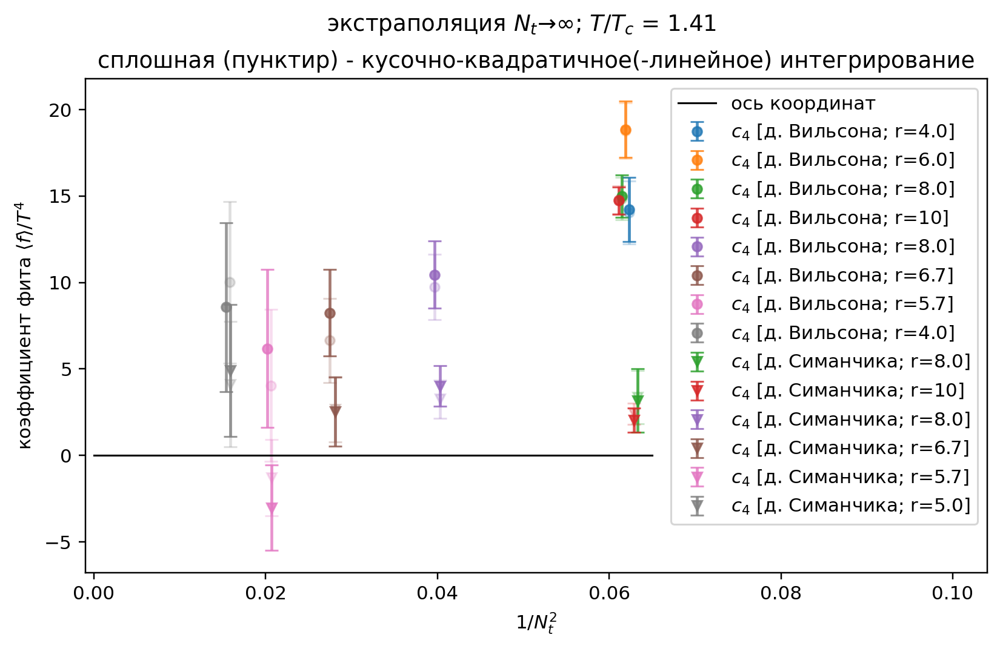

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.87; p = 0.113
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.91; p = 0.458
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.49; p = 0.059
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.18; p = 0.315
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.08; p = 0.973
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.09; p = 0.912
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.13; p = 0.715
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.47; p = 0.705
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.61; p = 0.543
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.71; p = 0.399


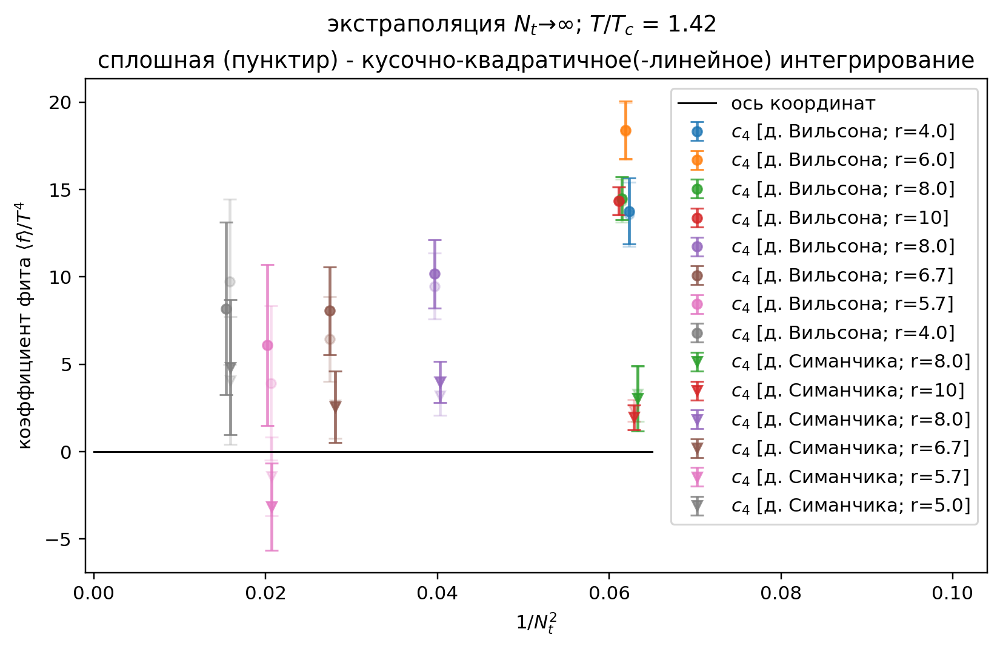

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.87; p = 0.113
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.92; p = 0.453
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.49; p = 0.058
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.19; p = 0.310
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.06; p = 0.981
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.07; p = 0.932
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.11; p = 0.746
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.43; p = 0.729
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.57; p = 0.568
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.66; p = 0.415


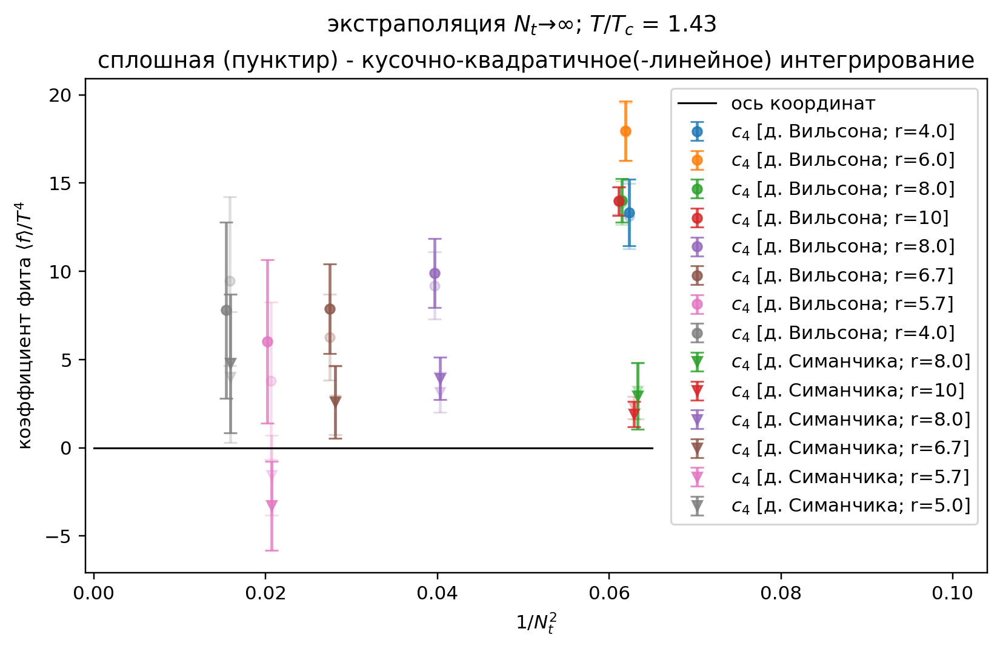

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.88; p = 0.111
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.93; p = 0.447
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.50; p = 0.057
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.21; p = 0.304
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.05; p = 0.987
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.05; p = 0.949
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.08; p = 0.774
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.40; p = 0.752
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.52; p = 0.593
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.62; p = 0.430


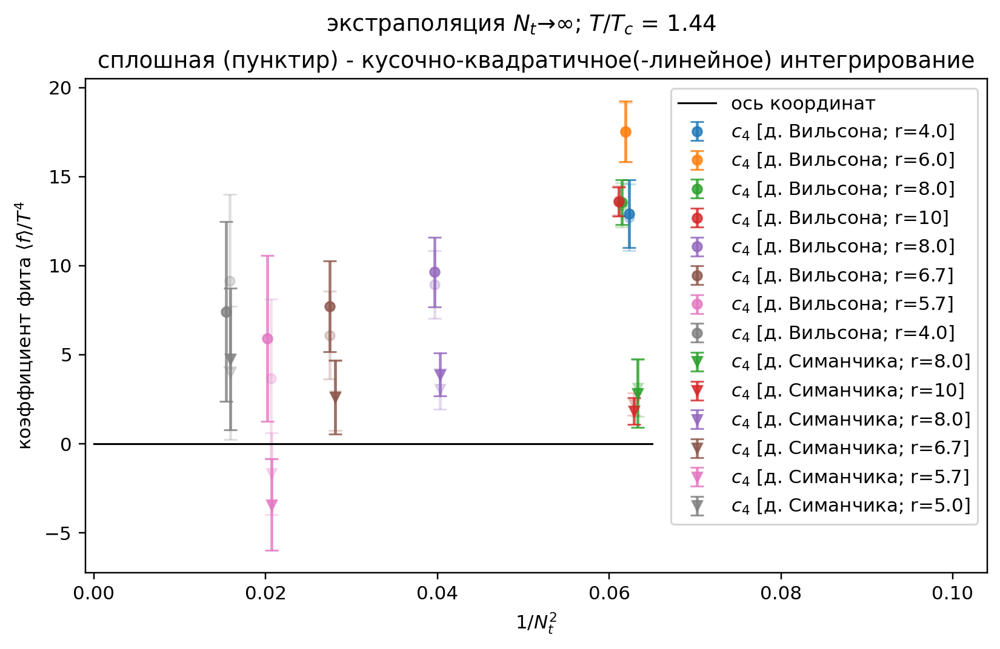

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.90; p = 0.108
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.94; p = 0.440
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.53; p = 0.056
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.23; p = 0.298
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.03; p = 0.992
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.04; p = 0.963
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.06; p = 0.801
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.37; p = 0.774
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.48; p = 0.618
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.59; p = 0.444


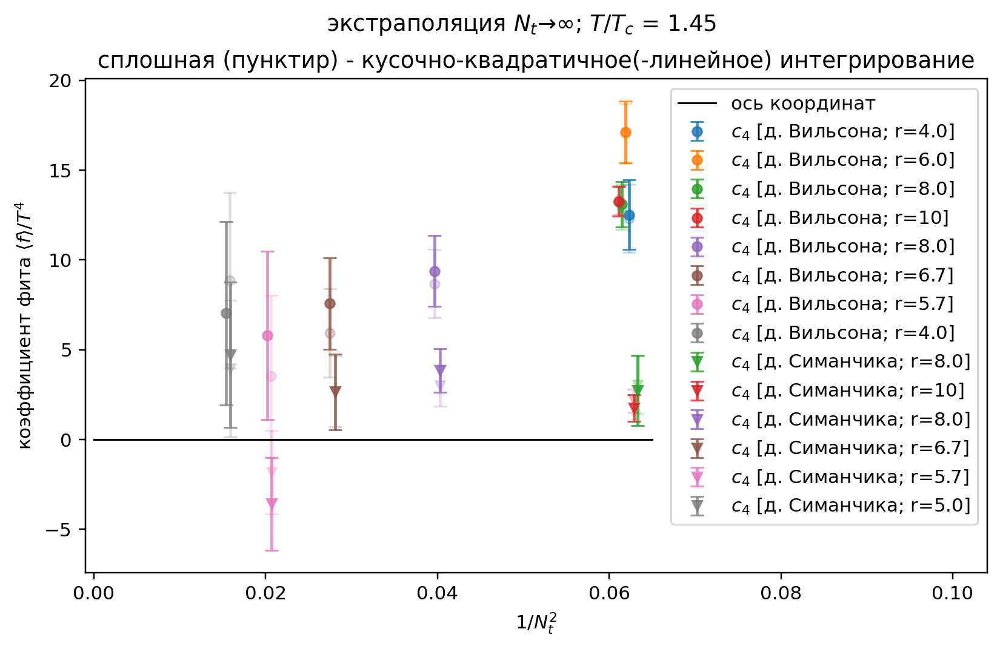

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.92; p = 0.104
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.95; p = 0.432
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.55; p = 0.054
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.25; p = 0.291
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.03; p = 0.995
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.03; p = 0.974
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.05; p = 0.825
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.34; p = 0.795
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.44; p = 0.642
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.55; p = 0.457


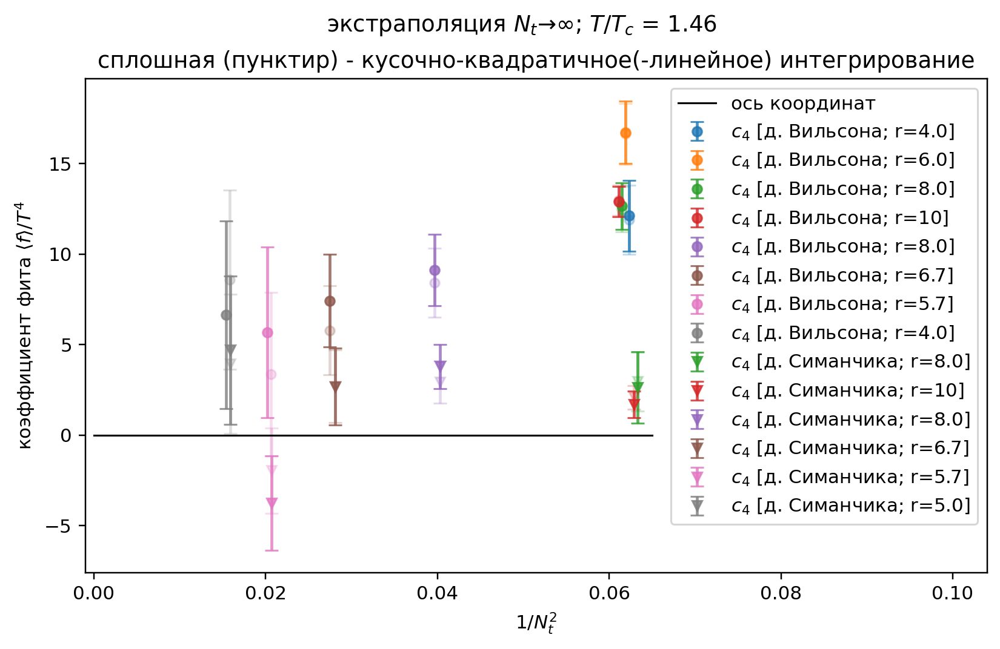

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.94; p = 0.100
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.97; p = 0.424
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.59; p = 0.051
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.27; p = 0.284
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.02; p = 0.996
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.02; p = 0.981
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.04; p = 0.847
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.32; p = 0.814
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.41; p = 0.666
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.53; p = 0.468


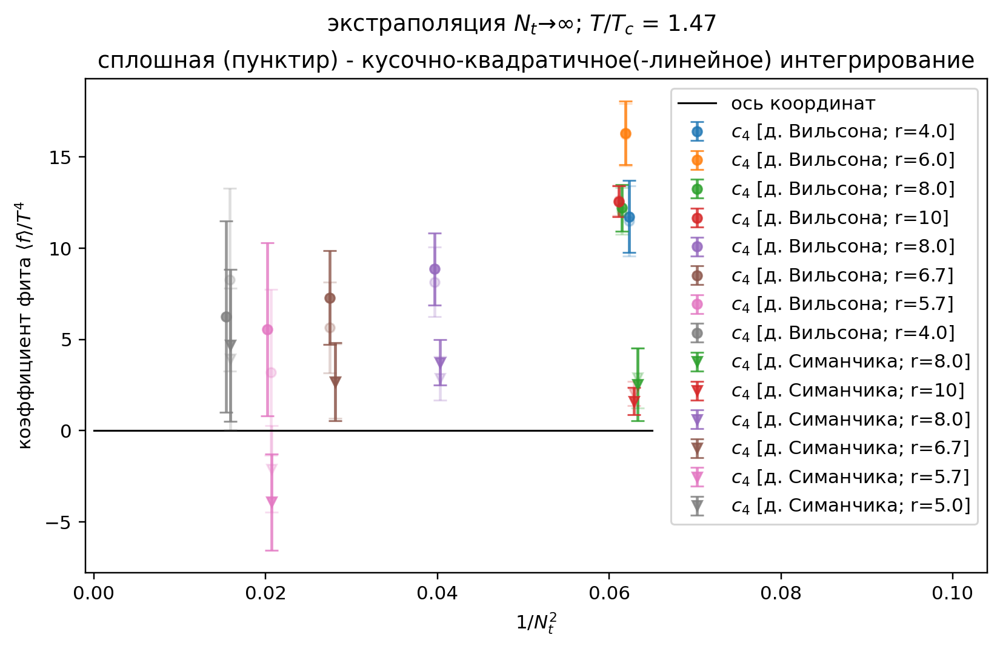

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.97; p = 0.096
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.98; p = 0.416
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.62; p = 0.049
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.29; p = 0.277
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.02; p = 0.997
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.01; p = 0.985
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.03; p = 0.866
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.29; p = 0.831
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.37; p = 0.687
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.51; p = 0.477


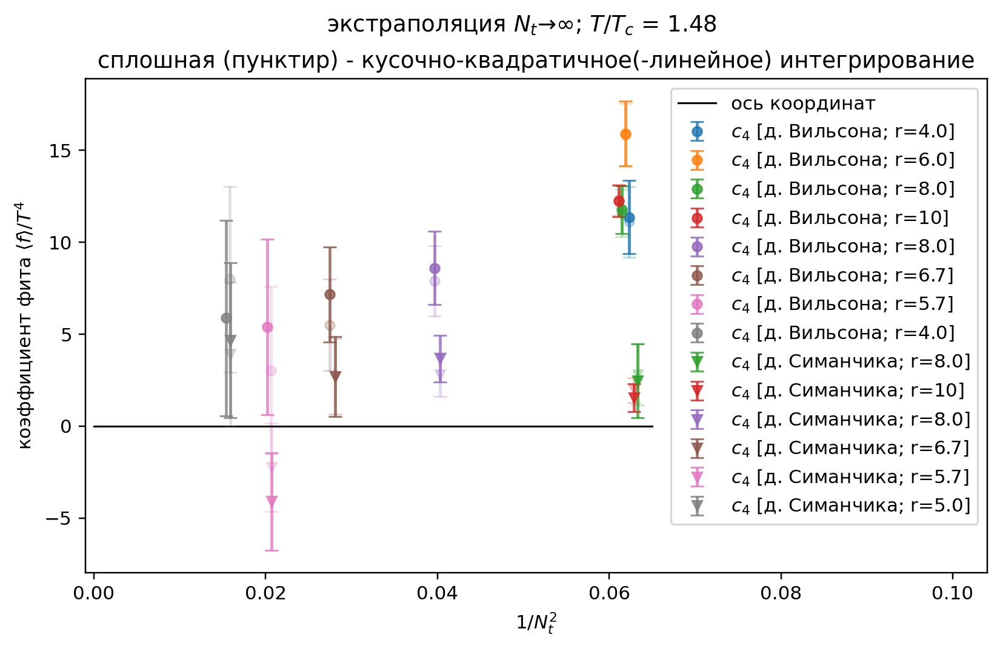

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.99; p = 0.093
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.99; p = 0.409
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.65; p = 0.047
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.31; p = 0.271
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.01; p = 0.998
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.01; p = 0.986
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.02; p = 0.883
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.27; p = 0.847
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.35; p = 0.708
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.49; p = 0.485


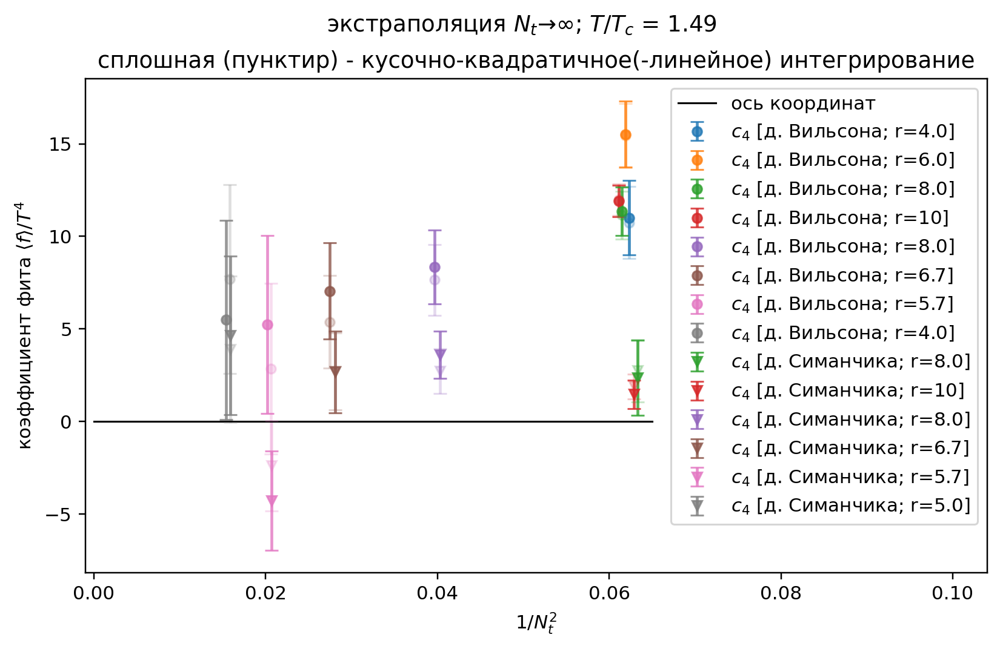

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.02; p = 0.089
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.01; p = 0.403
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.69; p = 0.045
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.32; p = 0.265
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.02; p = 0.997
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.02; p = 0.983
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.02; p = 0.897
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.860
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.32; p = 0.726
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.47; p = 0.492


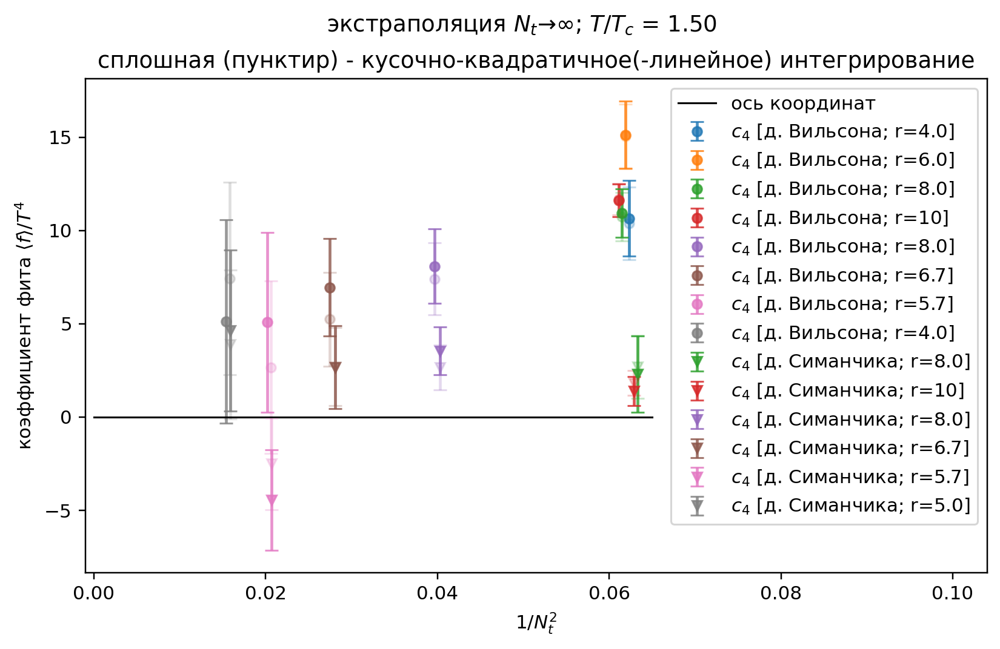

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.04; p = 0.086
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.01; p = 0.398
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.71; p = 0.043
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.34; p = 0.261
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.02; p = 0.996
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.02; p = 0.977
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.909
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.24; p = 0.872
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.30; p = 0.742
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.46; p = 0.497


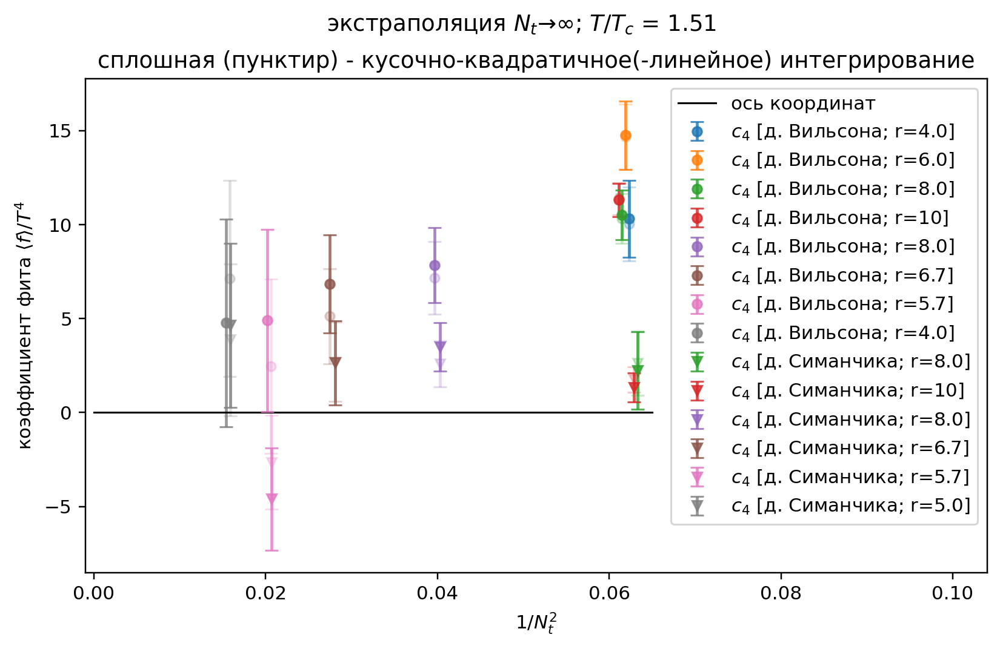

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.06; p = 0.084
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.02; p = 0.394
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.74; p = 0.042
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.35; p = 0.257
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.03; p = 0.994
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.03; p = 0.969
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.918
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.881
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.28; p = 0.756
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.45; p = 0.501


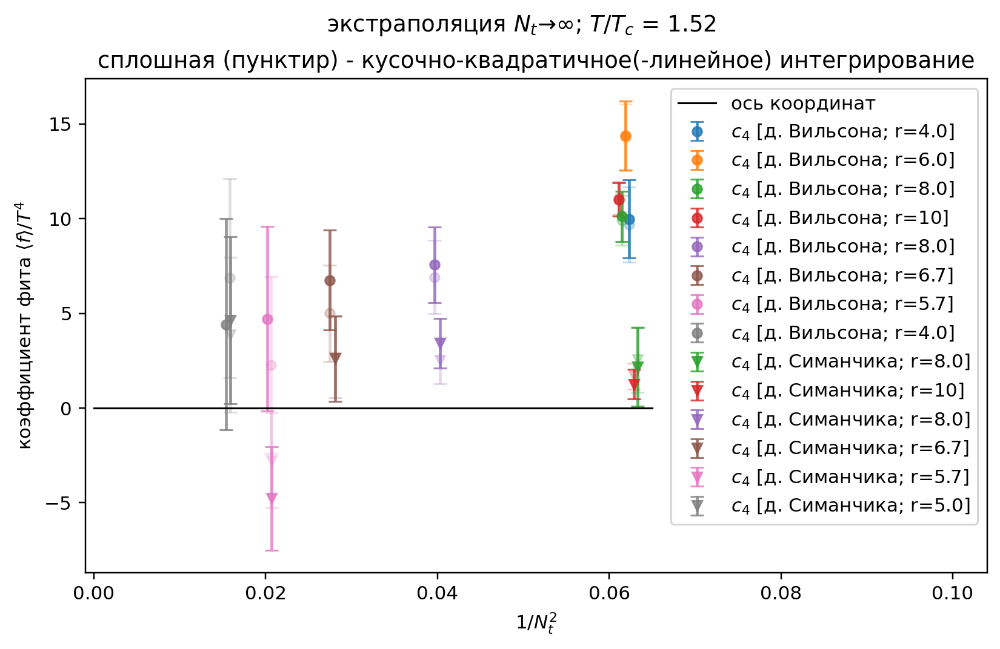

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.07; p = 0.082
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.03; p = 0.392
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.76; p = 0.041
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.35; p = 0.255
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.03; p = 0.991
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.04; p = 0.957
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.924
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.21; p = 0.889
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.26; p = 0.767
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.45; p = 0.503


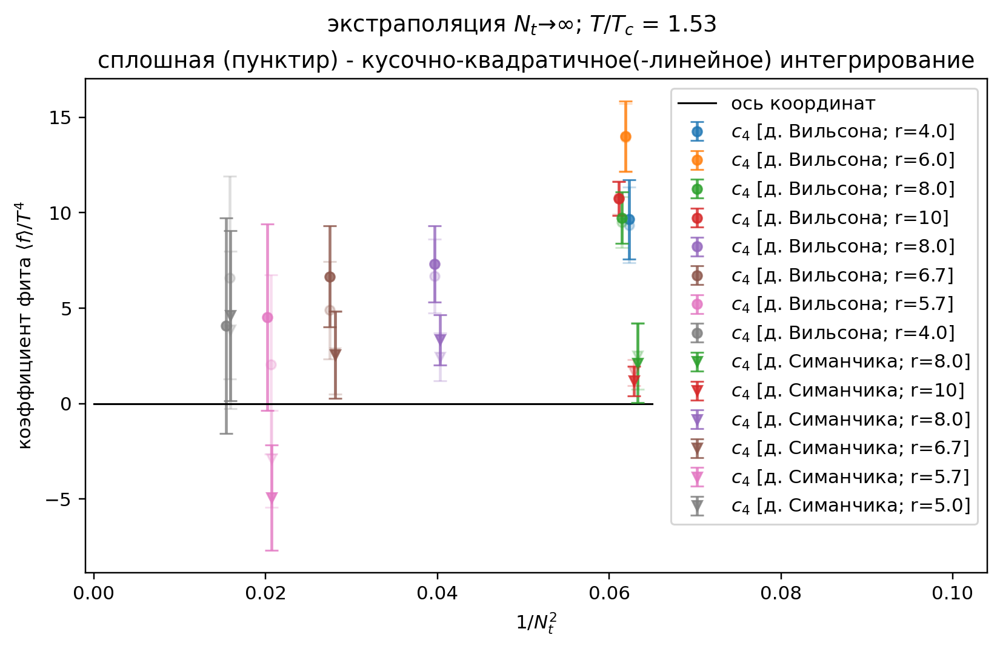

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.08; p = 0.081
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.03; p = 0.391
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.77; p = 0.040
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.36; p = 0.254
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.04; p = 0.987
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.06; p = 0.943
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.929
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.895
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.25; p = 0.776
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.45; p = 0.504


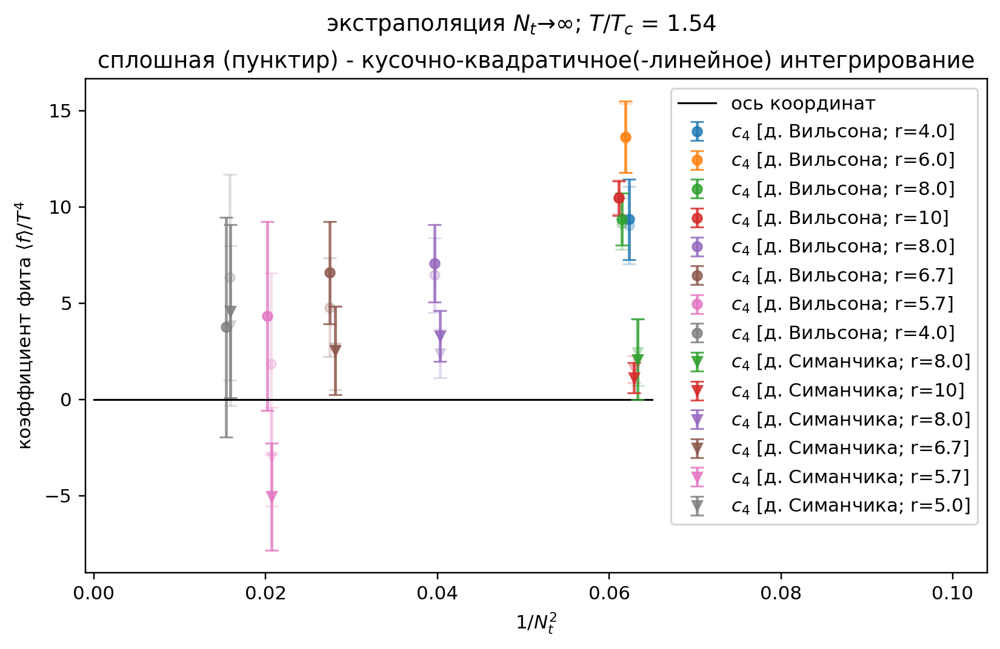

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.08; p = 0.080
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.03; p = 0.392
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.78; p = 0.040
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.36; p = 0.254
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.06; p = 0.982
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.08; p = 0.927
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.931
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.900
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.783
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.45; p = 0.504


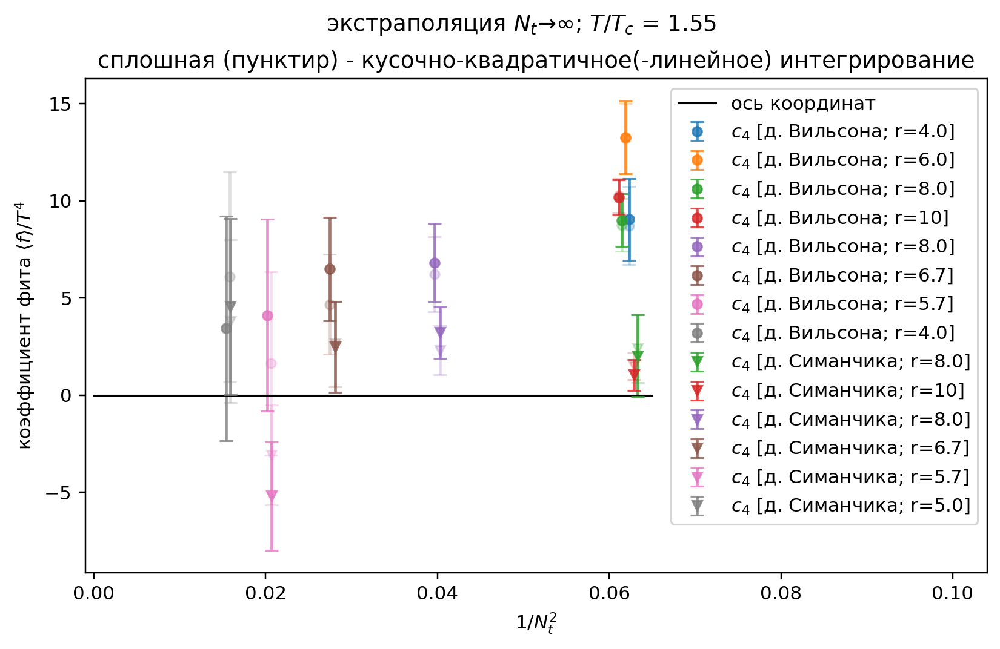

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.08; p = 0.080
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.02; p = 0.394
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.77; p = 0.040
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.35; p = 0.256
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.07; p = 0.976
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.09; p = 0.910
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.932
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.903
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.788
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.45; p = 0.503


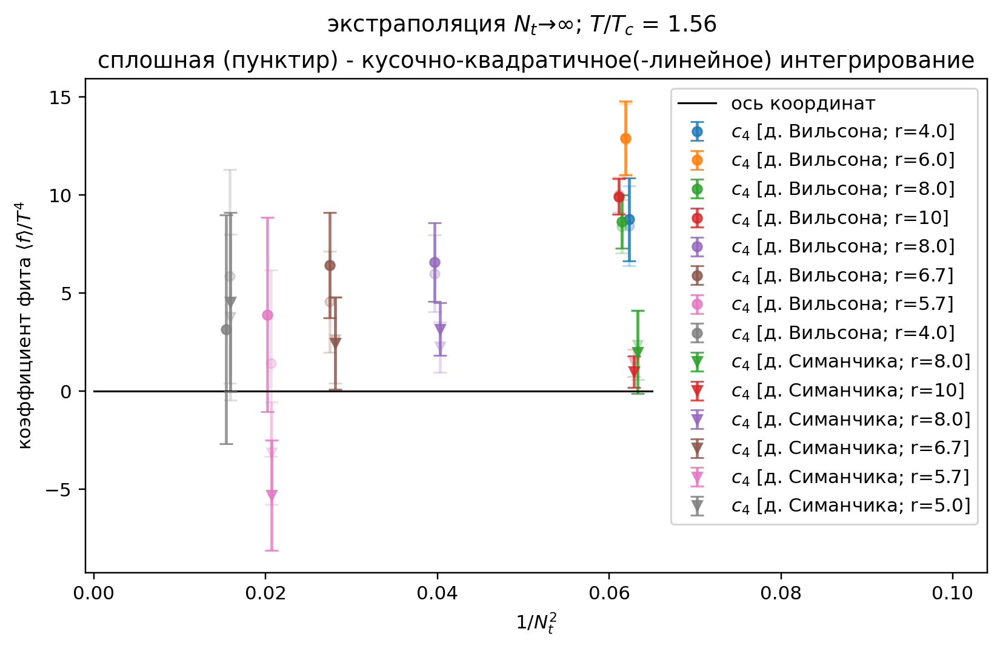

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.07; p = 0.082
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.01; p = 0.399
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.76; p = 0.041
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.34; p = 0.259
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.08; p = 0.969
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.11; p = 0.892
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.931
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.904
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.790
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.45; p = 0.501


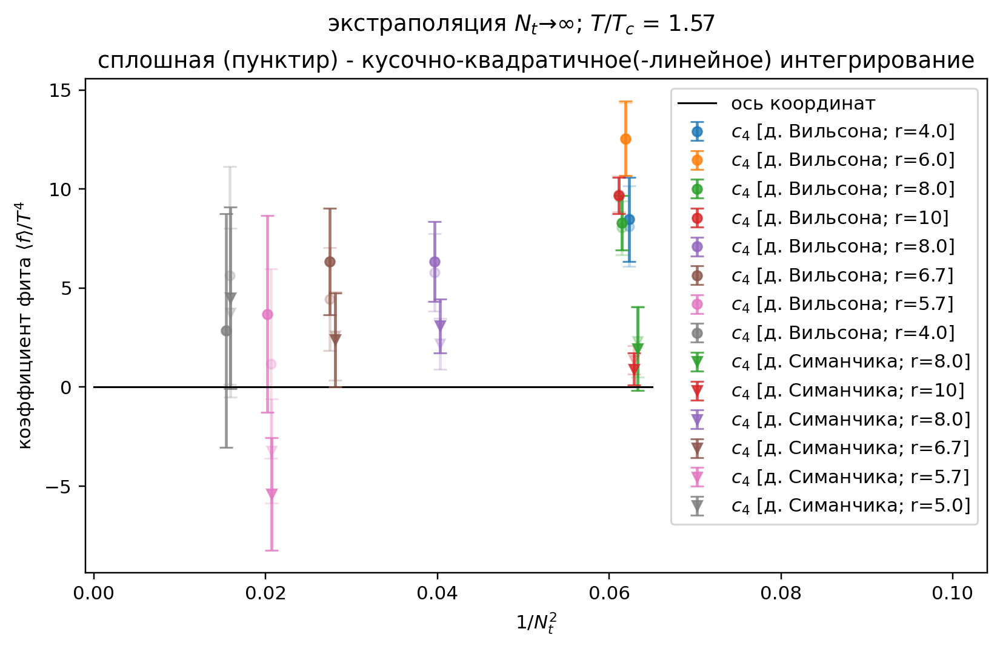

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.06; p = 0.084
[t] Symanzik c4 constant extrapolation: chi2/dof = 1.00; p = 0.405
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.74; p = 0.042
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.33; p = 0.264
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.10; p = 0.961
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.13; p = 0.874
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.928
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.905
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.23; p = 0.791
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.46; p = 0.498


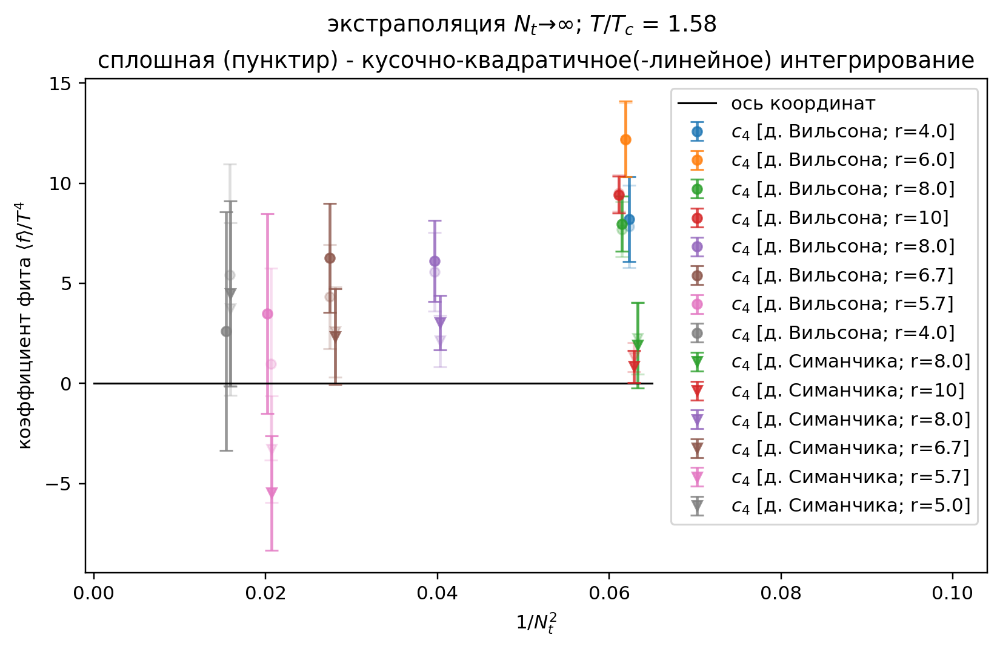

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.03; p = 0.087
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.99; p = 0.414
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.71; p = 0.044
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.31; p = 0.270
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.11; p = 0.952
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.16; p = 0.856
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.923
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.905
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.790
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.47; p = 0.495


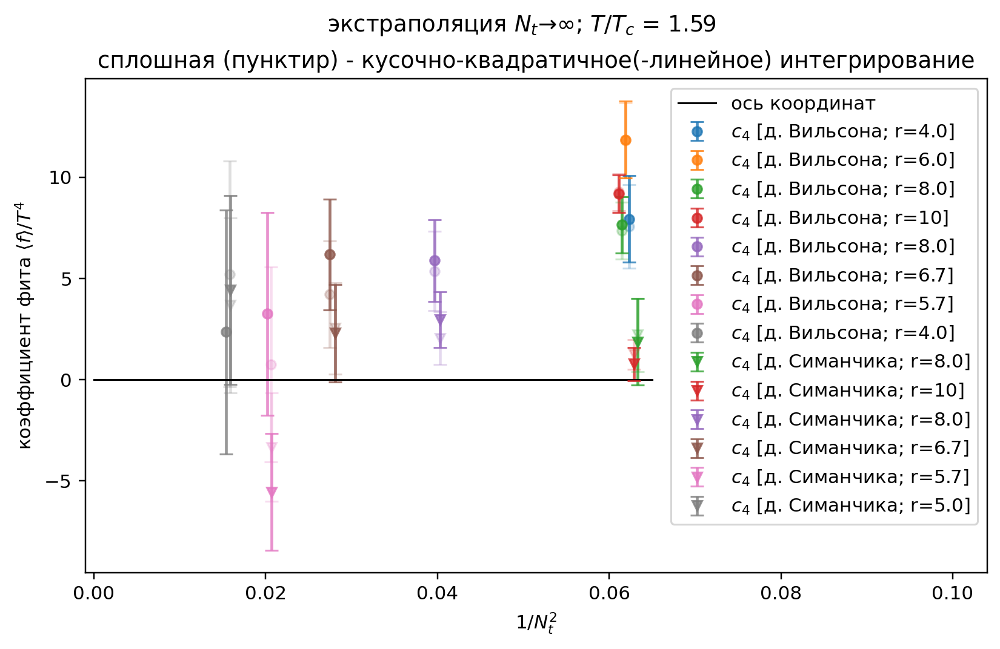

[q] Symanzik c4 constant extrapolation: chi2/dof = 2.01; p = 0.091
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.97; p = 0.424
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.67; p = 0.046
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.28; p = 0.278
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.13; p = 0.943
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.18; p = 0.838
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.917
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.904
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.787
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.48; p = 0.490


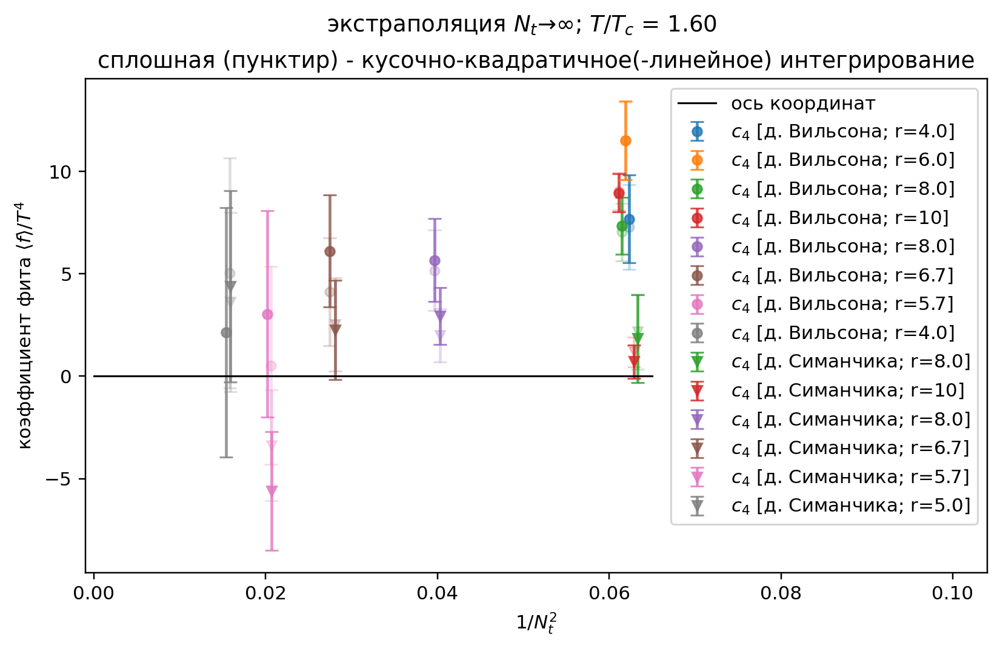

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.98; p = 0.095
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.95; p = 0.435
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.63; p = 0.048
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.26; p = 0.287
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.14; p = 0.934
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.20; p = 0.820
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.01; p = 0.909
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.902
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.784
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.49; p = 0.486


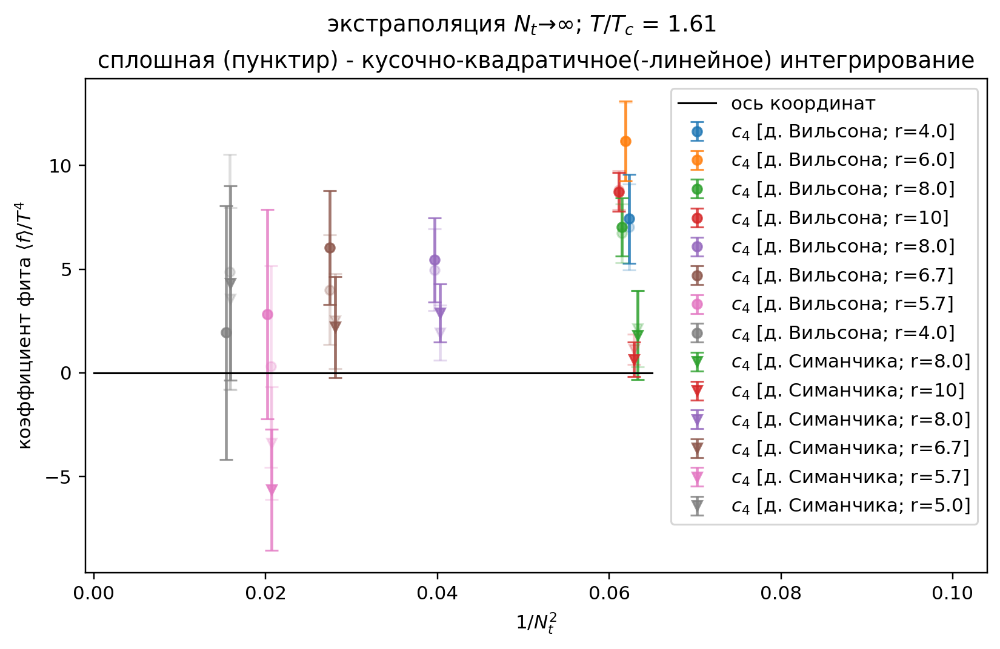

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.95; p = 0.100
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.93; p = 0.448
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.59; p = 0.051
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.23; p = 0.297
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.16; p = 0.924
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.22; p = 0.804
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.02; p = 0.900
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.899
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.25; p = 0.779
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.50; p = 0.480


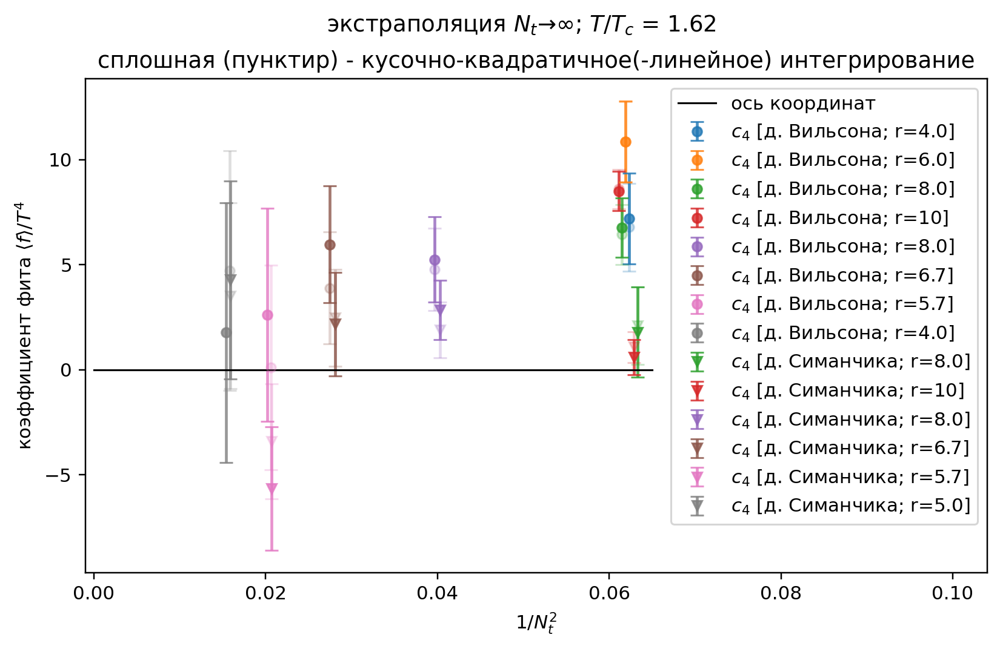

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.91; p = 0.105
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.90; p = 0.462
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.54; p = 0.054
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.20; p = 0.308
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.17; p = 0.915
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.789
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.02; p = 0.890
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.896
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.26; p = 0.774
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.51; p = 0.474


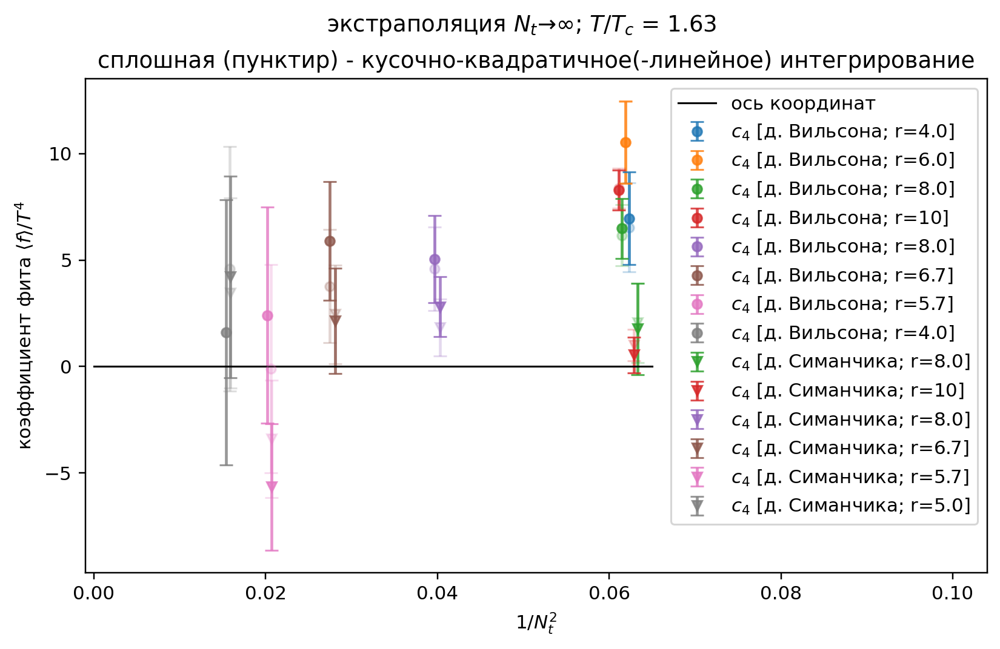

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.88; p = 0.111
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.88; p = 0.477
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.49; p = 0.058
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.17; p = 0.320
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.18; p = 0.907
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.25; p = 0.775
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.02; p = 0.879
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.21; p = 0.893
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.26; p = 0.768
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.53; p = 0.468


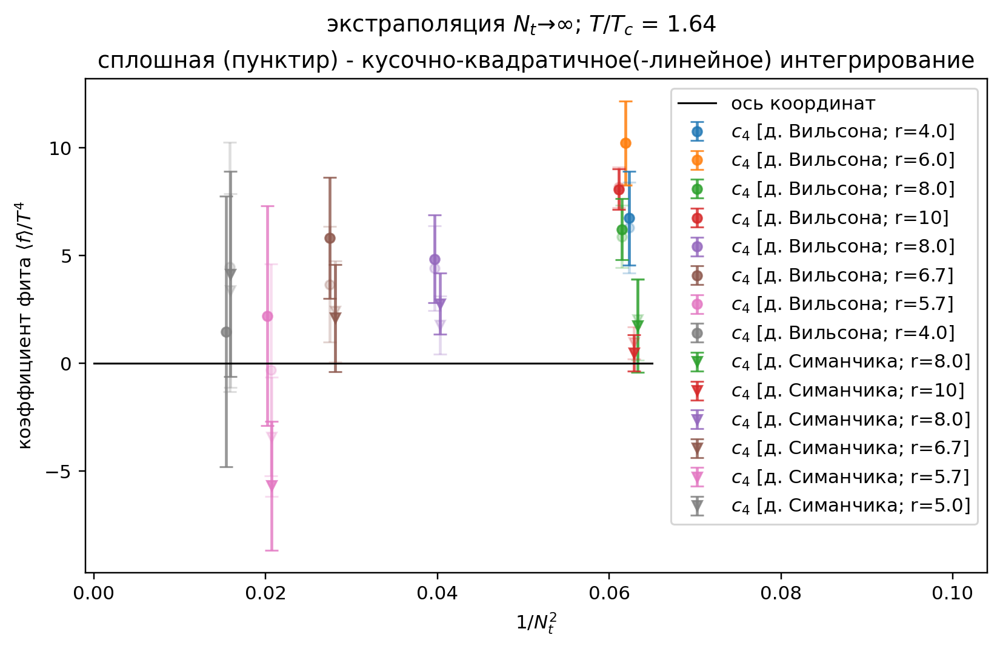

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.84; p = 0.118
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.85; p = 0.493
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.44; p = 0.062
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.13; p = 0.334
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.899
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.27; p = 0.763
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.03; p = 0.867
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.21; p = 0.889
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.27; p = 0.762
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.54; p = 0.461


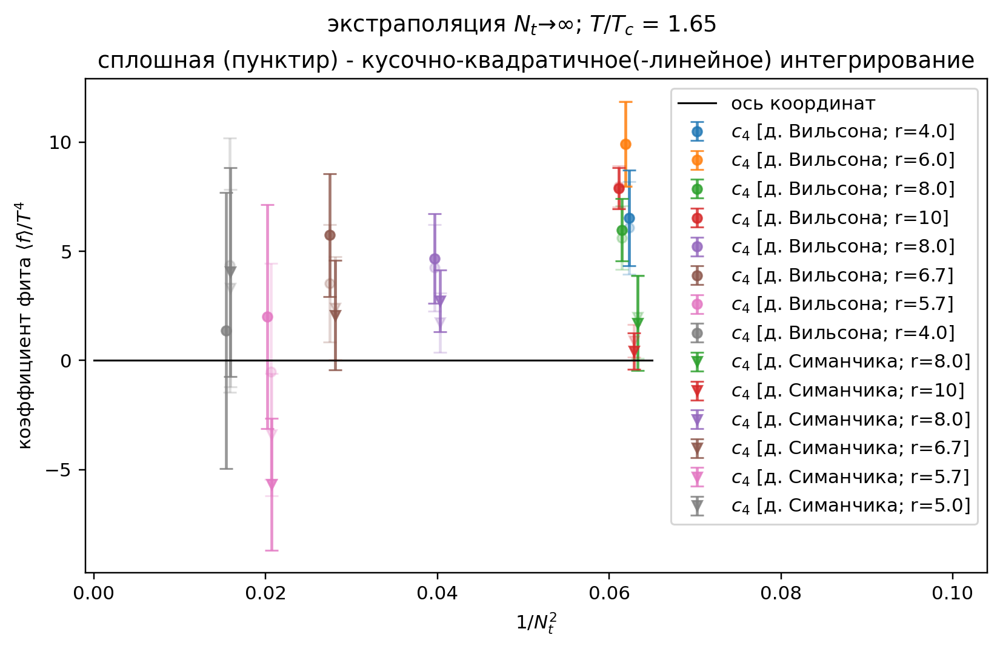

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.81; p = 0.124
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.83; p = 0.509
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.39; p = 0.066
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.10; p = 0.348
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.21; p = 0.892
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.28; p = 0.753
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.03; p = 0.854
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.885
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.28; p = 0.755
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.56; p = 0.454


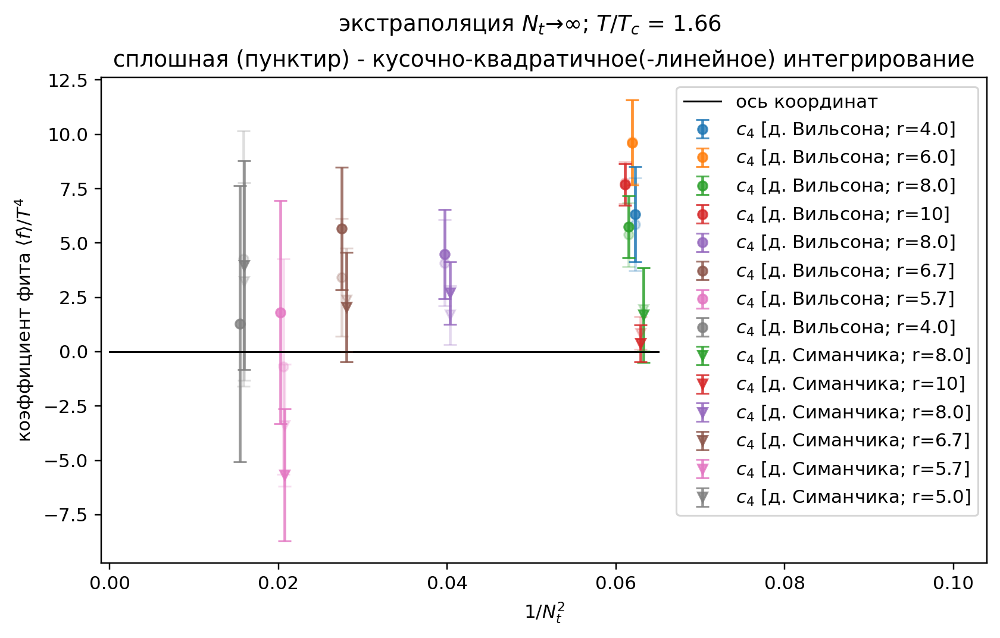

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.77; p = 0.131
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.80; p = 0.526
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.34; p = 0.071
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.06; p = 0.363
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.21; p = 0.886
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.29; p = 0.745
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.04; p = 0.841
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.881
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.29; p = 0.749
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.58; p = 0.448


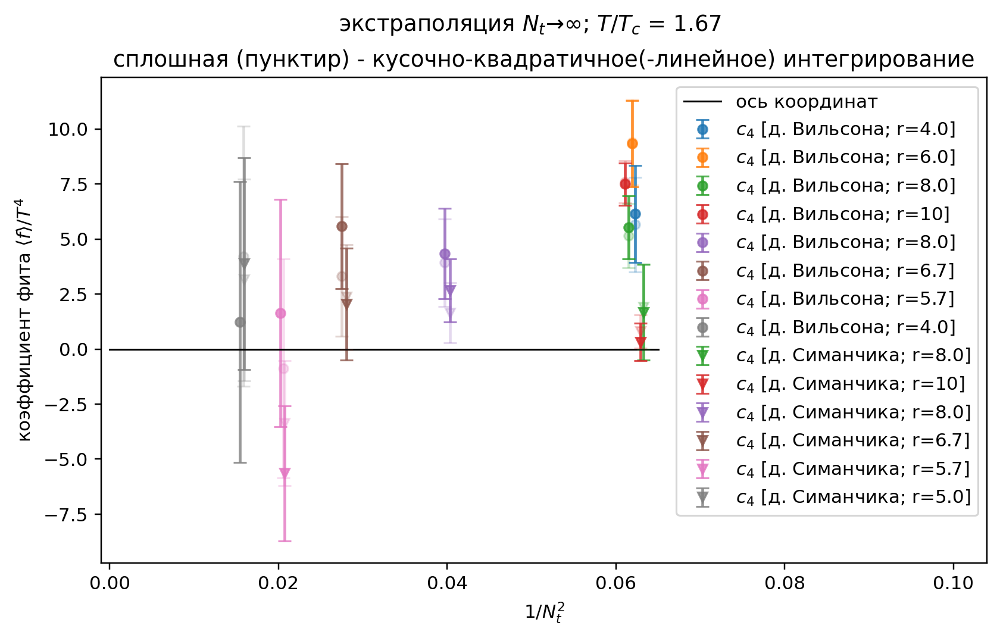

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.74; p = 0.138
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.77; p = 0.543
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.29; p = 0.076
[t] Symanzik c4 linear extrapolation: chi2/dof = 1.03; p = 0.378
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.881
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.30; p = 0.739
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.05; p = 0.828
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.23; p = 0.877
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.30; p = 0.743
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.59; p = 0.441


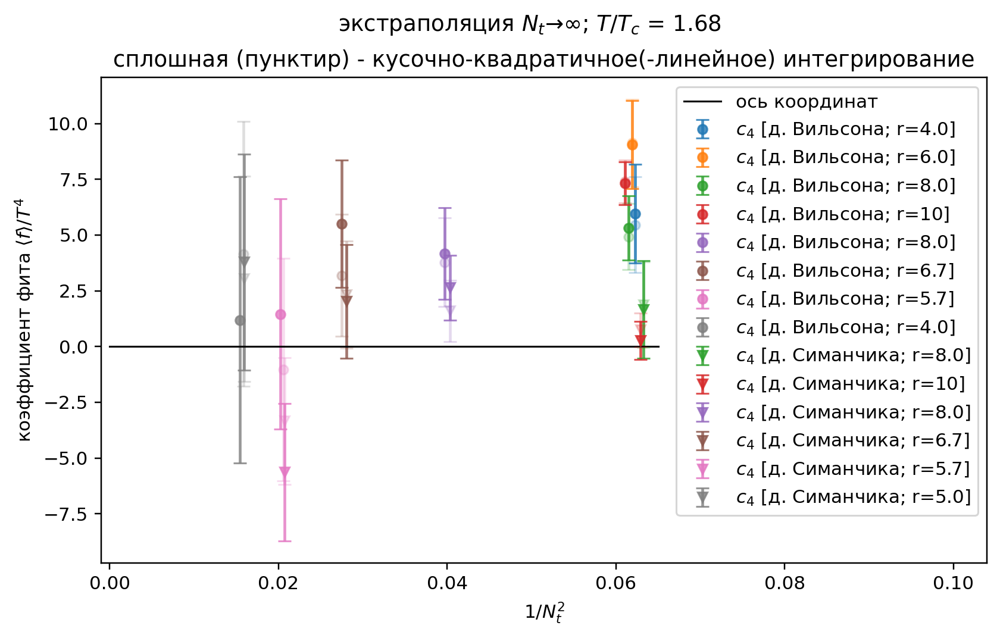

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.70; p = 0.146
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.75; p = 0.560
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.24; p = 0.081
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.99; p = 0.394
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.23; p = 0.878
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.31; p = 0.734
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.05; p = 0.815
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.23; p = 0.874
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.31; p = 0.737
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.61; p = 0.435


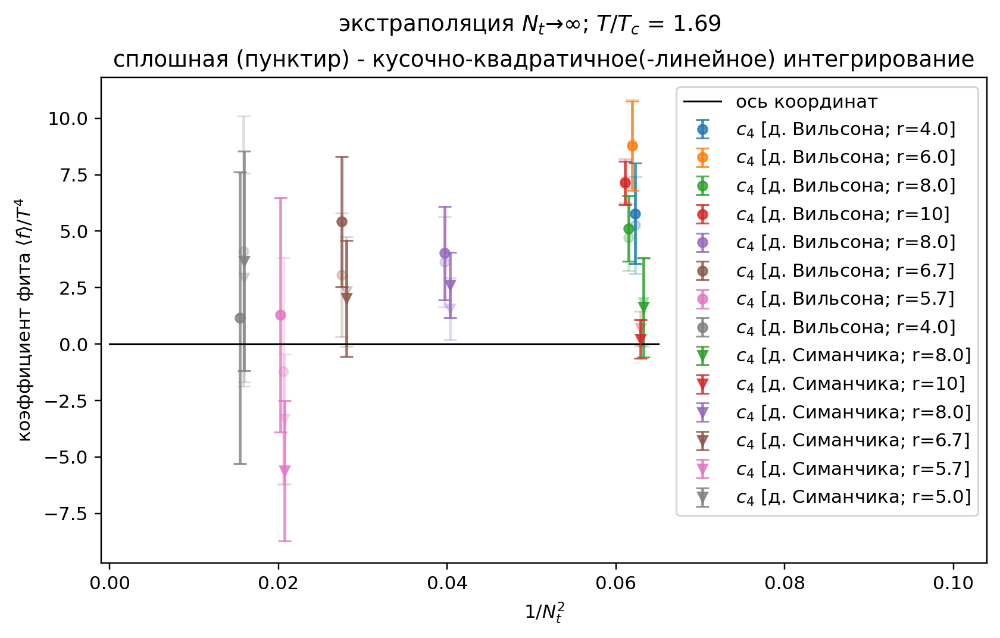

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.67; p = 0.153
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.72; p = 0.578
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.19; p = 0.086
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.96; p = 0.411
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.23; p = 0.876
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.31; p = 0.731
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.06; p = 0.803
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.24; p = 0.871
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.31; p = 0.732
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.62; p = 0.430


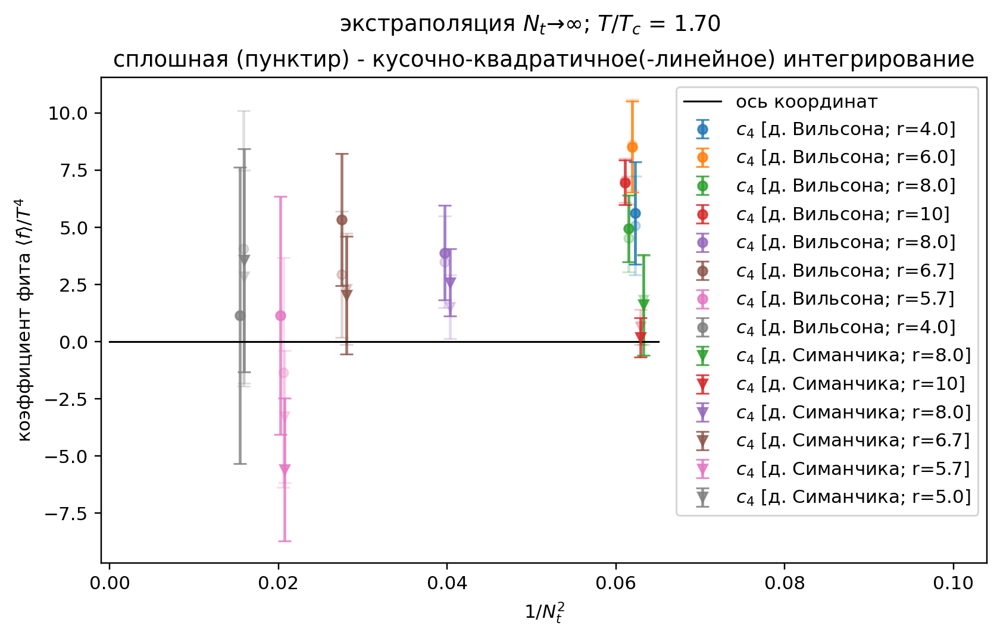

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.64; p = 0.161
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.70; p = 0.595
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.15; p = 0.092
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.93; p = 0.427
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.23; p = 0.875
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.31; p = 0.731
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.07; p = 0.791
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.24; p = 0.868
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.32; p = 0.727
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.64; p = 0.425


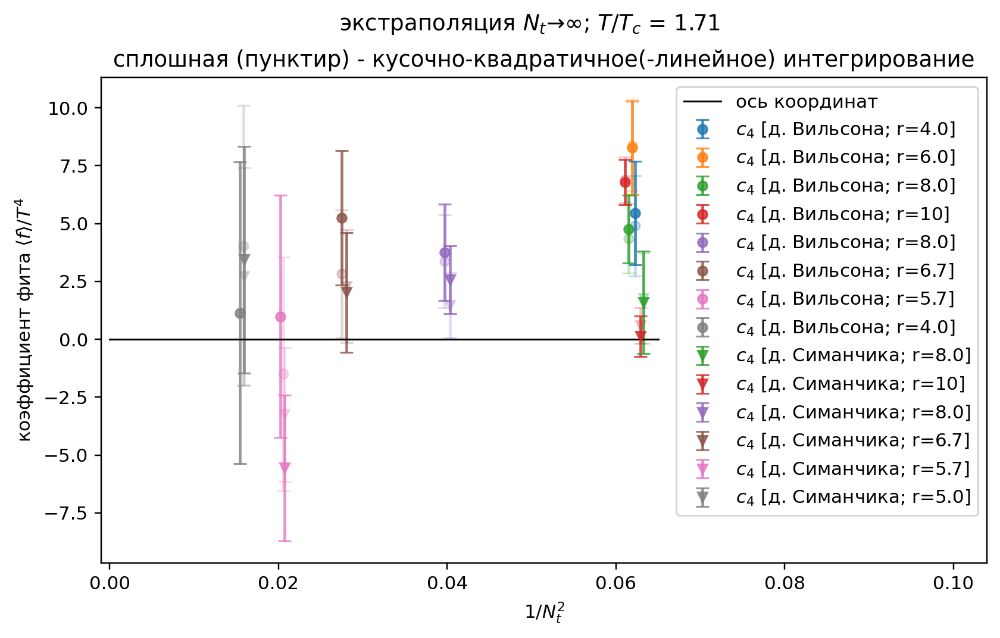

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.61; p = 0.169
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.67; p = 0.612
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.10; p = 0.098
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.89; p = 0.444
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.23; p = 0.875
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.31; p = 0.731
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.08; p = 0.779
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.24; p = 0.865
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.33; p = 0.722
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.65; p = 0.420


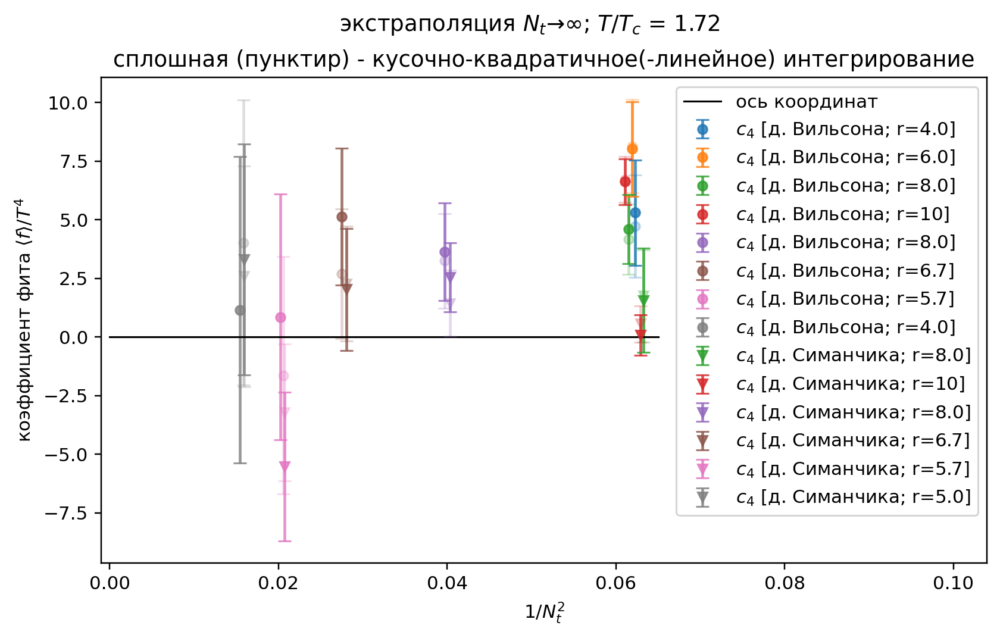

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.58; p = 0.177
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.65; p = 0.628
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.06; p = 0.103
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.86; p = 0.461
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.23; p = 0.877
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.31; p = 0.734
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.09; p = 0.768
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.863
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.33; p = 0.718
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.66; p = 0.416


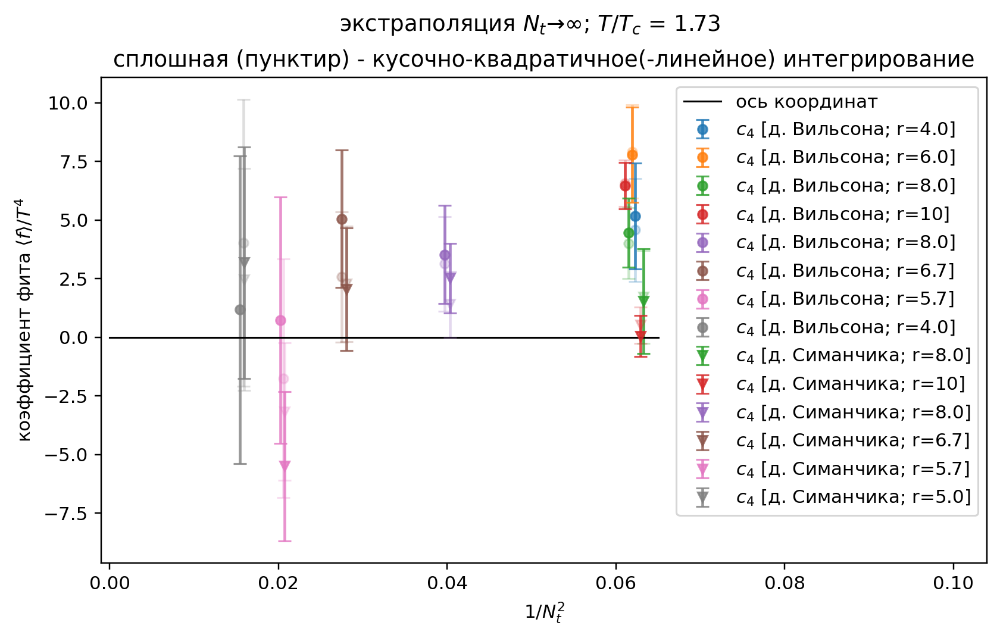

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.55; p = 0.184
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.63; p = 0.644
[q] Symanzik c4 linear extrapolation: chi2/dof = 2.02; p = 0.109
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.83; p = 0.477
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.880
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.30; p = 0.738
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.09; p = 0.758
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.861
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.34; p = 0.714
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.67; p = 0.412


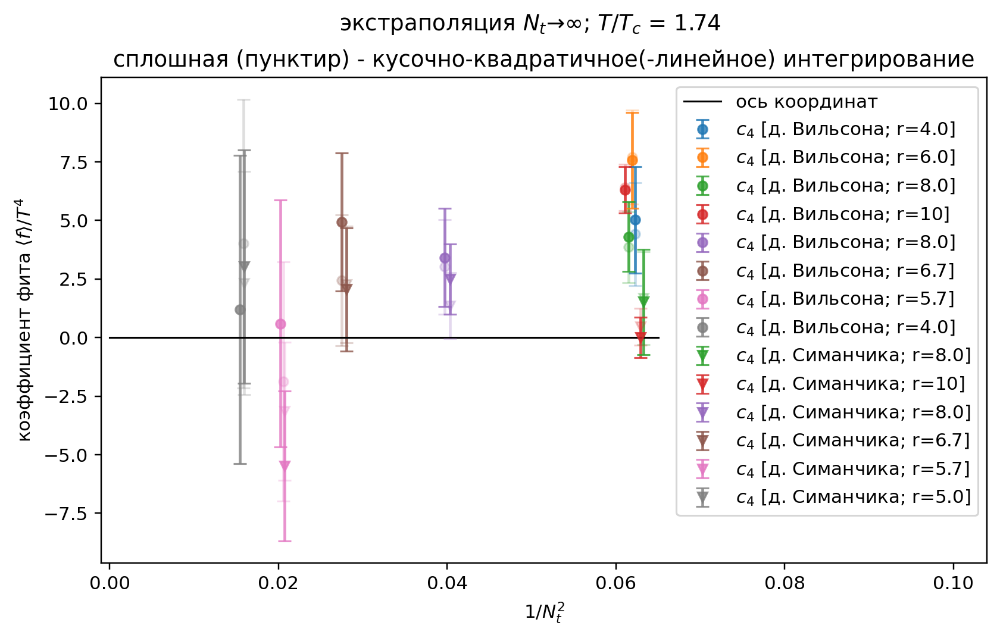

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.52; p = 0.192
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.61; p = 0.659
[q] Symanzik c4 linear extrapolation: chi2/dof = 1.98; p = 0.115
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.80; p = 0.493
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.22; p = 0.883
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.30; p = 0.743
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.10; p = 0.749
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.859
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.34; p = 0.711
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.68; p = 0.409


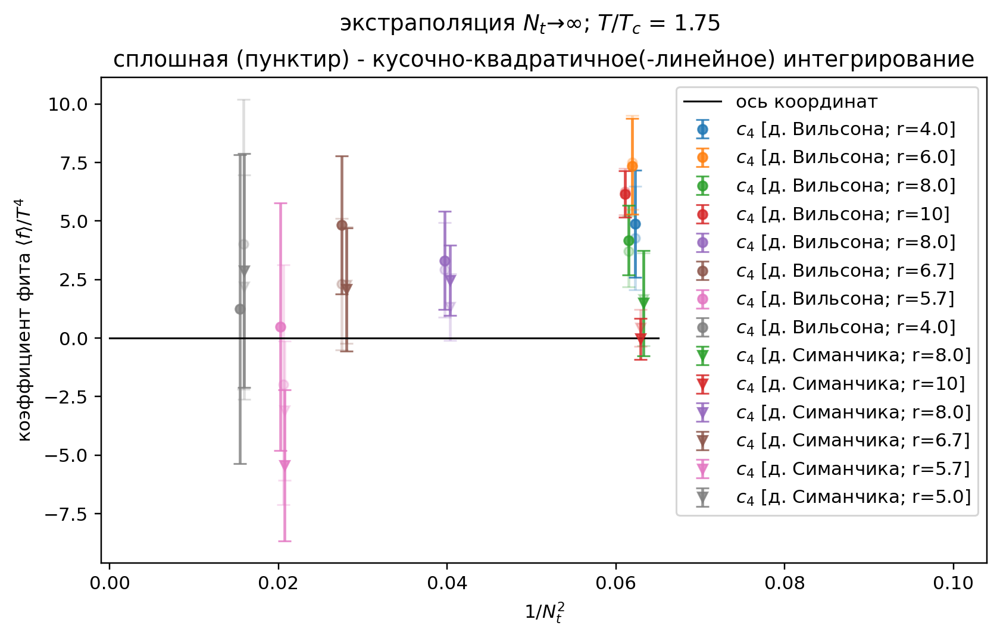

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.50; p = 0.199
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.59; p = 0.673
[q] Symanzik c4 linear extrapolation: chi2/dof = 1.94; p = 0.121
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.77; p = 0.508
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.21; p = 0.888
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.29; p = 0.750
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.11; p = 0.740
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.25; p = 0.858
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.35; p = 0.708
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.69; p = 0.406


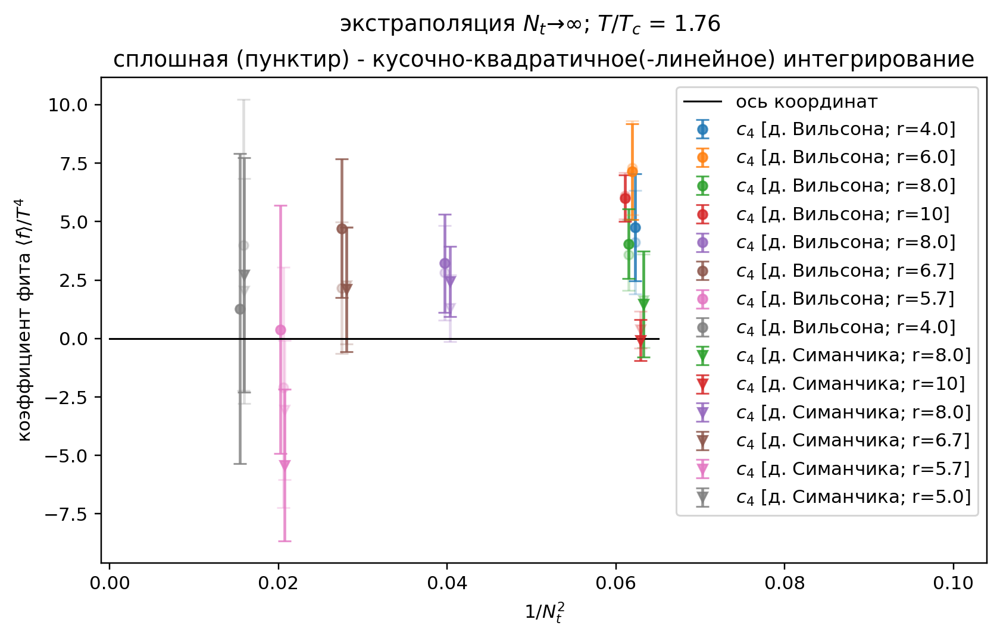

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.47; p = 0.207
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.57; p = 0.686
[q] Symanzik c4 linear extrapolation: chi2/dof = 1.90; p = 0.127
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.75; p = 0.523
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.893
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.28; p = 0.758
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.12; p = 0.733
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.857
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.35; p = 0.706
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.70; p = 0.404


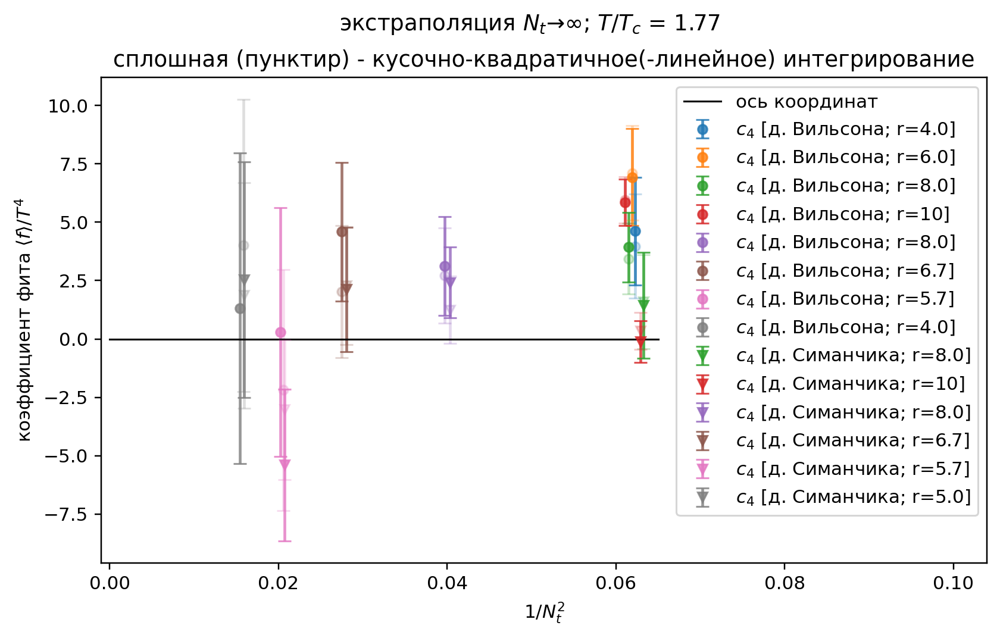

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.45; p = 0.214
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.55; p = 0.698
[q] Symanzik c4 linear extrapolation: chi2/dof = 1.87; p = 0.133
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.73; p = 0.537
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.20; p = 0.899
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.27; p = 0.767
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.12; p = 0.726
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.857
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.35; p = 0.703
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.70; p = 0.403


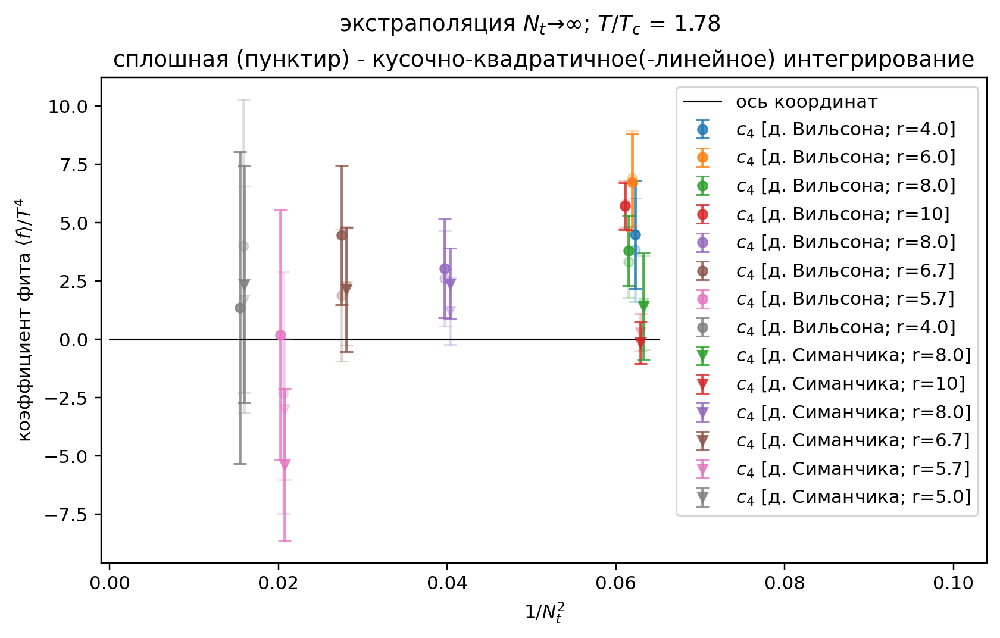

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.43; p = 0.222
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.54; p = 0.709
[q] Symanzik c4 linear extrapolation: chi2/dof = 1.83; p = 0.139
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.70; p = 0.550
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.19; p = 0.905
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.25; p = 0.776
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.13; p = 0.721
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.856
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.35; p = 0.702
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.70; p = 0.403


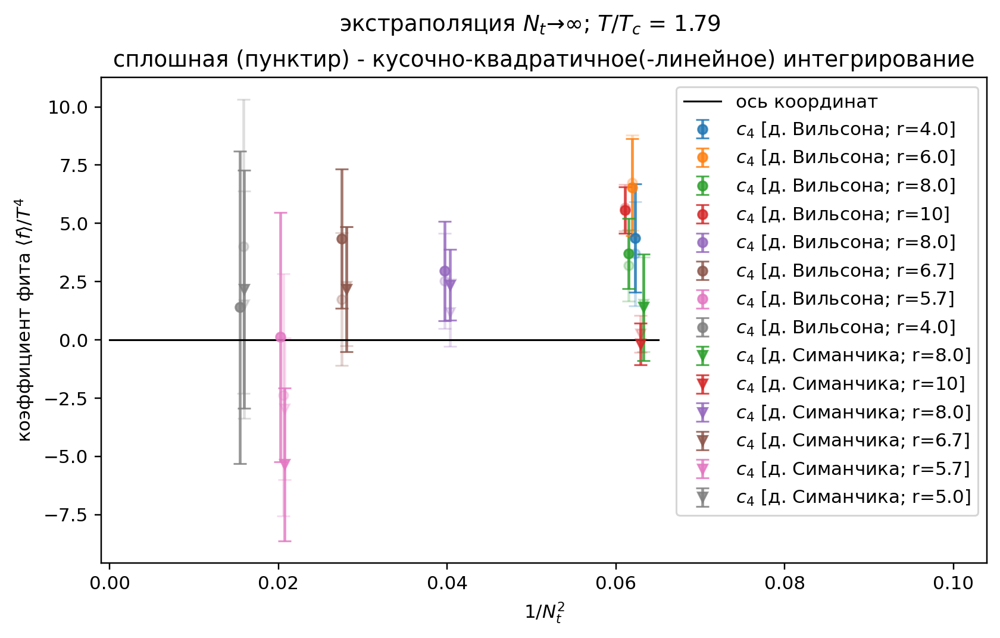

[q] Symanzik c4 constant extrapolation: chi2/dof = 1.40; p = 0.230
[t] Symanzik c4 constant extrapolation: chi2/dof = 0.52; p = 0.719
[q] Symanzik c4 linear extrapolation: chi2/dof = 1.80; p = 0.144
[t] Symanzik c4 linear extrapolation: chi2/dof = 0.68; p = 0.561
[q] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.18; p = 0.912
[q] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.24; p = 0.787
[q] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.13; p = 0.717
[t] Wilson c4 (nt = 4) linear extrapolation: chi2/dof = 0.26; p = 0.856
[t] Wilson c4 (nt = 5) linear extrapolation: chi2/dof = 0.36; p = 0.700
[t] Wilson c4 (nt = 6) linear extrapolation: chi2/dof = 0.70; p = 0.403


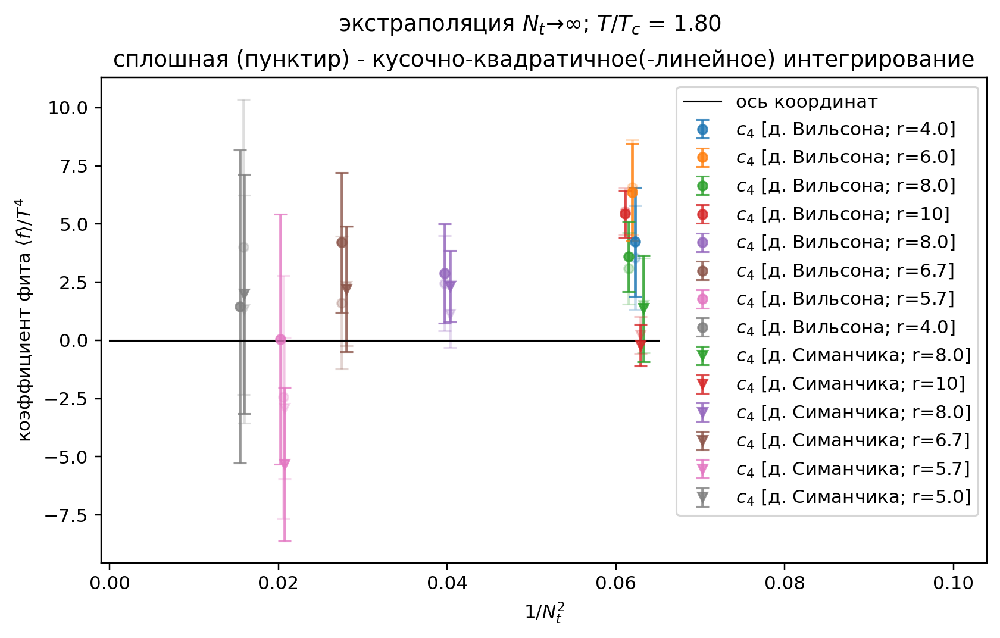

In [6]:
# t_per_tc_target = np.linspace(1.1, 2.9, 10)
# t_per_tc_target = np.linspace(1.05, 2.05, 6)
# t_per_tc_target = np.linspace(1.10, 1.80, 8)

t_per_tc_target = np.linspace(1.01, 1.80, 80)

wilson_t_ttc = t_per_tc_target * 0.0
wilson_t_val = t_per_tc_target * 0.0
wilson_t_err = t_per_tc_target * 0.0
wilson_s_ttc = t_per_tc_target * 0.0
wilson_s_val = t_per_tc_target * 0.0
wilson_s_err = t_per_tc_target * 0.0
symanzik_t_ttc = t_per_tc_target * 0.0
symanzik_t_val = t_per_tc_target * 0.0
symanzik_t_err = t_per_tc_target * 0.0
symanzik_s_ttc = t_per_tc_target * 0.0
symanzik_s_val = t_per_tc_target * 0.0
symanzik_s_err = t_per_tc_target * 0.0

for counter_out, t_per_tc in enumerate(t_per_tc_target):
    fig, ax = plotters.make_figure_and_111axis(plt)

    nt4_c2only_t_ns16, nt4_c2_t_ns16, nt4_c4_t_ns16 = my_func(
        calc_4w_ns_all_t, 4.0, 4, tc_in_mev_nt4)
    nt4_c2only_s_ns16, nt4_c2_s_ns16, nt4_c4_s_ns16 = my_func(
        calc_4w_ns_all_q, 4.0, 4, tc_in_mev_nt4)
    nt4_c2only_t_ns24, nt4_c2_t_ns24, nt4_c4_t_ns24 = my_func(
        calc_4w_ns_all_t, 6.0, 4, tc_in_mev_nt4)
    nt4_c2only_s_ns24, nt4_c2_s_ns24, nt4_c4_s_ns24 = my_func(
        calc_4w_ns_all_q, 6.0, 4, tc_in_mev_nt4)
    nt4_c2only_t_ns32, nt4_c2_t_ns32, nt4_c4_t_ns32 = my_func(
        calc_4w_ns_all_t, 8.0, 4, tc_in_mev_nt4)
    nt4_c2only_s_ns32, nt4_c2_s_ns32, nt4_c4_s_ns32 = my_func(
        calc_4w_ns_all_q, 8.0, 4, tc_in_mev_nt4)
    nt4_c2only_t_ns40, nt4_c2_t_ns40, nt4_c4_t_ns40 = my_func(
        calc_4w_ns_all_t, 10.0, 4, tc_in_mev_nt4)
    nt4_c2only_s_ns40, nt4_c2_s_ns40, nt4_c4_s_ns40 = my_func(
        calc_4w_ns_all_q, 10.0, 4, tc_in_mev_nt4)
    nt5_c2only_t_ns40, nt5_c2_t_ns40, nt5_c4_t_ns40 = my_func(
        calc_5w_ns40_t, r_nt5, 5, tc_in_mev_nt5)
    nt5_c2only_s_ns40, nt5_c2_s_ns40, nt5_c4_s_ns40 = my_func(
        calc_5w_ns40_q, r_nt5, 5, tc_in_mev_nt5)
    nt6_c2only_t_ns40, nt6_c2_t_ns40, nt6_c4_t_ns40 = my_func(
        calc_6w_ns40_t, r_nt6, 6, tc_in_mev_nt6)
    nt6_c2only_s_ns40, nt6_c2_s_ns40, nt6_c4_s_ns40 = my_func(
        calc_6w_ns40_q, r_nt6, 6, tc_in_mev_nt6)
    nt7_c2only_t_ns40, nt7_c2_t_ns40, nt7_c4_t_ns40 = my_func(
        calc_7w_ns40_t, r_nt7, 7, tc_in_mev_nt7)
    nt7_c2only_s_ns40, nt7_c2_s_ns40, nt7_c4_s_ns40 = my_func(
        calc_7w_ns40_q, r_nt7, 7, tc_in_mev_nt7)
    nt8_c2only_t_ns32, nt8_c2_t_ns32, nt8_c4_t_ns32 = my_func(
        calc_8w_ns32_t, r_nt8, 8, tc_in_mev_nt8)
    nt8_c2only_s_ns32, nt8_c2_s_ns32, nt8_c4_s_ns32 = my_func(
        calc_8w_ns32_q, r_nt8, 8, tc_in_mev_nt8)
    nt4imp_c2only_t_ns32, nt4imp_c2_t_ns32, nt4imp_c4_t_ns32 = my_func(
        calc_4s_ns32_t, 8.0, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
    nt4imp_c2only_s_ns32, nt4imp_c2_s_ns32, nt4imp_c4_s_ns32 = my_func(
        calc_4s_ns32_q, 8.0, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
    nt4imp_c2only_t_ns40, nt4imp_c2_t_ns40, nt4imp_c4_t_ns40 = my_func(
        calc_4s_ns40_t, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
    nt4imp_c2only_s_ns40, nt4imp_c2_s_ns40, nt4imp_c4_s_ns40 = my_func(
        calc_4s_ns40_q, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
    nt5imp_c2only_t_ns40, nt5imp_c2_t_ns40, nt5imp_c4_t_ns40 = my_func(
        calc_5s_ns40_t, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
    nt5imp_c2only_s_ns40, nt5imp_c2_s_ns40, nt5imp_c4_s_ns40 = my_func(
        calc_5s_ns40_q, r_nt5, 5, tc_in_mev_nt5imp,
        symanzik_scale_setter)
    nt6imp_c2only_t_ns40, nt6imp_c2_t_ns40, nt6imp_c4_t_ns40 = my_func(
        calc_6s_ns40_t, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
    nt6imp_c2only_s_ns40, nt6imp_c2_s_ns40, nt6imp_c4_s_ns40 = my_func(
        calc_6s_ns40_q, r_nt6, 6, tc_in_mev_nt6imp,
        symanzik_scale_setter)
    nt7imp_c2only_t_ns40, nt7imp_c2_t_ns40, nt7imp_c4_t_ns40 = my_func(
        calc_7s_ns40_t, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
    nt7imp_c2only_s_ns40, nt7imp_c2_s_ns40, nt7imp_c4_s_ns40 = my_func(
        calc_7s_ns40_q, r_nt7, 7, tc_in_mev_nt7imp,
        symanzik_scale_setter)
    nt8imp_c2only_t_ns40, nt8imp_c2_t_ns40, nt8imp_c4_t_ns40 = my_func(
        calc_8s_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
    nt8imp_c2only_s_ns40, nt8imp_c2_s_ns40, nt8imp_c4_s_ns40 = my_func(
        calc_8s_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp,
        symanzik_scale_setter)

    def my_func002(
        spl_reps: Sequence[plotters.SplineRep],
        point: float
    ) -> Tuple[List[float], List[float]]:
        """Does something (???)

        Args:
            spl_reps: Sequence of SplineRep's from where to take points.
            point: Point at which calculate SplineRep's value and error.

        Returns:
            Tuple (val_res, val_err) where val_res and val_err are lists
            of results and their errors.
        """
        val_res = []
        val_err = []
        for spl_rep in spl_reps:
            val, err = spl_rep.calculate_points([point])
            val_res.append(val[0])
            val_err.append(err[0])
        return val_res, val_err

    def wrap(x_val: Sequence[float],
             y_valerr: Tuple[List[float], List[float]],
             shift: float) -> plotters.PointRep:
        """Does something (???)

        Returns:
            plotters.PointRep with shifted x values by given amount.
        """
        return plotters.PointRep(np_array_(x_val) + shift*np.ones(len(x_val)),
                                 y_valerr[0], y_valerr[1])

    c2only_t_nt4ns16 = wrap(
        [1/4**2], my_func002([nt4_c2only_t_ns16], t_per_tc), -0.0002)
    c2only_s_nt4ns16 = wrap(
        [1/4**2], my_func002([nt4_c2only_s_ns16], t_per_tc), -0.0002)
    c2only_t_nt4ns24 = wrap(
        [1/4**2], my_func002([nt4_c2only_t_ns24], t_per_tc), -0.0006)
    c2only_s_nt4ns24 = wrap(
        [1/4**2], my_func002([nt4_c2only_s_ns24], t_per_tc), -0.0006)
    c2only_t_nt4ns32 = wrap(
        [1/4**2], my_func002([nt4_c2only_t_ns32], t_per_tc), -0.0010)
    c2only_s_nt4ns32 = wrap(
        [1/4**2], my_func002([nt4_c2only_s_ns32], t_per_tc), -0.0010)
    c2only_t_nt4ns40 = wrap(
        [1/4**2], my_func002([nt4_c2only_t_ns40], t_per_tc), -0.0014)
    c2only_s_nt4ns40 = wrap(
        [1/4**2], my_func002([nt4_c2only_s_ns40], t_per_tc), -0.0014)
    c2only_t_nt5ns40 = wrap(
        [1/5**2], my_func002([nt5_c2only_t_ns40], t_per_tc), -0.0003)
    c2only_s_nt5ns40 = wrap(
        [1/5**2], my_func002([nt5_c2only_s_ns40], t_per_tc), -0.0003)
    c2only_t_nt6ns40 = wrap(
        [1/6**2], my_func002([nt6_c2only_t_ns40], t_per_tc), -0.0003)
    c2only_s_nt6ns40 = wrap(
        [1/6**2], my_func002([nt6_c2only_s_ns40], t_per_tc), -0.0003)
    c2only_t_nt7ns40 = wrap(
        [1/7**2], my_func002([nt7_c2only_t_ns40], t_per_tc), -0.0003)
    c2only_s_nt7ns40 = wrap(
        [1/7**2], my_func002([nt7_c2only_s_ns40], t_per_tc), -0.0003)
    c2only_t_nt8ns32 = wrap(
        [1/8**2], my_func002([nt8_c2only_t_ns32], t_per_tc), -0.0003)
    c2only_s_nt8ns32 = wrap(
        [1/8**2], my_func002([nt8_c2only_s_ns32], t_per_tc), -0.0003)
    c2only_t_nt4ns32_imp = wrap(
        [1/4**2], my_func002([nt4imp_c2only_t_ns32], t_per_tc), 0.0008)
    c2only_s_nt4ns32_imp = wrap(
        [1/4**2], my_func002([nt4imp_c2only_s_ns32], t_per_tc), 0.0008)
    c2only_t_nt4ns40_imp = wrap(
        [1/4**2], my_func002([nt4imp_c2only_t_ns40], t_per_tc), 0.0004)
    c2only_s_nt4ns40_imp = wrap(
        [1/4**2], my_func002([nt4imp_c2only_s_ns40], t_per_tc), 0.0004)
    c2only_t_nt5ns40_imp = wrap(
        [1/5**2], my_func002([nt5imp_c2only_t_ns40], t_per_tc), 0.0003)
    c2only_s_nt5ns40_imp = wrap(
        [1/5**2], my_func002([nt5imp_c2only_s_ns40], t_per_tc), 0.0003)
    c2only_t_nt6ns40_imp = wrap(
        [1/6**2], my_func002([nt6imp_c2only_t_ns40], t_per_tc), 0.0003)
    c2only_s_nt6ns40_imp = wrap(
        [1/6**2], my_func002([nt6imp_c2only_s_ns40], t_per_tc), 0.0003)
    c2only_t_nt7ns40_imp = wrap(
        [1/7**2], my_func002([nt7imp_c2only_t_ns40], t_per_tc), 0.0003)
    c2only_s_nt7ns40_imp = wrap(
        [1/7**2], my_func002([nt7imp_c2only_s_ns40], t_per_tc), 0.0003)
    c2only_t_nt8ns40_imp = wrap(
        [1/8**2], my_func002([nt8imp_c2only_t_ns40], t_per_tc), 0.0003)
    c2only_s_nt8ns40_imp = wrap(
        [1/8**2], my_func002([nt8imp_c2only_s_ns40], t_per_tc), 0.0003)

    c2_t_nt4ns16 = wrap([1/4**2], my_func002([nt4_c2_t_ns16], t_per_tc),
                            -0.0002)
    c2_s_nt4ns16 = wrap([1/4**2], my_func002([nt4_c2_s_ns16], t_per_tc),
                            -0.0002)
    c2_t_nt4ns24 = wrap([1/4**2], my_func002([nt4_c2_t_ns24], t_per_tc),
                            -0.0006)
    c2_s_nt4ns24 = wrap([1/4**2], my_func002([nt4_c2_s_ns24], t_per_tc),
                            -0.0006)
    c2_t_nt4ns32 = wrap([1/4**2], my_func002([nt4_c2_t_ns32], t_per_tc),
                            -0.0010)
    c2_s_nt4ns32 = wrap([1/4**2], my_func002([nt4_c2_s_ns32], t_per_tc),
                            -0.0010)
    c2_t_nt4ns40 = wrap([1/4**2], my_func002([nt4_c2_t_ns40], t_per_tc),
                            -0.0014)
    c2_s_nt4ns40 = wrap([1/4**2], my_func002([nt4_c2_s_ns40], t_per_tc),
                            -0.0014)
    c2_t_nt5ns40 = wrap([1/5**2], my_func002([nt5_c2_t_ns40], t_per_tc),
                            -0.0003)
    c2_s_nt5ns40 = wrap([1/5**2], my_func002([nt5_c2_s_ns40], t_per_tc),
                            -0.0003)
    c2_t_nt6ns40 = wrap([1/6**2], my_func002([nt6_c2_t_ns40], t_per_tc),
                            -0.0003)
    c2_s_nt6ns40 = wrap([1/6**2], my_func002([nt6_c2_s_ns40], t_per_tc),
                            -0.0003)
    c2_t_nt7ns40 = wrap([1/7**2], my_func002([nt7_c2_t_ns40], t_per_tc),
                            -0.0003)
    c2_s_nt7ns40 = wrap([1/7**2], my_func002([nt7_c2_s_ns40], t_per_tc),
                            -0.0003)
    c2_t_nt8ns32 = wrap([1/8**2], my_func002([nt8_c2_t_ns32], t_per_tc),
                            -0.0003)
    c2_s_nt8ns32 = wrap([1/8**2], my_func002([nt8_c2_s_ns32], t_per_tc),
                            -0.0003)
    c2_t_nt4ns32_imp = wrap([1/4**2], my_func002([nt4imp_c2_t_ns32], t_per_tc),
                            0.0008)
    c2_s_nt4ns32_imp = wrap([1/4**2], my_func002([nt4imp_c2_s_ns32], t_per_tc),
                            0.0008)
    c2_t_nt4ns40_imp = wrap([1/4**2], my_func002([nt4imp_c2_t_ns40], t_per_tc),
                            0.0004)
    c2_s_nt4ns40_imp = wrap([1/4**2], my_func002([nt4imp_c2_s_ns40], t_per_tc),
                            0.0004)
    c2_t_nt5ns40_imp = wrap([1/5**2], my_func002([nt5imp_c2_t_ns40], t_per_tc),
                            0.0003)
    c2_s_nt5ns40_imp = wrap([1/5**2], my_func002([nt5imp_c2_s_ns40], t_per_tc),
                            0.0003)
    c2_t_nt6ns40_imp = wrap([1/6**2], my_func002([nt6imp_c2_t_ns40], t_per_tc),
                            0.0003)
    c2_s_nt6ns40_imp = wrap([1/6**2], my_func002([nt6imp_c2_s_ns40], t_per_tc),
                            0.0003)
    c2_t_nt7ns40_imp = wrap([1/7**2], my_func002([nt7imp_c2_t_ns40], t_per_tc),
                            0.0003)
    c2_s_nt7ns40_imp = wrap([1/7**2], my_func002([nt7imp_c2_s_ns40], t_per_tc),
                            0.0003)
    c2_t_nt8ns40_imp = wrap([1/8**2], my_func002([nt8imp_c2_t_ns40], t_per_tc),
                            0.0003)
    c2_s_nt8ns40_imp = wrap([1/8**2], my_func002([nt8imp_c2_s_ns40], t_per_tc),
                            0.0003)

    c4_t_nt4ns16 = wrap([1/4**2], my_func002([nt4_c4_t_ns16], t_per_tc),
                            -0.0002)
    c4_s_nt4ns16 = wrap([1/4**2], my_func002([nt4_c4_s_ns16], t_per_tc),
                            -0.0002)
    c4_t_nt4ns24 = wrap([1/4**2], my_func002([nt4_c4_t_ns24], t_per_tc),
                            -0.0006)
    c4_s_nt4ns24 = wrap([1/4**2], my_func002([nt4_c4_s_ns24], t_per_tc),
                            -0.0006)
    c4_t_nt4ns32 = wrap([1/4**2], my_func002([nt4_c4_t_ns32], t_per_tc),
                            -0.0010)
    c4_s_nt4ns32 = wrap([1/4**2], my_func002([nt4_c4_s_ns32], t_per_tc),
                            -0.0010)
    c4_t_nt4ns40 = wrap([1/4**2], my_func002([nt4_c4_t_ns40], t_per_tc),
                            -0.0014)
    c4_s_nt4ns40 = wrap([1/4**2], my_func002([nt4_c4_s_ns40], t_per_tc),
                            -0.0014)
    c4_t_nt5ns40 = wrap([1/5**2], my_func002([nt5_c4_t_ns40], t_per_tc),
                            -0.0003)
    c4_s_nt5ns40 = wrap([1/5**2], my_func002([nt5_c4_s_ns40], t_per_tc),
                            -0.0003)
    c4_t_nt6ns40 = wrap([1/6**2], my_func002([nt6_c4_t_ns40], t_per_tc),
                            -0.0003)
    c4_s_nt6ns40 = wrap([1/6**2], my_func002([nt6_c4_s_ns40], t_per_tc),
                            -0.0003)
    c4_t_nt7ns40 = wrap([1/7**2], my_func002([nt7_c4_t_ns40], t_per_tc),
                            0.0002)
    c4_s_nt7ns40 = wrap([1/7**2], my_func002([nt7_c4_s_ns40], t_per_tc),
                            -0.0002)
    c4_t_nt8ns32 = wrap([1/8**2], my_func002([nt8_c4_t_ns32], t_per_tc),
                            0.0002)
    c4_s_nt8ns32 = wrap([1/8**2], my_func002([nt8_c4_s_ns32], t_per_tc),
                            -0.0002)
    c4_t_nt4ns32_imp = wrap([1/4**2], my_func002([nt4imp_c4_t_ns32], t_per_tc),
                            0.0008)
    c4_s_nt4ns32_imp = wrap([1/4**2], my_func002([nt4imp_c4_s_ns32], t_per_tc),
                            0.0008)
    c4_t_nt4ns40_imp = wrap([1/4**2], my_func002([nt4imp_c4_t_ns40], t_per_tc),
                            0.0004)
    c4_s_nt4ns40_imp = wrap([1/4**2], my_func002([nt4imp_c4_s_ns40], t_per_tc),
                            0.0004)
    c4_t_nt5ns40_imp = wrap([1/5**2], my_func002([nt5imp_c4_t_ns40], t_per_tc),
                            0.0003)
    c4_s_nt5ns40_imp = wrap([1/5**2], my_func002([nt5imp_c4_s_ns40], t_per_tc),
                            0.0003)
    c4_t_nt6ns40_imp = wrap([1/6**2], my_func002([nt6imp_c4_t_ns40], t_per_tc),
                            0.0003)
    c4_s_nt6ns40_imp = wrap([1/6**2], my_func002([nt6imp_c4_s_ns40], t_per_tc),
                            0.0003)
    c4_t_nt7ns40_imp = wrap([1/7**2], my_func002([nt7imp_c4_t_ns40], t_per_tc),
                            0.0003)
    c4_s_nt7ns40_imp = wrap([1/7**2], my_func002([nt7imp_c4_s_ns40], t_per_tc),
                            0.0003)
    c4_t_nt8ns40_imp = wrap([1/8**2], my_func002([nt8imp_c4_t_ns40], t_per_tc),
                            0.0003)
    c4_s_nt8ns40_imp = wrap([1/8**2], my_func002([nt8imp_c4_s_ns40], t_per_tc),
                            0.0003)

    _x_val4_imp = np.array([8.0, 7.0, 6.0, 5.0, 4.0])**(-2)
    _x_val6 = np.array([8.0, 7.0, 6.0])**(-2)
    _x_val5 = np.array([8.0, 7.0, 6.0, 5.0])**(-2)
    _x_val4 = np.array([8.0, 7.0, 6.0, 5.0, 4.0])**(-2)
    _x_val4p = np.array([8.0, 7.0, 6.0, 5.0, 4.0, 4.0, 4.0, 4.0])**(-2)
    def my_func003(val: np.ndarray,
                   err: np.ndarray) -> Tuple[float, float, float, float]:
        """Returns fitting by constant results.

        Returns (res_shift_val, res_shift_err, chi2_per_dof, p_score).
        """
        err_inv = err**(-2)
        res_err = np.sum(err_inv)**(-0.5)
        res_val = np.sum(err_inv * val) / np.sum(err_inv)
        dof = len(val) - 1
        chi2_per_dof = np.sum(((val - res_val) / err)**2) / dof
        p_score = 1.0 - scipy.stats.chi2.cdf(chi2_per_dof * dof, dof)
        return res_val, res_err, chi2_per_dof, p_score
    def my_func004(_x_val: np.ndarray,
                   val: np.ndarray,
                   err: np.ndarray) -> Tuple[float, float, float, float]:
        """Returns linear fitting results.

        Returns (res_shift_val, res_shift_err, chi2_per_dof, p_score).
        """
        res = fitters.LinearFitter.perform_fit(_x_val, val, err)
        res_val = res.a
        res_err = res.a_error
        chi2_per_dof = res.chi_dof
        p_score = res.p_score
        return res_val, res_err, chi2_per_dof, p_score
    def my_func007(_x_val: np.ndarray,
                   val: np.ndarray,
                   err: np.ndarray) -> Tuple[float, float, float, float]:
        """Returns linear fitting results.

        Returns (res_shift, res_slope, chi2_per_dof, p_score).
        """
        res = fitters.LinearFitter.perform_fit(_x_val, val, err)
        res_shift = res.a
        res_slope = res.b
        chi2_per_dof = res.chi_dof
        p_score = res.p_score
        return res_shift, res_slope, chi2_per_dof, p_score
    def my_func017(_x_val: np.ndarray,
                   val: np.ndarray,
                   err: np.ndarray) -> Tuple[float, float, float, float]:
        """Returns linear fitting results (with systematic errors).

        Returns (res_shift, res_shift_err, chi2_per_dof, p_score).
        """
        res = fitters.LinearFitter.perform_fit(_x_val, val, err)
        res_shift = res.a
        res_slope = res.a_error
        chi2_per_dof = res.chi_dof
        p_score = res.p_score
        if chi2_per_dof <= 1.0:
            return res_shift, res_slope, chi2_per_dof, p_score
        else:
            base_err = (err**(-2)).mean()**(-0.5) / 100
            factor = 2.0
            while chi2_per_dof > 1.0:
                base_err *= factor
                tmp_err = err + base_err
                res = fitters.LinearFitter.perform_fit(_x_val, val, tmp_err)
                chi2_per_dof = res.chi_dof
            upper_err = base_err
            lower_err = base_err * 0.0
            sys_err = upper_err
            epsilon = 0.01
            target_chi2_per_dof = 1.0
            while abs(chi2_per_dof - target_chi2_per_dof) > epsilon:
                sys_err = (upper_err + lower_err) / 2.0
                tmp_err = err + sys_err
                res = fitters.LinearFitter.perform_fit(_x_val, val, tmp_err)
                chi2_per_dof = res.chi_dof
                if chi2_per_dof > target_chi2_per_dof:
                    lower_err = sys_err
                else:
                    upper_err = sys_err
            tmp_err = err + sys_err
            res = fitters.LinearFitter.perform_fit(_x_val, val, tmp_err)
            res_shift = res.a
            res_slope = res.a_error
            chi2_per_dof = res.chi_dof
            p_score = res.p_score
            return res_shift, res_slope, chi2_per_dof, p_score

    def my_func005(
            _x_val: np.ndarray,
            val: np.ndarray,
            err: np.ndarray) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
        """Returns linear fitting band."""
        x_val = np.linspace(0.0, _x_val[-1], 100)
        res_val = []
        res_err = []
        for shift in x_val:
            res = fitters.LinearFitter.perform_fit(_x_val - shift, val, err)
            res_val.append(res.a)
            res_err.append(res.a_error)
        return x_val, np.array(res_val), np.array(res_err)

    c2only_s_list = [
        c2only_s_nt8ns32, c2only_s_nt7ns40, c2only_s_nt6ns40, c2only_s_nt5ns40,
        c2only_s_nt4ns40, c2only_s_nt4ns32, c2only_s_nt4ns24, c2only_s_nt4ns16]
    c2only_t_list = [
        c2only_t_nt8ns32, c2only_t_nt7ns40, c2only_t_nt6ns40, c2only_t_nt5ns40,
        c2only_t_nt4ns40, c2only_t_nt4ns32, c2only_t_nt4ns24, c2only_t_nt4ns16]
    c2_s_list = [c2_s_nt8ns32, c2_s_nt7ns40, c2_s_nt6ns40, c2_s_nt5ns40,
                 c2_s_nt4ns40, c2_s_nt4ns32, c2_s_nt4ns24, c2_s_nt4ns16]
    c2_t_list = [c2_t_nt8ns32, c2_t_nt7ns40, c2_t_nt6ns40, c2_t_nt5ns40,
                 c2_t_nt4ns40, c2_t_nt4ns32, c2_t_nt4ns24, c2_t_nt4ns16]
    c4_s_list = [c4_s_nt8ns32, c4_s_nt7ns40, c4_s_nt6ns40, c4_s_nt5ns40,
                 c4_s_nt4ns40, c4_s_nt4ns32, c4_s_nt4ns24, c4_s_nt4ns16]
    c4_t_list = [c4_t_nt8ns32, c4_t_nt7ns40, c4_t_nt6ns40, c4_t_nt5ns40,
                 c4_t_nt4ns40, c4_t_nt4ns32, c4_t_nt4ns24, c4_t_nt4ns16]
    c2only_s_list_imp = [
        c2only_s_nt8ns40_imp, c2only_s_nt7ns40_imp, c2only_s_nt6ns40_imp,
        c2only_s_nt5ns40_imp, c2only_s_nt4ns40_imp]
    c2only_t_list_imp = [
        c2only_t_nt8ns40_imp, c2only_t_nt7ns40_imp, c2only_t_nt6ns40_imp,
        c2only_t_nt5ns40_imp, c2only_t_nt4ns40_imp]
    c2_s_list_imp = [c2_s_nt8ns40_imp, c2_s_nt7ns40_imp, c2_s_nt6ns40_imp,
                     c2_s_nt5ns40_imp, c2_s_nt4ns40_imp]
    c2_t_list_imp = [c2_t_nt8ns40_imp, c2_t_nt7ns40_imp, c2_t_nt6ns40_imp,
                     c2_t_nt5ns40_imp, c2_t_nt4ns40_imp]
    c4_s_list_imp = [c4_s_nt8ns40_imp, c4_s_nt7ns40_imp, c4_s_nt6ns40_imp,
                     c4_s_nt5ns40_imp, c4_s_nt4ns40_imp]
    c4_t_list_imp = [c4_t_nt8ns40_imp, c4_t_nt7ns40_imp, c4_t_nt6ns40_imp,
                     c4_t_nt5ns40_imp, c4_t_nt4ns40_imp]
    c2only_s_val_nt6 = np.array([rep.y_val[0] for rep in c2only_s_list[:3]])
    c2only_s_err_nt6 = np.array([rep.y_err[0] for rep in c2only_s_list[:3]])
    c2only_s_val_nt5 = np.array([rep.y_val[0] for rep in c2only_s_list[:4]])
    c2only_s_err_nt5 = np.array([rep.y_err[0] for rep in c2only_s_list[:4]])
    c2only_s_val_nt4 = np.array([rep.y_val[0] for rep in c2only_s_list[:5]])
    c2only_s_err_nt4 = np.array([rep.y_err[0] for rep in c2only_s_list[:5]])
    c2only_s_val_nt4p = np.array([rep.y_val[0] for rep in c2only_s_list[:8]])
    c2only_s_err_nt4p = np.array([rep.y_err[0] for rep in c2only_s_list[:8]])
    c2only_s_val_imp = np.array([rep.y_val[0] for rep in c2only_s_list_imp])
    c2only_s_err_imp = np.array([rep.y_err[0] for rep in c2only_s_list_imp])
    c2only_s_res_val, c2only_s_res_err,  c2only_s_chi2dof, c2only_s_p_score = (
        my_func003(c2only_s_val_nt6, c2only_s_err_nt6))
    c2only_s_l_val, c2only_s_l_err,  c2only_s_l_chi2dof, c2only_s_l_p_score = (
        my_func004(_x_val6, c2only_s_val_nt6, c2only_s_err_nt6))
    c2only_s_b_x_nt6, c2only_s_b_yv_nt6,  c2only_s_b_ye_nt6 = (
        my_func005(_x_val6, c2only_s_val_nt6, c2only_s_err_nt6))
    c2only_s_b_x_nt5, c2only_s_b_yv_nt5,  c2only_s_b_ye_nt5 = (
        my_func005(_x_val5, c2only_s_val_nt5, c2only_s_err_nt5))
    c2only_s_b_x_nt4, c2only_s_b_yv_nt4,  c2only_s_b_ye_nt4 = (
        my_func005(_x_val4, c2only_s_val_nt4, c2only_s_err_nt4))
    c2only_s_b_x_nt4p, c2only_s_b_yv_nt4p,  c2only_s_b_ye_nt4p = (
        my_func005(_x_val4p, c2only_s_val_nt4p, c2only_s_err_nt4p))
    c2only_s_b_x_imp, c2only_s_b_yv_imp,  c2only_s_b_ye_imp = (
        my_func005(_x_val4_imp, c2only_s_val_imp, c2only_s_err_imp))
    _, _,  c2only_s_chi2dof_n4imp, c2only_s_p_score_n4imp = (
        my_func003(c2only_s_val_imp, c2only_s_err_imp))
    c2only_t_val_nt6 = np.array([rep.y_val[0] for rep in c2only_t_list[:3]])
    c2only_t_err_nt6 = np.array([rep.y_err[0] for rep in c2only_t_list[:3]])
    c2only_t_val_nt5 = np.array([rep.y_val[0] for rep in c2only_t_list[:4]])
    c2only_t_err_nt5 = np.array([rep.y_err[0] for rep in c2only_t_list[:4]])
    c2only_t_val_nt4 = np.array([rep.y_val[0] for rep in c2only_t_list[:5]])
    c2only_t_err_nt4 = np.array([rep.y_err[0] for rep in c2only_t_list[:5]])
    c2only_t_val_nt4p = np.array([rep.y_val[0] for rep in c2only_t_list[:8]])
    c2only_t_err_nt4p = np.array([rep.y_err[0] for rep in c2only_t_list[:8]])
    c2only_t_val_imp = np.array([rep.y_val[0] for rep in c2only_t_list_imp])
    c2only_t_err_imp = np.array([rep.y_err[0] for rep in c2only_t_list_imp])
    c2only_t_res_val, c2only_t_res_err,  c2only_t_chi2dof, c2only_t_p_score = (
        my_func003(c2only_t_val_nt6, c2only_t_err_nt6))
    c2only_t_l_val, c2only_t_l_err,  c2only_t_l_chi2dof, c2only_t_l_p_score = (
        my_func004(_x_val6, c2only_t_val_nt6, c2only_t_err_nt6))
    c2only_t_b_x_nt6, c2only_t_b_yv_nt6,  c2only_t_b_ye_nt6 = (
        my_func005(_x_val6, c2only_t_val_nt6, c2only_t_err_nt6))
    c2only_t_b_x_nt5, c2only_t_b_yv_nt5,  c2only_t_b_ye_nt5 = (
        my_func005(_x_val5, c2only_t_val_nt5, c2only_t_err_nt5))
    c2only_t_b_x_nt4, c2only_t_b_yv_nt4,  c2only_t_b_ye_nt4 = (
        my_func005(_x_val4, c2only_t_val_nt4, c2only_t_err_nt4))
    c2only_t_b_x_nt4p, c2only_t_b_yv_nt4p,  c2only_t_b_ye_nt4p = (
        my_func005(_x_val4p, c2only_t_val_nt4p, c2only_t_err_nt4p))
    c2only_t_b_x_imp, c2only_t_b_yv_imp,  c2only_t_b_ye_imp = (
        my_func005(_x_val4_imp, c2only_t_val_imp, c2only_t_err_imp))
    _, _,  c2only_t_chi2dof_n4imp, c2only_t_p_score_n4imp = (
        my_func003(c2only_t_val_imp, c2only_t_err_imp))
    c2_s_val_nt6 = np.array([rep.y_val[0] for rep in c2_s_list[:3]])
    c2_s_err_nt6 = np.array([rep.y_err[0] for rep in c2_s_list[:3]])
    c2_s_val_nt5 = np.array([rep.y_val[0] for rep in c2_s_list[:4]])
    c2_s_err_nt5 = np.array([rep.y_err[0] for rep in c2_s_list[:4]])
    c2_s_val_nt4 = np.array([rep.y_val[0] for rep in c2_s_list[:5]])
    c2_s_err_nt4 = np.array([rep.y_err[0] for rep in c2_s_list[:5]])
    c2_s_val_nt4p = np.array([rep.y_val[0] for rep in c2_s_list[:8]])
    c2_s_err_nt4p = np.array([rep.y_err[0] for rep in c2_s_list[:8]])
    c2_s_val_imp = np.array([rep.y_val[0] for rep in c2_s_list_imp])
    c2_s_err_imp = np.array([rep.y_err[0] for rep in c2_s_list_imp])
    c2_s_res_val, c2_s_res_err,  c2_s_chi2dof, c2_s_p_score = (
        my_func003(c2_s_val_nt6, c2_s_err_nt6))
    c2_s_l_val, c2_s_l_err,  c2_s_l_chi2dof, c2_s_l_p_score = (
        my_func004(_x_val6, c2_s_val_nt6, c2_s_err_nt6))
    c2_s_b_x_nt6, c2_s_b_yv_nt6,  c2_s_b_ye_nt6 = (
        my_func005(_x_val6, c2_s_val_nt6, c2_s_err_nt6))
    c2_s_nt6_shift, c2_s_nt6_slope,  c2_s_nt6_chi2dof, c2_s_nt6_p_score = (
        my_func007(_x_val6, c2_s_val_nt6, c2_s_err_nt6))
    c2_s_nt6_shift_sys, c2_s_nt6_slope_sys,  c2_s_nt6_chi2dof_sys, c2_s_nt6_p_score_sys = (
        my_func017(_x_val6, c2_s_val_nt6, c2_s_err_nt6))
    c2_s_b_x_nt5, c2_s_b_yv_nt5,  c2_s_b_ye_nt5 = (
        my_func005(_x_val5, c2_s_val_nt5, c2_s_err_nt5))
    c2_s_nt5_shift, c2_s_nt5_slope,  c2_s_nt5_chi2dof, c2_s_nt5_p_score = (
        my_func007(_x_val5, c2_s_val_nt5, c2_s_err_nt5))
    c2_s_nt5_shift_sys, c2_s_nt5_slope_sys,  c2_s_nt5_chi2dof_sys, c2_s_nt5_p_score_sys = (
        my_func017(_x_val5, c2_s_val_nt5, c2_s_err_nt5))
    c2_s_b_x_nt4, c2_s_b_yv_nt4,  c2_s_b_ye_nt4 = (
        my_func005(_x_val4, c2_s_val_nt4, c2_s_err_nt4))
    c2_s_nt4_shift, c2_s_nt4_slope,  c2_s_nt4_chi2dof, c2_s_nt4_p_score = (
        my_func007(_x_val4, c2_s_val_nt4, c2_s_err_nt4))
    c2_s_nt4_shift_sys, c2_s_nt4_slope_sys,  c2_s_nt4_chi2dof_sys, c2_s_nt4_p_score_sys = (
        my_func017(_x_val4, c2_s_val_nt4, c2_s_err_nt4))
    c2_s_b_x_nt4p, c2_s_b_yv_nt4p,  c2_s_b_ye_nt4p = (
        my_func005(_x_val4p, c2_s_val_nt4p, c2_s_err_nt4p))
    c2_s_b_x_imp, c2_s_b_yv_imp,  c2_s_b_ye_imp = (
        my_func005(_x_val4_imp, c2_s_val_imp, c2_s_err_imp))
    c2_s_imp_shift, c2_s_imp_slope,  c2_s_imp_chi2dof, c2_s_imp_p_score = (
        my_func007(_x_val4_imp, c2_s_val_imp, c2_s_err_imp))
    c2_s_imp_shift_sys, c2_s_imp_slope_sys,  c2_s_imp_chi2dof_sys, c2_s_imp_p_score_sys = (
        my_func017(_x_val4_imp, c2_s_val_imp, c2_s_err_imp))
    _, _,  c2_s_chi2dof_n4imp, c2_s_p_score_n4imp = (
        my_func003(c2_s_val_imp, c2_s_err_imp))
    c2_t_val_nt6 = np.array([rep.y_val[0] for rep in c2_t_list[:3]])
    c2_t_err_nt6 = np.array([rep.y_err[0] for rep in c2_t_list[:3]])
    c2_t_val_nt5 = np.array([rep.y_val[0] for rep in c2_t_list[:4]])
    c2_t_err_nt5 = np.array([rep.y_err[0] for rep in c2_t_list[:4]])
    c2_t_val_nt4 = np.array([rep.y_val[0] for rep in c2_t_list[:5]])
    c2_t_err_nt4 = np.array([rep.y_err[0] for rep in c2_t_list[:5]])
    c2_t_val_nt4p = np.array([rep.y_val[0] for rep in c2_t_list[:8]])
    c2_t_err_nt4p = np.array([rep.y_err[0] for rep in c2_t_list[:8]])
    c2_t_val_imp = np.array([rep.y_val[0] for rep in c2_t_list_imp])
    c2_t_err_imp = np.array([rep.y_err[0] for rep in c2_t_list_imp])
    c2_t_res_val, c2_t_res_err,  c2_t_chi2dof, c2_t_p_score = (
        my_func003(c2_t_val_nt6, c2_t_err_nt6))
    c2_t_l_val, c2_t_l_err,  c2_t_l_chi2dof, c2_t_l_p_score = (
        my_func004(_x_val6, c2_t_val_nt6, c2_t_err_nt6))
    c2_t_b_x_nt6, c2_t_b_yv_nt6,  c2_t_b_ye_nt6 = (
        my_func005(_x_val6, c2_t_val_nt6, c2_t_err_nt6))
    c2_t_nt6_shift, c2_t_nt6_slope,  c2_t_nt6_chi2dof, c2_t_nt6_p_score = (
        my_func007(_x_val6, c2_t_val_nt6, c2_t_err_nt6))
    c2_t_nt6_shift_sys, c2_t_nt6_slope_sys,  c2_t_nt6_chi2dof_sys, c2_t_nt6_p_score_sys = (
        my_func017(_x_val6, c2_t_val_nt6, c2_t_err_nt6))
    c2_t_b_x_nt5, c2_t_b_yv_nt5,  c2_t_b_ye_nt5 = (
        my_func005(_x_val5, c2_t_val_nt5, c2_t_err_nt5))
    c2_t_nt5_shift, c2_t_nt5_slope,  c2_t_nt5_chi2dof, c2_t_nt5_p_score = (
        my_func007(_x_val5, c2_t_val_nt5, c2_t_err_nt5))
    c2_t_nt5_shift_sys, c2_t_nt5_slope_sys,  c2_t_nt5_chi2dof_sys, c2_t_nt5_p_score_sys = (
        my_func017(_x_val5, c2_t_val_nt5, c2_t_err_nt5))
    c2_t_b_x_nt4, c2_t_b_yv_nt4,  c2_t_b_ye_nt4 = (
        my_func005(_x_val4, c2_t_val_nt4, c2_t_err_nt4))
    c2_t_nt4_shift, c2_t_nt4_slope,  c2_t_nt4_chi2dof, c2_t_nt4_p_score = (
        my_func007(_x_val4, c2_t_val_nt4, c2_t_err_nt4))
    c2_t_nt4_shift_sys, c2_t_nt4_slope_sys,  c2_t_nt4_chi2dof_sys, c2_t_nt4_p_score_sys = (
        my_func017(_x_val4, c2_t_val_nt4, c2_t_err_nt4))
    c2_t_b_x_nt4p, c2_t_b_yv_nt4p,  c2_t_b_ye_nt4p = (
        my_func005(_x_val4p, c2_t_val_nt4p, c2_t_err_nt4p))
    c2_t_b_x_imp, c2_t_b_yv_imp,  c2_t_b_ye_imp = (
        my_func005(_x_val4_imp, c2_t_val_imp, c2_t_err_imp))
    c2_t_imp_shift, c2_t_imp_slope,  c2_t_imp_chi2dof, c2_t_imp_p_score = (
        my_func007(_x_val4_imp, c2_t_val_imp, c2_t_err_imp))
    c2_t_imp_shift_sys, c2_t_imp_slope_sys,  c2_t_imp_chi2dof_sys, c2_t_imp_p_score_sys = (
        my_func017(_x_val4_imp, c2_t_val_imp, c2_t_err_imp))
    _, _,  c2_t_chi2dof_n4imp, c2_t_p_score_n4imp = (
        my_func003(c2_t_val_imp, c2_t_err_imp))
    c4_s_val_nt6 = np.array([rep.y_val[0] for rep in c4_s_list[:3]])
    c4_s_err_nt6 = np.array([rep.y_err[0] for rep in c4_s_list[:3]])
    c4_s_val_nt5 = np.array([rep.y_val[0] for rep in c4_s_list[:4]])
    c4_s_err_nt5 = np.array([rep.y_err[0] for rep in c4_s_list[:4]])
    c4_s_val_nt4 = np.array([rep.y_val[0] for rep in c4_s_list[:5]])
    c4_s_err_nt4 = np.array([rep.y_err[0] for rep in c4_s_list[:5]])
    c4_s_val_nt4p = np.array([rep.y_val[0] for rep in c4_s_list[:8]])
    c4_s_err_nt4p = np.array([rep.y_err[0] for rep in c4_s_list[:8]])
    c4_s_val_imp = np.array([rep.y_val[0] for rep in c4_s_list_imp])
    c4_s_err_imp = np.array([rep.y_err[0] for rep in c4_s_list_imp])
    c4_s_res_val, c4_s_res_err,  c4_s_chi2dof, c4_s_p_score = (
        my_func003(c4_s_val_nt6, c4_s_err_nt6))
    c4_s_l_val, c4_s_l_err,  c4_s_l_chi2dof, c4_s_l_p_score = (
        my_func004(_x_val6, c4_s_val_nt6, c4_s_err_nt6))
    c4_s_b_x_nt6, c4_s_b_yv_nt6,  c4_s_b_ye_nt6 = (
        my_func005(_x_val6, c4_s_val_nt6, c4_s_err_nt6))
    c4_s_nt6_shift, c4_s_nt6_slope,  c4_s_nt6_chi2dof, c4_s_nt6_p_score = (
        my_func007(_x_val6, c4_s_val_nt6, c4_s_err_nt6))
    c4_s_nt6_shift_sys, c4_s_nt6_slope_sys,  c4_s_nt6_chi2dof_sys, c4_s_nt6_p_score_sys = (
        my_func017(_x_val6, c4_s_val_nt6, c4_s_err_nt6))
    c4_s_b_x_nt5, c4_s_b_yv_nt5,  c4_s_b_ye_nt5 = (
        my_func005(_x_val5, c4_s_val_nt5, c4_s_err_nt5))
    c4_s_nt5_shift, c4_s_nt5_slope,  c4_s_nt5_chi2dof, c4_s_nt5_p_score = (
        my_func007(_x_val5, c4_s_val_nt5, c4_s_err_nt5))
    c4_s_nt5_shift_sys, c4_s_nt5_slope_sys,  c4_s_nt5_chi2dof_sys, c4_s_nt5_p_score_sys = (
        my_func017(_x_val5, c4_s_val_nt5, c4_s_err_nt5))
    c4_s_b_x_nt4, c4_s_b_yv_nt4,  c4_s_b_ye_nt4 = (
        my_func005(_x_val4, c4_s_val_nt4, c4_s_err_nt4))
    c4_s_nt4_shift, c4_s_nt4_slope,  c4_s_nt4_chi2dof, c4_s_nt4_p_score = (
        my_func007(_x_val4, c4_s_val_nt4, c4_s_err_nt4))
    c4_s_nt4_shift_sys, c4_s_nt4_slope_sys,  c4_s_nt4_chi2dof_sys, c4_s_nt4_p_score_sys = (
        my_func017(_x_val4, c4_s_val_nt4, c4_s_err_nt4))
    c4_s_b_x_nt4p, c4_s_b_yv_nt4p,  c4_s_b_ye_nt4p = (
        my_func005(_x_val4p, c4_s_val_nt4p, c4_s_err_nt4p))
    c4_s_b_x_imp, c4_s_b_yv_imp,  c4_s_b_ye_imp = (
        my_func005(_x_val4_imp, c4_s_val_imp, c4_s_err_imp))
    c4_s_imp_shift, c4_s_imp_slope,  c4_s_imp_chi2dof, c4_s_imp_p_score = (
        my_func007(_x_val4_imp, c4_s_val_imp, c4_s_err_imp))
    c4_s_imp_shift_sys, c4_s_imp_slope_sys,  c4_s_imp_chi2dof_sys, c4_s_imp_p_score_sys = (
        my_func017(_x_val4_imp, c4_s_val_imp, c4_s_err_imp))
    _, _,  c4_s_chi2dof_n4imp, c4_s_p_score_n4imp = (
        my_func003(c4_s_val_imp, c4_s_err_imp))
    c4_t_val_nt6 = np.array([rep.y_val[0] for rep in c4_t_list[:3]])
    c4_t_err_nt6 = np.array([rep.y_err[0] for rep in c4_t_list[:3]])
    c4_t_val_nt5 = np.array([rep.y_val[0] for rep in c4_t_list[:4]])
    c4_t_err_nt5 = np.array([rep.y_err[0] for rep in c4_t_list[:4]])
    c4_t_val_nt4 = np.array([rep.y_val[0] for rep in c4_t_list[:5]])
    c4_t_err_nt4 = np.array([rep.y_err[0] for rep in c4_t_list[:5]])
    c4_t_val_nt4p = np.array([rep.y_val[0] for rep in c4_t_list[:8]])
    c4_t_err_nt4p = np.array([rep.y_err[0] for rep in c4_t_list[:8]])
    c4_t_val_imp = np.array([rep.y_val[0] for rep in c4_t_list_imp])
    c4_t_err_imp = np.array([rep.y_err[0] for rep in c4_t_list_imp])
    c4_t_res_val, c4_t_res_err,  c4_t_chi2dof, c4_t_p_score = (
        my_func003(c4_t_val_nt6, c4_t_err_nt6))
    c4_t_l_val, c4_t_l_err,  c4_t_l_chi2dof, c4_t_l_p_score = (
        my_func004(_x_val6, c4_t_val_nt6, c4_t_err_nt6))
    c4_t_b_x_nt6, c4_t_b_yv_nt6,  c4_t_b_ye_nt6 = (
        my_func005(_x_val6, c4_t_val_nt6, c4_t_err_nt6))
    c4_t_nt6_shift, c4_t_nt6_slope,  c4_t_nt6_chi2dof, c4_t_nt6_p_score = (
        my_func007(_x_val6, c4_t_val_nt6, c4_t_err_nt6))
    c4_t_nt6_shift_sys, c4_t_nt6_slope_sys,  c4_t_nt6_chi2dof_sys, c4_t_nt6_p_score_sys = (
        my_func017(_x_val6, c4_t_val_nt6, c4_t_err_nt6))
    c4_t_b_x_nt5, c4_t_b_yv_nt5,  c4_t_b_ye_nt5 = (
        my_func005(_x_val5, c4_t_val_nt5, c4_t_err_nt5))
    c4_t_nt5_shift, c4_t_nt5_slope,  c4_t_nt5_chi2dof, c4_t_nt5_p_score = (
        my_func007(_x_val5, c4_t_val_nt5, c4_t_err_nt5))
    c4_t_nt5_shift_sys, c4_t_nt5_slope_sys,  c4_t_nt5_chi2dof_sys, c4_t_nt5_p_score_sys = (
        my_func017(_x_val5, c4_t_val_nt5, c4_t_err_nt5))
    c4_t_b_x_nt4, c4_t_b_yv_nt4,  c4_t_b_ye_nt4 = (
        my_func005(_x_val4, c4_t_val_nt4, c4_t_err_nt4))
    c4_t_nt4_shift, c4_t_nt4_slope,  c4_t_nt4_chi2dof, c4_t_nt4_p_score = (
        my_func007(_x_val4, c4_t_val_nt4, c4_t_err_nt4))
    c4_t_nt4_shift_sys, c4_t_nt4_slope_sys,  c4_t_nt4_chi2dof_sys, c4_t_nt4_p_score_sys = (
        my_func017(_x_val4, c4_t_val_nt4, c4_t_err_nt4))
    c4_t_b_x_nt4p, c4_t_b_yv_nt4p,  c4_t_b_ye_nt4p = (
        my_func005(_x_val4p, c4_t_val_nt4p, c4_t_err_nt4p))
    c4_t_b_x_imp, c4_t_b_yv_imp,  c4_t_b_ye_imp = (
        my_func005(_x_val4_imp, c4_t_val_imp, c4_t_err_imp))
    c4_t_imp_shift, c4_t_imp_slope,  c4_t_imp_chi2dof, c4_t_imp_p_score = (
        my_func007(_x_val4_imp, c4_t_val_imp, c4_t_err_imp))
    c4_t_imp_shift_sys, c4_t_imp_slope_sys,  c4_t_imp_chi2dof_sys, c4_t_imp_p_score_sys = (
        my_func017(_x_val4_imp, c4_t_val_imp, c4_t_err_imp))
    _, _,  c4_t_chi2dof_n4imp, c4_t_p_score_n4imp = (
        my_func003(c4_t_val_imp, c4_t_err_imp))

    c2_t_y_data_b = np.array([
        c2_t_nt4ns40.y_val[0],
        c2_t_nt5ns40.y_val[0],
        c2_t_nt6ns40.y_val[0],
        c2_t_nt7ns40.y_val[0],
        c2_t_nt8ns32.y_val[0],
        c2_t_nt4ns40_imp.y_val[0],
        c2_t_nt5ns40_imp.y_val[0],
        c2_t_nt6ns40_imp.y_val[0],
        c2_t_nt7ns40_imp.y_val[0],
        c2_t_nt8ns40_imp.y_val[0],
    ])
    c2_t_y_err_b = np.array([
        c2_t_nt4ns40.y_err[0],
        c2_t_nt5ns40.y_err[0],
        c2_t_nt6ns40.y_err[0],
        c2_t_nt7ns40.y_err[0],
        c2_t_nt8ns32.y_err[0],
        c2_t_nt4ns40_imp.y_err[0],
        c2_t_nt5ns40_imp.y_err[0],
        c2_t_nt6ns40_imp.y_err[0],
        c2_t_nt7ns40_imp.y_err[0],
        c2_t_nt8ns40_imp.y_err[0],
    ])
    c2_s_y_data_b = np.array([
        c2_s_nt4ns40.y_val[0],
        c2_s_nt5ns40.y_val[0],
        c2_s_nt6ns40.y_val[0],
        c2_s_nt7ns40.y_val[0],
        c2_s_nt8ns32.y_val[0],
        c2_s_nt4ns40_imp.y_val[0],
        c2_s_nt5ns40_imp.y_val[0],
        c2_s_nt6ns40_imp.y_val[0],
        c2_s_nt7ns40_imp.y_val[0],
        c2_s_nt8ns40_imp.y_val[0],
    ])
    c2_s_y_err_b = np.array([
        c2_s_nt4ns40.y_err[0],
        c2_s_nt5ns40.y_err[0],
        c2_s_nt6ns40.y_err[0],
        c2_s_nt7ns40.y_err[0],
        c2_s_nt8ns32.y_err[0],
        c2_s_nt4ns40_imp.y_err[0],
        c2_s_nt5ns40_imp.y_err[0],
        c2_s_nt6ns40_imp.y_err[0],
        c2_s_nt7ns40_imp.y_err[0],
        c2_s_nt8ns40_imp.y_err[0],
    ])
    c4_t_y_data_b = np.array([
        c4_t_nt4ns40.y_val[0],
        c4_t_nt5ns40.y_val[0],
        c4_t_nt6ns40.y_val[0],
        c4_t_nt7ns40.y_val[0],
        c4_t_nt8ns32.y_val[0],
        c4_t_nt4ns40_imp.y_val[0],
        c4_t_nt5ns40_imp.y_val[0],
        c4_t_nt6ns40_imp.y_val[0],
        c4_t_nt7ns40_imp.y_val[0],
        c4_t_nt8ns40_imp.y_val[0],
    ])
    c4_t_y_err_b = np.array([
        c4_t_nt4ns40.y_err[0],
        c4_t_nt5ns40.y_err[0],
        c4_t_nt6ns40.y_err[0],
        c4_t_nt7ns40.y_err[0],
        c4_t_nt8ns32.y_err[0],
        c4_t_nt4ns40_imp.y_err[0],
        c4_t_nt5ns40_imp.y_err[0],
        c4_t_nt6ns40_imp.y_err[0],
        c4_t_nt7ns40_imp.y_err[0],
        c4_t_nt8ns40_imp.y_err[0],
    ])
    c4_s_y_data_b = np.array([
        c4_s_nt4ns40.y_val[0],
        c4_s_nt5ns40.y_val[0],
        c4_s_nt6ns40.y_val[0],
        c4_s_nt7ns40.y_val[0],
        c4_s_nt8ns32.y_val[0],
        c4_s_nt4ns40_imp.y_val[0],
        c4_s_nt5ns40_imp.y_val[0],
        c4_s_nt6ns40_imp.y_val[0],
        c4_s_nt7ns40_imp.y_val[0],
        c4_s_nt8ns40_imp.y_val[0],
    ])
    c4_s_y_err_b = np.array([
        c4_s_nt4ns40.y_err[0],
        c4_s_nt5ns40.y_err[0],
        c4_s_nt6ns40.y_err[0],
        c4_s_nt7ns40.y_err[0],
        c4_s_nt8ns32.y_err[0],
        c4_s_nt4ns40_imp.y_err[0],
        c4_s_nt5ns40_imp.y_err[0],
        c4_s_nt6ns40_imp.y_err[0],
        c4_s_nt7ns40_imp.y_err[0],
        c4_s_nt8ns40_imp.y_err[0],
    ])
    # TODO: is that correctly filled?!
    # Answer: Can be dome to test c2 vs c2only comparability.
    c2only_t_y_data_b = np.array([
        c2only_t_nt4ns40.y_val[0],
        c2only_t_nt5ns40.y_val[0],
        c2only_t_nt6ns40.y_val[0],
        c2only_t_nt7ns40.y_val[0],
        c2only_t_nt8ns32.y_val[0],
        c2only_t_nt4ns40_imp.y_val[0],
        c2only_t_nt5ns40_imp.y_val[0],
        c2only_t_nt6ns40_imp.y_val[0],
        c2only_t_nt7ns40_imp.y_val[0],
        c2only_t_nt8ns40_imp.y_val[0],
    ])
    c2only_t_y_err_b = np.array([
        c2only_t_nt4ns40.y_err[0],
        c2only_t_nt5ns40.y_err[0],
        c2only_t_nt6ns40.y_err[0],
        c2only_t_nt7ns40.y_err[0],
        c2only_t_nt8ns32.y_err[0],
        c2only_t_nt4ns40_imp.y_err[0],
        c2only_t_nt5ns40_imp.y_err[0],
        c2only_t_nt6ns40_imp.y_err[0],
        c2only_t_nt7ns40_imp.y_err[0],
        c2only_t_nt8ns40_imp.y_err[0],
    ])
    c2only_s_y_data_b = np.array([
        c2only_s_nt4ns40.y_val[0],
        c2only_s_nt5ns40.y_val[0],
        c2only_s_nt6ns40.y_val[0],
        c2only_s_nt7ns40.y_val[0],
        c2only_s_nt8ns32.y_val[0],
        c2only_s_nt4ns40_imp.y_val[0],
        c2only_s_nt5ns40_imp.y_val[0],
        c2only_s_nt6ns40_imp.y_val[0],
        c2only_s_nt7ns40_imp.y_val[0],
        c2only_s_nt8ns40_imp.y_val[0],
    ])
    c2only_s_y_err_b = np.array([
        c2only_s_nt4ns40.y_err[0],
        c2only_s_nt5ns40.y_err[0],
        c2only_s_nt6ns40.y_err[0],
        c2only_s_nt7ns40.y_err[0],
        c2only_s_nt8ns32.y_err[0],
        c2only_s_nt4ns40_imp.y_err[0],
        c2only_s_nt5ns40_imp.y_err[0],
        c2only_s_nt6ns40_imp.y_err[0],
        c2only_s_nt7ns40_imp.y_err[0],
        c2only_s_nt8ns40_imp.y_err[0],
    ])
    c2_t_y_data_r = np.array([
        c2_t_nt5ns40.y_val[0],
        c2_t_nt6ns40.y_val[0],
        c2_t_nt7ns40.y_val[0],
        c2_t_nt8ns32.y_val[0],
        c2_t_nt4ns40_imp.y_val[0],
        c2_t_nt5ns40_imp.y_val[0],
        c2_t_nt6ns40_imp.y_val[0],
        c2_t_nt7ns40_imp.y_val[0],
        c2_t_nt8ns40_imp.y_val[0],
    ])
    c2_t_y_err_r = np.array([
        c2_t_nt5ns40.y_err[0],
        c2_t_nt6ns40.y_err[0],
        c2_t_nt7ns40.y_err[0],
        c2_t_nt8ns32.y_err[0],
        c2_t_nt4ns40_imp.y_err[0],
        c2_t_nt5ns40_imp.y_err[0],
        c2_t_nt6ns40_imp.y_err[0],
        c2_t_nt7ns40_imp.y_err[0],
        c2_t_nt8ns40_imp.y_err[0],
    ])
    c2_s_y_data_r = np.array([
        c2_s_nt5ns40.y_val[0],
        c2_s_nt6ns40.y_val[0],
        c2_s_nt7ns40.y_val[0],
        c2_s_nt8ns32.y_val[0],
        c2_s_nt4ns40_imp.y_val[0],
        c2_s_nt5ns40_imp.y_val[0],
        c2_s_nt6ns40_imp.y_val[0],
        c2_s_nt7ns40_imp.y_val[0],
        c2_s_nt8ns40_imp.y_val[0],
    ])
    c2_s_y_err_r = np.array([
        c2_s_nt5ns40.y_err[0],
        c2_s_nt6ns40.y_err[0],
        c2_s_nt7ns40.y_err[0],
        c2_s_nt8ns32.y_err[0],
        c2_s_nt4ns40_imp.y_err[0],
        c2_s_nt5ns40_imp.y_err[0],
        c2_s_nt6ns40_imp.y_err[0],
        c2_s_nt7ns40_imp.y_err[0],
        c2_s_nt8ns40_imp.y_err[0],
    ])
    c4_t_y_data_r = np.array([
        c4_t_nt5ns40.y_val[0],
        c4_t_nt6ns40.y_val[0],
        c4_t_nt7ns40.y_val[0],
        c4_t_nt8ns32.y_val[0],
        c4_t_nt4ns40_imp.y_val[0],
        c4_t_nt5ns40_imp.y_val[0],
        c4_t_nt6ns40_imp.y_val[0],
        c4_t_nt7ns40_imp.y_val[0],
        c4_t_nt8ns40_imp.y_val[0],
    ])
    c4_t_y_err_r = np.array([
        c4_t_nt5ns40.y_err[0],
        c4_t_nt6ns40.y_err[0],
        c4_t_nt7ns40.y_err[0],
        c4_t_nt8ns32.y_err[0],
        c4_t_nt4ns40_imp.y_err[0],
        c4_t_nt5ns40_imp.y_err[0],
        c4_t_nt6ns40_imp.y_err[0],
        c4_t_nt7ns40_imp.y_err[0],
        c4_t_nt8ns40_imp.y_err[0],
    ])
    c4_s_y_data_r = np.array([
        c4_s_nt5ns40.y_val[0],
        c4_s_nt6ns40.y_val[0],
        c4_s_nt7ns40.y_val[0],
        c4_s_nt8ns32.y_val[0],
        c4_s_nt4ns40_imp.y_val[0],
        c4_s_nt5ns40_imp.y_val[0],
        c4_s_nt6ns40_imp.y_val[0],
        c4_s_nt7ns40_imp.y_val[0],
        c4_s_nt8ns40_imp.y_val[0],
    ])
    c4_s_y_err_r = np.array([
        c4_s_nt5ns40.y_err[0],
        c4_s_nt6ns40.y_err[0],
        c4_s_nt7ns40.y_err[0],
        c4_s_nt8ns32.y_err[0],
        c4_s_nt4ns40_imp.y_err[0],
        c4_s_nt5ns40_imp.y_err[0],
        c4_s_nt6ns40_imp.y_err[0],
        c4_s_nt7ns40_imp.y_err[0],
        c4_s_nt8ns40_imp.y_err[0],
    ])
    c2only_t_y_data_r = np.array([
        c2only_t_nt5ns40.y_val[0],
        c2only_t_nt6ns40.y_val[0],
        c2only_t_nt7ns40.y_val[0],
        c2only_t_nt8ns32.y_val[0],
        c2only_t_nt4ns40_imp.y_val[0],
        c2only_t_nt5ns40_imp.y_val[0],
        c2only_t_nt6ns40_imp.y_val[0],
        c2only_t_nt7ns40_imp.y_val[0],
        c2only_t_nt8ns40_imp.y_val[0],
    ])
    c2only_t_y_err_r = np.array([
        c2only_t_nt5ns40.y_err[0],
        c2only_t_nt6ns40.y_err[0],
        c2only_t_nt7ns40.y_err[0],
        c2only_t_nt8ns32.y_err[0],
        c2only_t_nt4ns40_imp.y_err[0],
        c2only_t_nt5ns40_imp.y_err[0],
        c2only_t_nt6ns40_imp.y_err[0],
        c2only_t_nt7ns40_imp.y_err[0],
        c2only_t_nt8ns40_imp.y_err[0],
    ])
    c2only_s_y_data_r = np.array([
        c2only_s_nt5ns40.y_val[0],
        c2only_s_nt6ns40.y_val[0],
        c2only_s_nt7ns40.y_val[0],
        c2only_s_nt8ns32.y_val[0],
        c2only_s_nt4ns40_imp.y_val[0],
        c2only_s_nt5ns40_imp.y_val[0],
        c2only_s_nt6ns40_imp.y_val[0],
        c2only_s_nt7ns40_imp.y_val[0],
        c2only_s_nt8ns40_imp.y_val[0],
    ])
    c2only_s_y_err_r = np.array([
        c2only_s_nt5ns40.y_err[0],
        c2only_s_nt6ns40.y_err[0],
        c2only_s_nt7ns40.y_err[0],
        c2only_s_nt8ns32.y_err[0],
        c2only_s_nt4ns40_imp.y_err[0],
        c2only_s_nt5ns40_imp.y_err[0],
        c2only_s_nt6ns40_imp.y_err[0],
        c2only_s_nt7ns40_imp.y_err[0],
        c2only_s_nt8ns40_imp.y_err[0],
    ])
    def bilinear_func(some_tuple: Tuple, a: float,
                 k_wilson: float, k_symanzik: float) -> float:
        """Bilinear function for double continuum extrapolation."""
        nt_wilson_inv, nt_symanzik_inv = some_tuple
        return a + k_wilson * nt_wilson_inv**2 + k_symanzik * nt_symanzik_inv**2
    nt_wilson_inv_b = np.array([1/4, 1/5, 1/6, 1/7, 1/8, 0, 0, 0, 0, 0])
    nt_symanzik_inv_b = np.array([0, 0, 0, 0, 0, 1/4, 1/5, 1/6, 1/7, 1/8])
    nt_data_inv_b = (nt_wilson_inv_b, nt_symanzik_inv_b)
    nt_wilson_inv_r = np.array([1/5, 1/6, 1/7, 1/8, 0, 0, 0, 0, 0])
    nt_symanzik_inv_r = np.array([0, 0, 0, 0, 1/4, 1/5, 1/6, 1/7, 1/8])
    nt_data_inv_r = (nt_wilson_inv_r, nt_symanzik_inv_r)
    def my_func006(_x_val: Tuple,
                   y_data: np.ndarray,
                   y_err: np.ndarray) -> Tuple[float, float, float, float]:
        """Returns bilinear fitting results (with chi_sqr)."""
        popt, pcov = scipy.optimize.curve_fit(
            bilinear_func, _x_val, y_data, sigma=y_err, absolute_sigma=True)
        a = popt[0]
        k_wilson = popt[1]
        k_symanzik = popt[2]
        res_val = a
        res_err = np.sqrt(np.diag(pcov))[0]

        nt_wilson_inv, nt_symanzik_inv = _x_val
        n_entries = len(nt_wilson_inv)
        chi_sqr = 0.0
        for i in range(n_entries):
            chi_sqr += (
                (bilinear_func(
                    (nt_wilson_inv[i], nt_symanzik_inv[i]),
                    a, k_wilson, k_symanzik) - y_data[i]) / y_err[i])**2
        dof = n_entries - 3
        chi2_per_dof = chi_sqr / dof
        p_score = 1.0 - scipy.stats.chi2.cdf(chi_sqr, dof)
        return res_val, res_err, chi2_per_dof, p_score

    def my_func016(_x_val: Tuple,
                   y_data: np.ndarray,
                   y_err: np.ndarray) -> Tuple[float, float, float, float]:
        """Returns bilinear fitting results (with slopes)."""
        popt, pcov = scipy.optimize.curve_fit(
            bilinear_func, _x_val, y_data, sigma=y_err, absolute_sigma=True)
        a = popt[0]
        k_wilson = popt[1]
        k_symanzik = popt[2]
        res_val = a
        res_err = np.sqrt(np.diag(pcov))[0]
        return res_val, res_err, k_wilson, k_symanzik

    c2_t_bil_val_b, c2_t_bil_err_b, c2_t_bil_chi2dof_b, c2_t_bil_p_score_b = (
        my_func006(nt_data_inv_b, c2_t_y_data_b, c2_t_y_err_b))
    c2_s_bil_val_b, c2_s_bil_err_b, c2_s_bil_chi2dof_b, c2_s_bil_p_score_b = (
        my_func006(nt_data_inv_b, c2_s_y_data_b, c2_s_y_err_b))
    c4_t_bil_val_b, c4_t_bil_err_b, c4_t_bil_chi2dof_b, c4_t_bil_p_score_b = (
        my_func006(nt_data_inv_b, c4_t_y_data_b, c4_t_y_err_b))
    c4_s_bil_val_b, c4_s_bil_err_b, c4_s_bil_chi2dof_b, c4_s_bil_p_score_b = (
        my_func006(nt_data_inv_b, c4_s_y_data_b, c4_s_y_err_b))
    c2only_t_bil_val_b, c2only_t_bil_err_b, \
            c2only_t_bil_chi2dof_b, c2only_t_bil_p_score_b = (
        my_func006(nt_data_inv_b, c2only_t_y_data_b, c2only_t_y_err_b))
    c2only_s_bil_val_b, c2only_s_bil_err_b, \
            c2only_s_bil_chi2dof_b, c2only_s_bil_p_score_b = (
        my_func006(nt_data_inv_b, c2only_s_y_data_b, c2only_s_y_err_b))
    c2_t_bil_val_r, c2_t_bil_err_r, c2_t_bil_chi2dof_r, c2_t_bil_p_score_r = (
        my_func006(nt_data_inv_r, c2_t_y_data_r, c2_t_y_err_r))
    c2_s_bil_val_r, c2_s_bil_err_r, c2_s_bil_chi2dof_r, c2_s_bil_p_score_r = (
        my_func006(nt_data_inv_r, c2_s_y_data_r, c2_s_y_err_r))
    c4_t_bil_val_r, c4_t_bil_err_r, c4_t_bil_chi2dof_r, c4_t_bil_p_score_r = (
        my_func006(nt_data_inv_r, c4_t_y_data_r, c4_t_y_err_r))
    c4_s_bil_val_r, c4_s_bil_err_r, c4_s_bil_chi2dof_r, c4_s_bil_p_score_r = (
        my_func006(nt_data_inv_r, c4_s_y_data_r, c4_s_y_err_r))
    c2only_t_bil_val_r, c2only_t_bil_err_r, \
            c2only_t_bil_chi2dof_r, c2only_t_bil_p_score_r = (
        my_func006(nt_data_inv_r, c2only_t_y_data_r, c2only_t_y_err_r))
    c2only_s_bil_val_r, c2only_s_bil_err_r, \
            c2only_s_bil_chi2dof_r, c2only_s_bil_p_score_r = (
        my_func006(nt_data_inv_r, c2only_s_y_data_r, c2only_s_y_err_r))

    _, _, c4_t_bil_k_wilson_b, c4_t_bil_k_symanzik_b = (
        my_func016(nt_data_inv_b, c4_t_y_data_b, c4_t_y_err_b))
    _, _, c4_s_bil_k_wilson_b, c4_s_bil_k_symanzik_b = (
        my_func016(nt_data_inv_b, c4_s_y_data_b, c4_s_y_err_b))
    _, _, c4_t_bil_k_wilson_r, c4_t_bil_k_symanzik_r = (
        my_func016(nt_data_inv_r, c4_t_y_data_r, c4_t_y_err_r))
    _, _, c4_s_bil_k_wilson_r, c4_s_bil_k_symanzik_r = (
        my_func016(nt_data_inv_r, c4_s_y_data_r, c4_s_y_err_r))

    def prime_wrap(plain_warp_res: plotters.PointRep, nt: int, shift: float,
                   a_val: float, k_val: float,
                   zeta: float, v_max: float) -> plotters.PointRep:
        return wrap(
            [1 / nt**2],
            ([plain_warp_res.y_val[0]
              - (a_val + k_val/nt**2) * zeta * v_max**2],
             [plain_warp_res.y_err[0]]),
            shift)

    zeta4 = 1.000000
    zeta7 = 0.998918
    v_max_4 = 0.25
    v_max_7 = 0.3000

    c2prime_t_nt4ns16 = prime_wrap(
        c2only_t_nt4ns16, 4, -0.0002,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_s_nt4ns16 = prime_wrap(
        c2only_s_nt4ns16, 4, -0.0002,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_t_nt4ns24 = prime_wrap(
        c2only_t_nt4ns24, 4, -0.0006,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_s_nt4ns24 = prime_wrap(
        c2only_s_nt4ns24, 4, -0.0006,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_t_nt4ns32 = prime_wrap(
        c2only_t_nt4ns32, 4, -0.0010,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_s_nt4ns32 = prime_wrap(
        c2only_s_nt4ns32, 4, -0.0010,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_t_nt4ns40 = prime_wrap(
        c2only_t_nt4ns40, 4, -0.0014,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_s_nt4ns40 = prime_wrap(
        c2only_s_nt4ns40, 4, -0.0014,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_t_nt5ns40 = prime_wrap(
        c2only_t_nt5ns40, 5, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta7, v_max_7)
    c2prime_s_nt5ns40 = prime_wrap(
        c2only_s_nt5ns40, 5, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta7, v_max_7)
    c2prime_t_nt6ns40 = prime_wrap(
        c2only_t_nt6ns40, 6, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta7, v_max_7)
    c2prime_s_nt6ns40 = prime_wrap(
        c2only_s_nt6ns40, 6, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta7, v_max_7)
    c2prime_t_nt7ns40 = prime_wrap(
        c2only_t_nt7ns40, 7, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta7, v_max_7)
    c2prime_s_nt7ns40 = prime_wrap(
        c2only_s_nt7ns40, 7, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta7, v_max_7)
    c2prime_t_nt8ns32 = prime_wrap(
        c2only_t_nt8ns32, 8, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_s_nt8ns32 = prime_wrap(
        c2only_s_nt8ns32, 8, -0.0003,
        c4_t_bil_val_b, c4_t_bil_k_wilson_b, zeta4, v_max_4)
    c2prime_t_nt4ns32_imp = prime_wrap(
        c2only_t_nt4ns32_imp, 4, 0.0008,
        c4_t_bil_val_b, c4_t_bil_k_symanzik_b, zeta4, v_max_4)
    c2prime_s_nt4ns32_imp = prime_wrap(
        c2only_s_nt4ns32_imp, 4, 0.0008,
        c4_s_bil_val_b, c4_s_bil_k_symanzik_b, zeta4, v_max_4)
    c2prime_t_nt4ns40_imp = prime_wrap(
        c2only_t_nt4ns40_imp, 4, 0.0004,
        c4_t_bil_val_b, c4_t_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_s_nt4ns40_imp = prime_wrap(
        c2only_s_nt4ns40_imp, 4, 0.0004,
        c4_s_bil_val_b, c4_s_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_t_nt5ns40_imp = prime_wrap(
        c2only_t_nt5ns40_imp, 5, 0.0003,
        c4_t_bil_val_b, c4_t_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_s_nt5ns40_imp = prime_wrap(
        c2only_s_nt5ns40_imp, 5, 0.0003,
        c4_s_bil_val_b, c4_s_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_t_nt6ns40_imp = prime_wrap(
        c2only_t_nt6ns40_imp, 6, 0.0003,
        c4_t_bil_val_b, c4_t_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_s_nt6ns40_imp = prime_wrap(
        c2only_s_nt6ns40_imp, 6, 0.0003,
        c4_s_bil_val_b, c4_s_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_t_nt7ns40_imp = prime_wrap(
        c2only_t_nt7ns40_imp, 7, 0.0003,
        c4_t_bil_val_b, c4_t_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_s_nt7ns40_imp = prime_wrap(
        c2only_s_nt7ns40_imp, 7, 0.0003,
        c4_s_bil_val_b, c4_s_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_t_nt8ns40_imp = prime_wrap(
        c2only_t_nt8ns40_imp, 8, 0.0003,
        c4_t_bil_val_b, c4_t_bil_k_symanzik_b, zeta7, v_max_7)
    c2prime_s_nt8ns40_imp = prime_wrap(
        c2only_s_nt8ns40_imp, 8, 0.0003,
        c4_s_bil_val_b, c4_s_bil_k_symanzik_b, zeta7, v_max_7)

    c2prime_s_list = [
        c2prime_s_nt8ns32, c2prime_s_nt7ns40, c2prime_s_nt6ns40,
        c2prime_s_nt5ns40, c2prime_s_nt4ns40, c2prime_s_nt4ns32,
        c2prime_s_nt4ns24, c2prime_s_nt4ns16]
    c2prime_t_list = [
        c2prime_t_nt8ns32, c2prime_t_nt7ns40, c2prime_t_nt6ns40,
        c2prime_t_nt5ns40, c2prime_t_nt4ns40, c2prime_t_nt4ns32,
        c2prime_t_nt4ns24, c2prime_t_nt4ns16]
    c2prime_s_list_imp = [
        c2prime_s_nt8ns40_imp, c2prime_s_nt7ns40_imp, c2prime_s_nt6ns40_imp,
        c2prime_s_nt5ns40_imp, c2prime_s_nt4ns40_imp]
    c2prime_t_list_imp = [
        c2prime_t_nt8ns40_imp, c2prime_t_nt7ns40_imp, c2prime_t_nt6ns40_imp,
        c2prime_t_nt5ns40_imp, c2prime_t_nt4ns40_imp]

    c2prime_s_val_nt6 = np.array([rep.y_val[0] for rep in c2prime_s_list[:3]])
    c2prime_s_err_nt6 = np.array([rep.y_err[0] for rep in c2prime_s_list[:3]])
    c2prime_s_val_nt5 = np.array([rep.y_val[0] for rep in c2prime_s_list[:4]])
    c2prime_s_err_nt5 = np.array([rep.y_err[0] for rep in c2prime_s_list[:4]])
    c2prime_s_val_nt4 = np.array([rep.y_val[0] for rep in c2prime_s_list[:5]])
    c2prime_s_err_nt4 = np.array([rep.y_err[0] for rep in c2prime_s_list[:5]])
    c2prime_s_val_nt4p = np.array([rep.y_val[0] for rep in c2prime_s_list[:8]])
    c2prime_s_err_nt4p = np.array([rep.y_err[0] for rep in c2prime_s_list[:8]])
    c2prime_s_val_imp = np.array([rep.y_val[0] for rep in c2prime_s_list_imp])
    c2prime_s_err_imp = np.array([rep.y_err[0] for rep in c2prime_s_list_imp])
    c2prime_s_res_val, c2prime_s_res_err,  c2prime_s_chi2dof, c2prime_s_p_score = (
        my_func003(c2prime_s_val_nt6, c2prime_s_err_nt6))
    c2prime_s_l_val, c2prime_s_l_err,  c2prime_s_l_chi2dof, c2prime_s_l_p_score = (
        my_func004(_x_val6, c2prime_s_val_nt6, c2prime_s_err_nt6))
    c2prime_s_b_x_nt6, c2prime_s_b_yv_nt6,  c2prime_s_b_ye_nt6 = (
        my_func005(_x_val6, c2prime_s_val_nt6, c2prime_s_err_nt6))
    c2prime_s_nt6_shift, c2prime_s_nt6_slope,  c2prime_s_nt6_chi2dof, c2prime_s_nt6_p_score = (
        my_func007(_x_val6, c2prime_s_val_nt6, c2prime_s_err_nt6))
    c2prime_s_nt6_shift_sys, c2prime_s_nt6_slope_sys,  c2prime_s_nt6_chi2dof_sys, c2prime_s_nt6_p_score_sys = (
        my_func017(_x_val6, c2prime_s_val_nt6, c2prime_s_err_nt6))
    c2prime_s_b_x_nt5, c2prime_s_b_yv_nt5,  c2prime_s_b_ye_nt5 = (
        my_func005(_x_val5, c2prime_s_val_nt5, c2prime_s_err_nt5))
    c2prime_s_nt5_shift, c2prime_s_nt5_slope,  c2prime_s_nt5_chi2dof, c2prime_s_nt5_p_score = (
        my_func007(_x_val5, c2prime_s_val_nt5, c2prime_s_err_nt5))
    c2prime_s_nt5_shift_sys, c2prime_s_nt5_slope_sys,  c2prime_s_nt5_chi2dof_sys, c2prime_s_nt5_p_score_sys = (
        my_func017(_x_val5, c2prime_s_val_nt5, c2prime_s_err_nt5))
    c2prime_s_b_x_nt4, c2prime_s_b_yv_nt4,  c2prime_s_b_ye_nt4 = (
        my_func005(_x_val4, c2prime_s_val_nt4, c2prime_s_err_nt4))
    c2prime_s_nt4_shift, c2prime_s_nt4_slope,  c2prime_s_nt4_chi2dof, c2prime_s_nt4_p_score = (
        my_func007(_x_val4, c2prime_s_val_nt4, c2prime_s_err_nt4))
    c2prime_s_nt4_shift_sys, c2prime_s_nt4_slope_sys,  c2prime_s_nt4_chi2dof_sys, c2prime_s_nt4_p_score_sys = (
        my_func017(_x_val4, c2prime_s_val_nt4, c2prime_s_err_nt4))
    c2prime_s_b_x_nt4p, c2prime_s_b_yv_nt4p,  c2prime_s_b_ye_nt4p = (
        my_func005(_x_val4p, c2prime_s_val_nt4p, c2prime_s_err_nt4p))
    c2prime_s_b_x_imp, c2prime_s_b_yv_imp,  c2prime_s_b_ye_imp = (
        my_func005(_x_val4_imp, c2prime_s_val_imp, c2prime_s_err_imp))
    c2prime_s_imp_shift, c2prime_s_imp_slope,  c2prime_s_imp_chi2dof, c2prime_s_imp_p_score = (
        my_func007(_x_val4_imp, c2prime_s_val_imp, c2prime_s_err_imp))
    c2prime_s_imp_shift_sys, c2prime_s_imp_slope_sys,  c2prime_s_imp_chi2dof_sys, c2prime_s_imp_p_score_sys = (
        my_func017(_x_val4_imp, c2prime_s_val_imp, c2prime_s_err_imp))
    _, _,  c2prime_s_chi2dof_n4imp, c2prime_s_p_score_n4imp = (
        my_func003(c2prime_s_val_imp, c2prime_s_err_imp))
    c2prime_t_val_nt6 = np.array([rep.y_val[0] for rep in c2prime_t_list[:3]])
    c2prime_t_err_nt6 = np.array([rep.y_err[0] for rep in c2prime_t_list[:3]])
    c2prime_t_val_nt5 = np.array([rep.y_val[0] for rep in c2prime_t_list[:4]])
    c2prime_t_err_nt5 = np.array([rep.y_err[0] for rep in c2prime_t_list[:4]])
    c2prime_t_val_nt4 = np.array([rep.y_val[0] for rep in c2prime_t_list[:5]])
    c2prime_t_err_nt4 = np.array([rep.y_err[0] for rep in c2prime_t_list[:5]])
    c2prime_t_val_nt4p = np.array([rep.y_val[0] for rep in c2prime_t_list[:8]])
    c2prime_t_err_nt4p = np.array([rep.y_err[0] for rep in c2prime_t_list[:8]])
    c2prime_t_val_imp = np.array([rep.y_val[0] for rep in c2prime_t_list_imp])
    c2prime_t_err_imp = np.array([rep.y_err[0] for rep in c2prime_t_list_imp])
    c2prime_t_res_val, c2prime_t_res_err,  c2prime_t_chi2dof, c2prime_t_p_score = (
        my_func003(c2prime_t_val_nt6, c2prime_t_err_nt6))
    c2prime_t_l_val, c2prime_t_l_err,  c2prime_t_l_chi2dof, c2prime_t_l_p_score = (
        my_func004(_x_val6, c2prime_t_val_nt6, c2prime_t_err_nt6))
    c2prime_t_b_x_nt6, c2prime_t_b_yv_nt6,  c2prime_t_b_ye_nt6 = (
        my_func005(_x_val6, c2prime_t_val_nt6, c2prime_t_err_nt6))
    c2prime_t_nt6_shift, c2prime_t_nt6_slope,  c2prime_t_nt6_chi2dof, c2prime_t_nt6_p_score = (
        my_func007(_x_val6, c2prime_t_val_nt6, c2prime_t_err_nt6))
    c2prime_t_nt6_shift_sys, c2prime_t_nt6_slope_sys,  c2prime_t_nt6_chi2dof_sys, c2prime_t_nt6_p_score_sys = (
        my_func017(_x_val6, c2prime_t_val_nt6, c2prime_t_err_nt6))
    c2prime_t_b_x_nt5, c2prime_t_b_yv_nt5,  c2prime_t_b_ye_nt5 = (
        my_func005(_x_val5, c2prime_t_val_nt5, c2prime_t_err_nt5))
    c2prime_t_nt5_shift, c2prime_t_nt5_slope,  c2prime_t_nt5_chi2dof, c2prime_t_nt5_p_score = (
        my_func007(_x_val5, c2prime_t_val_nt5, c2prime_t_err_nt5))
    c2prime_t_nt5_shift_sys, c2prime_t_nt5_slope_sys,  c2prime_t_nt5_chi2dof_sys, c2prime_t_nt5_p_score_sys = (
        my_func017(_x_val5, c2prime_t_val_nt5, c2prime_t_err_nt5))
    c2prime_t_b_x_nt4, c2prime_t_b_yv_nt4,  c2prime_t_b_ye_nt4 = (
        my_func005(_x_val4, c2prime_t_val_nt4, c2prime_t_err_nt4))
    c2prime_t_nt4_shift, c2prime_t_nt4_slope,  c2prime_t_nt4_chi2dof, c2prime_t_nt4_p_score = (
        my_func007(_x_val4, c2prime_t_val_nt4, c2prime_t_err_nt4))
    c2prime_t_nt4_shift_sys, c2prime_t_nt4_slope_sys,  c2prime_t_nt4_chi2dof_sys, c2prime_t_nt4_p_score_sys = (
        my_func017(_x_val4, c2prime_t_val_nt4, c2prime_t_err_nt4))
    c2prime_t_b_x_nt4p, c2prime_t_b_yv_nt4p,  c2prime_t_b_ye_nt4p = (
        my_func005(_x_val4p, c2prime_t_val_nt4p, c2prime_t_err_nt4p))
    c2prime_t_b_x_imp, c2prime_t_b_yv_imp,  c2prime_t_b_ye_imp = (
        my_func005(_x_val4_imp, c2prime_t_val_imp, c2prime_t_err_imp))
    c2prime_t_imp_shift, c2prime_t_imp_slope,  c2prime_t_imp_chi2dof, c2prime_t_imp_p_score = (
        my_func007(_x_val4_imp, c2prime_t_val_imp, c2prime_t_err_imp))
    c2prime_t_imp_shift_sys, c2prime_t_imp_slope_sys,  c2prime_t_imp_chi2dof_sys, c2prime_t_imp_p_score_sys = (
        my_func017(_x_val4_imp, c2prime_t_val_imp, c2prime_t_err_imp))
    _, _,  c2prime_t_chi2dof_n4imp, c2prime_t_p_score_n4imp = (
        my_func003(c2prime_t_val_imp, c2prime_t_err_imp))

    c2prime_t_y_data_b = np.array([
        c2prime_t_nt4ns40.y_val[0],
        c2prime_t_nt5ns40.y_val[0],
        c2prime_t_nt6ns40.y_val[0],
        c2prime_t_nt7ns40.y_val[0],
        c2prime_t_nt8ns32.y_val[0],
        c2prime_t_nt4ns40_imp.y_val[0],
        c2prime_t_nt5ns40_imp.y_val[0],
        c2prime_t_nt6ns40_imp.y_val[0],
        c2prime_t_nt7ns40_imp.y_val[0],
        c2prime_t_nt8ns40_imp.y_val[0],
    ])
    c2prime_t_y_err_b = np.array([
        c2prime_t_nt4ns40.y_err[0],
        c2prime_t_nt5ns40.y_err[0],
        c2prime_t_nt6ns40.y_err[0],
        c2prime_t_nt7ns40.y_err[0],
        c2prime_t_nt8ns32.y_err[0],
        c2prime_t_nt4ns40_imp.y_err[0],
        c2prime_t_nt5ns40_imp.y_err[0],
        c2prime_t_nt6ns40_imp.y_err[0],
        c2prime_t_nt7ns40_imp.y_err[0],
        c2prime_t_nt8ns40_imp.y_err[0],
    ])
    c2prime_s_y_data_b = np.array([
        c2prime_s_nt4ns40.y_val[0],
        c2prime_s_nt5ns40.y_val[0],
        c2prime_s_nt6ns40.y_val[0],
        c2prime_s_nt7ns40.y_val[0],
        c2prime_s_nt8ns32.y_val[0],
        c2prime_s_nt4ns40_imp.y_val[0],
        c2prime_s_nt5ns40_imp.y_val[0],
        c2prime_s_nt6ns40_imp.y_val[0],
        c2prime_s_nt7ns40_imp.y_val[0],
        c2prime_s_nt8ns40_imp.y_val[0],
    ])
    c2prime_s_y_err_b = np.array([
        c2prime_s_nt4ns40.y_err[0],
        c2prime_s_nt5ns40.y_err[0],
        c2prime_s_nt6ns40.y_err[0],
        c2prime_s_nt7ns40.y_err[0],
        c2prime_s_nt8ns32.y_err[0],
        c2prime_s_nt4ns40_imp.y_err[0],
        c2prime_s_nt5ns40_imp.y_err[0],
        c2prime_s_nt6ns40_imp.y_err[0],
        c2prime_s_nt7ns40_imp.y_err[0],
        c2prime_s_nt8ns40_imp.y_err[0],
    ])

    c2prime_t_y_data_r = np.array([
        c2prime_t_nt5ns40.y_val[0],
        c2prime_t_nt6ns40.y_val[0],
        c2prime_t_nt7ns40.y_val[0],
        c2prime_t_nt8ns32.y_val[0],
        c2prime_t_nt4ns40_imp.y_val[0],
        c2prime_t_nt5ns40_imp.y_val[0],
        c2prime_t_nt6ns40_imp.y_val[0],
        c2prime_t_nt7ns40_imp.y_val[0],
        c2prime_t_nt8ns40_imp.y_val[0],
    ])
    c2prime_t_y_err_r = np.array([
        c2prime_t_nt5ns40.y_err[0],
        c2prime_t_nt6ns40.y_err[0],
        c2prime_t_nt7ns40.y_err[0],
        c2prime_t_nt8ns32.y_err[0],
        c2prime_t_nt4ns40_imp.y_err[0],
        c2prime_t_nt5ns40_imp.y_err[0],
        c2prime_t_nt6ns40_imp.y_err[0],
        c2prime_t_nt7ns40_imp.y_err[0],
        c2prime_t_nt8ns40_imp.y_err[0],
    ])
    c2prime_s_y_data_r = np.array([
        c2prime_s_nt5ns40.y_val[0],
        c2prime_s_nt6ns40.y_val[0],
        c2prime_s_nt7ns40.y_val[0],
        c2prime_s_nt8ns32.y_val[0],
        c2prime_s_nt4ns40_imp.y_val[0],
        c2prime_s_nt5ns40_imp.y_val[0],
        c2prime_s_nt6ns40_imp.y_val[0],
        c2prime_s_nt7ns40_imp.y_val[0],
        c2prime_s_nt8ns40_imp.y_val[0],
    ])
    c2prime_s_y_err_r = np.array([
        c2prime_s_nt5ns40.y_err[0],
        c2prime_s_nt6ns40.y_err[0],
        c2prime_s_nt7ns40.y_err[0],
        c2prime_s_nt8ns32.y_err[0],
        c2prime_s_nt4ns40_imp.y_err[0],
        c2prime_s_nt5ns40_imp.y_err[0],
        c2prime_s_nt6ns40_imp.y_err[0],
        c2prime_s_nt7ns40_imp.y_err[0],
        c2prime_s_nt8ns40_imp.y_err[0],
    ])

    c2prime_t_bil_val_b, c2prime_t_bil_err_b, \
            c2prime_t_bil_chi2dof_b, c2prime_t_bil_p_score_b = (
        my_func006(nt_data_inv_b, c2prime_t_y_data_b, c2prime_t_y_err_b))
    c2prime_s_bil_val_b, c2prime_s_bil_err_b, \
            c2prime_s_bil_chi2dof_b, c2prime_s_bil_p_score_b = (
        my_func006(nt_data_inv_b, c2prime_s_y_data_b, c2prime_s_y_err_b))
    c2prime_t_bil_val_r, c2prime_t_bil_err_r, \
            c2prime_t_bil_chi2dof_r, c2prime_t_bil_p_score_r = (
        my_func006(nt_data_inv_r, c2prime_t_y_data_r, c2prime_t_y_err_r))
    c2prime_s_bil_val_r, c2prime_s_bil_err_r, \
            c2prime_s_bil_chi2dof_r, c2prime_s_bil_p_score_r = (
        my_func006(nt_data_inv_r, c2prime_s_y_data_r, c2prime_s_y_err_r))

    opaque = 0.8
    transparent = 0.25
    wilson_marker = "o"
    symanzik_marker = "v"
    quadratic_eos_marker = "o"
    linear_eos_marker = "v"

    x_val = np.linspace(0.0, 0.065)
    # plt.plot(x_val, 0.0 * x_val)
    plt.plot(x_val, 0.0 * x_val, label="ось координат", color="black",
             linewidth=1.0)

    # print(f"[q] Symanzik c2 constant extrapolation: "
    #       f"chi2/dof = {c2_s_chi2dof_n4imp:.2f}; "
    #       f"p = {c2_s_p_score_n4imp:.3f}")
    # print(f"[t] Symanzik c2 constant extrapolation: "
    #       f"chi2/dof = {c2_t_chi2dof_n4imp:.2f}; "
    #       f"p = {c2_t_p_score_n4imp:.3f}")
    # print(f"[q] Symanzik c2 linear extrapolation: "
    #       f"chi2/dof = {c2_s_imp_chi2dof:.2f}; "
    #       f"p = {c2_s_imp_p_score:.3f}")
    # print(f"[t] Symanzik c2 linear extrapolation: "
    #       f"chi2/dof = {c2_t_imp_chi2dof:.2f}; "
    #       f"p = {c2_t_imp_p_score:.3f}")
    # print(f"[q] Wilson c2 (nt = 4) linear extrapolation: "
    #       f"chi2/dof = {c2_s_nt4_chi2dof:.2f}; "
    #       f"p = {c2_s_nt4_p_score:.3f}")
    # print(f"[q] Wilson c2 (nt = 5) linear extrapolation: "
    #       f"chi2/dof = {c2_s_nt5_chi2dof:.2f}; "
    #       f"p = {c2_s_nt5_p_score:.3f}")
    # print(f"[q] Wilson c2 (nt = 6) linear extrapolation: "
    #       f"chi2/dof = {c2_s_nt6_chi2dof:.2f}; "
    #       f"p = {c2_s_nt6_p_score:.3f}")
    # print(f"[t] Wilson c2 (nt = 4) linear extrapolation: "
    #       f"chi2/dof = {c2_t_nt4_chi2dof:.2f}; "
    #       f"p = {c2_t_nt4_p_score:.3f}")
    # print(f"[t] Wilson c2 (nt = 5) linear extrapolation: "
    #       f"chi2/dof = {c2_t_nt5_chi2dof:.2f}; "
    #       f"p = {c2_t_nt5_p_score:.3f}")
    # print(f"[t] Wilson c2 (nt = 6) linear extrapolation: "
    #       f"chi2/dof = {c2_t_nt6_chi2dof:.2f}; "
    #       f"p = {c2_t_nt6_p_score:.3f}")
    # plotters.draw_point_rep(plt, ax, c2_t_nt4ns16, "C0", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt4ns16, "C0", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=4 (r=4)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt4ns24, "C1", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt4ns24, "C1", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=4 (r=6)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt4ns32, "C2", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt4ns32, "C2", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=4 (r=8)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt4ns40, "C3", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt4ns40, "C3", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=4 (r=10)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt5ns40, "C4", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt5ns40, "C4", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=5 (r=8)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt6ns40, "C5", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt6ns40, "C5", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=6 (r=6.7)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt7ns40, "C6", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt7ns40, "C6", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=7 (r=5.7)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt8ns32, "C7", linestyle="",
    #                         alpha=transparent,
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt8ns32, "C7", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=8 (r=4)",
    #                         markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt4ns32_imp, "C2", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt4ns32_imp, "C2", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=4 (imp) (r=8)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt4ns40_imp, "C3", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt4ns40_imp, "C3", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=4 (imp) (r=10)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt5ns40_imp, "C4", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt5ns40_imp, "C4", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=5 (imp) (r=8)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt6ns40_imp, "C5", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt6ns40_imp, "C5", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=6 (imp) (r=6.7)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt7ns40_imp, "C6", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt7ns40_imp, "C6", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=7 (imp) (r=5.7)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_t_nt8ns40_imp, "C7", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2_s_nt8ns40_imp, "C7", linestyle="",
    #                         alpha=opaque,
    #                         label="$c_2$ $N_t$=8 (imp) (r=5.0)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    #                                                    [c2_t_bil_val_b],
    #                                                    [c2_t_bil_err_b]),
    #                         "black", linestyle="",
    #                         alpha=transparent,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2_t_bil_chi2dof_b:.2f}; p="
    #                               f"{c2_t_bil_p_score_b:.3f}",
    #                         markertype=quadratic_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    #                                                    [c2_s_bil_val_b],
    #                                                    [c2_s_bil_err_b]),
    #                         "black", linestyle="",
    #                         alpha=opaque,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2_s_bil_chi2dof_b:.2f}; p="
    #                               f"{c2_s_bil_p_score_b:.3f}",
    #                         markertype=quadratic_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    #                                                    [c2_t_bil_val_r],
    #                                                    [c2_t_bil_err_r]),
    #                         "red", linestyle="",
    #                         alpha=transparent,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2_t_bil_chi2dof_r:.2f}; p="
    #                               f"{c2_t_bil_p_score_r:.3f}",
    #                         markertype=quadratic_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    #                                                    [c2_s_bil_val_r],
    #                                                    [c2_s_bil_err_r]),
    #                         "red", linestyle="",
    #                         alpha=opaque,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2_s_bil_chi2dof_r:.2f}; p="
    #                               f"{c2_s_bil_p_score_r:.3f}",
    #                         markertype=quadratic_eos_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0009],
    # #                                                    [c2_t_l_val],
    # #                                                    [c2_t_l_err]),
    # #                         "red", linestyle="",
    # #                         alpha=transparent,
    # #                         markertype=quadratic_fit_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0009],
    # #                                                    [c2_s_l_val],
    # #                                                    [c2_s_l_err]),
    # #                         "red", linestyle="",
    # #                         alpha=opaque,
    # #                         label=f"$c_2$ [q] $\chi^2$/dof="
    # #                               f"{c2_s_l_chi2dof:.2f}",
    # #                         markertype=quadratic_fit_marker)
    # # ax.fill_between(c2_s_b_x_nt4p, c2_s_b_yv_nt4p - c2_s_b_ye_nt4p,
    # #                 c2_s_b_yv_nt4p + c2_s_b_ye_nt4p, color="C3", alpha=0.2)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    # #                                                    [c2_t_res_val],
    # #                                                    [c2_t_res_err]),
    # #                         "black", linestyle="",
    # #                         alpha=transparent,
    # #                         markertype=quadratic_fit_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    # #                                                    [c2_s_res_val],
    # #                                                    [c2_s_res_err]),
    # #                         "black", linestyle="",
    # #                         alpha=opaque,
    # #                         label=f"$c_2$ [q] $\chi^2$/dof="
    # #                               f"{c2_s_chi2dof:.2f}",
    # #                         markertype=quadratic_fit_marker)
    # ax.fill_between(c2_s_b_x_nt6, c2_s_b_yv_nt6 - c2_s_b_ye_nt6,
    #                 c2_s_b_yv_nt6 + c2_s_b_ye_nt6, color="C0", alpha=0.2)
    # x_val_6 = np.linspace(0, 1/6**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_6, c2_s_nt6_shift + x_val_6 * c2_s_nt6_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C0", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_6, c2_t_nt6_shift + x_val_6 * c2_t_nt6_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C0", linestyle=":", linewidth=1.0)
    # ax.fill_between(c2_s_b_x_nt5, c2_s_b_yv_nt5 - c2_s_b_ye_nt5,
    #                 c2_s_b_yv_nt5 + c2_s_b_ye_nt5, color="C1", alpha=0.2)
    # x_val_5 = np.linspace(0, 1/5**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_5, c2_s_nt5_shift + x_val_5 * c2_s_nt5_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C1", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_5, c2_t_nt5_shift + x_val_5 * c2_t_nt5_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C1", linestyle=":", linewidth=1.0)
    # ax.fill_between(c2_s_b_x_nt4, c2_s_b_yv_nt4 - c2_s_b_ye_nt4,
    #                 c2_s_b_yv_nt4 + c2_s_b_ye_nt4, color="C2", alpha=0.2)
    # x_val_4 = np.linspace(0, 1/4**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c2_s_nt4_shift + x_val_4 * c2_s_nt4_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C2", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c2_t_nt4_shift + x_val_4 * c2_t_nt4_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C2", linestyle=":", linewidth=1.0)
    # ax.fill_between(c2_s_b_x_imp, c2_s_b_yv_imp - c2_s_b_ye_imp,
    #                 c2_s_b_yv_imp + c2_s_b_ye_imp, color="C4", alpha=0.2)
    # x_val_4 = np.linspace(0, 1/4**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c2_s_imp_shift + x_val_4 * c2_s_imp_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C4", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c2_t_imp_shift + x_val_4 * c2_t_imp_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep, "C4", linestyle=":", linewidth=1.0)

    wilson_t_ttc[counter_out] = t_per_tc
    wilson_t_val[counter_out] = c2prime_t_nt5_shift_sys
    wilson_t_err[counter_out] = c2prime_t_nt5_slope_sys
    wilson_s_ttc[counter_out] = t_per_tc
    wilson_s_val[counter_out] = c2prime_s_nt5_shift_sys
    wilson_s_err[counter_out] = c2prime_s_nt5_slope_sys
    symanzik_t_ttc[counter_out] = t_per_tc
    symanzik_t_val[counter_out] = c2prime_t_imp_shift_sys
    symanzik_t_err[counter_out] = c2prime_t_imp_slope_sys
    symanzik_s_ttc[counter_out] = t_per_tc
    symanzik_s_val[counter_out] = c2prime_s_imp_shift_sys
    symanzik_s_err[counter_out] = c2prime_s_imp_slope_sys

#     print(f"[q] Symanzik c2'' constant extrapolation: "
#           f"chi2/dof = {c2prime_s_chi2dof_n4imp:.2f}; "
#           f"p = {c2prime_s_p_score_n4imp:.3f}")
#     print(f"[t] Symanzik c2'' constant extrapolation: "
#           f"chi2/dof = {c2prime_t_chi2dof_n4imp:.2f}; "
#           f"p = {c2prime_t_p_score_n4imp:.3f}")
#     print(f"[q] Symanzik c2'' linear extrapolation: "
#           f"chi2/dof = {c2prime_s_imp_chi2dof:.2f}; "
#           f"p = {c2prime_s_imp_p_score:.3f}")
#     print(f"[t] Symanzik c2'' linear extrapolation: "
#           f"chi2/dof = {c2prime_t_imp_chi2dof:.2f}; "
#           f"p = {c2prime_t_imp_p_score:.3f}")
#     print(f"[q] Symanzik c2'' linear_sys extrapolation: "
#           f"chi2/dof = {c2prime_s_imp_chi2dof_sys:.2f}; "
#           f"p = {c2prime_s_imp_p_score_sys:.3f}")
#     print(f"[t] Symanzik c2'' linear_sys extrapolation: "
#           f"chi2/dof = {c2prime_t_imp_chi2dof_sys:.2f}; "
#           f"p = {c2prime_t_imp_p_score_sys:.3f}")
#     print(f"[q] Wilson c2'' (nt = 4) linear extrapolation: "
#           f"chi2/dof = {c2prime_s_nt4_chi2dof:.2f}; "
#           f"p = {c2prime_s_nt4_p_score:.3f}")
#     print(f"[q] Wilson c2'' (nt = 5) linear extrapolation: "
#           f"chi2/dof = {c2prime_s_nt5_chi2dof:.2f}; "
#           f"p = {c2prime_s_nt5_p_score:.3f}")
#     print(f"[q] Wilson c2'' (nt = 6) linear extrapolation: "
#           f"chi2/dof = {c2prime_s_nt6_chi2dof:.2f}; "
#           f"p = {c2prime_s_nt6_p_score:.3f}")
#     print(f"[t] Wilson c2'' (nt = 4) linear extrapolation: "
#           f"chi2/dof = {c2prime_t_nt4_chi2dof:.2f}; "
#           f"p = {c2prime_t_nt4_p_score:.3f}")
#     print(f"[t] Wilson c2'' (nt = 5) linear extrapolation: "
#           f"chi2/dof = {c2prime_t_nt5_chi2dof:.2f}; "
#           f"p = {c2prime_t_nt5_p_score:.3f}")
#     print(f"[t] Wilson c2'' (nt = 6) linear extrapolation: "
#           f"chi2/dof = {c2prime_t_nt6_chi2dof:.2f}; "
#           f"p = {c2prime_t_nt6_p_score:.3f}")
#     print(f"[q] Wilson c2'' (nt = 5) linear_sys extrapolation: "
#           f"chi2/dof = {c2prime_s_nt5_chi2dof_sys:.2f}; "
#           f"p = {c2prime_s_nt5_p_score_sys:.3f}")
#     print(f"[t] Wilson c2'' (nt = 5) linear_sys extrapolation: "
#           f"chi2/dof = {c2prime_t_nt5_chi2dof_sys:.2f}; "
#           f"p = {c2prime_t_nt5_p_score_sys:.3f}")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt4ns16.multiply_by_constant(-1), "C0", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt4ns16.multiply_by_constant(-1), "C0", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=4]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt4ns24.multiply_by_constant(-1), "C1", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt4ns24.multiply_by_constant(-1), "C1", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=6]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt4ns32.multiply_by_constant(-1), "C2", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt4ns32.multiply_by_constant(-1), "C2", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=8]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt4ns40.multiply_by_constant(-1), "C3", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt4ns40.multiply_by_constant(-1), "C3", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=10]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt5ns40.multiply_by_constant(-1), "C4", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt5ns40.multiply_by_constant(-1), "C4", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=8]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt6ns40.multiply_by_constant(-1), "C5", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt6ns40.multiply_by_constant(-1), "C5", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=6.7]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt7ns40.multiply_by_constant(-1), "C6", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt7ns40.multiply_by_constant(-1), "C6", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=5.7]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt8ns32.multiply_by_constant(-1), "C7", linestyle="",
#                             alpha=transparent, markertype=wilson_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt8ns32.multiply_by_constant(-1), "C7", linestyle="",
#                             alpha=opaque, markertype=wilson_marker,
#                             label="$c''_2$ [д. Вильсона; r=4]")
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt4ns32_imp.multiply_by_constant(-1), "C2", linestyle="",
#                             alpha=transparent,
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt4ns32_imp.multiply_by_constant(-1), "C2", linestyle="",
#                             alpha=opaque,
#                             label="$c''_2$ [д. Симанчика; r=8]",
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt4ns40_imp.multiply_by_constant(-1), "C3", linestyle="",
#                             alpha=transparent,
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt4ns40_imp.multiply_by_constant(-1), "C3", linestyle="",
#                             alpha=opaque,
#                             label="$c''_2$ [д. Симанчика; r=10]",
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt5ns40_imp.multiply_by_constant(-1), "C4", linestyle="",
#                             alpha=transparent,
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt5ns40_imp.multiply_by_constant(-1), "C4", linestyle="",
#                             alpha=opaque,
#                             label="$c''_2$ [д. Симанчика; r=8]",
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt6ns40_imp.multiply_by_constant(-1), "C5", linestyle="",
#                             alpha=transparent,
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt6ns40_imp.multiply_by_constant(-1), "C5", linestyle="",
#                             alpha=opaque,
#                             label="$c''_2$ [д. Симанчика; r=6.7]",
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt7ns40_imp.multiply_by_constant(-1), "C6", linestyle="",
#                             alpha=transparent,
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt7ns40_imp.multiply_by_constant(-1), "C6", linestyle="",
#                             alpha=opaque,
#                             label="$c''_2$ [д. Симанчика; r=5.7]",
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_t_nt8ns40_imp.multiply_by_constant(-1), "C7", linestyle="",
#                             alpha=transparent,
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, c2prime_s_nt8ns40_imp.multiply_by_constant(-1), "C7", linestyle="",
#                             alpha=opaque,
#                             label="$c''_2$ [д. Симанчика; r=5.0]",
#                             markertype=symanzik_marker)
#     plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
#                                                        [-c2prime_t_nt5_shift_sys],
#                                                        [c2prime_t_nt5_slope_sys]),
#                             "black", linestyle="",
#                             alpha=transparent,
#                             # label=f"$\chi^2$/dof="
#                             #       f"{c2prime_t_bil_chi2dof_b:.2f}; p="
#                             #       f"{c2prime_t_bil_p_score_b:.3f}",
#                             markertype=quadratic_eos_marker)
#     plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
#                                                        [-c2prime_s_nt5_shift_sys],
#                                                        [c2prime_s_nt5_slope_sys]),
#                             "black", linestyle="",
#                             alpha=opaque,
#                             # label=f"$\chi^2$/dof="
#                             #       f"{c2prime_s_bil_chi2dof_b:.2f}; p="
#                             #       f"{c2prime_s_bil_p_score_b:.3f}",
#                             markertype=quadratic_eos_marker)
#     plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
#                                                        [-c2prime_t_imp_shift_sys],
#                                                        [c2prime_t_imp_slope_sys]),
#                             "red", linestyle="",
#                             alpha=transparent,
#                             # label=f"$\chi^2$/dof="
#                             #       f"{c2prime_t_bil_chi2dof_r:.2f}; p="
#                             #       f"{c2prime_t_bil_p_score_r:.3f}",
#                             markertype=quadratic_eos_marker)
#     plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
#                                                        [-c2prime_s_imp_shift_sys],
#                                                        [c2prime_s_imp_slope_sys]),
#                             "red", linestyle="",
#                             alpha=opaque,
#                             # label=f"$\chi^2$/dof="
#                             #       f"{c2prime_s_bil_chi2dof_r:.2f}; p="
#                             #       f"{c2prime_s_bil_p_score_r:.3f}",
#                             markertype=quadratic_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    #                                                    [c2prime_t_bil_val_b],
    #                                                    [c2prime_t_bil_err_b]),
    #                         "black", linestyle="",
    #                         alpha=transparent,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2prime_t_bil_chi2dof_b:.2f}; p="
    #                               f"{c2prime_t_bil_p_score_b:.3f}",
    #                         markertype=quadratic_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    #                                                    [c2prime_s_bil_val_b],
    #                                                    [c2prime_s_bil_err_b]),
    #                         "black", linestyle="",
    #                         alpha=opaque,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2prime_s_bil_chi2dof_b:.2f}; p="
    #                               f"{c2prime_s_bil_p_score_b:.3f}",
    #                         markertype=quadratic_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    #                                                    [c2prime_t_bil_val_r],
    #                                                    [c2prime_t_bil_err_r]),
    #                         "red", linestyle="",
    #                         alpha=transparent,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2prime_t_bil_chi2dof_r:.2f}; p="
    #                               f"{c2prime_t_bil_p_score_r:.3f}",
    #                         markertype=quadratic_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    #                                                    [c2prime_s_bil_val_r],
    #                                                    [c2prime_s_bil_err_r]),
    #                         "red", linestyle="",
    #                         alpha=opaque,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2prime_s_bil_chi2dof_r:.2f}; p="
    #                               f"{c2prime_s_bil_p_score_r:.3f}",
    #                         markertype=quadratic_eos_marker)
#     ax.fill_between(c2prime_s_b_x_nt6, -(c2prime_s_b_yv_nt6 - c2prime_s_b_ye_nt6),
#                     -(c2prime_s_b_yv_nt6 + c2prime_s_b_ye_nt6), color="C0", alpha=0.2)
#     x_val_6 = np.linspace(0, 1/6**2)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_6, c2prime_s_nt6_shift + x_val_6 * c2prime_s_nt6_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C0", linestyle="-", linewidth=1.0)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_6, c2prime_t_nt6_shift + x_val_6 * c2prime_t_nt6_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C0", linestyle=":", linewidth=1.0)
#     ax.fill_between(c2prime_s_b_x_nt5, -(c2prime_s_b_yv_nt5 - c2prime_s_b_ye_nt5),
#                     -(c2prime_s_b_yv_nt5 + c2prime_s_b_ye_nt5), color="C1", alpha=0.2)
#     x_val_5 = np.linspace(0, 1/5**2)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_5, c2prime_s_nt5_shift + x_val_5 * c2prime_s_nt5_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C1", linestyle="-", linewidth=1.0)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_5, c2prime_t_nt5_shift + x_val_5 * c2prime_t_nt5_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C1", linestyle=":", linewidth=1.0)
#     ax.fill_between(c2prime_s_b_x_nt4, -(c2prime_s_b_yv_nt4 - c2prime_s_b_ye_nt4),
#                     -(c2prime_s_b_yv_nt4 + c2prime_s_b_ye_nt4), color="C2", alpha=0.2)
#     x_val_4 = np.linspace(0, 1/4**2)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_4, c2prime_s_nt4_shift + x_val_4 * c2prime_s_nt4_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C2", linestyle="-", linewidth=1.0)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_4, c2prime_t_nt4_shift + x_val_4 * c2prime_t_nt4_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C2", linestyle=":", linewidth=1.0)
#     ax.fill_between(c2prime_s_b_x_imp, -(c2prime_s_b_yv_imp - c2prime_s_b_ye_imp),
#                     -(c2prime_s_b_yv_imp + c2prime_s_b_ye_imp), color="C4", alpha=0.2)
#     x_val_4 = np.linspace(0, 1/4**2)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_4, c2prime_s_imp_shift + x_val_4 * c2prime_s_imp_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C4", linestyle="-", linewidth=1.0)
#     fit_rep = plotters.SplineRep.from_points(
#         x_val_4, c2prime_t_imp_shift + x_val_4 * c2prime_t_imp_slope)
#     plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C4", linestyle=":", linewidth=1.0)

    # # print(f"[q] Symanzik c2only constant extrapolation: "
    # #       f"chi2/dof = {c2only_s_chi2dof_n4imp:.2f}; "
    # #       f"p = {c2only_s_p_score_n4imp:.3f}")
    # # print(f"[t] Symanzik c2only constant extrapolation: "
    # #       f"chi2/dof = {c2only_t_chi2dof_n4imp:.2f}; "
    # #       f"p = {c2only_t_p_score_n4imp:.3f}")
    # # print(f"[q] Symanzik c2only linear extrapolation: "
    # #       f"chi2/dof = {c2only_s_imp_chi2dof:.2f}; "
    # #       f"p = {c2only_s_imp_p_score:.3f}")
    # # print(f"[t] Symanzik c2only linear extrapolation: "
    # #       f"chi2/dof = {c2only_t_imp_chi2dof:.2f}; "
    # #       f"p = {c2only_t_imp_p_score:.3f}")
    # # print(f"[q] Wilson c2only (nt = 4) linear extrapolation: "
    # #       f"chi2/dof = {c2only_s_nt4_chi2dof:.2f}; "
    # #       f"p = {c2only_s_nt4_p_score:.3f}")
    # # print(f"[q] Wilson c2only (nt = 5) linear extrapolation: "
    # #       f"chi2/dof = {c2only_s_nt5_chi2dof:.2f}; "
    # #       f"p = {c2only_s_nt5_p_score:.3f}")
    # # print(f"[q] Wilson c2only (nt = 6) linear extrapolation: "
    # #       f"chi2/dof = {c2only_s_nt6_chi2dof:.2f}; "
    # #       f"p = {c2only_s_nt6_p_score:.3f}")
    # # print(f"[t] Wilson c2only (nt = 4) linear extrapolation: "
    # #       f"chi2/dof = {c2only_t_nt4_chi2dof:.2f}; "
    # #       f"p = {c2only_t_nt4_p_score:.3f}")
    # # print(f"[t] Wilson c2only (nt = 5) linear extrapolation: "
    # #       f"chi2/dof = {c2only_t_nt5_chi2dof:.2f}; "
    # #       f"p = {c2only_t_nt5_p_score:.3f}")
    # # print(f"[t] Wilson c2only (nt = 6) linear extrapolation: "
    # #       f"chi2/dof = {c2only_t_nt6_chi2dof:.2f}; "
    # #       f"p = {c2only_t_nt6_p_score:.3f}")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt4ns16, "C0", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt4ns16, "C0", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=4 (r=4)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt4ns24, "C1", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt4ns24, "C1", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=4 (r=6)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt4ns32, "C2", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt4ns32, "C2", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=4 (r=8)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt4ns40, "C3", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt4ns40, "C3", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=4 (r=10)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt5ns40, "C4", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt5ns40, "C4", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=5 (r=8)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt6ns40, "C5", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt6ns40, "C5", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=6 (r=6.7)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt7ns40, "C6", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt7ns40, "C6", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=7 (r=5.7)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt8ns32, "C7", linestyle="",
    #                         alpha=transparent, markertype=wilson_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt8ns32, "C7", linestyle="",
    #                         alpha=opaque, markertype=wilson_marker,
    #                         label="$c'_2$ $N_t$=8 (r=4)")
    # plotters.draw_point_rep(plt, ax, c2only_t_nt4ns32_imp, "C2", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt4ns32_imp, "C2", linestyle="",
    #                         alpha=opaque,
    #                         label="$c'_2$ $N_t$=4 (imp) (r=8)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_t_nt4ns40_imp, "C3", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt4ns40_imp, "C3", linestyle="",
    #                         alpha=opaque,
    #                         label="$c'_2$ $N_t$=4 (imp) (r=10)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_t_nt5ns40_imp, "C4", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt5ns40_imp, "C4", linestyle="",
    #                         alpha=opaque,
    #                         label="$c'_2$ $N_t$=5 (imp) (r=8)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_t_nt6ns40_imp, "C5", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt6ns40_imp, "C5", linestyle="",
    #                         alpha=opaque,
    #                         label="$c'_2$ $N_t$=6 (imp) (r=6.7)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_t_nt7ns40_imp, "C6", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt7ns40_imp, "C6", linestyle="",
    #                         alpha=opaque,
    #                         label="$c'_2$ $N_t$=7 (imp) (r=5.7)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_t_nt8ns40_imp, "C7", linestyle="",
    #                         alpha=transparent,
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, c2only_s_nt8ns40_imp, "C7", linestyle="",
    #                         alpha=opaque,
    #                         label="$c'_2$ $N_t$=8 (imp) (r=5.0)",
    #                         markertype=symanzik_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    #                                                    [c2only_t_bil_val_b],
    #                                                    [c2only_t_bil_err_b]),
    #                         "black", linestyle="",
    #                         alpha=transparent,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2only_t_bil_chi2dof_b:.2f}; p="
    #                               f"{c2only_t_bil_p_score_b:.3f}",
    #                         markertype=linear_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    #                                                    [c2only_s_bil_val_b],
    #                                                    [c2only_s_bil_err_b]),
    #                         "black", linestyle="",
    #                         alpha=opaque,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2only_s_bil_chi2dof_b:.2f}; p="
    #                               f"{c2only_s_bil_p_score_b:.3f}",
    #                         markertype=linear_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    #                                                    [c2only_t_bil_val_r],
    #                                                    [c2only_t_bil_err_r]),
    #                         "red", linestyle="",
    #                         alpha=transparent,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2only_t_bil_chi2dof_r:.2f}; p="
    #                               f"{c2only_t_bil_p_score_r:.3f}",
    #                         markertype=linear_eos_marker)
    # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    #                                                    [c2only_s_bil_val_r],
    #                                                    [c2only_s_bil_err_r]),
    #                         "red", linestyle="",
    #                         alpha=opaque,
    #                         label=f"$\chi^2$/dof="
    #                               f"{c2only_s_bil_chi2dof_r:.2f}; p="
    #                               f"{c2only_s_bil_p_score_r:.3f}",
    #                         markertype=linear_eos_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0009],
    # #                                                    [c2only_t_res_val],
    # #                                                    [c2only_t_res_err]),
    # #                         "black", linestyle="",
    # #                         alpha=transparent, markertype=linear_fit_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0009],
    # #                                                    [c2only_s_res_val],
    # #                                                    [c2only_s_res_err]),
    # #                         "black", linestyle="",
    # #                         alpha=opaque, markertype=linear_fit_marker,
    # #                         label=f"$c_2$ [l] $\chi^2$/dof="
    # #                               f"{c2only_s_chi2dof:.2f}")
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    # #                                                    [c2only_t_l_val],
    # #                                                    [c2only_t_l_err]),
    # #                         "red", linestyle="",
    # #                         alpha=transparent, markertype=linear_fit_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    # #                                                    [c2only_s_l_val],
    # #                                                    [c2only_s_l_err]),
    # #                         "red", linestyle="",
    # #                         alpha=opaque, markertype=linear_fit_marker,
    # #                         label=f"$c_2$ [l] $\chi^2$/dof="
    # #                               f"{c2only_s_l_chi2dof:.2f}")
    # ax.fill_between(
    #     c2only_s_b_x_nt6, c2only_s_b_yv_nt6 - c2only_s_b_ye_nt6,
    #     c2only_s_b_yv_nt6 + c2only_s_b_ye_nt6, color="C5", alpha=0.2)
    # ax.fill_between(
    #     c2only_s_b_x_nt5, c2only_s_b_yv_nt5 - c2only_s_b_ye_nt5,
    #     c2only_s_b_yv_nt5 + c2only_s_b_ye_nt5, color="C6", alpha=0.2)
    # ax.fill_between(
    #     c2only_s_b_x_nt4, c2only_s_b_yv_nt4 - c2only_s_b_ye_nt4,
    #     c2only_s_b_yv_nt4 + c2only_s_b_ye_nt4, color="C7", alpha=0.2)
    # # ax.fill_between(
    # #     c2only_s_b_x_nt4p, c2only_s_b_yv_nt4p - c2only_s_b_ye_nt4p,
    # #     c2only_s_b_yv_nt4p + c2only_s_b_ye_nt4p, color="C8", alpha=0.2)
    # ax.fill_between(c2only_s_b_x_imp, c2only_s_b_yv_imp - c2only_s_b_ye_imp,
    #                 c2only_s_b_yv_imp + c2only_s_b_ye_imp, color="C4", alpha=0.2)

    print(f"[q] Symanzik c4 constant extrapolation: "
          f"chi2/dof = {c4_s_chi2dof_n4imp:.2f}; "
          f"p = {c4_s_p_score_n4imp:.3f}")
    print(f"[t] Symanzik c4 constant extrapolation: "
          f"chi2/dof = {c4_t_chi2dof_n4imp:.2f}; "
          f"p = {c4_t_p_score_n4imp:.3f}")
    print(f"[q] Symanzik c4 linear extrapolation: "
          f"chi2/dof = {c4_s_imp_chi2dof:.2f}; "
          f"p = {c4_s_imp_p_score:.3f}")
    print(f"[t] Symanzik c4 linear extrapolation: "
          f"chi2/dof = {c4_t_imp_chi2dof:.2f}; "
          f"p = {c4_t_imp_p_score:.3f}")
    print(f"[q] Wilson c4 (nt = 4) linear extrapolation: "
          f"chi2/dof = {c4_s_nt4_chi2dof:.2f}; "
          f"p = {c4_s_nt4_p_score:.3f}")
    print(f"[q] Wilson c4 (nt = 5) linear extrapolation: "
          f"chi2/dof = {c4_s_nt5_chi2dof:.2f}; "
          f"p = {c4_s_nt5_p_score:.3f}")
    print(f"[q] Wilson c4 (nt = 6) linear extrapolation: "
          f"chi2/dof = {c4_s_nt6_chi2dof:.2f}; "
          f"p = {c4_s_nt6_p_score:.3f}")
    print(f"[t] Wilson c4 (nt = 4) linear extrapolation: "
          f"chi2/dof = {c4_t_nt4_chi2dof:.2f}; "
          f"p = {c4_t_nt4_p_score:.3f}")
    print(f"[t] Wilson c4 (nt = 5) linear extrapolation: "
          f"chi2/dof = {c4_t_nt5_chi2dof:.2f}; "
          f"p = {c4_t_nt5_p_score:.3f}")
    print(f"[t] Wilson c4 (nt = 6) linear extrapolation: "
          f"chi2/dof = {c4_t_nt6_chi2dof:.2f}; "
          f"p = {c4_t_nt6_p_score:.3f}")
    plotters.draw_point_rep(plt, ax, c4_t_nt4ns16.multiply_by_constant(-1), "C0", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt4ns16.multiply_by_constant(-1), "C0", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=4.0]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt4ns24.multiply_by_constant(-1), "C1", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt4ns24.multiply_by_constant(-1), "C1", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=6.0]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt4ns32.multiply_by_constant(-1), "C2", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt4ns32.multiply_by_constant(-1), "C2", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=8.0]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt4ns40.multiply_by_constant(-1), "C3", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt4ns40.multiply_by_constant(-1), "C3", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=10]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt5ns40.multiply_by_constant(-1), "C4", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt5ns40.multiply_by_constant(-1), "C4", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=8.0]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt6ns40.multiply_by_constant(-1), "C5", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt6ns40.multiply_by_constant(-1), "C5", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=6.7]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt7ns40.multiply_by_constant(-1), "C6", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt7ns40.multiply_by_constant(-1), "C6", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=5.7]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt8ns32.multiply_by_constant(-1), "C7", linestyle="",
                            alpha=transparent,
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt8ns32.multiply_by_constant(-1), "C7", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Вильсона; r=4.0]",
                            markertype=wilson_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt4ns32_imp.multiply_by_constant(-1), "C2", linestyle="",
                            alpha=transparent,
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt4ns32_imp.multiply_by_constant(-1), "C2", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Симанчика; r=8.0]",
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt4ns40_imp.multiply_by_constant(-1), "C3", linestyle="",
                            alpha=transparent,
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt4ns40_imp.multiply_by_constant(-1), "C3", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Симанчика; r=10]",
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt5ns40_imp.multiply_by_constant(-1), "C4", linestyle="",
                            alpha=transparent,
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt5ns40_imp.multiply_by_constant(-1), "C4", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Симанчика; r=8.0]",
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt6ns40_imp.multiply_by_constant(-1), "C5", linestyle="",
                            alpha=transparent,
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt6ns40_imp.multiply_by_constant(-1), "C5", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Симанчика; r=6.7]",
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt7ns40_imp.multiply_by_constant(-1), "C6", linestyle="",
                            alpha=transparent,
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt7ns40_imp.multiply_by_constant(-1), "C6", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Симанчика; r=5.7]",
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_t_nt8ns40_imp.multiply_by_constant(-1), "C7", linestyle="",
                            alpha=transparent,
                            markertype=symanzik_marker)
    plotters.draw_point_rep(plt, ax, c4_s_nt8ns40_imp.multiply_by_constant(-1), "C7", linestyle="",
                            alpha=opaque,
                            label="$c_4$ [д. Симанчика; r=5.0]",
                            markertype=symanzik_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    # #                                                    [c4_t_bil_val_b],
    # #                                                    [c4_t_bil_err_b]),
    # #                         "black", linestyle="",
    # #                         alpha=transparent,
    # #                         label=f"$\chi^2$/dof="
    # #                               f"{c4_t_bil_chi2dof_b:.2f}; p="
    # #                               f"{c4_t_bil_p_score_b:.3f}",
    # #                         markertype=quadratic_eos_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    # #                                                    [c4_s_bil_val_b],
    # #                                                    [c4_s_bil_err_b]),
    # #                         "black", linestyle="",
    # #                         alpha=opaque,
    # #                         label=f"$\chi^2$/dof="
    # #                               f"{c4_s_bil_chi2dof_b:.2f}; p="
    # #                               f"{c4_s_bil_p_score_b:.3f}",
    # #                         markertype=quadratic_eos_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    # #                                                    [c4_t_bil_val_r],
    # #                                                    [c4_t_bil_err_r]),
    # #                         "red", linestyle="",
    # #                         alpha=transparent,
    # #                         label=f"$\chi^2$/dof="
    # #                               f"{c4_t_bil_chi2dof_r:.2f}; p="
    # #                               f"{c4_t_bil_p_score_r:.3f}",
    # #                         markertype=quadratic_eos_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    # #                                                    [c4_s_bil_val_r],
    # #                                                    [c4_s_bil_err_r]),
    # #                         "red", linestyle="",
    # #                         alpha=opaque,
    # #                         label=f"$\chi^2$/dof="
    # #                               f"{c4_s_bil_chi2dof_r:.2f}; p="
    # #                               f"{c4_s_bil_p_score_r:.3f}",
    # #                         markertype=quadratic_eos_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0009],
    # #                                                    [c4_t_res_val],
    # #                                                    [c4_t_res_err]),
    # #                         "black", linestyle="",
    # #                         alpha=transparent,
    # #                         markertype=quadratic_fit_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([0.0003],
    # #                                                    [c4_s_res_val],
    # #                                                    [c4_s_res_err]),
    # #                         "black", linestyle="",
    # #                         alpha=opaque,
    # #                         label=f"$c_4$ [q] $\chi^2$/dof="
    # #                               f"{c4_s_chi2dof:.2f}",
    # #                         markertype=quadratic_fit_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0003],
    # #                                                    [c4_t_l_val],
    # #                                                    [c4_t_l_err]),
    # #                         "red", linestyle="",
    # #                         alpha=transparent,
    # #                         markertype=quadratic_fit_marker)
    # # plotters.draw_point_rep(plt, ax, plotters.PointRep([-0.0009],
    # #                                                    [c4_s_l_val],
    # #                                                    [c4_s_l_err]),
    # #                         "red", linestyle="",
    # #                         alpha=opaque,
    # #                         label=f"$c_4$ [q] $\chi^2$/dof="
    # #                               f"{c4_s_l_chi2dof:.2f}",
    # #                         markertype=quadratic_fit_marker)
    # ax.fill_between(c4_s_b_x_nt6, -(c4_s_b_yv_nt6 - c4_s_b_ye_nt6),
    #                 -(c4_s_b_yv_nt6 + c4_s_b_ye_nt6), color="C0", alpha=0.2)
    # x_val_6 = np.linspace(0, 1/6**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_6, c4_s_nt6_shift + x_val_6 * c4_s_nt6_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C0", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_6, c4_t_nt6_shift + x_val_6 * c4_t_nt6_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C0", linestyle=":", linewidth=1.0)
    # ax.fill_between(c4_s_b_x_nt5, -(c4_s_b_yv_nt5 - c4_s_b_ye_nt5),
    #                 -(c4_s_b_yv_nt5 + c4_s_b_ye_nt5), color="C1", alpha=0.2)
    # x_val_5 = np.linspace(0, 1/5**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_5, c4_s_nt5_shift + x_val_5 * c4_s_nt5_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C1", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_5, c4_t_nt5_shift + x_val_5 * c4_t_nt5_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C1", linestyle=":", linewidth=1.0)
    # ax.fill_between(c4_s_b_x_nt4, -(c4_s_b_yv_nt4 - c4_s_b_ye_nt4),
    #                 -(c4_s_b_yv_nt4 + c4_s_b_ye_nt4), color="C2", alpha=0.2)
    # x_val_4 = np.linspace(0, 1/4**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c4_s_nt4_shift + x_val_4 * c4_s_nt4_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C2", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c4_t_nt4_shift + x_val_4 * c4_t_nt4_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C2", linestyle=":", linewidth=1.0)
    # # ax.fill_between(c4_s_b_x_nt4p, c4_s_b_yv_nt4p - c4_s_b_ye_nt4p,
    # #                 c4_s_b_yv_nt4p + c4_s_b_ye_nt4p, color="C3", alpha=0.2)
    # ax.fill_between(c4_s_b_x_imp, -(c4_s_b_yv_imp - c4_s_b_ye_imp),
    #                 -(c4_s_b_yv_imp + c4_s_b_ye_imp), color="C4", alpha=0.2)
    # x_val_4 = np.linspace(0, 1/4**2)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c4_s_imp_shift + x_val_4 * c4_s_imp_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C4", linestyle="-", linewidth=1.0)
    # fit_rep = plotters.SplineRep.from_points(
    #     x_val_4, c4_t_imp_shift + x_val_4 * c4_t_imp_slope)
    # plotters.draw_spl_rep(plt, ax, fit_rep.multiply_by_constant(-1), "C4", linestyle=":", linewidth=1.0)

    plt.legend(loc="upper right")
    plt.xlabel("1/$N_t^2$")
    # plt.ylabel("$\langle f \\rangle/T^4$ fit coefficient")
    plt.ylabel(r"коэффициент фита $\langle f \rangle/T^4$")
    # plt.suptitle(r"$N_t$$\to\infty$ extrapolation; "
    #              f"($T/T_c$ = {t_per_tc:.1f}); "
    #              "black markers - constant extrapolation on $N_t$$\in${6,7,8}")
    # plt.suptitle(r"$N_t$$\to\infty$ extrapolation; "
    #              "(black)/red markers - bilinear extrapolation $N_t$$\in${(4),5,6,7,8}")
    # plt.suptitle(r"$N_t$$\to\infty$ extrapolation; "
    #              f"($T/T_c$ = {t_per_tc:.1f})")
    plt.suptitle(f"экстраполяция $N_t \\to \infty$; "
                 f"$T/T_c$ = {t_per_tc:.2f}")
    # plt.title("[l/q] - linear/quadratic EOS fit; opaque/transparent - "
    #           "quadratic/trapezoidal integration")
    # plt.title("linear EOS fit; opaque/transparent - "
    #           "quadratic/trapezoidal integration")
    # plt.title(f"($T/T_c$ = {t_per_tc:.2f}); "
    #           "quadratic EOS fit; opaque/transparent - "
    #           "quadratic/trapezoidal integration")
    # plt.title(f"($T/T_c$ = {t_per_tc:.1f}); "
    #           "linear EOS fit; opaque/transparent - "
    #           "quadratic/trapezoidal integration")
    # plt.title("opaque/transparent - "
    #           "quadratic/trapezoidal integration")
    plt.title("сплошная (пунктир) - кусочно-квадратичное(-линейное) интегрирование")
    plt.xlim([-0.001, 0.104])
    # plt.savefig(f"{output_dir_name}continuous_limit_slices/cont_limit_c2prime_002_p{counter_out + 1}.png")
    # plt.savefig(f"{output_dir_name}cont_limit_c2prime_diploma_p{counter_out + 1}.png")
    plt.show()

    # slope_s = (c2prime_s_val_imp[-1] - c2prime_s_val_imp[0]) / (1/4**2 - 1/8**2)
    # slope_w = (c2prime_s_val_nt5[-1] - c2prime_s_val_nt5[0]) / (1/5**2 - 1/8**2)
    # print(counter_out, f"{t_per_tc:.2f}", f"{slope_w/slope_s:.2f}",
    #       f"{slope_w:.6f}", f"{slope_s:.6f}")

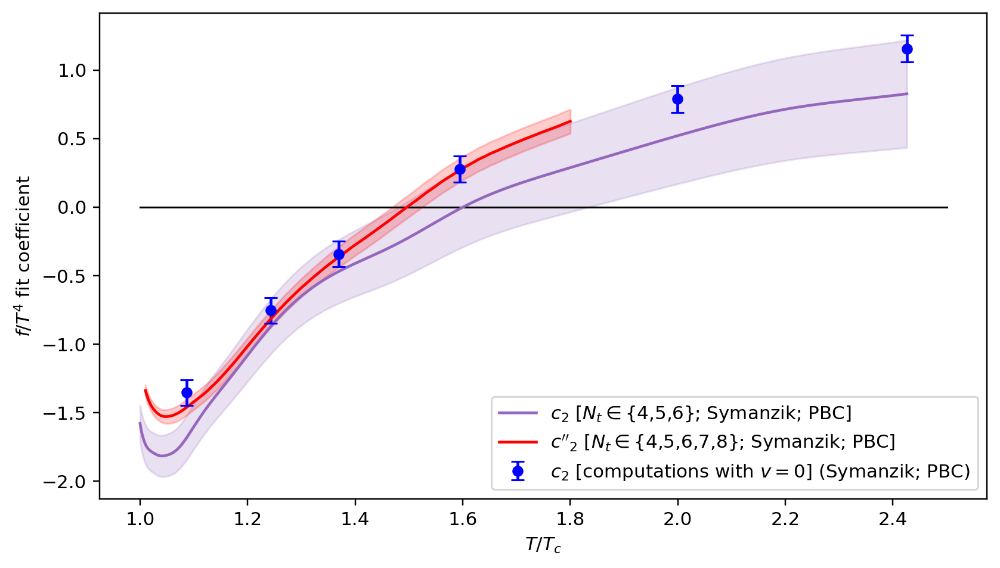

In [35]:
fig, ax = plotters.make_figure_and_111axis(plt)

# domain_to_draw = domains.GeometricRange((1.45, 1.55))
# domain_to_draw = domains.GeometricRange((1.55, 1.75))

# domain_to_draw = domains.GeometricRange((1.0, 4.0))
domain_to_draw = domains.GeometricRange((1.0, 2.5))
# domain_to_draw = domains.GeometricRange((1.0, 3.2))
# domain_to_draw = domains.GeometricRange((1.0, 4.0))
# domain_to_draw = domains.GeometricRange((2.0, 2.5))
r_nt4 = 40 / 4
r_nt5 = 40 / 5
r_nt6 = 40 / 6
r_nt7 = 40 / 7
r_nt8ns40 = 40 / 8
r_nt8 = 32 / 8

def my_func(
    _calc: calculator.Calculator, r: float, nt: int, tc_in_mev: float,
    _scale_setter: scale_setters.GluoScaleSetter = scale_setter
) -> Tuple[plotters.SplineRep, plotters.SplineRep, plotters.SplineRep]:
    """Does something. (????)"""
    _, _c2only_splrep = _calc.inertia_analysis_dict[r].get_linear_fit_splrep()
    _, _c2_splrep, _c4_splrep = (
        _calc.inertia_analysis_dict[r].get_quadratic_fit_splrep())
    beta_domain = _c2only_splrep.domain.intersection_with(
        _scale_setter.get_beta_domain())
    betas = np.linspace(beta_domain.left, beta_domain.right, 500)
    val_c2only, err_c2only = _c2only_splrep.calculate_points(betas)
    val_c2, err_c2 = _c2_splrep.calculate_points(betas)
    val_c4, err_c4 = _c4_splrep.calculate_points(betas)
    temp_per_tc = _scale_setter.get_temperature_in_mev(betas, nt) / tc_in_mev
    c2only_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                                   val_c2only, err_c2only)
    c2_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c2, err_c2)
    c4_splrep = plotters.SplineRep.from_points(temp_per_tc,
                                               val_c4, err_c4)
    return c2only_splrep, c2_splrep, c4_splrep

nt4imp_c2only_t, nt4imp_c2_t, nt4imp_c4_t = my_func(
    calc_4s_ns40_t, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt4imp_c2only_s, nt4imp_c2_s, nt4imp_c4_s = my_func(
    calc_4s_ns40_q, r_nt4, 4, tc_in_mev_nt4imp, symanzik_scale_setter)
nt5imp_c2only_t, nt5imp_c2_t, nt5imp_c4_t = my_func(
    calc_5s_ns40_t, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt5imp_c2only_s, nt5imp_c2_s, nt5imp_c4_s = my_func(
    calc_5s_ns40_q, r_nt5, 5, tc_in_mev_nt5imp, symanzik_scale_setter)
nt6imp_c2only_t, nt6imp_c2_t, nt6imp_c4_t = my_func(
    calc_6s_ns40_t, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt6imp_c2only_s, nt6imp_c2_s, nt6imp_c4_s = my_func(
    calc_6s_ns40_q, r_nt6, 6, tc_in_mev_nt6imp, symanzik_scale_setter)
nt7imp_c2only_t, nt7imp_c2_t, nt7imp_c4_t = my_func(
    calc_7s_ns40_t, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt7imp_c2only_s, nt7imp_c2_s, nt7imp_c4_s = my_func(
    calc_7s_ns40_q, r_nt7, 7, tc_in_mev_nt7imp, symanzik_scale_setter)
nt8imp_c2only_t, nt8imp_c2_t, nt8imp_c4_t = my_func(
    calc_8s_ns40_t, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
nt8imp_c2only_s, nt8imp_c2_s, nt8imp_c4_s = my_func(
    calc_8s_ns40_q, r_nt8ns40, 8, tc_in_mev_nt8imp, symanzik_scale_setter)
nt4_c2only_t, nt4_c2_t, nt4_c4_t = my_func(calc_4w_ns_all_t, r_nt4, 4, tc_in_mev_nt4)
nt4_c2only_s, nt4_c2_s, nt4_c4_s = my_func(calc_4w_ns_all_q, r_nt4, 4,
                                           tc_in_mev_nt4)
nt5_c2only_t, nt5_c2_t, nt5_c4_t = my_func(calc_5w_ns40_t, r_nt5, 5, tc_in_mev_nt5)
nt5_c2only_s, nt5_c2_s, nt5_c4_s = my_func(calc_5w_ns40_q, r_nt5, 5,
                                           tc_in_mev_nt5)
nt6_c2only_t, nt6_c2_t, nt6_c4_t = my_func(calc_6w_ns40_t, r_nt6, 6, tc_in_mev_nt6)
nt6_c2only_s, nt6_c2_s, nt6_c4_s = my_func(calc_6w_ns40_q, r_nt6, 6,
                                           tc_in_mev_nt6)
nt7_c2only_t, nt7_c2_t, nt7_c4_t = my_func(calc_7w_ns40_t, r_nt7, 7, tc_in_mev_nt7)
nt7_c2only_s, nt7_c2_s, nt7_c4_s = my_func(calc_7w_ns40_q, r_nt7, 7,
                                           tc_in_mev_nt7)
nt8_c2only_t, nt8_c2_t, nt8_c4_t = my_func(calc_8w_ns32_t, r_nt8, 8, tc_in_mev_nt8)
nt8_c2only_s, nt8_c2_s, nt8_c4_s= my_func(calc_8w_ns32_q, r_nt8, 8,
                                          tc_in_mev_nt8)
c_extrapolator = extrapolators.ConstantExtrapolator()
l_extrapolator = extrapolators.LinearExtrapolator()
bil_extrapolator = extrapolators.BilinearExtrapolator()
_x_val4_imp = np.array([6.0, 5.0, 4.0])**(-2)
_x_val6 = np.array([8.0, 7.0, 6.0])**(-2)
_x_val5 = np.array([8.0, 7.0, 6.0, 5.0])**(-2)
_x_val4 = np.array([8.0, 7.0, 6.0, 5.0, 4.0])**(-2)
_x_val4p = np.array([8.0, 7.0, 6.0, 5.0, 4.0, 4.0, 4.0, 4.0])**(-2)

c2only_t_list = [nt8_c2only_t, nt7_c2only_t, nt6_c2only_t, nt5_c2only_t,
                 nt4_c2only_t]
c2_t_list = [nt8_c2_t, nt7_c2_t, nt6_c2_t, nt5_c2_t, nt4_c2_t]
c4_t_list = [nt8_c4_t, nt7_c4_t, nt6_c4_t, nt5_c4_t, nt4_c4_t]
c2only_s_list = [nt8_c2only_s, nt7_c2only_s, nt6_c2only_s, nt5_c2only_s,
                 nt4_c2only_s]
c2_s_list = [nt8_c2_s, nt7_c2_s, nt6_c2_s, nt5_c2_s, nt4_c2_s]
c4_s_list = [nt8_c4_s, nt7_c4_s, nt6_c4_s, nt5_c4_s, nt4_c4_s]
c2only_t_list_imp = [nt6imp_c2only_t, nt5imp_c2only_t, nt4imp_c2only_t]
c2_t_list_imp = [nt6imp_c2_t, nt5imp_c2_t, nt4imp_c2_t]
c4_t_list_imp = [nt6imp_c4_t, nt5imp_c4_t, nt4imp_c4_t]
c2only_s_list_imp = [nt6imp_c2only_s, nt5imp_c2only_s, nt4imp_c2only_s]
c2_s_list_imp = [nt6imp_c2_s, nt5imp_c2_s, nt4imp_c2_s]
c4_s_list_imp = [nt6imp_c4_s, nt5imp_c4_s, nt4imp_c4_s]

c2only_t_c = c_extrapolator.from_splinereps(_x_val6, c2only_t_list[:3])
c2only_t_l = l_extrapolator.from_splinereps(_x_val6, c2only_t_list[:3])
c2_t_c = c_extrapolator.from_splinereps(_x_val6, c2_t_list[:3])
c2_t_l = l_extrapolator.from_splinereps(_x_val6, c2_t_list[:3])
c4_t_c = c_extrapolator.from_splinereps(_x_val6, c4_t_list[:3])
c4_t_l = l_extrapolator.from_splinereps( _x_val6, c4_t_list[:3])
c2only_s_c = c_extrapolator.from_splinereps(_x_val6, c2only_s_list[:3])
c2only_s_l = l_extrapolator.from_splinereps(_x_val6, c2only_s_list[:3])
c2_s_c = c_extrapolator.from_splinereps(_x_val6, c2_s_list[:3])
c2_s_l = l_extrapolator.from_splinereps(_x_val6, c2_s_list[:3])
c4_s_c = c_extrapolator.from_splinereps(_x_val6, c4_s_list[:3])
c4_s_l = l_extrapolator.from_splinereps(_x_val6, c4_s_list[:3])

c2only_s_nt6 = l_extrapolator.from_splinereps(_x_val6, c2only_s_list[:3])
c2_s_nt6 = l_extrapolator.from_splinereps(_x_val6, c2_s_list[:3])
c4_s_nt6 = l_extrapolator.from_splinereps(_x_val6, c4_s_list[:3])
c2only_s_nt5 = l_extrapolator.from_splinereps(_x_val5, c2only_s_list[:4])
c2_s_nt5 = l_extrapolator.from_splinereps(_x_val5, c2_s_list[:4])
c4_s_nt5 = l_extrapolator.from_splinereps(_x_val5, c4_s_list[:4])
c2only_s_nt4 = l_extrapolator.from_splinereps(_x_val4, c2only_s_list[:5])
c2_s_nt4 = l_extrapolator.from_splinereps(_x_val4, c2_s_list[:5])
c4_s_nt4 = l_extrapolator.from_splinereps(_x_val4, c4_s_list[:5])
c2only_s_imp = l_extrapolator.from_splinereps(_x_val4_imp,
                                              c2only_s_list_imp[:])
c2_s_imp = l_extrapolator.from_splinereps(_x_val4_imp, c2_s_list_imp[:])
c4_s_imp = l_extrapolator.from_splinereps(_x_val4_imp, c4_s_list_imp[:])
c2only_t_nt6 = l_extrapolator.from_splinereps(_x_val6, c2only_t_list[:3])
c2_t_nt6 = l_extrapolator.from_splinereps(_x_val6, c2_t_list[:3])
c4_t_nt6 = l_extrapolator.from_splinereps(_x_val6, c4_t_list[:3])
c2only_t_nt5 = l_extrapolator.from_splinereps(_x_val5, c2only_t_list[:4])
c2_t_nt5 = l_extrapolator.from_splinereps(_x_val5, c2_t_list[:4])
c4_t_nt5 = l_extrapolator.from_splinereps(_x_val5, c4_t_list[:4])
c2only_t_nt4 = l_extrapolator.from_splinereps(_x_val4, c2only_t_list[:5])
c2_t_nt4 = l_extrapolator.from_splinereps(_x_val4, c2_t_list[:5])
c4_t_nt4 = l_extrapolator.from_splinereps(_x_val4, c4_t_list[:5])
c2only_t_imp = l_extrapolator.from_splinereps(_x_val4_imp,
                                              c2only_t_list_imp[:])
c2_t_imp = l_extrapolator.from_splinereps(_x_val4_imp, c2_t_list_imp[:])
c4_t_imp = l_extrapolator.from_splinereps(_x_val4_imp, c4_t_list_imp[:])

c2only_s_b = bil_extrapolator.from_splinereps(
    _x_val4, c2only_s_list[:5], _x_val4_imp, c2only_s_list_imp[:])
c2_s_b = bil_extrapolator.from_splinereps(
    _x_val4, c2_s_list[:5], _x_val4_imp, c2_s_list_imp[:])
c4_s_b = bil_extrapolator.from_splinereps(
    _x_val4, c4_s_list[:5], _x_val4_imp, c4_s_list_imp[:])
c2only_t_b = bil_extrapolator.from_splinereps(
    _x_val4, c2only_t_list[:5], _x_val4_imp, c2only_t_list_imp[:])
c2_t_b = bil_extrapolator.from_splinereps(
    _x_val4, c2_t_list[:5], _x_val4_imp, c2_t_list_imp[:])
c4_t_b = bil_extrapolator.from_splinereps(
    _x_val4, c4_t_list[:5], _x_val4_imp, c4_t_list_imp[:])
c2only_s_r = bil_extrapolator.from_splinereps(
    _x_val5, c2only_s_list[:4], _x_val4_imp, c2only_s_list_imp[:])
c2_s_r = bil_extrapolator.from_splinereps(
    _x_val5, c2_s_list[:4], _x_val4_imp, c2_s_list_imp[:])
c4_s_r = bil_extrapolator.from_splinereps(
    _x_val5, c4_s_list[:4], _x_val4_imp, c4_s_list_imp[:])
c2only_t_r = bil_extrapolator.from_splinereps(
    _x_val5, c2only_t_list[:4], _x_val4_imp, c2only_t_list_imp[:])
c2_t_r = bil_extrapolator.from_splinereps(
    _x_val5, c2_t_list[:4], _x_val4_imp, c2_t_list_imp[:])
c4_t_r = bil_extrapolator.from_splinereps(
    _x_val5, c4_t_list[:4], _x_val4_imp, c4_t_list_imp[:])

x_val = np.linspace(domain_to_draw.left, domain_to_draw.right)
# plt.plot(x_val, 0.0 * x_val)
# plt.plot(x_val, 0.0 * x_val, label="ось координат", color="black",
#          linewidth=1.0)
plt.plot(x_val, 0.0 * x_val, color="black",
         linewidth=1.0)

# # plotters.draw_spl_rep(
# #     plt, ax, nt4_c2_s, "C0",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 4)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt4_c2_t, "C0", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt5_c2_s, "C1",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 5)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt5_c2_t, "C1", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt6_c2_s, "C2",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 6)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt6_c2_t, "C2", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt7_c2_s, "C3",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 7)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt7_c2_t, "C3", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt8_c2_s, "C4",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 8)",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt8_c2_t, "C4", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c2_s_l, "C8",
# #     label="$c_2$ linear extrapolation",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c2_t_l, "C8", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c2_s_c, "C9",
# #     label="$c_2$ constant extrapolation",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c2_t_c, "C9", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c2_s_nt6, "C0",
# #     label="$c_2$ [$N_t$$\in${6,7,8} (Wilson)]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c2_t_nt6, "C0", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2_s_nt5.multiply_by_constant(-1), "C1",
#     label="$c_2$ [$N_t$$\in${5,6,7,8}; д. Вильсона]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_nt5.multiply_by_constant(-1), "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c2_s_nt4, "C2",
# #     label="$c_2$ [$N_t$$\in${4,5,6,7,8} (Wilson)]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c2_t_nt4, "C2", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt4imp_c2_s, "C5",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 4 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt4imp_c2_t, "C5", domain=domain_to_draw,
# #                       linestyle=":", no_error=False)
# # plotters.draw_spl_rep(
# #     plt, ax, nt5imp_c2_s, "C6",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 5 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt5imp_c2_t, "C6", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt6imp_c2_s, "C7",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 6 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt6imp_c2_t, "C7", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt7imp_c2_s, "C8",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 7 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt7imp_c2_t, "C8", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt8imp_c2_s, "C9",
# #     label="$c_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 8 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt8imp_c2_t, "C9", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
plotters.draw_spl_rep(
    plt, ax, c2_s_imp.multiply_by_constant(-1), "C4",
    label="$c_2$ [$N_t \in${4,5,6}; Symanzik; PBC]",
    domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2_t_imp.multiply_by_constant(-1), "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c2_s_b, "black",
# #     label="$c_2$ [bilinear (full)]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c2_t_b, "black", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c2_s_r, "red",
# #     label="$c_2$ [bilinear (without $N_t$=4 Wilson)]",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c2_t_r, "red", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)

# plotters.draw_spl_rep(
#     plt, ax, nt4_c4_s.multiply_by_constant(0.1), "C0",
#     label="$0.1 * c_4$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 4)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4_c4_t.multiply_by_constant(0.1), "C0",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5_c4_s.multiply_by_constant(0.1), "C1",
#     label="$0.1 * c_4$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 5)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5_c4_t.multiply_by_constant(0.1), "C1",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6_c4_s.multiply_by_constant(0.1), "C2",
#     label="$0.1 * c_4$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 6)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6_c4_t.multiply_by_constant(0.1), "C2",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7_c4_s.multiply_by_constant(0.1), "C3",
#     label="$0.1 * c_4$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 7)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7_c4_t.multiply_by_constant(0.1), "C3",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8_c4_s.multiply_by_constant(0.1), "C4",
#     label="$0.1 * c_4$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 8)",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8_c4_t.multiply_by_constant(0.1), "C4",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c4_s_l.multiply_by_constant(0.1), "C8",
# #     label="$0.1 * c_4$ linear extrapolation",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c4_t_l.multiply_by_constant(0.1), "C8",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, c4_s_c.multiply_by_constant(0.1), "C9",
# #     label="$0.1 * c_4$  constant extrapolation",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, c4_t_c.multiply_by_constant(0.1), "C9",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_nt6.multiply_by_constant(0.1), "C0",
#     label="$0.1 * c_4$ [$N_t$$\in${6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_nt6.multiply_by_constant(0.1), "C0",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_nt5.multiply_by_constant(0.1), "C1",
#     label="$0.1 * c_4$ [$N_t$$\in${5,6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_nt5.multiply_by_constant(0.1), "C1",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_nt4.multiply_by_constant(0.1), "C2",
#     label="$0.1 * c_4$ [$N_t$$\in${4,5,6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_nt4.multiply_by_constant(0.1), "C2",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt4imp_c4_s.multiply_by_constant(0.1), "C5",
#     label="$0.1 * c_4$ ($N_t$ = 4 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt4imp_c4_t.multiply_by_constant(0.1), "C5",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt5imp_c4_s.multiply_by_constant(0.1), "C6",
#     label="$0.1 * c_4$ ($N_t$ = 5 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt5imp_c4_t.multiply_by_constant(0.1), "C6",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt6imp_c4_s.multiply_by_constant(0.1), "C7",
#     label="$0.1 * c_4$ ($N_t$ = 6 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt6imp_c4_t.multiply_by_constant(0.1), "C7",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt7imp_c4_s.multiply_by_constant(0.1), "C8",
#     label="$0.1 * c_4$ ($N_t$ = 7 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt7imp_c4_t.multiply_by_constant(0.1), "C8",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, nt8imp_c4_s.multiply_by_constant(0.1), "C9",
#     label="$0.1 * c_4$ ($N_t$ = 8 (Symanzik))",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, nt8imp_c4_t.multiply_by_constant(0.1), "C9",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_imp.multiply_by_constant(0.1), "C4",
#     label="$0.1 * c_4$ [$N_t$$\in${4,5,6} (Symanzik)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_imp.multiply_by_constant(0.1), "C4",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_b.multiply_by_constant(0.1), "black",
#     label="$0.1 * c_4$ [bilinear (full)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_b.multiply_by_constant(0.1), "black",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c4_s_r.multiply_by_constant(0.1), "red",
#     label="$0.1 * c_4$ [bilinear (without $N_t$=4 Wilson)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c4_t_r.multiply_by_constant(0.1), "red",
#                       domain=domain_to_draw, linestyle=":", no_error=True)

# # plotters.draw_spl_rep(plt, ax, nt4_c2only_s, "C5",
# #                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 4)",
# #                       domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt4_c2only_t, "C5",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(plt, ax, nt5_c2only_s, "C6",
# #                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 5)",
# #                       domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt5_c2only_t, "C6",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(plt, ax, nt6_c2only_s, "C7",
# #                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 6)",
# #                       domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt6_c2only_t, "C7",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(plt, ax, nt7_c2only_s, "C8",
# #                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 7)",
# #                       domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt7_c2only_t, "C8",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # plotters.draw_spl_rep(plt, ax, nt8_c2only_s, "C9",
# #                       label="$c_2$ [$c_0$ + $c_2v^2$] ($N_t$ = 8)",
# #                       domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt8_c2only_t, "C9",
# #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # # plotters.draw_spl_rep(plt, ax, c2only_s_l, "C0",
# # #                       label="$c_2$ linear extrapolation",
# # #                       domain=domain_to_draw)
# # # plotters.draw_spl_rep(plt, ax, c2only_t_l, "C0",
# # #                       domain=domain_to_draw, linestyle=":", no_error=True)
# # # plotters.draw_spl_rep(plt, ax, c2only_s_c, "C1",
# # #                       label="$c_2$ constant extrapolation",
# # #                       domain=domain_to_draw)
# # # plotters.draw_spl_rep(plt, ax, c2only_t_c, "C1",
# # #                       domain=domain_to_draw, linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_nt6, "C0",
#     label="$c'_2$ [$N_t$$\in${6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_nt6, "C0", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_nt5, "C1",
#     label="$c'_2$ [$N_t$$\in${5,6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_nt5, "C1", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_nt4, "C2",
#     label="$c'_2$ [$N_t$$\in${4,5,6,7,8}]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_nt4, "C2", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt4imp_c2only_s, "C5",
# #     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 4 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt4imp_c2only_t, "C5", domain=domain_to_draw,
# #                       linestyle=":", no_error=False)
# # plotters.draw_spl_rep(
# #     plt, ax, nt5imp_c2only_s, "C6",
# #     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 5 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt5imp_c2only_t, "C6", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# # plotters.draw_spl_rep(
# #     plt, ax, nt6imp_c2only_s, "C7",
# #     label="$c'_2$ [$c_0$ + $c_2v^2$ + $c_4v^4$] ($N_t$ = 6 (Symanzik))",
# #     domain=domain_to_draw)
# # plotters.draw_spl_rep(plt, ax, nt6imp_c2only_t, "C7", domain=domain_to_draw,
# #                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_imp, "C4",
#     label="$c'_2$ [$N_t$$\in${4,5,6} (Symanzik)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_imp, "C4", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_b, "black",
#     label="$c'_2$ [bilinear (full)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_b, "black", domain=domain_to_draw,
#                       linestyle=":", no_error=True)
# plotters.draw_spl_rep(
#     plt, ax, c2only_s_r, "red",
#     label="$c'_2$ [bilinear (without $N_t$=4 Wilson)]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2only_t_r, "red", domain=domain_to_draw,
#                       linestyle=":", no_error=True)

c2prime_wilson_t_splrep = plotters.SplineRep.from_points(
    wilson_t_ttc, wilson_t_val, wilson_t_err)
c2prime_wilson_s_splrep = plotters.SplineRep.from_points(
    wilson_s_ttc, wilson_s_val, wilson_s_err)
c2prime_symanzik_t_splrep = plotters.SplineRep.from_points(
    symanzik_t_ttc, symanzik_t_val, symanzik_t_err)
c2prime_symanzik_s_splrep = plotters.SplineRep.from_points(
    symanzik_s_ttc, symanzik_s_val, symanzik_s_err)

# plotters.draw_spl_rep(
#     plt, ax, c2prime_wilson_s_splrep.multiply_by_constant(-1), "black",
#     label="$c''_2$ [$N_t \in${5,6,7,8}; д. Вильсона]",
#     domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2prime_wilson_t_splrep.multiply_by_constant(-1), "black",
#                       domain=domain_to_draw, linestyle=":", no_error=True)
plotters.draw_spl_rep(
    plt, ax, c2prime_symanzik_s_splrep.multiply_by_constant(-1), "red",
    label="$c''_2$ [$N_t \in${4,5,6,7,8}; Symanzik; PBC]",
    domain=domain_to_draw)
# plotters.draw_spl_rep(plt, ax, c2prime_symanzik_t_splrep.multiply_by_constant(-1), "red",
#                       domain=domain_to_draw, linestyle=":", no_error=True)

plotters.draw_point_rep(plt, ax, c2_prep_etx,
                       "blue", 
#                         label=r"$c_2 = -\kappa_2$ [cont. limit] (Symanzik; PBC)",
                        label=r"$c_2$ [computations with $v = 0$] (Symanzik; PBC)",
                        linestyle="None",
                        domain=domain_to_draw)

# plt.legend(loc="upper right")
plt.legend(loc="lower right")
plt.xlabel("$T/T_c$")
# plt.ylabel("$\langle f \\rangle/T^4$ fit coefficient")
plt.ylabel("$f/T^4$ fit coefficient")
# plt.ylabel(r"коэффициент фита $\langle f \rangle/T^4$")
# plt.suptitle("($N_t$ = 4,5,6,7; $N_s$ = 40) vs ($N_t$ = 8; $N_s$ = 32) vs "
#              "($N_t$ = 4; $N_s$ = 32; Symanzik)")
# plt.suptitle(r"$N_t$$\to\infty$ extrapolation; "
#              r"$c_2$ - stat. errors; $c''_2$ - combined errors")
# plt.title("solid lines - quadratic integration; dotted lines - trapezoidal integration")
# plt.title("сплошная (пунктир) - кусочно-квадратичное(-линейное) интегрирование")
# plt.savefig(f"{output_dir_name}continuous_limit/fit_eos_ntdiff_c2_000.png")
# plt.show()
# plt.savefig(f"{output_dir_name}fit_eos_cont_lim_c2_c2prime_diploma_000.png")
# plt.savefig(f"{output_dir_name}fit_eos_cont_lim_kudrov_011_v2.png")

plt.savefig(f"{output_dir_name}kudrov_compare_010_pres.png")